# Face Generation
In this project, you'll use generative adversarial networks to generate new images of faces.
### Get the Data
You'll be using two datasets in this project:
- MNIST
- CelebA

Since the celebA dataset is complex and you're doing GANs in a project for the first time, we want you to test your neural network on MNIST before CelebA.  Running the GANs on MNIST will allow you to see how well your model trains sooner.

If you're using [FloydHub](https://www.floydhub.com/), set `data_dir` to "/input" and use the [FloydHub data ID](http://docs.floydhub.com/home/using_datasets/) "R5KrjnANiKVhLWAkpXhNBe".

In [1]:
data_dir = './data'

# FloydHub - Use with data ID "R5KrjnANiKVhLWAkpXhNBe"
data_dir = '/input'


"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
import helper

helper.download_extract('mnist', data_dir)
helper.download_extract('celeba', data_dir)

Found mnist Data
Found celeba Data


## Explore the Data
### MNIST
As you're aware, the [MNIST](http://yann.lecun.com/exdb/mnist/) dataset contains images of handwritten digits. You can view the first number of examples by changing `show_n_images`. 

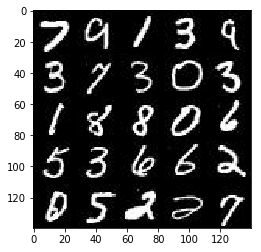

In [2]:
show_n_images = 25

"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
%matplotlib inline
import os
from glob import glob
from matplotlib import pyplot

mnist_images = helper.get_batch(glob(os.path.join(data_dir, 'mnist/*.jpg'))[:show_n_images], 28, 28, 'L')
pyplot.imshow(helper.images_square_grid(mnist_images, 'L'), cmap='gray')

### CelebA
The [CelebFaces Attributes Dataset (CelebA)](http://mmlab.ie.cuhk.edu.hk/projects/CelebA.html) dataset contains over 200,000 celebrity images with annotations.  Since you're going to be generating faces, you won't need the annotations.  You can view the first number of examples by changing `show_n_images`.

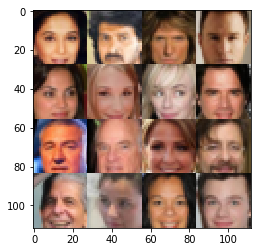

In [3]:
show_n_images = 16

"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
mnist_images = helper.get_batch(glob(os.path.join(data_dir, 'img_align_celeba/*.jpg'))[:show_n_images], 28, 28, 'RGB')
pyplot.imshow(helper.images_square_grid(mnist_images, 'RGB'))

## Preprocess the Data
Since the project's main focus is on building the GANs, we'll preprocess the data for you.  The values of the MNIST and CelebA dataset will be in the range of -0.5 to 0.5 of 28x28 dimensional images.  The CelebA images will be cropped to remove parts of the image that don't include a face, then resized down to 28x28.

The MNIST images are black and white images with a single [color channel](https://en.wikipedia.org/wiki/Channel_(digital_image%29) while the CelebA images have [3 color channels (RGB color channel)](https://en.wikipedia.org/wiki/Channel_(digital_image%29#RGB_Images).
## Build the Neural Network
You'll build the components necessary to build a GANs by implementing the following functions below:
- `model_inputs`
- `discriminator`
- `generator`
- `model_loss`
- `model_opt`
- `train`

### Check the Version of TensorFlow and Access to GPU
This will check to make sure you have the correct version of TensorFlow and access to a GPU

In [4]:
"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
from distutils.version import LooseVersion
import warnings
import tensorflow as tf

# Check TensorFlow Version
assert LooseVersion(tf.__version__) >= LooseVersion('1.0'), 'Please use TensorFlow version 1.0 or newer.  You are using {}'.format(tf.__version__)
print('TensorFlow Version: {}'.format(tf.__version__))

# Check for a GPU
if not tf.test.gpu_device_name():
    warnings.warn('No GPU found. Please use a GPU to train your neural network.')
else:
    print('Default GPU Device: {}'.format(tf.test.gpu_device_name()))

TensorFlow Version: 1.0.0
Default GPU Device: /gpu:0


### Input
Implement the `model_inputs` function to create TF Placeholders for the Neural Network. It should create the following placeholders:
- Real input images placeholder with rank 4 using `image_width`, `image_height`, and `image_channels`.
- Z input placeholder with rank 2 using `z_dim`.
- Learning rate placeholder with rank 0.

Return the placeholders in the following the tuple (tensor of real input images, tensor of z data)

In [5]:
import problem_unittests as tests

def model_inputs(image_width, image_height, image_channels, z_dim):
    """
    Create the model inputs
    :param image_width: The input image width
    :param image_height: The input image height
    :param image_channels: The number of image channels
    :param z_dim: The dimension of Z
    :return: Tuple of (tensor of real input images, tensor of z data, learning rate)
    """
    image_input = tf.placeholder(tf.float32, [None, image_width, image_height, image_channels])
    z_input = tf.placeholder(tf.float32, [None, z_dim])
    learning_rate = tf.placeholder(tf.float32, name="learning_rate")

    return image_input, z_input, learning_rate


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_inputs(model_inputs)

Tests Passed


### Discriminator
Implement `discriminator` to create a discriminator neural network that discriminates on `images`.  This function should be able to reuse the variabes in the neural network.  Use [`tf.variable_scope`](https://www.tensorflow.org/api_docs/python/tf/variable_scope) with a scope name of "discriminator" to allow the variables to be reused.  The function should return a tuple of (tensor output of the generator, tensor logits of the generator).

In [6]:
def discriminator(images, reuse=False):
    """
    Create the discriminator network
    :param image: Tensor of input image(s)
    :param reuse: Boolean if the weights should be reused
    :return: Tuple of (tensor output of the discriminator, tensor logits of the discriminator)
    """
    alpha = 0.2
    with tf.variable_scope('discriminator', reuse=reuse):
        x1 = tf.layers.conv2d(images, 64, 5, strides=2, padding='same')
        relu1 = tf.maximum(alpha * x1, x1)
        
        x2 = tf.layers.conv2d(relu1, 128, 5, strides=2, padding='same')
        bn2 = tf.layers.batch_normalization(x2, training=True)
        relu2 = tf.maximum(alpha * bn2, bn2)
        
        x3 = tf.layers.conv2d(relu2, 256, 5, strides=2, padding='same')
        bn3 = tf.layers.batch_normalization(x3, training=True)
        relu3 = tf.maximum(alpha * bn3, bn3)
        
        ###### trying dropout
        drop = tf.layers.dropout(relu3, 0.75)

        flat = tf.reshape(drop, (-1, 4*4*256))
        logits = tf.layers.dense(flat, 1)
        out = tf.sigmoid(logits)
        
    return out, logits

"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_discriminator(discriminator, tf)

Tests Passed


### Generator
Implement `generator` to generate an image using `z`. This function should be able to reuse the variabes in the neural network.  Use [`tf.variable_scope`](https://www.tensorflow.org/api_docs/python/tf/variable_scope) with a scope name of "generator" to allow the variables to be reused. The function should return the generated 28 x 28 x `out_channel_dim` images.

In [7]:
def generator(z, out_channel_dim, is_train=True):
    """
    Create the generator network
    :param z: Input z
    :param out_channel_dim: The number of channels in the output image
    :param is_train: Boolean if generator is being used for training
    :return: The tensor output of the generator
    """
    alpha = 0.2
    with tf.variable_scope('generator', reuse= not is_train):
        
        x1 = tf.layers.dense(z, 7*7*512)
        
        x1 = tf.reshape(x1, (-1, 7, 7, 512))
        bn1 = tf.layers.batch_normalization(x1, training=is_train)
        relu1 = tf.maximum(alpha * bn1, bn1)
        
        x2 = tf.layers.conv2d_transpose(relu1, 256, 5, strides=2, padding='same')
        bn2 = tf.layers.batch_normalization(x2, training=is_train)
        relu2 = tf.maximum(alpha * bn2, bn2)
        
        x3 = tf.layers.conv2d_transpose(relu2, 128, 5, strides=2, padding='same')
        bn3 = tf.layers.batch_normalization(x3, training=is_train)
        relu3 = tf.maximum(alpha * bn3, bn3)
        
        logits = tf.layers.conv2d_transpose(relu3, out_channel_dim, 5, strides=1, padding='same')
        
        out = tf.tanh(logits)   
        
    return out

"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_generator(generator, tf)

Tests Passed


### Loss
Implement `model_loss` to build the GANs for training and calculate the loss.  The function should return a tuple of (discriminator loss, generator loss).  Use the following functions you implemented:
- `discriminator(images, reuse=False)`
- `generator(z, out_channel_dim, is_train=True)`

In [8]:
def model_loss(input_real, input_z, out_channel_dim):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """

    g_model = generator(input_z, out_channel_dim)
    d_model_real, d_logits_real = discriminator(input_real)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True)

    d_loss_real = tf.reduce_mean(tf.nn.sigmoid_cross_entropy_with_logits(
                        logits=d_logits_real, labels=tf.ones_like(d_model_real)))
    d_loss_fake = tf.reduce_mean(tf.nn.sigmoid_cross_entropy_with_logits(
                        logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    g_loss = tf.reduce_mean(tf.nn.sigmoid_cross_entropy_with_logits(
                        logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))
    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_loss(model_loss)

Tests Passed


### Optimization
Implement `model_opt` to create the optimization operations for the GANs. Use [`tf.trainable_variables`](https://www.tensorflow.org/api_docs/python/tf/trainable_variables) to get all the trainable variables.  Filter the variables with names that are in the discriminator and generator scope names.  The function should return a tuple of (discriminator training operation, generator training operation).

In [9]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
   
    t_vars = tf.trainable_variables()    
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    d_train_opt = tf.train.AdamOptimizer(
        learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
    
    update_ops = tf.get_collection(tf.GraphKeys.UPDATE_OPS)
    g_updates = [opt for opt in update_ops if opt.name.startswith('generator')]
    with tf.control_dependencies(g_updates):
        g_train_opt = tf.train.AdamOptimizer(
            learning_rate, beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_opt(model_opt, tf)

Tests Passed


## Neural Network Training
### Show Output
Use this function to show the current output of the generator during training. It will help you determine how well the GANs is training.

In [10]:
"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
import numpy as np

def show_generator_output(sess, n_images, input_z, out_channel_dim, image_mode):
    """
    Show example output for the generator
    :param sess: TensorFlow session
    :param n_images: Number of Images to display
    :param input_z: Input Z Tensor
    :param out_channel_dim: The number of channels in the output image
    :param image_mode: The mode to use for images ("RGB" or "L")
    """
    cmap = None if image_mode == 'RGB' else 'gray'
    z_dim = input_z.get_shape().as_list()[-1]
    example_z = np.random.uniform(-1, 1, size=[n_images, z_dim])

    samples = sess.run(
        generator(input_z, out_channel_dim, False),
        feed_dict={input_z: example_z})

    images_grid = helper.images_square_grid(samples, image_mode)
    pyplot.imshow(images_grid, cmap=cmap)
    pyplot.show()

In [11]:
def train(epoch_count, batch_size, z_dim, learning_rate, beta1, get_batches, data_shape, data_image_mode):
    """
    Train the GAN
    :param epoch_count: Number of epochs
    :param batch_size: Batch Size
    :param z_dim: Z dimension
    :param learning_rate: Learning Rate
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :param get_batches: Function to get batches
    :param data_shape: Shape of the data
    :param data_image_mode: The image mode to use for images ("RGB" or "L")
    """
    #tf.reset_default_graph()
        
    image_width = data_shape[1]
    image_height = data_shape[2]
    image_channels = data_shape[3]
    
    input_real, input_z, _ = model_inputs(image_width, image_height, image_channels, z_dim)
   
    l_rate = learning_rate

    #loss, optimization
    d_loss, g_loss = model_loss(input_real, input_z, image_channels)
    d_opt, g_opt = model_opt(d_loss, g_loss, l_rate, beta1) 
    
    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        i = 0
        for epoch_i in range(epoch_count):
            for batch_images in get_batches(batch_size):
                i += 1
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_dim))   
                batch_images = batch_images*2
                
                _ = sess.run(d_opt, feed_dict={input_real: batch_images, input_z: batch_z})
                _ = sess.run(g_opt, feed_dict={input_z: batch_z})
                 
                train_loss_d = sess.run(d_loss, {input_z: batch_z, input_real: batch_images})
                train_loss_g = g_loss.eval({input_z: batch_z})
                
                print("Epoch {}/{}...".format(epoch_i+1, epoch_count),"Discriminator Loss: {:.4f}...".format(train_loss_d),"Generator Loss: {:.4f}".format(train_loss_g))
                
                if i % 10 == 0:
                    show_generator_output(sess, 16, input_z, image_channels, data_image_mode)

                    
        return None


### MNIST
Test your GANs architecture on MNIST.  After 2 epochs, the GANs should be able to generate images that look like handwritten digits.  Make sure the loss of the generator is lower than the loss of the discriminator or close to 0.

Epoch 1/2... Discriminator Loss: 7.4633... Generator Loss: 0.0008
Epoch 1/2... Discriminator Loss: 3.9193... Generator Loss: 0.0431
Epoch 1/2... Discriminator Loss: 0.1848... Generator Loss: 2.1995
Epoch 1/2... Discriminator Loss: 0.0437... Generator Loss: 6.9782
Epoch 1/2... Discriminator Loss: 0.0829... Generator Loss: 7.7844
Epoch 1/2... Discriminator Loss: 0.0378... Generator Loss: 4.7446
Epoch 1/2... Discriminator Loss: 0.0485... Generator Loss: 3.5549
Epoch 1/2... Discriminator Loss: 2.8198... Generator Loss: 0.0673
Epoch 1/2... Discriminator Loss: 0.2681... Generator Loss: 14.1404
Epoch 1/2... Discriminator Loss: 0.1281... Generator Loss: 16.9890


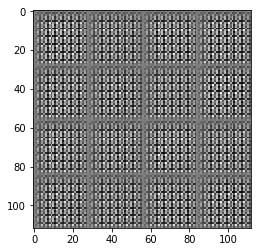

Epoch 1/2... Discriminator Loss: 0.0377... Generator Loss: 14.4848
Epoch 1/2... Discriminator Loss: 0.0052... Generator Loss: 10.2077
Epoch 1/2... Discriminator Loss: 0.0052... Generator Loss: 9.6322
Epoch 1/2... Discriminator Loss: 0.0015... Generator Loss: 10.1432
Epoch 1/2... Discriminator Loss: 0.0022... Generator Loss: 7.4836
Epoch 1/2... Discriminator Loss: 0.0057... Generator Loss: 8.3491
Epoch 1/2... Discriminator Loss: 0.0030... Generator Loss: 8.2572
Epoch 1/2... Discriminator Loss: 0.0014... Generator Loss: 7.9786
Epoch 1/2... Discriminator Loss: 0.0010... Generator Loss: 7.4010
Epoch 1/2... Discriminator Loss: 0.0024... Generator Loss: 7.2113


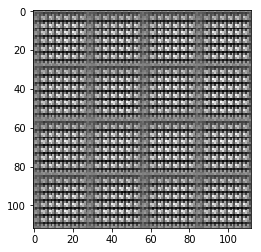

Epoch 1/2... Discriminator Loss: 0.0037... Generator Loss: 5.8639
Epoch 1/2... Discriminator Loss: 0.0184... Generator Loss: 4.0817
Epoch 1/2... Discriminator Loss: 0.0229... Generator Loss: 3.9046
Epoch 1/2... Discriminator Loss: 0.2379... Generator Loss: 1.7728
Epoch 1/2... Discriminator Loss: 0.0053... Generator Loss: 16.8411
Epoch 1/2... Discriminator Loss: 0.0127... Generator Loss: 19.4109
Epoch 1/2... Discriminator Loss: 0.0585... Generator Loss: 20.6117
Epoch 1/2... Discriminator Loss: 0.0096... Generator Loss: 19.8878
Epoch 1/2... Discriminator Loss: 0.0082... Generator Loss: 16.3149
Epoch 1/2... Discriminator Loss: 0.0016... Generator Loss: 14.4869


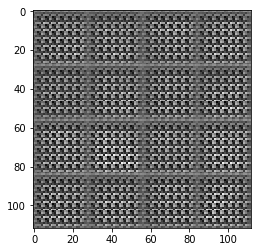

Epoch 1/2... Discriminator Loss: 0.0376... Generator Loss: 3.7658
Epoch 1/2... Discriminator Loss: 0.0030... Generator Loss: 7.1196
Epoch 1/2... Discriminator Loss: 0.0125... Generator Loss: 6.2810
Epoch 1/2... Discriminator Loss: 0.0809... Generator Loss: 4.0837
Epoch 1/2... Discriminator Loss: 0.0057... Generator Loss: 8.7050
Epoch 1/2... Discriminator Loss: 0.0100... Generator Loss: 6.4476
Epoch 1/2... Discriminator Loss: 0.0775... Generator Loss: 3.6236
Epoch 1/2... Discriminator Loss: 0.1392... Generator Loss: 2.7352
Epoch 1/2... Discriminator Loss: 0.0397... Generator Loss: 6.9371
Epoch 1/2... Discriminator Loss: 0.0317... Generator Loss: 6.6888


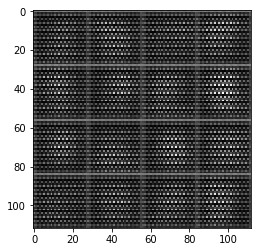

Epoch 1/2... Discriminator Loss: 0.0212... Generator Loss: 4.7813
Epoch 1/2... Discriminator Loss: 0.0697... Generator Loss: 3.1361
Epoch 1/2... Discriminator Loss: 0.4888... Generator Loss: 1.4463
Epoch 1/2... Discriminator Loss: 0.8878... Generator Loss: 9.7094
Epoch 1/2... Discriminator Loss: 1.3090... Generator Loss: 2.2392
Epoch 1/2... Discriminator Loss: 0.2471... Generator Loss: 6.7072
Epoch 1/2... Discriminator Loss: 0.0983... Generator Loss: 6.1434
Epoch 1/2... Discriminator Loss: 0.2081... Generator Loss: 3.3803
Epoch 1/2... Discriminator Loss: 0.1741... Generator Loss: 4.3009
Epoch 1/2... Discriminator Loss: 0.1302... Generator Loss: 3.2757


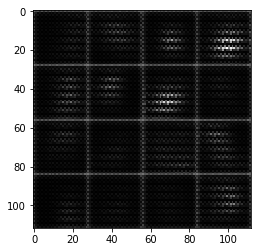

Epoch 1/2... Discriminator Loss: 0.1484... Generator Loss: 2.8371
Epoch 1/2... Discriminator Loss: 0.0805... Generator Loss: 3.6153
Epoch 1/2... Discriminator Loss: 0.2409... Generator Loss: 1.9448
Epoch 1/2... Discriminator Loss: 0.1206... Generator Loss: 4.8216
Epoch 1/2... Discriminator Loss: 0.6826... Generator Loss: 1.1120
Epoch 1/2... Discriminator Loss: 4.2597... Generator Loss: 12.1292
Epoch 1/2... Discriminator Loss: 9.4655... Generator Loss: 0.0100
Epoch 1/2... Discriminator Loss: 0.7887... Generator Loss: 2.2081
Epoch 1/2... Discriminator Loss: 0.9430... Generator Loss: 7.3800
Epoch 1/2... Discriminator Loss: 1.0198... Generator Loss: 1.8857


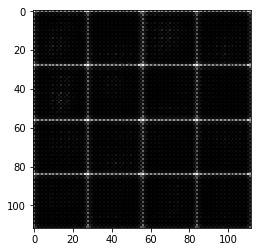

Epoch 1/2... Discriminator Loss: 0.8438... Generator Loss: 2.4609
Epoch 1/2... Discriminator Loss: 0.7739... Generator Loss: 2.5938
Epoch 1/2... Discriminator Loss: 0.9897... Generator Loss: 1.1884
Epoch 1/2... Discriminator Loss: 0.3791... Generator Loss: 3.4138
Epoch 1/2... Discriminator Loss: 0.5220... Generator Loss: 1.9404
Epoch 1/2... Discriminator Loss: 0.5105... Generator Loss: 4.0789
Epoch 1/2... Discriminator Loss: 1.3947... Generator Loss: 1.1290
Epoch 1/2... Discriminator Loss: 1.8092... Generator Loss: 10.3559
Epoch 1/2... Discriminator Loss: 0.0136... Generator Loss: 6.9263
Epoch 1/2... Discriminator Loss: 0.4232... Generator Loss: 1.9272


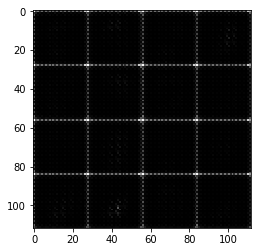

Epoch 1/2... Discriminator Loss: 0.8438... Generator Loss: 0.8750
Epoch 1/2... Discriminator Loss: 0.3013... Generator Loss: 8.2337
Epoch 1/2... Discriminator Loss: 0.3922... Generator Loss: 6.5859
Epoch 1/2... Discriminator Loss: 1.6826... Generator Loss: 0.5977
Epoch 1/2... Discriminator Loss: 1.0822... Generator Loss: 3.3196
Epoch 1/2... Discriminator Loss: 1.0538... Generator Loss: 1.4452
Epoch 1/2... Discriminator Loss: 0.9492... Generator Loss: 1.0493
Epoch 1/2... Discriminator Loss: 0.4495... Generator Loss: 3.9401
Epoch 1/2... Discriminator Loss: 0.3600... Generator Loss: 2.0015
Epoch 1/2... Discriminator Loss: 0.5248... Generator Loss: 1.5322


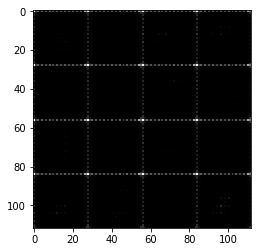

Epoch 1/2... Discriminator Loss: 0.3311... Generator Loss: 3.1447
Epoch 1/2... Discriminator Loss: 0.6520... Generator Loss: 1.4881
Epoch 1/2... Discriminator Loss: 1.3307... Generator Loss: 0.6499
Epoch 1/2... Discriminator Loss: 1.2716... Generator Loss: 2.0140
Epoch 1/2... Discriminator Loss: 1.1751... Generator Loss: 0.6608
Epoch 1/2... Discriminator Loss: 0.6211... Generator Loss: 4.8032
Epoch 1/2... Discriminator Loss: 1.4956... Generator Loss: 0.4390
Epoch 1/2... Discriminator Loss: 0.8609... Generator Loss: 3.8225
Epoch 1/2... Discriminator Loss: 2.2156... Generator Loss: 0.2480
Epoch 1/2... Discriminator Loss: 1.5070... Generator Loss: 3.0305


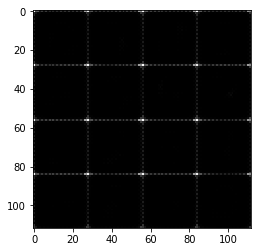

Epoch 1/2... Discriminator Loss: 2.2640... Generator Loss: 0.2017
Epoch 1/2... Discriminator Loss: 1.6336... Generator Loss: 3.6643
Epoch 1/2... Discriminator Loss: 1.6573... Generator Loss: 0.4508
Epoch 1/2... Discriminator Loss: 0.6915... Generator Loss: 2.0972
Epoch 1/2... Discriminator Loss: 0.9541... Generator Loss: 1.6211
Epoch 1/2... Discriminator Loss: 0.9855... Generator Loss: 0.8578
Epoch 1/2... Discriminator Loss: 0.7826... Generator Loss: 1.8912
Epoch 1/2... Discriminator Loss: 0.9116... Generator Loss: 1.1837
Epoch 1/2... Discriminator Loss: 0.6672... Generator Loss: 1.3243
Epoch 1/2... Discriminator Loss: 0.8691... Generator Loss: 1.2798


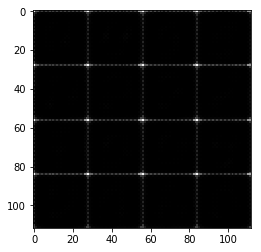

Epoch 1/2... Discriminator Loss: 0.9345... Generator Loss: 1.1571
Epoch 1/2... Discriminator Loss: 0.9409... Generator Loss: 0.8917
Epoch 1/2... Discriminator Loss: 1.0573... Generator Loss: 0.9551
Epoch 1/2... Discriminator Loss: 0.9504... Generator Loss: 1.5201
Epoch 1/2... Discriminator Loss: 1.2662... Generator Loss: 0.5254
Epoch 1/2... Discriminator Loss: 1.4642... Generator Loss: 3.8150
Epoch 1/2... Discriminator Loss: 2.1330... Generator Loss: 0.1968
Epoch 1/2... Discriminator Loss: 0.9760... Generator Loss: 3.8657
Epoch 1/2... Discriminator Loss: 1.2079... Generator Loss: 0.6566
Epoch 1/2... Discriminator Loss: 0.6706... Generator Loss: 1.5555


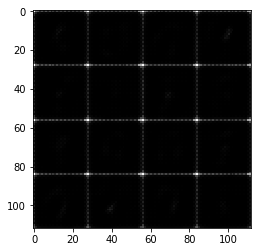

Epoch 1/2... Discriminator Loss: 0.8340... Generator Loss: 1.1306
Epoch 1/2... Discriminator Loss: 0.9336... Generator Loss: 1.1991
Epoch 1/2... Discriminator Loss: 1.0985... Generator Loss: 1.0439
Epoch 1/2... Discriminator Loss: 1.2015... Generator Loss: 0.7269
Epoch 1/2... Discriminator Loss: 0.6464... Generator Loss: 2.0645
Epoch 1/2... Discriminator Loss: 1.3791... Generator Loss: 0.4677
Epoch 1/2... Discriminator Loss: 0.7773... Generator Loss: 2.8898
Epoch 1/2... Discriminator Loss: 1.1409... Generator Loss: 0.7699
Epoch 1/2... Discriminator Loss: 0.6697... Generator Loss: 1.7880
Epoch 1/2... Discriminator Loss: 0.8965... Generator Loss: 1.3997


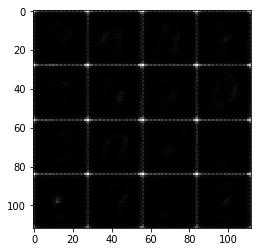

Epoch 1/2... Discriminator Loss: 1.1365... Generator Loss: 0.6753
Epoch 1/2... Discriminator Loss: 1.9687... Generator Loss: 2.9080
Epoch 1/2... Discriminator Loss: 2.4999... Generator Loss: 0.1360
Epoch 1/2... Discriminator Loss: 1.2936... Generator Loss: 3.1011
Epoch 1/2... Discriminator Loss: 0.8082... Generator Loss: 1.0863
Epoch 1/2... Discriminator Loss: 1.1432... Generator Loss: 0.6698
Epoch 1/2... Discriminator Loss: 1.0207... Generator Loss: 2.4316
Epoch 1/2... Discriminator Loss: 1.1136... Generator Loss: 0.7257
Epoch 1/2... Discriminator Loss: 0.8373... Generator Loss: 1.3585
Epoch 1/2... Discriminator Loss: 0.7626... Generator Loss: 1.0620


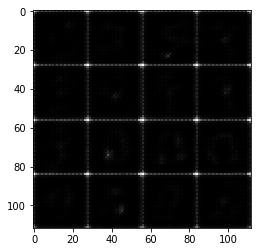

Epoch 1/2... Discriminator Loss: 0.8138... Generator Loss: 1.2086
Epoch 1/2... Discriminator Loss: 1.1797... Generator Loss: 0.5687
Epoch 1/2... Discriminator Loss: 1.2202... Generator Loss: 1.7303
Epoch 1/2... Discriminator Loss: 1.6134... Generator Loss: 0.3242
Epoch 1/2... Discriminator Loss: 1.2644... Generator Loss: 2.4485
Epoch 1/2... Discriminator Loss: 1.2888... Generator Loss: 0.5319
Epoch 1/2... Discriminator Loss: 1.0882... Generator Loss: 2.0004
Epoch 1/2... Discriminator Loss: 1.5058... Generator Loss: 0.3594
Epoch 1/2... Discriminator Loss: 1.1556... Generator Loss: 1.8398
Epoch 1/2... Discriminator Loss: 1.2084... Generator Loss: 0.6068


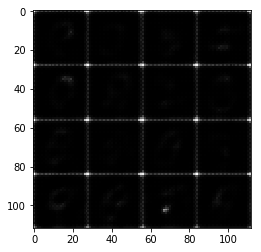

Epoch 1/2... Discriminator Loss: 1.0386... Generator Loss: 1.6739
Epoch 1/2... Discriminator Loss: 1.4580... Generator Loss: 0.3974
Epoch 1/2... Discriminator Loss: 1.1237... Generator Loss: 2.6955
Epoch 1/2... Discriminator Loss: 1.1609... Generator Loss: 0.5404
Epoch 1/2... Discriminator Loss: 0.8943... Generator Loss: 1.8943
Epoch 1/2... Discriminator Loss: 1.1303... Generator Loss: 0.6301
Epoch 1/2... Discriminator Loss: 0.8960... Generator Loss: 1.6723
Epoch 1/2... Discriminator Loss: 1.6668... Generator Loss: 0.3079
Epoch 1/2... Discriminator Loss: 1.2463... Generator Loss: 2.5674
Epoch 1/2... Discriminator Loss: 1.2599... Generator Loss: 0.5460


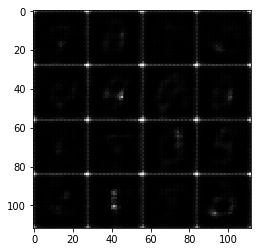

Epoch 1/2... Discriminator Loss: 1.0472... Generator Loss: 1.2205
Epoch 1/2... Discriminator Loss: 0.8365... Generator Loss: 1.2512
Epoch 1/2... Discriminator Loss: 0.7044... Generator Loss: 1.2113
Epoch 1/2... Discriminator Loss: 0.6852... Generator Loss: 1.3644
Epoch 1/2... Discriminator Loss: 0.7545... Generator Loss: 1.1150
Epoch 1/2... Discriminator Loss: 0.8759... Generator Loss: 1.0071
Epoch 1/2... Discriminator Loss: 1.0426... Generator Loss: 0.7959
Epoch 1/2... Discriminator Loss: 0.9504... Generator Loss: 1.8723
Epoch 1/2... Discriminator Loss: 2.0155... Generator Loss: 0.1967
Epoch 1/2... Discriminator Loss: 1.8481... Generator Loss: 3.7311


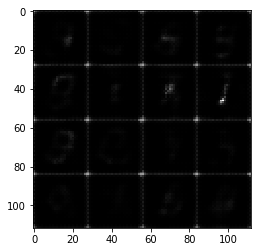

Epoch 1/2... Discriminator Loss: 1.9140... Generator Loss: 0.2758
Epoch 1/2... Discriminator Loss: 0.8803... Generator Loss: 1.7931
Epoch 1/2... Discriminator Loss: 0.9289... Generator Loss: 1.8315
Epoch 1/2... Discriminator Loss: 0.8942... Generator Loss: 0.8459
Epoch 1/2... Discriminator Loss: 0.9081... Generator Loss: 1.0929
Epoch 1/2... Discriminator Loss: 1.0209... Generator Loss: 1.0859
Epoch 1/2... Discriminator Loss: 1.0662... Generator Loss: 1.2226
Epoch 1/2... Discriminator Loss: 1.3573... Generator Loss: 0.5944
Epoch 1/2... Discriminator Loss: 1.1338... Generator Loss: 1.3148
Epoch 1/2... Discriminator Loss: 1.0956... Generator Loss: 0.7982


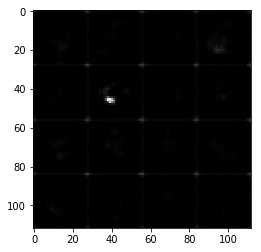

Epoch 1/2... Discriminator Loss: 0.9999... Generator Loss: 0.8981
Epoch 1/2... Discriminator Loss: 0.9196... Generator Loss: 1.8290
Epoch 1/2... Discriminator Loss: 1.0930... Generator Loss: 0.6636
Epoch 1/2... Discriminator Loss: 0.8784... Generator Loss: 1.4752
Epoch 1/2... Discriminator Loss: 0.7578... Generator Loss: 1.0970
Epoch 1/2... Discriminator Loss: 1.0281... Generator Loss: 0.7339
Epoch 1/2... Discriminator Loss: 1.0678... Generator Loss: 1.4481
Epoch 1/2... Discriminator Loss: 1.5114... Generator Loss: 0.3798
Epoch 1/2... Discriminator Loss: 1.5631... Generator Loss: 1.7080
Epoch 1/2... Discriminator Loss: 2.1192... Generator Loss: 0.1961


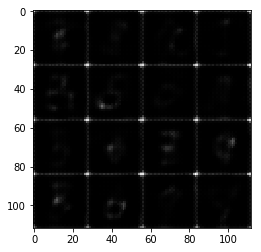

Epoch 1/2... Discriminator Loss: 1.3469... Generator Loss: 2.2937
Epoch 1/2... Discriminator Loss: 1.2718... Generator Loss: 0.5030
Epoch 1/2... Discriminator Loss: 0.7611... Generator Loss: 1.5752
Epoch 1/2... Discriminator Loss: 0.8251... Generator Loss: 1.0322
Epoch 1/2... Discriminator Loss: 0.9478... Generator Loss: 0.8758
Epoch 1/2... Discriminator Loss: 0.9860... Generator Loss: 1.0085
Epoch 1/2... Discriminator Loss: 1.2422... Generator Loss: 0.6505
Epoch 1/2... Discriminator Loss: 1.3344... Generator Loss: 0.6934
Epoch 1/2... Discriminator Loss: 1.0305... Generator Loss: 1.2462
Epoch 1/2... Discriminator Loss: 1.1835... Generator Loss: 0.7007


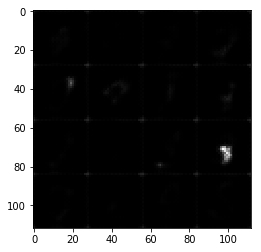

Epoch 1/2... Discriminator Loss: 1.2435... Generator Loss: 0.8725
Epoch 1/2... Discriminator Loss: 1.2567... Generator Loss: 0.8969
Epoch 1/2... Discriminator Loss: 1.3132... Generator Loss: 0.5627
Epoch 1/2... Discriminator Loss: 1.3082... Generator Loss: 1.6700
Epoch 1/2... Discriminator Loss: 0.9220... Generator Loss: 0.7973
Epoch 1/2... Discriminator Loss: 0.4622... Generator Loss: 2.7612
Epoch 1/2... Discriminator Loss: 1.1694... Generator Loss: 0.6029
Epoch 1/2... Discriminator Loss: 0.5900... Generator Loss: 2.3237
Epoch 1/2... Discriminator Loss: 0.6054... Generator Loss: 1.4007
Epoch 1/2... Discriminator Loss: 0.7386... Generator Loss: 1.1778


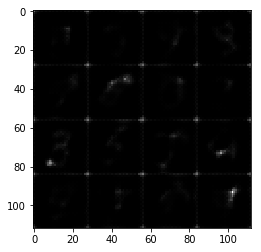

Epoch 1/2... Discriminator Loss: 0.9868... Generator Loss: 1.0295
Epoch 1/2... Discriminator Loss: 1.1160... Generator Loss: 0.8562
Epoch 1/2... Discriminator Loss: 1.0836... Generator Loss: 2.2474
Epoch 1/2... Discriminator Loss: 1.4142... Generator Loss: 0.4156
Epoch 1/2... Discriminator Loss: 0.9470... Generator Loss: 1.5823
Epoch 1/2... Discriminator Loss: 1.3409... Generator Loss: 0.6089
Epoch 1/2... Discriminator Loss: 1.0268... Generator Loss: 1.5026
Epoch 1/2... Discriminator Loss: 1.1353... Generator Loss: 0.6749
Epoch 1/2... Discriminator Loss: 1.0637... Generator Loss: 1.1585
Epoch 1/2... Discriminator Loss: 1.1621... Generator Loss: 0.6951


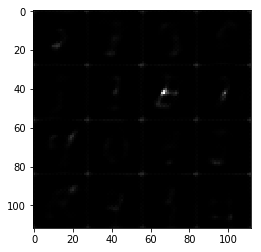

Epoch 1/2... Discriminator Loss: 0.9493... Generator Loss: 1.0368
Epoch 1/2... Discriminator Loss: 1.0269... Generator Loss: 1.0111
Epoch 1/2... Discriminator Loss: 1.5029... Generator Loss: 0.3560
Epoch 1/2... Discriminator Loss: 1.2524... Generator Loss: 1.9806
Epoch 1/2... Discriminator Loss: 1.9101... Generator Loss: 0.2443
Epoch 1/2... Discriminator Loss: 1.3158... Generator Loss: 1.3438
Epoch 1/2... Discriminator Loss: 1.2552... Generator Loss: 0.7007
Epoch 1/2... Discriminator Loss: 1.2073... Generator Loss: 1.0946
Epoch 1/2... Discriminator Loss: 1.2556... Generator Loss: 0.5659
Epoch 1/2... Discriminator Loss: 0.9647... Generator Loss: 2.2517


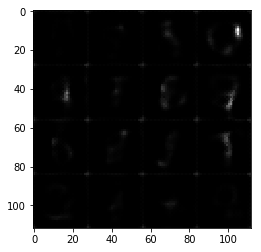

Epoch 1/2... Discriminator Loss: 1.4882... Generator Loss: 0.4883
Epoch 1/2... Discriminator Loss: 1.1061... Generator Loss: 1.2811
Epoch 1/2... Discriminator Loss: 1.1802... Generator Loss: 0.8317
Epoch 1/2... Discriminator Loss: 1.0872... Generator Loss: 0.9024
Epoch 1/2... Discriminator Loss: 0.7792... Generator Loss: 1.4499
Epoch 1/2... Discriminator Loss: 1.4549... Generator Loss: 0.4691
Epoch 1/2... Discriminator Loss: 0.9650... Generator Loss: 2.2806
Epoch 1/2... Discriminator Loss: 0.9667... Generator Loss: 0.8013
Epoch 1/2... Discriminator Loss: 1.1387... Generator Loss: 0.6156
Epoch 1/2... Discriminator Loss: 1.1057... Generator Loss: 1.6756


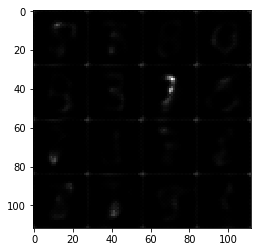

Epoch 1/2... Discriminator Loss: 0.6413... Generator Loss: 1.4536
Epoch 1/2... Discriminator Loss: 1.1342... Generator Loss: 0.5668
Epoch 1/2... Discriminator Loss: 0.8071... Generator Loss: 1.3113
Epoch 1/2... Discriminator Loss: 0.8707... Generator Loss: 1.3562
Epoch 1/2... Discriminator Loss: 1.5299... Generator Loss: 0.3523
Epoch 1/2... Discriminator Loss: 1.2888... Generator Loss: 2.9280
Epoch 1/2... Discriminator Loss: 1.5043... Generator Loss: 0.3823
Epoch 1/2... Discriminator Loss: 0.8994... Generator Loss: 2.1780
Epoch 1/2... Discriminator Loss: 0.9804... Generator Loss: 0.8670
Epoch 1/2... Discriminator Loss: 1.0600... Generator Loss: 0.8530


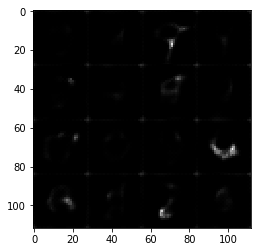

Epoch 1/2... Discriminator Loss: 0.9270... Generator Loss: 1.1049
Epoch 1/2... Discriminator Loss: 1.0089... Generator Loss: 0.8184
Epoch 1/2... Discriminator Loss: 1.0626... Generator Loss: 0.9515
Epoch 1/2... Discriminator Loss: 1.1857... Generator Loss: 0.5865
Epoch 1/2... Discriminator Loss: 1.1059... Generator Loss: 1.3780
Epoch 1/2... Discriminator Loss: 1.1565... Generator Loss: 0.7012
Epoch 1/2... Discriminator Loss: 0.9610... Generator Loss: 0.8727
Epoch 1/2... Discriminator Loss: 1.0077... Generator Loss: 0.9510
Epoch 1/2... Discriminator Loss: 1.0128... Generator Loss: 1.0691
Epoch 1/2... Discriminator Loss: 1.1741... Generator Loss: 0.5570


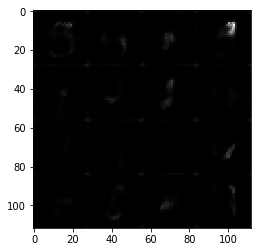

Epoch 1/2... Discriminator Loss: 1.0656... Generator Loss: 1.3069
Epoch 1/2... Discriminator Loss: 1.0524... Generator Loss: 0.8391
Epoch 1/2... Discriminator Loss: 1.1220... Generator Loss: 0.9426
Epoch 1/2... Discriminator Loss: 1.3173... Generator Loss: 0.5253
Epoch 1/2... Discriminator Loss: 1.2558... Generator Loss: 0.7179
Epoch 1/2... Discriminator Loss: 1.1613... Generator Loss: 1.0360
Epoch 1/2... Discriminator Loss: 1.1474... Generator Loss: 0.5758
Epoch 1/2... Discriminator Loss: 1.1035... Generator Loss: 1.0194
Epoch 1/2... Discriminator Loss: 1.1984... Generator Loss: 0.5719
Epoch 1/2... Discriminator Loss: 0.9909... Generator Loss: 1.3445


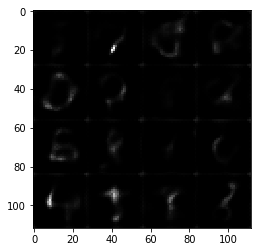

Epoch 1/2... Discriminator Loss: 1.2699... Generator Loss: 0.6044
Epoch 1/2... Discriminator Loss: 1.2108... Generator Loss: 1.1049
Epoch 1/2... Discriminator Loss: 1.2782... Generator Loss: 0.5459
Epoch 1/2... Discriminator Loss: 1.0409... Generator Loss: 1.3047
Epoch 1/2... Discriminator Loss: 1.2225... Generator Loss: 0.5304
Epoch 1/2... Discriminator Loss: 1.0745... Generator Loss: 1.5708
Epoch 1/2... Discriminator Loss: 1.3616... Generator Loss: 0.4084
Epoch 1/2... Discriminator Loss: 1.0274... Generator Loss: 1.5555
Epoch 1/2... Discriminator Loss: 1.2672... Generator Loss: 0.5120
Epoch 1/2... Discriminator Loss: 1.0454... Generator Loss: 1.6035


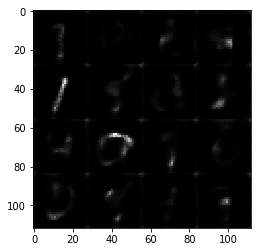

Epoch 1/2... Discriminator Loss: 1.1986... Generator Loss: 0.5375
Epoch 1/2... Discriminator Loss: 1.1280... Generator Loss: 1.1754
Epoch 1/2... Discriminator Loss: 1.3164... Generator Loss: 0.4996
Epoch 1/2... Discriminator Loss: 1.0565... Generator Loss: 1.1515
Epoch 1/2... Discriminator Loss: 1.0666... Generator Loss: 0.7512
Epoch 1/2... Discriminator Loss: 1.0878... Generator Loss: 0.9135
Epoch 1/2... Discriminator Loss: 1.1700... Generator Loss: 0.6991
Epoch 1/2... Discriminator Loss: 1.0456... Generator Loss: 0.8847
Epoch 1/2... Discriminator Loss: 1.0013... Generator Loss: 0.7801
Epoch 1/2... Discriminator Loss: 1.0796... Generator Loss: 1.0315


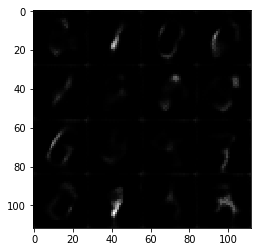

Epoch 1/2... Discriminator Loss: 1.1928... Generator Loss: 0.6442
Epoch 1/2... Discriminator Loss: 0.9379... Generator Loss: 1.3330
Epoch 1/2... Discriminator Loss: 1.4240... Generator Loss: 0.3792
Epoch 1/2... Discriminator Loss: 1.6660... Generator Loss: 2.2221
Epoch 1/2... Discriminator Loss: 1.6154... Generator Loss: 0.3294
Epoch 1/2... Discriminator Loss: 0.9082... Generator Loss: 1.9254
Epoch 1/2... Discriminator Loss: 1.0326... Generator Loss: 0.6296
Epoch 1/2... Discriminator Loss: 0.8270... Generator Loss: 1.1379
Epoch 1/2... Discriminator Loss: 0.8184... Generator Loss: 1.2128
Epoch 1/2... Discriminator Loss: 1.1658... Generator Loss: 0.5674


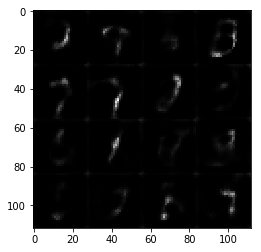

Epoch 1/2... Discriminator Loss: 1.1475... Generator Loss: 1.3748
Epoch 1/2... Discriminator Loss: 1.2600... Generator Loss: 0.5331
Epoch 1/2... Discriminator Loss: 1.2765... Generator Loss: 1.0928
Epoch 1/2... Discriminator Loss: 0.9602... Generator Loss: 0.8049
Epoch 1/2... Discriminator Loss: 1.0714... Generator Loss: 0.7920
Epoch 1/2... Discriminator Loss: 1.1046... Generator Loss: 1.0652
Epoch 1/2... Discriminator Loss: 1.2366... Generator Loss: 0.5815
Epoch 1/2... Discriminator Loss: 1.0178... Generator Loss: 0.8909
Epoch 1/2... Discriminator Loss: 1.0466... Generator Loss: 0.8861
Epoch 1/2... Discriminator Loss: 1.2133... Generator Loss: 0.5478


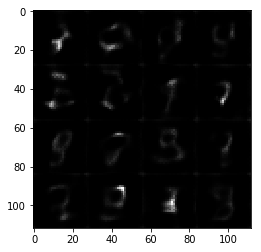

Epoch 1/2... Discriminator Loss: 1.3515... Generator Loss: 1.5186
Epoch 1/2... Discriminator Loss: 1.4891... Generator Loss: 0.3661
Epoch 1/2... Discriminator Loss: 1.4081... Generator Loss: 1.6658
Epoch 1/2... Discriminator Loss: 1.1455... Generator Loss: 0.6793
Epoch 1/2... Discriminator Loss: 1.0702... Generator Loss: 0.7594
Epoch 1/2... Discriminator Loss: 1.1166... Generator Loss: 1.1344
Epoch 1/2... Discriminator Loss: 1.4322... Generator Loss: 0.4146
Epoch 1/2... Discriminator Loss: 1.1813... Generator Loss: 1.3395
Epoch 1/2... Discriminator Loss: 1.2483... Generator Loss: 0.4818
Epoch 1/2... Discriminator Loss: 1.1579... Generator Loss: 1.1477


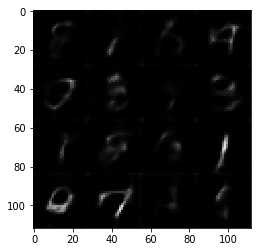

Epoch 1/2... Discriminator Loss: 1.1422... Generator Loss: 0.7178
Epoch 1/2... Discriminator Loss: 1.0859... Generator Loss: 0.7636
Epoch 1/2... Discriminator Loss: 1.1810... Generator Loss: 1.2341
Epoch 1/2... Discriminator Loss: 1.3113... Generator Loss: 0.4450
Epoch 1/2... Discriminator Loss: 1.1446... Generator Loss: 1.1472
Epoch 1/2... Discriminator Loss: 1.1916... Generator Loss: 0.6699
Epoch 1/2... Discriminator Loss: 1.2394... Generator Loss: 0.7005
Epoch 1/2... Discriminator Loss: 1.1130... Generator Loss: 0.9828
Epoch 1/2... Discriminator Loss: 1.2161... Generator Loss: 0.5917
Epoch 1/2... Discriminator Loss: 1.0409... Generator Loss: 1.0733


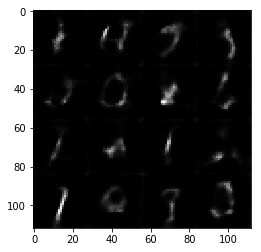

Epoch 1/2... Discriminator Loss: 1.2873... Generator Loss: 0.4936
Epoch 1/2... Discriminator Loss: 1.2265... Generator Loss: 1.4047
Epoch 1/2... Discriminator Loss: 1.2667... Generator Loss: 0.5393
Epoch 1/2... Discriminator Loss: 1.2369... Generator Loss: 1.0067
Epoch 1/2... Discriminator Loss: 1.4658... Generator Loss: 0.4023
Epoch 1/2... Discriminator Loss: 1.4573... Generator Loss: 1.8977
Epoch 1/2... Discriminator Loss: 1.5466... Generator Loss: 0.3852
Epoch 1/2... Discriminator Loss: 1.2182... Generator Loss: 0.9724
Epoch 1/2... Discriminator Loss: 1.0512... Generator Loss: 1.0970
Epoch 1/2... Discriminator Loss: 1.3967... Generator Loss: 0.4179


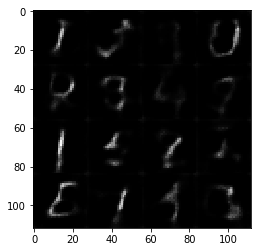

Epoch 1/2... Discriminator Loss: 1.3581... Generator Loss: 1.1978
Epoch 1/2... Discriminator Loss: 1.1012... Generator Loss: 0.6797
Epoch 1/2... Discriminator Loss: 1.0485... Generator Loss: 0.8926
Epoch 1/2... Discriminator Loss: 1.2129... Generator Loss: 0.7120
Epoch 1/2... Discriminator Loss: 1.0756... Generator Loss: 0.8406
Epoch 1/2... Discriminator Loss: 1.1273... Generator Loss: 0.8417
Epoch 1/2... Discriminator Loss: 1.1288... Generator Loss: 0.6173
Epoch 1/2... Discriminator Loss: 1.0952... Generator Loss: 1.0318
Epoch 1/2... Discriminator Loss: 1.0919... Generator Loss: 0.7467
Epoch 1/2... Discriminator Loss: 1.2316... Generator Loss: 0.8586


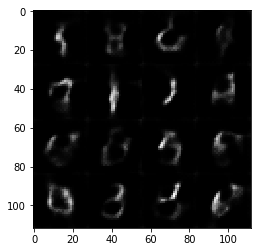

Epoch 1/2... Discriminator Loss: 1.2017... Generator Loss: 0.6015
Epoch 1/2... Discriminator Loss: 1.1542... Generator Loss: 0.9810
Epoch 1/2... Discriminator Loss: 1.2621... Generator Loss: 0.5599
Epoch 1/2... Discriminator Loss: 1.2119... Generator Loss: 1.3163
Epoch 1/2... Discriminator Loss: 1.6195... Generator Loss: 0.3123
Epoch 1/2... Discriminator Loss: 1.3300... Generator Loss: 1.4883
Epoch 1/2... Discriminator Loss: 1.2364... Generator Loss: 0.5061
Epoch 1/2... Discriminator Loss: 1.1618... Generator Loss: 1.3459
Epoch 1/2... Discriminator Loss: 1.1573... Generator Loss: 0.5939
Epoch 1/2... Discriminator Loss: 0.9853... Generator Loss: 0.8665


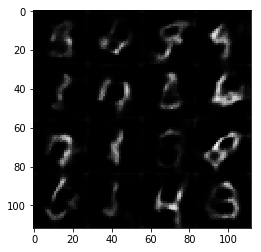

Epoch 1/2... Discriminator Loss: 1.0862... Generator Loss: 0.9186
Epoch 1/2... Discriminator Loss: 1.1041... Generator Loss: 0.8435
Epoch 1/2... Discriminator Loss: 1.3152... Generator Loss: 0.5562
Epoch 1/2... Discriminator Loss: 1.0882... Generator Loss: 1.1995
Epoch 1/2... Discriminator Loss: 1.2389... Generator Loss: 0.6575
Epoch 1/2... Discriminator Loss: 1.0505... Generator Loss: 0.9296
Epoch 1/2... Discriminator Loss: 1.0444... Generator Loss: 0.8510
Epoch 1/2... Discriminator Loss: 1.0322... Generator Loss: 0.7965
Epoch 1/2... Discriminator Loss: 1.0975... Generator Loss: 0.7871
Epoch 1/2... Discriminator Loss: 1.0809... Generator Loss: 0.7592


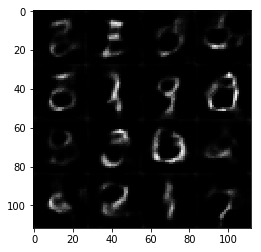

Epoch 1/2... Discriminator Loss: 1.0678... Generator Loss: 0.8669
Epoch 1/2... Discriminator Loss: 1.0322... Generator Loss: 1.0052
Epoch 1/2... Discriminator Loss: 1.2408... Generator Loss: 0.5186
Epoch 1/2... Discriminator Loss: 1.0946... Generator Loss: 1.3068
Epoch 1/2... Discriminator Loss: 1.4459... Generator Loss: 0.3935
Epoch 1/2... Discriminator Loss: 1.1635... Generator Loss: 1.3365
Epoch 1/2... Discriminator Loss: 1.1404... Generator Loss: 0.5679
Epoch 1/2... Discriminator Loss: 1.0735... Generator Loss: 1.1963
Epoch 1/2... Discriminator Loss: 1.1508... Generator Loss: 0.6252
Epoch 1/2... Discriminator Loss: 1.1351... Generator Loss: 1.0905


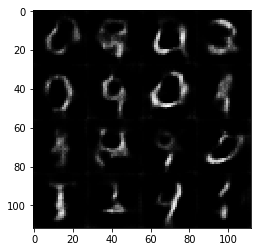

Epoch 1/2... Discriminator Loss: 1.2083... Generator Loss: 0.5413
Epoch 1/2... Discriminator Loss: 1.0202... Generator Loss: 1.5552
Epoch 1/2... Discriminator Loss: 1.4092... Generator Loss: 0.3887
Epoch 1/2... Discriminator Loss: 1.2705... Generator Loss: 1.5442
Epoch 1/2... Discriminator Loss: 1.1815... Generator Loss: 0.8158
Epoch 1/2... Discriminator Loss: 1.4798... Generator Loss: 0.3537
Epoch 1/2... Discriminator Loss: 1.3162... Generator Loss: 1.5741
Epoch 1/2... Discriminator Loss: 1.2298... Generator Loss: 0.5265
Epoch 1/2... Discriminator Loss: 1.0616... Generator Loss: 0.9134
Epoch 1/2... Discriminator Loss: 1.1166... Generator Loss: 1.0708


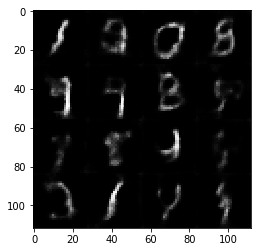

Epoch 1/2... Discriminator Loss: 1.2232... Generator Loss: 0.5328
Epoch 1/2... Discriminator Loss: 1.1820... Generator Loss: 0.8552
Epoch 1/2... Discriminator Loss: 1.0737... Generator Loss: 0.7659
Epoch 1/2... Discriminator Loss: 0.9691... Generator Loss: 1.1907
Epoch 1/2... Discriminator Loss: 1.2366... Generator Loss: 0.5593
Epoch 1/2... Discriminator Loss: 1.2194... Generator Loss: 1.3712
Epoch 1/2... Discriminator Loss: 1.4188... Generator Loss: 0.4101
Epoch 1/2... Discriminator Loss: 1.1716... Generator Loss: 1.1923
Epoch 1/2... Discriminator Loss: 1.1503... Generator Loss: 0.7105
Epoch 1/2... Discriminator Loss: 1.0655... Generator Loss: 0.9335


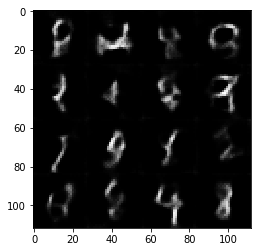

Epoch 1/2... Discriminator Loss: 1.0869... Generator Loss: 0.8314
Epoch 1/2... Discriminator Loss: 1.1837... Generator Loss: 0.7084
Epoch 1/2... Discriminator Loss: 1.1699... Generator Loss: 0.8342
Epoch 1/2... Discriminator Loss: 1.1227... Generator Loss: 0.6368
Epoch 1/2... Discriminator Loss: 1.1717... Generator Loss: 1.0508
Epoch 1/2... Discriminator Loss: 1.0971... Generator Loss: 0.6278
Epoch 1/2... Discriminator Loss: 1.1226... Generator Loss: 1.0596
Epoch 1/2... Discriminator Loss: 1.2786... Generator Loss: 0.5095
Epoch 1/2... Discriminator Loss: 1.1243... Generator Loss: 1.3318
Epoch 1/2... Discriminator Loss: 1.3425... Generator Loss: 0.4254


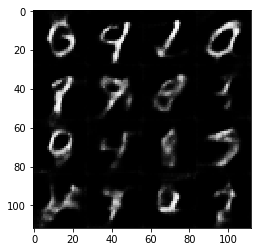

Epoch 1/2... Discriminator Loss: 1.1613... Generator Loss: 1.8085
Epoch 1/2... Discriminator Loss: 1.3158... Generator Loss: 0.4267
Epoch 1/2... Discriminator Loss: 0.9775... Generator Loss: 1.0843
Epoch 1/2... Discriminator Loss: 1.0880... Generator Loss: 0.7643
Epoch 1/2... Discriminator Loss: 1.0522... Generator Loss: 1.0155
Epoch 1/2... Discriminator Loss: 1.0548... Generator Loss: 0.8838
Epoch 1/2... Discriminator Loss: 1.1434... Generator Loss: 0.5900
Epoch 1/2... Discriminator Loss: 0.9944... Generator Loss: 1.0977
Epoch 1/2... Discriminator Loss: 1.0859... Generator Loss: 0.6172
Epoch 1/2... Discriminator Loss: 1.0460... Generator Loss: 1.3913


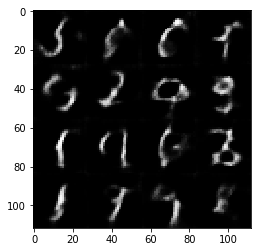

Epoch 1/2... Discriminator Loss: 1.3489... Generator Loss: 0.4565
Epoch 1/2... Discriminator Loss: 1.1477... Generator Loss: 1.3962
Epoch 1/2... Discriminator Loss: 1.1055... Generator Loss: 0.6384
Epoch 1/2... Discriminator Loss: 0.9645... Generator Loss: 1.0052
Epoch 1/2... Discriminator Loss: 1.1645... Generator Loss: 0.6108
Epoch 1/2... Discriminator Loss: 1.1481... Generator Loss: 1.1635
Epoch 1/2... Discriminator Loss: 1.0571... Generator Loss: 0.6940
Epoch 1/2... Discriminator Loss: 0.9841... Generator Loss: 1.1173
Epoch 1/2... Discriminator Loss: 1.1605... Generator Loss: 0.5676
Epoch 1/2... Discriminator Loss: 1.0131... Generator Loss: 1.3477


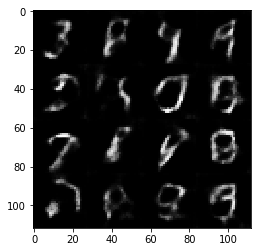

Epoch 1/2... Discriminator Loss: 1.2545... Generator Loss: 0.4986
Epoch 1/2... Discriminator Loss: 1.0479... Generator Loss: 1.2820
Epoch 1/2... Discriminator Loss: 1.3225... Generator Loss: 0.4504
Epoch 1/2... Discriminator Loss: 1.0922... Generator Loss: 1.3028
Epoch 1/2... Discriminator Loss: 1.2554... Generator Loss: 0.4464
Epoch 1/2... Discriminator Loss: 1.1719... Generator Loss: 1.1713
Epoch 1/2... Discriminator Loss: 1.0214... Generator Loss: 0.7877
Epoch 1/2... Discriminator Loss: 1.1626... Generator Loss: 0.6704
Epoch 1/2... Discriminator Loss: 1.1849... Generator Loss: 0.9838
Epoch 1/2... Discriminator Loss: 1.1195... Generator Loss: 0.5818


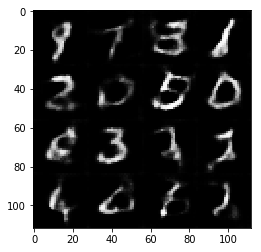

Epoch 1/2... Discriminator Loss: 1.1816... Generator Loss: 1.7242
Epoch 1/2... Discriminator Loss: 1.6819... Generator Loss: 0.2683
Epoch 1/2... Discriminator Loss: 1.1233... Generator Loss: 1.7073
Epoch 1/2... Discriminator Loss: 1.0776... Generator Loss: 0.6380
Epoch 1/2... Discriminator Loss: 1.0089... Generator Loss: 0.8049
Epoch 1/2... Discriminator Loss: 1.0036... Generator Loss: 1.0066
Epoch 1/2... Discriminator Loss: 1.1470... Generator Loss: 0.6042
Epoch 1/2... Discriminator Loss: 1.0576... Generator Loss: 1.4500
Epoch 1/2... Discriminator Loss: 0.9482... Generator Loss: 0.7186
Epoch 1/2... Discriminator Loss: 0.9497... Generator Loss: 0.9289


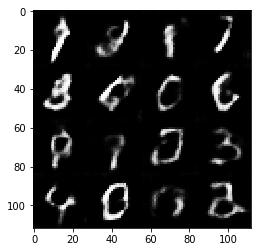

Epoch 1/2... Discriminator Loss: 1.1832... Generator Loss: 0.7197
Epoch 1/2... Discriminator Loss: 1.0504... Generator Loss: 1.1105
Epoch 1/2... Discriminator Loss: 1.1405... Generator Loss: 0.6061
Epoch 1/2... Discriminator Loss: 0.8969... Generator Loss: 1.4370
Epoch 1/2... Discriminator Loss: 1.1482... Generator Loss: 0.5188
Epoch 1/2... Discriminator Loss: 1.0933... Generator Loss: 1.3186
Epoch 1/2... Discriminator Loss: 1.1833... Generator Loss: 0.5222
Epoch 1/2... Discriminator Loss: 0.9860... Generator Loss: 1.2595
Epoch 1/2... Discriminator Loss: 1.2075... Generator Loss: 0.4912
Epoch 1/2... Discriminator Loss: 1.0636... Generator Loss: 1.5609


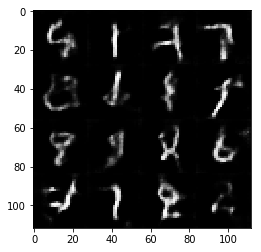

Epoch 1/2... Discriminator Loss: 1.2145... Generator Loss: 0.5281
Epoch 1/2... Discriminator Loss: 1.0937... Generator Loss: 0.7887
Epoch 1/2... Discriminator Loss: 1.0204... Generator Loss: 1.5042
Epoch 1/2... Discriminator Loss: 1.4166... Generator Loss: 0.3892
Epoch 1/2... Discriminator Loss: 0.9161... Generator Loss: 1.4709
Epoch 1/2... Discriminator Loss: 0.8881... Generator Loss: 0.9439
Epoch 1/2... Discriminator Loss: 1.1123... Generator Loss: 0.6780
Epoch 1/2... Discriminator Loss: 0.9708... Generator Loss: 1.1402
Epoch 1/2... Discriminator Loss: 1.1717... Generator Loss: 0.6770
Epoch 1/2... Discriminator Loss: 1.0273... Generator Loss: 0.8792


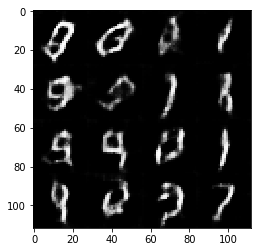

Epoch 1/2... Discriminator Loss: 0.8468... Generator Loss: 1.1227
Epoch 1/2... Discriminator Loss: 1.0840... Generator Loss: 0.7202
Epoch 1/2... Discriminator Loss: 1.1342... Generator Loss: 0.6674
Epoch 1/2... Discriminator Loss: 1.1034... Generator Loss: 1.2903
Epoch 1/2... Discriminator Loss: 1.2018... Generator Loss: 0.5334
Epoch 1/2... Discriminator Loss: 1.0852... Generator Loss: 1.2465
Epoch 1/2... Discriminator Loss: 1.1406... Generator Loss: 0.5709
Epoch 1/2... Discriminator Loss: 0.8760... Generator Loss: 1.1955
Epoch 1/2... Discriminator Loss: 1.0464... Generator Loss: 0.8540
Epoch 1/2... Discriminator Loss: 0.9389... Generator Loss: 0.9109


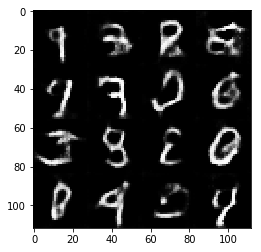

Epoch 1/2... Discriminator Loss: 0.9863... Generator Loss: 0.8099
Epoch 1/2... Discriminator Loss: 1.1269... Generator Loss: 0.6885
Epoch 1/2... Discriminator Loss: 0.9942... Generator Loss: 1.0481
Epoch 1/2... Discriminator Loss: 1.2419... Generator Loss: 0.4958
Epoch 1/2... Discriminator Loss: 1.2093... Generator Loss: 1.7250
Epoch 1/2... Discriminator Loss: 1.5234... Generator Loss: 0.3422
Epoch 1/2... Discriminator Loss: 0.9626... Generator Loss: 1.8506
Epoch 1/2... Discriminator Loss: 1.3073... Generator Loss: 0.4729
Epoch 1/2... Discriminator Loss: 0.8732... Generator Loss: 1.3651
Epoch 1/2... Discriminator Loss: 0.8562... Generator Loss: 0.9705


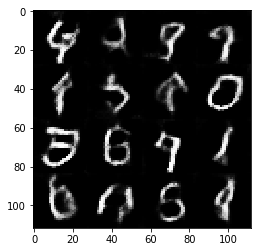

Epoch 1/2... Discriminator Loss: 0.9059... Generator Loss: 0.8914
Epoch 1/2... Discriminator Loss: 0.9096... Generator Loss: 0.9337
Epoch 1/2... Discriminator Loss: 0.9994... Generator Loss: 0.9031
Epoch 1/2... Discriminator Loss: 1.1741... Generator Loss: 0.5680
Epoch 1/2... Discriminator Loss: 1.1470... Generator Loss: 1.4190
Epoch 1/2... Discriminator Loss: 1.4762... Generator Loss: 0.3477
Epoch 1/2... Discriminator Loss: 1.1793... Generator Loss: 1.7546
Epoch 1/2... Discriminator Loss: 0.9631... Generator Loss: 0.8213
Epoch 1/2... Discriminator Loss: 1.2888... Generator Loss: 0.4519
Epoch 1/2... Discriminator Loss: 1.2233... Generator Loss: 1.4838


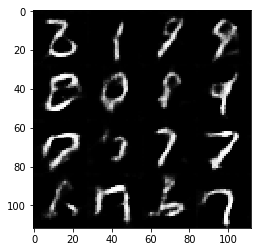

Epoch 1/2... Discriminator Loss: 1.1557... Generator Loss: 0.5095
Epoch 1/2... Discriminator Loss: 0.9883... Generator Loss: 1.5402
Epoch 1/2... Discriminator Loss: 1.2278... Generator Loss: 0.4819
Epoch 1/2... Discriminator Loss: 1.1121... Generator Loss: 1.2365
Epoch 1/2... Discriminator Loss: 1.2237... Generator Loss: 0.5154
Epoch 1/2... Discriminator Loss: 1.0997... Generator Loss: 1.2692
Epoch 1/2... Discriminator Loss: 1.2042... Generator Loss: 0.4963
Epoch 1/2... Discriminator Loss: 0.9368... Generator Loss: 1.3118
Epoch 1/2... Discriminator Loss: 1.1493... Generator Loss: 0.6044
Epoch 1/2... Discriminator Loss: 1.0998... Generator Loss: 0.9295


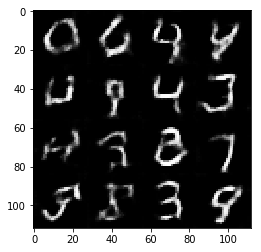

Epoch 1/2... Discriminator Loss: 1.2367... Generator Loss: 0.5401
Epoch 1/2... Discriminator Loss: 1.0656... Generator Loss: 1.2981
Epoch 1/2... Discriminator Loss: 1.4469... Generator Loss: 0.3977
Epoch 1/2... Discriminator Loss: 1.0740... Generator Loss: 1.4933
Epoch 1/2... Discriminator Loss: 1.0834... Generator Loss: 0.6021
Epoch 1/2... Discriminator Loss: 0.9843... Generator Loss: 0.9456
Epoch 1/2... Discriminator Loss: 1.0175... Generator Loss: 0.7597
Epoch 1/2... Discriminator Loss: 1.0707... Generator Loss: 0.7900
Epoch 1/2... Discriminator Loss: 0.9785... Generator Loss: 0.9198
Epoch 1/2... Discriminator Loss: 1.0954... Generator Loss: 0.6473


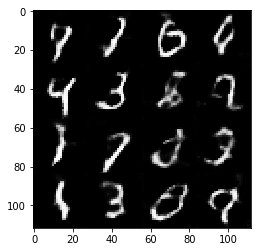

Epoch 1/2... Discriminator Loss: 1.0410... Generator Loss: 0.8652
Epoch 1/2... Discriminator Loss: 0.9593... Generator Loss: 1.1313
Epoch 1/2... Discriminator Loss: 1.1290... Generator Loss: 0.5901
Epoch 1/2... Discriminator Loss: 1.1537... Generator Loss: 1.1807
Epoch 1/2... Discriminator Loss: 1.3711... Generator Loss: 0.4143
Epoch 1/2... Discriminator Loss: 0.9501... Generator Loss: 1.1667
Epoch 1/2... Discriminator Loss: 1.0531... Generator Loss: 0.7318
Epoch 1/2... Discriminator Loss: 1.0778... Generator Loss: 0.7148
Epoch 1/2... Discriminator Loss: 1.0450... Generator Loss: 1.1064
Epoch 1/2... Discriminator Loss: 1.1181... Generator Loss: 0.5884


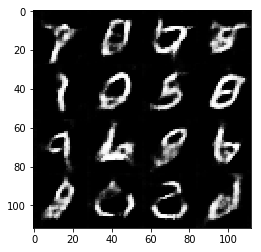

Epoch 1/2... Discriminator Loss: 1.0235... Generator Loss: 0.9757
Epoch 1/2... Discriminator Loss: 0.9193... Generator Loss: 1.1919
Epoch 1/2... Discriminator Loss: 1.1351... Generator Loss: 0.5459
Epoch 1/2... Discriminator Loss: 0.8875... Generator Loss: 1.7105
Epoch 1/2... Discriminator Loss: 1.3250... Generator Loss: 0.4046
Epoch 1/2... Discriminator Loss: 1.2134... Generator Loss: 1.9916
Epoch 1/2... Discriminator Loss: 1.0331... Generator Loss: 0.6832
Epoch 1/2... Discriminator Loss: 0.8388... Generator Loss: 0.8712
Epoch 1/2... Discriminator Loss: 1.0561... Generator Loss: 1.3494
Epoch 1/2... Discriminator Loss: 1.0648... Generator Loss: 0.6615


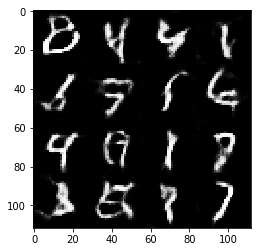

Epoch 1/2... Discriminator Loss: 0.8168... Generator Loss: 1.1369
Epoch 1/2... Discriminator Loss: 0.8846... Generator Loss: 1.2178
Epoch 1/2... Discriminator Loss: 1.4295... Generator Loss: 0.4061
Epoch 1/2... Discriminator Loss: 1.0196... Generator Loss: 2.0715
Epoch 1/2... Discriminator Loss: 1.3573... Generator Loss: 0.4052
Epoch 1/2... Discriminator Loss: 0.9493... Generator Loss: 1.8828
Epoch 1/2... Discriminator Loss: 1.2020... Generator Loss: 0.5183
Epoch 1/2... Discriminator Loss: 0.7624... Generator Loss: 1.3555
Epoch 1/2... Discriminator Loss: 1.1090... Generator Loss: 0.5843
Epoch 1/2... Discriminator Loss: 0.8936... Generator Loss: 1.2645


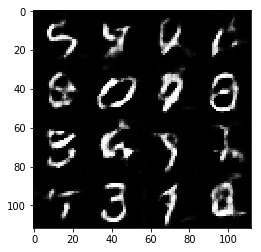

Epoch 1/2... Discriminator Loss: 1.0742... Generator Loss: 0.6829
Epoch 1/2... Discriminator Loss: 0.9445... Generator Loss: 1.3861
Epoch 1/2... Discriminator Loss: 1.3047... Generator Loss: 0.4255
Epoch 1/2... Discriminator Loss: 1.1136... Generator Loss: 2.0837
Epoch 1/2... Discriminator Loss: 1.4577... Generator Loss: 0.3541
Epoch 1/2... Discriminator Loss: 0.8856... Generator Loss: 1.4648
Epoch 1/2... Discriminator Loss: 1.1495... Generator Loss: 0.6253
Epoch 1/2... Discriminator Loss: 1.0684... Generator Loss: 0.9814
Epoch 1/2... Discriminator Loss: 0.9587... Generator Loss: 0.9037
Epoch 1/2... Discriminator Loss: 1.2157... Generator Loss: 0.5905


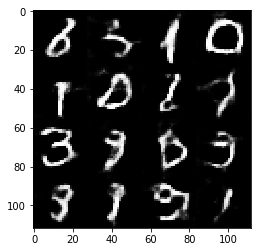

Epoch 1/2... Discriminator Loss: 0.8809... Generator Loss: 1.3871
Epoch 1/2... Discriminator Loss: 1.1950... Generator Loss: 0.5028
Epoch 1/2... Discriminator Loss: 1.1966... Generator Loss: 0.8225
Epoch 1/2... Discriminator Loss: 1.0843... Generator Loss: 0.8347
Epoch 1/2... Discriminator Loss: 1.2203... Generator Loss: 0.5828
Epoch 1/2... Discriminator Loss: 1.1042... Generator Loss: 1.0360
Epoch 1/2... Discriminator Loss: 1.0929... Generator Loss: 0.6825
Epoch 1/2... Discriminator Loss: 0.9780... Generator Loss: 0.8627
Epoch 1/2... Discriminator Loss: 1.0583... Generator Loss: 1.1683
Epoch 1/2... Discriminator Loss: 1.2012... Generator Loss: 0.5129


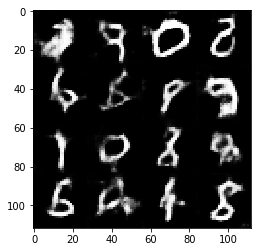

Epoch 1/2... Discriminator Loss: 0.9407... Generator Loss: 1.3393
Epoch 1/2... Discriminator Loss: 1.0492... Generator Loss: 0.6410
Epoch 1/2... Discriminator Loss: 0.9399... Generator Loss: 0.9502
Epoch 1/2... Discriminator Loss: 0.9417... Generator Loss: 1.0843
Epoch 1/2... Discriminator Loss: 1.0839... Generator Loss: 0.6677
Epoch 1/2... Discriminator Loss: 0.9174... Generator Loss: 1.2401
Epoch 1/2... Discriminator Loss: 0.8397... Generator Loss: 0.8804
Epoch 1/2... Discriminator Loss: 0.7831... Generator Loss: 1.1136
Epoch 1/2... Discriminator Loss: 0.9883... Generator Loss: 0.7875
Epoch 1/2... Discriminator Loss: 0.8505... Generator Loss: 1.2906


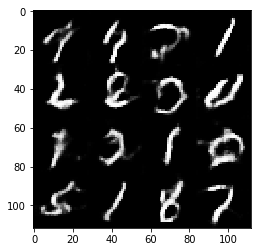

Epoch 1/2... Discriminator Loss: 1.2440... Generator Loss: 0.4655
Epoch 1/2... Discriminator Loss: 1.1072... Generator Loss: 1.9409
Epoch 1/2... Discriminator Loss: 1.6682... Generator Loss: 0.3000
Epoch 1/2... Discriminator Loss: 1.1958... Generator Loss: 2.2762
Epoch 1/2... Discriminator Loss: 1.4732... Generator Loss: 0.4589
Epoch 1/2... Discriminator Loss: 1.0676... Generator Loss: 1.0591
Epoch 1/2... Discriminator Loss: 1.1241... Generator Loss: 0.8455
Epoch 1/2... Discriminator Loss: 0.8660... Generator Loss: 0.9804
Epoch 1/2... Discriminator Loss: 1.1111... Generator Loss: 0.6091
Epoch 1/2... Discriminator Loss: 1.1030... Generator Loss: 1.2268


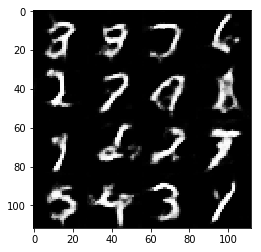

Epoch 1/2... Discriminator Loss: 1.2175... Generator Loss: 0.5246
Epoch 1/2... Discriminator Loss: 0.9781... Generator Loss: 1.2274
Epoch 1/2... Discriminator Loss: 1.3314... Generator Loss: 0.4529
Epoch 1/2... Discriminator Loss: 0.8995... Generator Loss: 1.2639
Epoch 1/2... Discriminator Loss: 1.0961... Generator Loss: 0.7569
Epoch 1/2... Discriminator Loss: 1.0777... Generator Loss: 0.7539
Epoch 1/2... Discriminator Loss: 0.9316... Generator Loss: 1.0871
Epoch 1/2... Discriminator Loss: 1.1071... Generator Loss: 0.5876
Epoch 1/2... Discriminator Loss: 0.8242... Generator Loss: 1.3012
Epoch 1/2... Discriminator Loss: 1.2184... Generator Loss: 0.5449


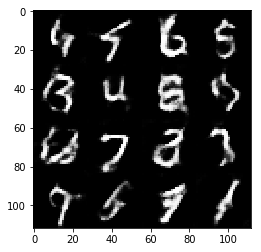

Epoch 1/2... Discriminator Loss: 1.0558... Generator Loss: 1.2230
Epoch 1/2... Discriminator Loss: 0.9109... Generator Loss: 0.9429
Epoch 1/2... Discriminator Loss: 1.2733... Generator Loss: 0.4778
Epoch 1/2... Discriminator Loss: 1.1372... Generator Loss: 1.3827
Epoch 1/2... Discriminator Loss: 1.1662... Generator Loss: 0.5820
Epoch 1/2... Discriminator Loss: 1.0231... Generator Loss: 1.1332
Epoch 1/2... Discriminator Loss: 1.2200... Generator Loss: 0.5044
Epoch 1/2... Discriminator Loss: 0.9798... Generator Loss: 1.2185
Epoch 1/2... Discriminator Loss: 0.9742... Generator Loss: 0.8342
Epoch 1/2... Discriminator Loss: 1.0259... Generator Loss: 0.7394


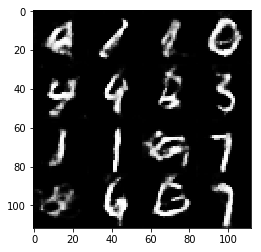

Epoch 1/2... Discriminator Loss: 1.0111... Generator Loss: 0.9691
Epoch 1/2... Discriminator Loss: 1.3512... Generator Loss: 0.4051
Epoch 1/2... Discriminator Loss: 1.3060... Generator Loss: 2.0660
Epoch 1/2... Discriminator Loss: 1.5398... Generator Loss: 0.3344
Epoch 1/2... Discriminator Loss: 0.9543... Generator Loss: 1.2703
Epoch 1/2... Discriminator Loss: 0.9676... Generator Loss: 1.0599
Epoch 1/2... Discriminator Loss: 1.4059... Generator Loss: 0.4376
Epoch 1/2... Discriminator Loss: 0.9999... Generator Loss: 1.9347
Epoch 1/2... Discriminator Loss: 1.2876... Generator Loss: 0.4433
Epoch 1/2... Discriminator Loss: 0.8371... Generator Loss: 1.2465


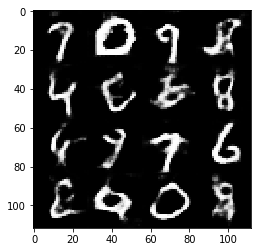

Epoch 1/2... Discriminator Loss: 0.9037... Generator Loss: 0.9896
Epoch 1/2... Discriminator Loss: 1.0852... Generator Loss: 0.5719
Epoch 1/2... Discriminator Loss: 1.0671... Generator Loss: 1.1978
Epoch 1/2... Discriminator Loss: 1.2398... Generator Loss: 0.5182
Epoch 1/2... Discriminator Loss: 0.9866... Generator Loss: 1.0496
Epoch 1/2... Discriminator Loss: 1.0970... Generator Loss: 0.6828
Epoch 1/2... Discriminator Loss: 0.9280... Generator Loss: 0.7954
Epoch 1/2... Discriminator Loss: 0.8872... Generator Loss: 0.8642
Epoch 1/2... Discriminator Loss: 0.9765... Generator Loss: 0.9397
Epoch 1/2... Discriminator Loss: 1.0171... Generator Loss: 0.7271


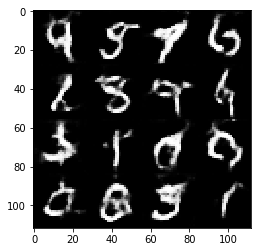

Epoch 1/2... Discriminator Loss: 1.1431... Generator Loss: 0.6517
Epoch 1/2... Discriminator Loss: 0.8556... Generator Loss: 1.2186
Epoch 1/2... Discriminator Loss: 1.2751... Generator Loss: 0.4319
Epoch 1/2... Discriminator Loss: 1.0538... Generator Loss: 1.2408
Epoch 1/2... Discriminator Loss: 0.9908... Generator Loss: 0.7838
Epoch 1/2... Discriminator Loss: 1.0790... Generator Loss: 0.6572
Epoch 1/2... Discriminator Loss: 0.9362... Generator Loss: 1.3630
Epoch 1/2... Discriminator Loss: 1.3932... Generator Loss: 0.3659
Epoch 1/2... Discriminator Loss: 1.0551... Generator Loss: 1.8797
Epoch 1/2... Discriminator Loss: 1.6491... Generator Loss: 0.3016


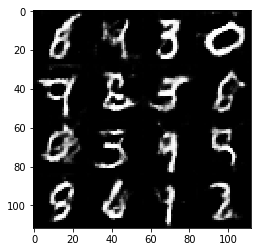

Epoch 1/2... Discriminator Loss: 1.4709... Generator Loss: 2.0337
Epoch 1/2... Discriminator Loss: 1.7830... Generator Loss: 0.2539
Epoch 1/2... Discriminator Loss: 2.3459... Generator Loss: 3.3149
Epoch 1/2... Discriminator Loss: 2.8851... Generator Loss: 0.0825
Epoch 1/2... Discriminator Loss: 1.2838... Generator Loss: 0.9882
Epoch 1/2... Discriminator Loss: 0.9854... Generator Loss: 1.4206
Epoch 1/2... Discriminator Loss: 1.3192... Generator Loss: 0.4578
Epoch 1/2... Discriminator Loss: 0.9476... Generator Loss: 0.9452
Epoch 1/2... Discriminator Loss: 0.9126... Generator Loss: 1.1506
Epoch 1/2... Discriminator Loss: 1.1284... Generator Loss: 0.6405


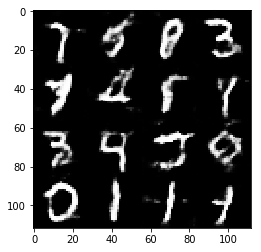

Epoch 1/2... Discriminator Loss: 0.9825... Generator Loss: 0.8541
Epoch 1/2... Discriminator Loss: 0.8678... Generator Loss: 0.9926
Epoch 1/2... Discriminator Loss: 1.0183... Generator Loss: 0.9867
Epoch 1/2... Discriminator Loss: 1.1564... Generator Loss: 0.6195
Epoch 1/2... Discriminator Loss: 1.0347... Generator Loss: 0.7784
Epoch 1/2... Discriminator Loss: 0.9131... Generator Loss: 0.9674
Epoch 1/2... Discriminator Loss: 1.0940... Generator Loss: 0.6183
Epoch 1/2... Discriminator Loss: 0.9875... Generator Loss: 0.8465
Epoch 1/2... Discriminator Loss: 0.9122... Generator Loss: 1.1262
Epoch 1/2... Discriminator Loss: 1.1168... Generator Loss: 0.5705


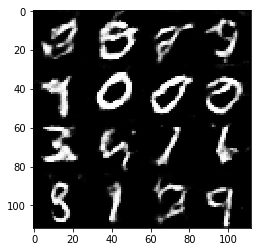

Epoch 1/2... Discriminator Loss: 0.9097... Generator Loss: 1.5310
Epoch 1/2... Discriminator Loss: 1.3935... Generator Loss: 0.4191
Epoch 1/2... Discriminator Loss: 0.9109... Generator Loss: 1.1000
Epoch 1/2... Discriminator Loss: 1.0710... Generator Loss: 0.7565
Epoch 1/2... Discriminator Loss: 1.0912... Generator Loss: 0.6646
Epoch 1/2... Discriminator Loss: 0.9492... Generator Loss: 1.1021
Epoch 1/2... Discriminator Loss: 1.0898... Generator Loss: 0.6139
Epoch 1/2... Discriminator Loss: 1.0433... Generator Loss: 0.9701
Epoch 1/2... Discriminator Loss: 0.9105... Generator Loss: 0.7537
Epoch 1/2... Discriminator Loss: 1.0565... Generator Loss: 0.7941


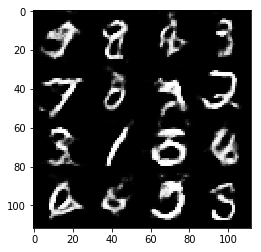

Epoch 1/2... Discriminator Loss: 0.8235... Generator Loss: 1.0321
Epoch 1/2... Discriminator Loss: 1.0828... Generator Loss: 0.6400
Epoch 1/2... Discriminator Loss: 1.0893... Generator Loss: 0.8679
Epoch 1/2... Discriminator Loss: 1.0923... Generator Loss: 0.5757
Epoch 1/2... Discriminator Loss: 1.0046... Generator Loss: 1.5264
Epoch 1/2... Discriminator Loss: 1.2258... Generator Loss: 0.4597
Epoch 1/2... Discriminator Loss: 0.8607... Generator Loss: 1.5157
Epoch 1/2... Discriminator Loss: 1.2009... Generator Loss: 0.5189
Epoch 1/2... Discriminator Loss: 0.9869... Generator Loss: 0.8127
Epoch 1/2... Discriminator Loss: 0.9222... Generator Loss: 1.1625


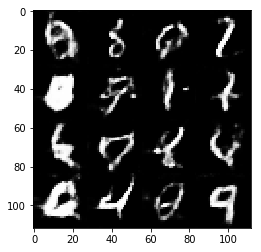

Epoch 1/2... Discriminator Loss: 1.3925... Generator Loss: 0.4053
Epoch 1/2... Discriminator Loss: 1.0857... Generator Loss: 1.1515
Epoch 1/2... Discriminator Loss: 1.1896... Generator Loss: 0.4901
Epoch 1/2... Discriminator Loss: 1.1824... Generator Loss: 1.3591
Epoch 1/2... Discriminator Loss: 1.3527... Generator Loss: 0.3987
Epoch 1/2... Discriminator Loss: 1.1886... Generator Loss: 1.5282
Epoch 1/2... Discriminator Loss: 1.5049... Generator Loss: 0.3330
Epoch 1/2... Discriminator Loss: 1.0245... Generator Loss: 1.7376
Epoch 1/2... Discriminator Loss: 1.1510... Generator Loss: 0.5501
Epoch 1/2... Discriminator Loss: 0.8947... Generator Loss: 1.0885


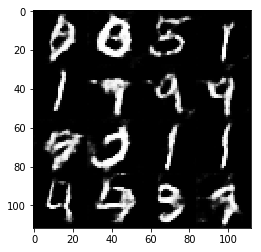

Epoch 1/2... Discriminator Loss: 1.1509... Generator Loss: 0.5862
Epoch 1/2... Discriminator Loss: 0.9559... Generator Loss: 0.9267
Epoch 1/2... Discriminator Loss: 1.0814... Generator Loss: 0.5969
Epoch 1/2... Discriminator Loss: 1.0163... Generator Loss: 1.3626
Epoch 1/2... Discriminator Loss: 1.2331... Generator Loss: 0.5268
Epoch 1/2... Discriminator Loss: 0.9480... Generator Loss: 1.1955
Epoch 1/2... Discriminator Loss: 1.0597... Generator Loss: 0.6257
Epoch 1/2... Discriminator Loss: 0.9246... Generator Loss: 1.1674
Epoch 1/2... Discriminator Loss: 1.2192... Generator Loss: 0.5271
Epoch 1/2... Discriminator Loss: 0.9664... Generator Loss: 1.0549


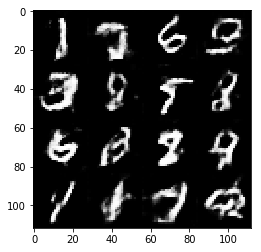

Epoch 1/2... Discriminator Loss: 1.2804... Generator Loss: 0.4691
Epoch 1/2... Discriminator Loss: 0.8071... Generator Loss: 1.4844
Epoch 1/2... Discriminator Loss: 0.7917... Generator Loss: 0.9460
Epoch 1/2... Discriminator Loss: 1.1335... Generator Loss: 0.5781
Epoch 1/2... Discriminator Loss: 0.9711... Generator Loss: 1.3639
Epoch 1/2... Discriminator Loss: 1.1738... Generator Loss: 0.5204
Epoch 1/2... Discriminator Loss: 1.1640... Generator Loss: 1.2014
Epoch 1/2... Discriminator Loss: 1.6491... Generator Loss: 0.2827
Epoch 1/2... Discriminator Loss: 1.9103... Generator Loss: 2.7070
Epoch 1/2... Discriminator Loss: 1.9502... Generator Loss: 0.2037


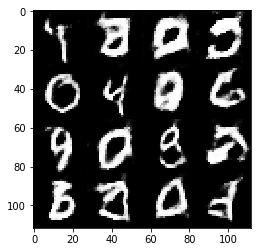

Epoch 1/2... Discriminator Loss: 3.0842... Generator Loss: 3.8516
Epoch 1/2... Discriminator Loss: 1.7892... Generator Loss: 0.3035
Epoch 1/2... Discriminator Loss: 1.2691... Generator Loss: 0.8609
Epoch 1/2... Discriminator Loss: 1.3191... Generator Loss: 1.0387
Epoch 1/2... Discriminator Loss: 1.3868... Generator Loss: 0.4766
Epoch 1/2... Discriminator Loss: 1.1116... Generator Loss: 1.1362
Epoch 1/2... Discriminator Loss: 1.0385... Generator Loss: 0.8176
Epoch 1/2... Discriminator Loss: 1.0455... Generator Loss: 0.8014
Epoch 1/2... Discriminator Loss: 1.0688... Generator Loss: 0.8217
Epoch 1/2... Discriminator Loss: 1.0817... Generator Loss: 0.9364


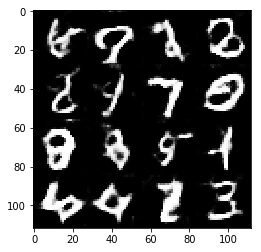

Epoch 1/2... Discriminator Loss: 1.1451... Generator Loss: 0.5967
Epoch 1/2... Discriminator Loss: 1.0062... Generator Loss: 1.1414
Epoch 1/2... Discriminator Loss: 1.1167... Generator Loss: 0.6104
Epoch 1/2... Discriminator Loss: 0.9655... Generator Loss: 0.9150
Epoch 1/2... Discriminator Loss: 1.0235... Generator Loss: 0.8335
Epoch 1/2... Discriminator Loss: 1.0538... Generator Loss: 0.8094
Epoch 1/2... Discriminator Loss: 1.1656... Generator Loss: 0.6403
Epoch 1/2... Discriminator Loss: 1.1776... Generator Loss: 0.8246
Epoch 1/2... Discriminator Loss: 1.0982... Generator Loss: 0.7091
Epoch 1/2... Discriminator Loss: 1.2608... Generator Loss: 0.7651


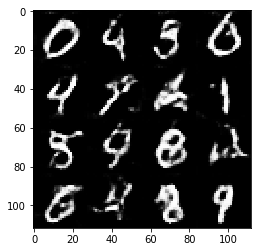

Epoch 1/2... Discriminator Loss: 1.1483... Generator Loss: 0.6444
Epoch 1/2... Discriminator Loss: 1.1354... Generator Loss: 0.7641
Epoch 1/2... Discriminator Loss: 0.9541... Generator Loss: 0.8168
Epoch 1/2... Discriminator Loss: 1.0292... Generator Loss: 0.7803
Epoch 1/2... Discriminator Loss: 0.8361... Generator Loss: 0.9895
Epoch 1/2... Discriminator Loss: 1.1091... Generator Loss: 0.5590
Epoch 1/2... Discriminator Loss: 0.9862... Generator Loss: 1.0074
Epoch 1/2... Discriminator Loss: 1.0771... Generator Loss: 0.7198
Epoch 1/2... Discriminator Loss: 1.0530... Generator Loss: 0.8137
Epoch 1/2... Discriminator Loss: 1.0266... Generator Loss: 0.7322


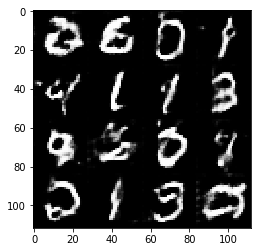

Epoch 1/2... Discriminator Loss: 1.1643... Generator Loss: 0.6066
Epoch 1/2... Discriminator Loss: 0.9725... Generator Loss: 1.1430
Epoch 1/2... Discriminator Loss: 1.0863... Generator Loss: 0.5685
Epoch 1/2... Discriminator Loss: 0.7782... Generator Loss: 1.4860
Epoch 1/2... Discriminator Loss: 0.9676... Generator Loss: 0.6355
Epoch 1/2... Discriminator Loss: 0.8872... Generator Loss: 1.3803
Epoch 1/2... Discriminator Loss: 1.2279... Generator Loss: 0.5166
Epoch 1/2... Discriminator Loss: 0.9682... Generator Loss: 0.9573
Epoch 1/2... Discriminator Loss: 0.8115... Generator Loss: 0.9330
Epoch 1/2... Discriminator Loss: 1.1653... Generator Loss: 0.5964


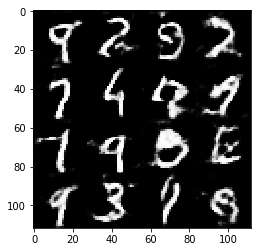

Epoch 1/2... Discriminator Loss: 0.9018... Generator Loss: 1.1229
Epoch 1/2... Discriminator Loss: 1.2819... Generator Loss: 0.5004
Epoch 1/2... Discriminator Loss: 0.9359... Generator Loss: 1.1432
Epoch 1/2... Discriminator Loss: 1.2140... Generator Loss: 0.5404
Epoch 1/2... Discriminator Loss: 0.9341... Generator Loss: 1.3040
Epoch 1/2... Discriminator Loss: 1.3942... Generator Loss: 0.3907
Epoch 1/2... Discriminator Loss: 0.9847... Generator Loss: 1.2452
Epoch 1/2... Discriminator Loss: 1.0782... Generator Loss: 0.6677
Epoch 1/2... Discriminator Loss: 0.8783... Generator Loss: 0.8979
Epoch 1/2... Discriminator Loss: 0.9336... Generator Loss: 0.8297


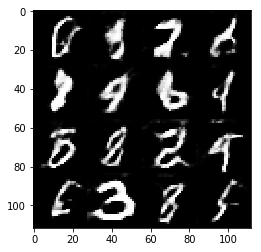

Epoch 1/2... Discriminator Loss: 1.1166... Generator Loss: 0.6553
Epoch 1/2... Discriminator Loss: 1.0749... Generator Loss: 0.7488
Epoch 1/2... Discriminator Loss: 1.1425... Generator Loss: 0.6100
Epoch 1/2... Discriminator Loss: 0.8498... Generator Loss: 0.9443
Epoch 1/2... Discriminator Loss: 1.1589... Generator Loss: 0.6339
Epoch 1/2... Discriminator Loss: 0.8327... Generator Loss: 1.0480
Epoch 1/2... Discriminator Loss: 1.1699... Generator Loss: 0.6242
Epoch 1/2... Discriminator Loss: 1.0735... Generator Loss: 0.6031
Epoch 1/2... Discriminator Loss: 1.0259... Generator Loss: 1.0498
Epoch 1/2... Discriminator Loss: 1.3835... Generator Loss: 0.3877


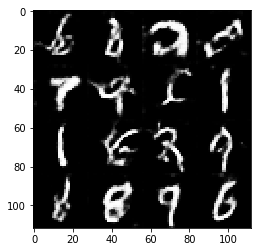

Epoch 1/2... Discriminator Loss: 0.7424... Generator Loss: 1.0914
Epoch 1/2... Discriminator Loss: 0.8839... Generator Loss: 0.8827
Epoch 1/2... Discriminator Loss: 0.9725... Generator Loss: 0.8025
Epoch 1/2... Discriminator Loss: 1.5554... Generator Loss: 0.3100
Epoch 1/2... Discriminator Loss: 1.0544... Generator Loss: 2.2133
Epoch 1/2... Discriminator Loss: 1.4828... Generator Loss: 0.3759
Epoch 1/2... Discriminator Loss: 1.1333... Generator Loss: 1.3668
Epoch 1/2... Discriminator Loss: 1.5156... Generator Loss: 0.3343
Epoch 1/2... Discriminator Loss: 0.9296... Generator Loss: 1.6824
Epoch 1/2... Discriminator Loss: 1.1208... Generator Loss: 0.6104


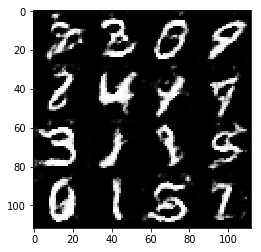

Epoch 1/2... Discriminator Loss: 1.0909... Generator Loss: 1.1275
Epoch 1/2... Discriminator Loss: 1.4640... Generator Loss: 0.3417
Epoch 1/2... Discriminator Loss: 1.4882... Generator Loss: 2.3235
Epoch 1/2... Discriminator Loss: 1.9539... Generator Loss: 0.2177
Epoch 1/2... Discriminator Loss: 0.9595... Generator Loss: 1.4124
Epoch 1/2... Discriminator Loss: 1.1699... Generator Loss: 0.5694
Epoch 1/2... Discriminator Loss: 1.1545... Generator Loss: 0.7867
Epoch 1/2... Discriminator Loss: 1.1139... Generator Loss: 0.8322
Epoch 1/2... Discriminator Loss: 1.3080... Generator Loss: 0.4624
Epoch 1/2... Discriminator Loss: 0.9161... Generator Loss: 1.1600


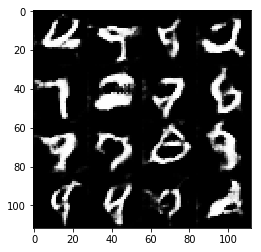

Epoch 1/2... Discriminator Loss: 1.1047... Generator Loss: 0.6081
Epoch 1/2... Discriminator Loss: 1.0281... Generator Loss: 0.8327
Epoch 1/2... Discriminator Loss: 1.0767... Generator Loss: 0.6824
Epoch 1/2... Discriminator Loss: 1.0357... Generator Loss: 0.7936
Epoch 1/2... Discriminator Loss: 0.8280... Generator Loss: 0.9603
Epoch 1/2... Discriminator Loss: 0.9644... Generator Loss: 0.7888
Epoch 1/2... Discriminator Loss: 0.9462... Generator Loss: 0.8086
Epoch 1/2... Discriminator Loss: 1.1667... Generator Loss: 0.5375
Epoch 1/2... Discriminator Loss: 0.8783... Generator Loss: 1.4329
Epoch 1/2... Discriminator Loss: 1.1538... Generator Loss: 0.5943


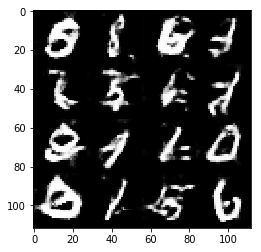

Epoch 1/2... Discriminator Loss: 0.9585... Generator Loss: 0.8097
Epoch 1/2... Discriminator Loss: 1.0485... Generator Loss: 0.9158
Epoch 1/2... Discriminator Loss: 1.3297... Generator Loss: 0.4468
Epoch 1/2... Discriminator Loss: 0.9150... Generator Loss: 1.7868
Epoch 1/2... Discriminator Loss: 1.2701... Generator Loss: 0.4485
Epoch 1/2... Discriminator Loss: 1.2548... Generator Loss: 0.9800
Epoch 1/2... Discriminator Loss: 1.4989... Generator Loss: 0.3669
Epoch 1/2... Discriminator Loss: 1.2124... Generator Loss: 2.0044
Epoch 1/2... Discriminator Loss: 1.4738... Generator Loss: 0.3843
Epoch 1/2... Discriminator Loss: 2.2439... Generator Loss: 2.6071


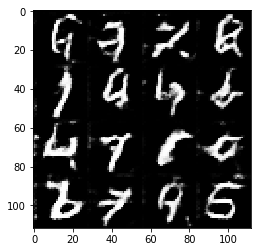

Epoch 1/2... Discriminator Loss: 2.8615... Generator Loss: 0.0918
Epoch 1/2... Discriminator Loss: 0.9666... Generator Loss: 1.3370
Epoch 1/2... Discriminator Loss: 1.1326... Generator Loss: 1.2309
Epoch 1/2... Discriminator Loss: 1.5432... Generator Loss: 0.3687
Epoch 1/2... Discriminator Loss: 1.1057... Generator Loss: 1.2744
Epoch 1/2... Discriminator Loss: 1.1915... Generator Loss: 0.6071
Epoch 1/2... Discriminator Loss: 0.9829... Generator Loss: 0.8731
Epoch 1/2... Discriminator Loss: 0.8466... Generator Loss: 1.1419
Epoch 1/2... Discriminator Loss: 1.1736... Generator Loss: 0.5266
Epoch 1/2... Discriminator Loss: 0.9144... Generator Loss: 1.3060


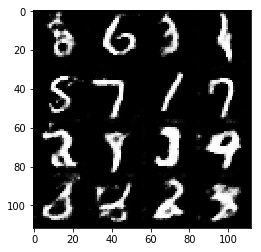

Epoch 1/2... Discriminator Loss: 1.2001... Generator Loss: 0.5191
Epoch 1/2... Discriminator Loss: 1.0429... Generator Loss: 0.8709
Epoch 1/2... Discriminator Loss: 0.9857... Generator Loss: 1.0056
Epoch 1/2... Discriminator Loss: 1.1389... Generator Loss: 0.5741
Epoch 1/2... Discriminator Loss: 0.8963... Generator Loss: 0.8228
Epoch 1/2... Discriminator Loss: 1.0036... Generator Loss: 0.9551
Epoch 1/2... Discriminator Loss: 1.1241... Generator Loss: 0.5960
Epoch 1/2... Discriminator Loss: 1.1837... Generator Loss: 0.9030
Epoch 1/2... Discriminator Loss: 1.4935... Generator Loss: 0.3371
Epoch 1/2... Discriminator Loss: 0.9102... Generator Loss: 1.3587


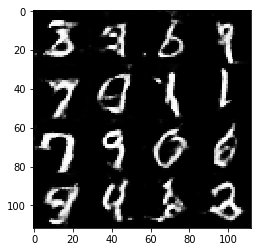

Epoch 1/2... Discriminator Loss: 1.0814... Generator Loss: 0.6644
Epoch 1/2... Discriminator Loss: 1.0885... Generator Loss: 0.6289
Epoch 1/2... Discriminator Loss: 0.9413... Generator Loss: 0.9110
Epoch 1/2... Discriminator Loss: 1.0663... Generator Loss: 0.5722
Epoch 1/2... Discriminator Loss: 0.9367... Generator Loss: 1.1283
Epoch 1/2... Discriminator Loss: 1.1768... Generator Loss: 0.5630
Epoch 1/2... Discriminator Loss: 0.8935... Generator Loss: 0.9852
Epoch 1/2... Discriminator Loss: 1.2889... Generator Loss: 0.4678
Epoch 1/2... Discriminator Loss: 1.1789... Generator Loss: 0.5738
Epoch 1/2... Discriminator Loss: 1.0240... Generator Loss: 1.2907


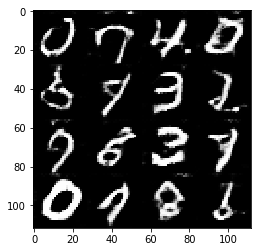

Epoch 1/2... Discriminator Loss: 1.2488... Generator Loss: 0.4642
Epoch 1/2... Discriminator Loss: 1.0505... Generator Loss: 1.4464
Epoch 1/2... Discriminator Loss: 1.8110... Generator Loss: 0.2471
Epoch 1/2... Discriminator Loss: 1.0237... Generator Loss: 2.0250
Epoch 1/2... Discriminator Loss: 1.2507... Generator Loss: 0.5714
Epoch 1/2... Discriminator Loss: 1.1555... Generator Loss: 0.9202
Epoch 1/2... Discriminator Loss: 1.5742... Generator Loss: 0.2961
Epoch 1/2... Discriminator Loss: 1.6748... Generator Loss: 2.5693
Epoch 1/2... Discriminator Loss: 1.4274... Generator Loss: 0.3724
Epoch 1/2... Discriminator Loss: 1.3532... Generator Loss: 2.2054


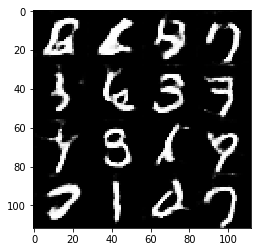

Epoch 1/2... Discriminator Loss: 2.3146... Generator Loss: 0.1395
Epoch 1/2... Discriminator Loss: 1.1091... Generator Loss: 1.3851
Epoch 1/2... Discriminator Loss: 0.9265... Generator Loss: 1.2180
Epoch 1/2... Discriminator Loss: 1.6604... Generator Loss: 0.3092
Epoch 1/2... Discriminator Loss: 1.1388... Generator Loss: 1.3178
Epoch 1/2... Discriminator Loss: 1.0665... Generator Loss: 0.6521
Epoch 1/2... Discriminator Loss: 1.0027... Generator Loss: 0.8487
Epoch 1/2... Discriminator Loss: 0.9943... Generator Loss: 1.0280
Epoch 1/2... Discriminator Loss: 1.2385... Generator Loss: 0.5260
Epoch 1/2... Discriminator Loss: 0.9493... Generator Loss: 0.9384


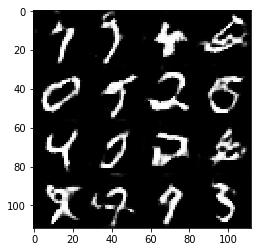

Epoch 1/2... Discriminator Loss: 1.1309... Generator Loss: 0.9023
Epoch 1/2... Discriminator Loss: 1.2850... Generator Loss: 0.4311
Epoch 1/2... Discriminator Loss: 1.0411... Generator Loss: 0.8572
Epoch 1/2... Discriminator Loss: 1.1179... Generator Loss: 0.7880
Epoch 1/2... Discriminator Loss: 1.0530... Generator Loss: 0.6574
Epoch 1/2... Discriminator Loss: 0.9273... Generator Loss: 0.9756
Epoch 1/2... Discriminator Loss: 1.1460... Generator Loss: 0.5720
Epoch 1/2... Discriminator Loss: 0.9438... Generator Loss: 0.8786
Epoch 1/2... Discriminator Loss: 0.9418... Generator Loss: 0.8674
Epoch 1/2... Discriminator Loss: 1.0488... Generator Loss: 0.6672


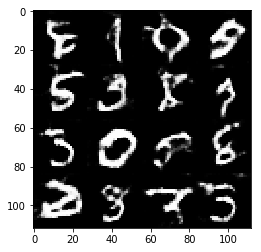

Epoch 1/2... Discriminator Loss: 1.0521... Generator Loss: 0.6696
Epoch 1/2... Discriminator Loss: 1.0758... Generator Loss: 0.7228
Epoch 1/2... Discriminator Loss: 1.2153... Generator Loss: 0.5995
Epoch 1/2... Discriminator Loss: 0.8632... Generator Loss: 0.8992
Epoch 1/2... Discriminator Loss: 0.9627... Generator Loss: 0.7242
Epoch 1/2... Discriminator Loss: 1.1124... Generator Loss: 0.6301
Epoch 1/2... Discriminator Loss: 0.9388... Generator Loss: 0.7542
Epoch 1/2... Discriminator Loss: 1.0776... Generator Loss: 0.6157
Epoch 1/2... Discriminator Loss: 0.9447... Generator Loss: 1.1678
Epoch 1/2... Discriminator Loss: 1.0972... Generator Loss: 0.6008


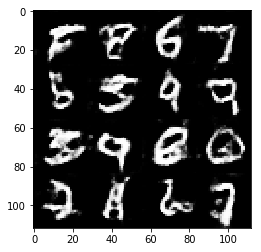

Epoch 1/2... Discriminator Loss: 0.9239... Generator Loss: 0.8119
Epoch 1/2... Discriminator Loss: 0.9894... Generator Loss: 0.9119
Epoch 1/2... Discriminator Loss: 0.9156... Generator Loss: 0.7119
Epoch 1/2... Discriminator Loss: 0.9931... Generator Loss: 0.7787
Epoch 1/2... Discriminator Loss: 0.9365... Generator Loss: 0.7366
Epoch 1/2... Discriminator Loss: 0.9099... Generator Loss: 0.8891
Epoch 1/2... Discriminator Loss: 1.2244... Generator Loss: 0.5326
Epoch 1/2... Discriminator Loss: 1.0451... Generator Loss: 1.1314
Epoch 1/2... Discriminator Loss: 1.4397... Generator Loss: 0.3633
Epoch 1/2... Discriminator Loss: 1.4169... Generator Loss: 1.9903


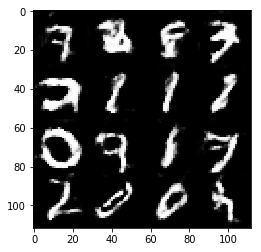

Epoch 1/2... Discriminator Loss: 1.8536... Generator Loss: 0.2311
Epoch 1/2... Discriminator Loss: 2.7870... Generator Loss: 3.5666
Epoch 1/2... Discriminator Loss: 2.1778... Generator Loss: 0.1762
Epoch 1/2... Discriminator Loss: 0.9370... Generator Loss: 1.2081
Epoch 1/2... Discriminator Loss: 1.1163... Generator Loss: 1.2041
Epoch 1/2... Discriminator Loss: 1.2447... Generator Loss: 0.4661
Epoch 1/2... Discriminator Loss: 1.0202... Generator Loss: 0.9243
Epoch 1/2... Discriminator Loss: 0.9016... Generator Loss: 1.0594
Epoch 1/2... Discriminator Loss: 1.4313... Generator Loss: 0.4087
Epoch 1/2... Discriminator Loss: 0.8141... Generator Loss: 1.6808


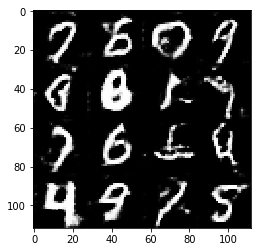

Epoch 1/2... Discriminator Loss: 1.0570... Generator Loss: 0.7517
Epoch 1/2... Discriminator Loss: 1.0338... Generator Loss: 0.7845
Epoch 1/2... Discriminator Loss: 1.0888... Generator Loss: 0.6406
Epoch 1/2... Discriminator Loss: 1.0134... Generator Loss: 0.8406
Epoch 1/2... Discriminator Loss: 1.0789... Generator Loss: 0.7594
Epoch 1/2... Discriminator Loss: 0.9380... Generator Loss: 0.7422
Epoch 1/2... Discriminator Loss: 1.0180... Generator Loss: 0.6640
Epoch 1/2... Discriminator Loss: 0.9826... Generator Loss: 1.1811
Epoch 1/2... Discriminator Loss: 1.0083... Generator Loss: 0.6497
Epoch 1/2... Discriminator Loss: 1.0893... Generator Loss: 0.6410


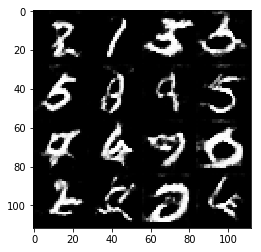

Epoch 1/2... Discriminator Loss: 0.9606... Generator Loss: 0.9058
Epoch 1/2... Discriminator Loss: 1.1687... Generator Loss: 0.5595
Epoch 1/2... Discriminator Loss: 0.9197... Generator Loss: 0.8622
Epoch 1/2... Discriminator Loss: 1.1102... Generator Loss: 0.6485
Epoch 1/2... Discriminator Loss: 0.9327... Generator Loss: 0.9124
Epoch 1/2... Discriminator Loss: 0.9955... Generator Loss: 0.8597
Epoch 1/2... Discriminator Loss: 1.0958... Generator Loss: 0.6052
Epoch 1/2... Discriminator Loss: 0.7666... Generator Loss: 1.1632
Epoch 1/2... Discriminator Loss: 1.1917... Generator Loss: 0.4565
Epoch 1/2... Discriminator Loss: 0.9874... Generator Loss: 1.4620


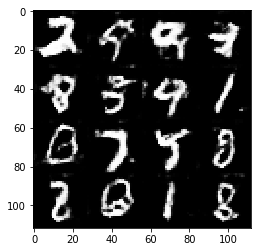

Epoch 1/2... Discriminator Loss: 1.7664... Generator Loss: 0.2574
Epoch 1/2... Discriminator Loss: 2.7810... Generator Loss: 3.3455
Epoch 1/2... Discriminator Loss: 1.8121... Generator Loss: 0.3194
Epoch 1/2... Discriminator Loss: 1.0883... Generator Loss: 0.8496
Epoch 1/2... Discriminator Loss: 1.2964... Generator Loss: 1.1495
Epoch 1/2... Discriminator Loss: 1.3499... Generator Loss: 0.4417
Epoch 1/2... Discriminator Loss: 0.9737... Generator Loss: 1.2725
Epoch 1/2... Discriminator Loss: 1.2168... Generator Loss: 0.5313
Epoch 1/2... Discriminator Loss: 0.9906... Generator Loss: 0.8815
Epoch 1/2... Discriminator Loss: 1.0265... Generator Loss: 0.8728


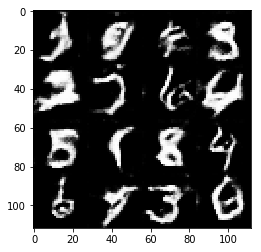

Epoch 1/2... Discriminator Loss: 1.1261... Generator Loss: 0.7144
Epoch 1/2... Discriminator Loss: 0.9428... Generator Loss: 0.8771
Epoch 1/2... Discriminator Loss: 0.9352... Generator Loss: 0.8865
Epoch 1/2... Discriminator Loss: 1.1224... Generator Loss: 0.6030
Epoch 1/2... Discriminator Loss: 0.9272... Generator Loss: 0.8513
Epoch 1/2... Discriminator Loss: 1.0536... Generator Loss: 0.6610
Epoch 1/2... Discriminator Loss: 0.8697... Generator Loss: 0.9601
Epoch 1/2... Discriminator Loss: 0.9900... Generator Loss: 0.7386
Epoch 1/2... Discriminator Loss: 0.9619... Generator Loss: 0.8189
Epoch 1/2... Discriminator Loss: 1.0669... Generator Loss: 0.7075


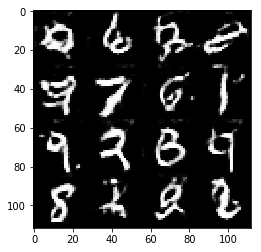

Epoch 1/2... Discriminator Loss: 1.0081... Generator Loss: 0.6730
Epoch 1/2... Discriminator Loss: 0.9376... Generator Loss: 0.7464
Epoch 1/2... Discriminator Loss: 1.2819... Generator Loss: 0.4383
Epoch 1/2... Discriminator Loss: 0.7803... Generator Loss: 1.6312
Epoch 1/2... Discriminator Loss: 1.3425... Generator Loss: 0.4192
Epoch 1/2... Discriminator Loss: 0.9057... Generator Loss: 1.4906
Epoch 1/2... Discriminator Loss: 1.1933... Generator Loss: 0.5576
Epoch 2/2... Discriminator Loss: 1.0000... Generator Loss: 0.9008
Epoch 2/2... Discriminator Loss: 1.2331... Generator Loss: 0.4635
Epoch 2/2... Discriminator Loss: 0.7171... Generator Loss: 1.3528


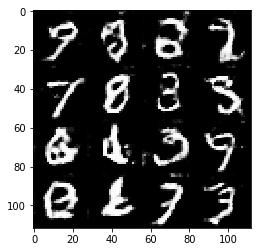

Epoch 2/2... Discriminator Loss: 0.8973... Generator Loss: 0.7892
Epoch 2/2... Discriminator Loss: 0.9385... Generator Loss: 0.7113
Epoch 2/2... Discriminator Loss: 0.7957... Generator Loss: 0.9553
Epoch 2/2... Discriminator Loss: 1.0976... Generator Loss: 0.6184
Epoch 2/2... Discriminator Loss: 0.8963... Generator Loss: 0.9170
Epoch 2/2... Discriminator Loss: 1.1159... Generator Loss: 0.5764
Epoch 2/2... Discriminator Loss: 0.8938... Generator Loss: 0.8704
Epoch 2/2... Discriminator Loss: 0.9423... Generator Loss: 0.9161
Epoch 2/2... Discriminator Loss: 0.8363... Generator Loss: 0.9163
Epoch 2/2... Discriminator Loss: 0.9538... Generator Loss: 0.8382


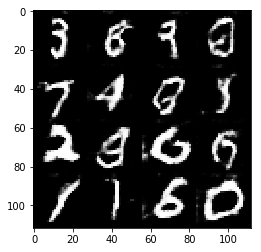

Epoch 2/2... Discriminator Loss: 1.0182... Generator Loss: 0.6442
Epoch 2/2... Discriminator Loss: 0.8479... Generator Loss: 1.4809
Epoch 2/2... Discriminator Loss: 1.6457... Generator Loss: 0.2902
Epoch 2/2... Discriminator Loss: 1.0929... Generator Loss: 1.9886
Epoch 2/2... Discriminator Loss: 1.2422... Generator Loss: 0.5273
Epoch 2/2... Discriminator Loss: 1.0775... Generator Loss: 0.8661
Epoch 2/2... Discriminator Loss: 0.8915... Generator Loss: 1.4864
Epoch 2/2... Discriminator Loss: 1.8394... Generator Loss: 0.2601
Epoch 2/2... Discriminator Loss: 1.7445... Generator Loss: 2.7188
Epoch 2/2... Discriminator Loss: 1.5334... Generator Loss: 0.3748


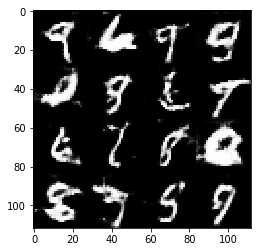

Epoch 2/2... Discriminator Loss: 1.1213... Generator Loss: 0.9506
Epoch 2/2... Discriminator Loss: 1.1460... Generator Loss: 0.8565
Epoch 2/2... Discriminator Loss: 1.3537... Generator Loss: 0.4366
Epoch 2/2... Discriminator Loss: 0.9493... Generator Loss: 0.9733
Epoch 2/2... Discriminator Loss: 0.8729... Generator Loss: 1.0530
Epoch 2/2... Discriminator Loss: 1.3206... Generator Loss: 0.4263
Epoch 2/2... Discriminator Loss: 0.7466... Generator Loss: 1.1339
Epoch 2/2... Discriminator Loss: 0.9308... Generator Loss: 1.0093
Epoch 2/2... Discriminator Loss: 0.8902... Generator Loss: 0.7911
Epoch 2/2... Discriminator Loss: 0.7395... Generator Loss: 1.0029


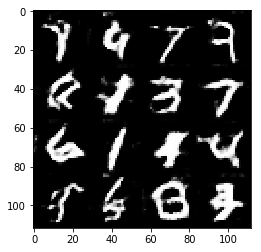

Epoch 2/2... Discriminator Loss: 0.8751... Generator Loss: 0.7614
Epoch 2/2... Discriminator Loss: 0.8541... Generator Loss: 1.0026
Epoch 2/2... Discriminator Loss: 0.9547... Generator Loss: 0.8914
Epoch 2/2... Discriminator Loss: 0.9346... Generator Loss: 0.8906
Epoch 2/2... Discriminator Loss: 1.0552... Generator Loss: 0.7082
Epoch 2/2... Discriminator Loss: 0.7618... Generator Loss: 0.9303
Epoch 2/2... Discriminator Loss: 0.7035... Generator Loss: 1.1915
Epoch 2/2... Discriminator Loss: 0.8221... Generator Loss: 0.9702
Epoch 2/2... Discriminator Loss: 1.0706... Generator Loss: 0.6836
Epoch 2/2... Discriminator Loss: 0.6598... Generator Loss: 1.3197


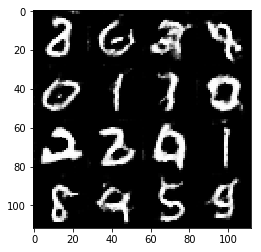

Epoch 2/2... Discriminator Loss: 1.2497... Generator Loss: 0.4522
Epoch 2/2... Discriminator Loss: 0.8591... Generator Loss: 1.7789
Epoch 2/2... Discriminator Loss: 1.7806... Generator Loss: 0.2649
Epoch 2/2... Discriminator Loss: 1.6868... Generator Loss: 2.9902
Epoch 2/2... Discriminator Loss: 3.3593... Generator Loss: 0.0634
Epoch 2/2... Discriminator Loss: 1.7614... Generator Loss: 3.0322
Epoch 2/2... Discriminator Loss: 1.0896... Generator Loss: 0.8460
Epoch 2/2... Discriminator Loss: 1.1489... Generator Loss: 0.7664
Epoch 2/2... Discriminator Loss: 1.1602... Generator Loss: 1.3715
Epoch 2/2... Discriminator Loss: 1.2459... Generator Loss: 0.5444


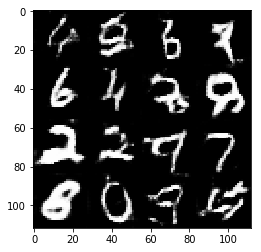

Epoch 2/2... Discriminator Loss: 1.0179... Generator Loss: 1.2647
Epoch 2/2... Discriminator Loss: 1.2336... Generator Loss: 0.6045
Epoch 2/2... Discriminator Loss: 1.1796... Generator Loss: 1.2772
Epoch 2/2... Discriminator Loss: 1.3557... Generator Loss: 0.4510
Epoch 2/2... Discriminator Loss: 1.1838... Generator Loss: 1.0493
Epoch 2/2... Discriminator Loss: 1.0566... Generator Loss: 0.8340
Epoch 2/2... Discriminator Loss: 1.1584... Generator Loss: 0.7719
Epoch 2/2... Discriminator Loss: 0.8621... Generator Loss: 1.0584
Epoch 2/2... Discriminator Loss: 1.0669... Generator Loss: 0.6307
Epoch 2/2... Discriminator Loss: 1.1143... Generator Loss: 0.9933


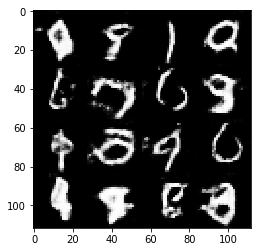

Epoch 2/2... Discriminator Loss: 1.0914... Generator Loss: 0.6967
Epoch 2/2... Discriminator Loss: 1.0573... Generator Loss: 0.8218
Epoch 2/2... Discriminator Loss: 1.0383... Generator Loss: 0.7185
Epoch 2/2... Discriminator Loss: 1.0999... Generator Loss: 0.8687
Epoch 2/2... Discriminator Loss: 1.4885... Generator Loss: 0.3455
Epoch 2/2... Discriminator Loss: 1.0298... Generator Loss: 1.7322
Epoch 2/2... Discriminator Loss: 1.1971... Generator Loss: 0.5460
Epoch 2/2... Discriminator Loss: 1.0094... Generator Loss: 0.8256
Epoch 2/2... Discriminator Loss: 1.1095... Generator Loss: 0.7238
Epoch 2/2... Discriminator Loss: 0.9221... Generator Loss: 0.8904


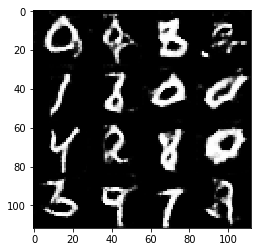

Epoch 2/2... Discriminator Loss: 1.0900... Generator Loss: 0.5857
Epoch 2/2... Discriminator Loss: 0.8699... Generator Loss: 1.0385
Epoch 2/2... Discriminator Loss: 1.0443... Generator Loss: 0.6461
Epoch 2/2... Discriminator Loss: 1.2603... Generator Loss: 0.5159
Epoch 2/2... Discriminator Loss: 0.8464... Generator Loss: 1.0185
Epoch 2/2... Discriminator Loss: 1.1489... Generator Loss: 0.5525
Epoch 2/2... Discriminator Loss: 1.0249... Generator Loss: 1.0987
Epoch 2/2... Discriminator Loss: 1.3199... Generator Loss: 0.4307
Epoch 2/2... Discriminator Loss: 0.8910... Generator Loss: 1.2146
Epoch 2/2... Discriminator Loss: 1.2032... Generator Loss: 0.5137


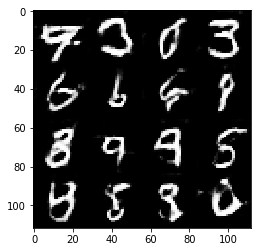

Epoch 2/2... Discriminator Loss: 0.8079... Generator Loss: 1.0420
Epoch 2/2... Discriminator Loss: 0.9695... Generator Loss: 0.7987
Epoch 2/2... Discriminator Loss: 1.0637... Generator Loss: 0.6728
Epoch 2/2... Discriminator Loss: 1.0423... Generator Loss: 0.8402
Epoch 2/2... Discriminator Loss: 1.3366... Generator Loss: 0.4467
Epoch 2/2... Discriminator Loss: 0.9749... Generator Loss: 1.0447
Epoch 2/2... Discriminator Loss: 1.0322... Generator Loss: 0.6699
Epoch 2/2... Discriminator Loss: 1.3301... Generator Loss: 0.4710
Epoch 2/2... Discriminator Loss: 0.8245... Generator Loss: 1.4446
Epoch 2/2... Discriminator Loss: 1.2760... Generator Loss: 0.5030


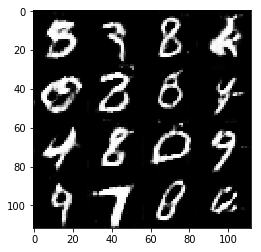

Epoch 2/2... Discriminator Loss: 0.9707... Generator Loss: 0.9137
Epoch 2/2... Discriminator Loss: 1.0418... Generator Loss: 0.7804
Epoch 2/2... Discriminator Loss: 0.8849... Generator Loss: 0.7730
Epoch 2/2... Discriminator Loss: 0.9855... Generator Loss: 0.7093
Epoch 2/2... Discriminator Loss: 1.0558... Generator Loss: 0.8277
Epoch 2/2... Discriminator Loss: 0.9546... Generator Loss: 0.7325
Epoch 2/2... Discriminator Loss: 0.9564... Generator Loss: 0.7537
Epoch 2/2... Discriminator Loss: 0.7607... Generator Loss: 1.0360
Epoch 2/2... Discriminator Loss: 1.1849... Generator Loss: 0.5288
Epoch 2/2... Discriminator Loss: 0.7323... Generator Loss: 1.4274


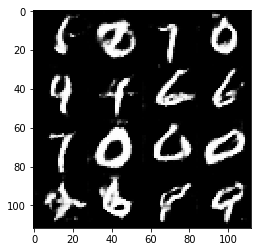

Epoch 2/2... Discriminator Loss: 1.1921... Generator Loss: 0.4773
Epoch 2/2... Discriminator Loss: 1.1250... Generator Loss: 2.0308
Epoch 2/2... Discriminator Loss: 2.1421... Generator Loss: 0.1826
Epoch 2/2... Discriminator Loss: 1.5934... Generator Loss: 2.3793
Epoch 2/2... Discriminator Loss: 1.9937... Generator Loss: 0.2316
Epoch 2/2... Discriminator Loss: 1.5445... Generator Loss: 2.3208
Epoch 2/2... Discriminator Loss: 1.1082... Generator Loss: 0.6229
Epoch 2/2... Discriminator Loss: 1.3040... Generator Loss: 0.5073
Epoch 2/2... Discriminator Loss: 1.1159... Generator Loss: 1.4137
Epoch 2/2... Discriminator Loss: 1.1832... Generator Loss: 0.5811


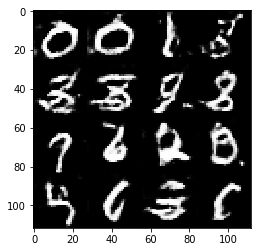

Epoch 2/2... Discriminator Loss: 1.1384... Generator Loss: 1.1770
Epoch 2/2... Discriminator Loss: 1.0170... Generator Loss: 0.7246
Epoch 2/2... Discriminator Loss: 1.1801... Generator Loss: 0.6170
Epoch 2/2... Discriminator Loss: 0.9400... Generator Loss: 0.9960
Epoch 2/2... Discriminator Loss: 1.1063... Generator Loss: 1.1738
Epoch 2/2... Discriminator Loss: 1.1067... Generator Loss: 0.6117
Epoch 2/2... Discriminator Loss: 1.1139... Generator Loss: 0.7317
Epoch 2/2... Discriminator Loss: 0.9525... Generator Loss: 1.1317
Epoch 2/2... Discriminator Loss: 1.1438... Generator Loss: 0.5698
Epoch 2/2... Discriminator Loss: 1.1967... Generator Loss: 1.2408


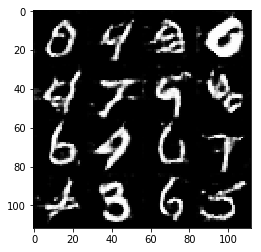

Epoch 2/2... Discriminator Loss: 1.4141... Generator Loss: 0.3658
Epoch 2/2... Discriminator Loss: 0.9165... Generator Loss: 1.0174
Epoch 2/2... Discriminator Loss: 1.0448... Generator Loss: 0.8893
Epoch 2/2... Discriminator Loss: 1.1279... Generator Loss: 0.5173
Epoch 2/2... Discriminator Loss: 0.9633... Generator Loss: 0.8147
Epoch 2/2... Discriminator Loss: 0.9422... Generator Loss: 0.8659
Epoch 2/2... Discriminator Loss: 1.0710... Generator Loss: 0.6139
Epoch 2/2... Discriminator Loss: 0.8515... Generator Loss: 0.8782
Epoch 2/2... Discriminator Loss: 0.9577... Generator Loss: 0.9121
Epoch 2/2... Discriminator Loss: 1.2071... Generator Loss: 0.4713


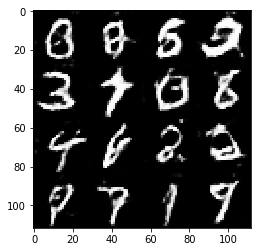

Epoch 2/2... Discriminator Loss: 0.9288... Generator Loss: 1.3454
Epoch 2/2... Discriminator Loss: 1.3521... Generator Loss: 0.4324
Epoch 2/2... Discriminator Loss: 1.1625... Generator Loss: 0.8533
Epoch 2/2... Discriminator Loss: 1.2890... Generator Loss: 0.4596
Epoch 2/2... Discriminator Loss: 0.9629... Generator Loss: 1.2300
Epoch 2/2... Discriminator Loss: 0.8162... Generator Loss: 0.8874
Epoch 2/2... Discriminator Loss: 0.8823... Generator Loss: 0.7983
Epoch 2/2... Discriminator Loss: 0.8583... Generator Loss: 0.9262
Epoch 2/2... Discriminator Loss: 0.7812... Generator Loss: 1.2556
Epoch 2/2... Discriminator Loss: 1.0254... Generator Loss: 0.6955


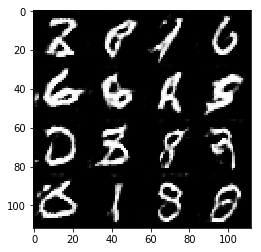

Epoch 2/2... Discriminator Loss: 0.8880... Generator Loss: 0.8381
Epoch 2/2... Discriminator Loss: 1.4291... Generator Loss: 0.3831
Epoch 2/2... Discriminator Loss: 0.8487... Generator Loss: 1.4451
Epoch 2/2... Discriminator Loss: 0.8233... Generator Loss: 0.8779
Epoch 2/2... Discriminator Loss: 1.0326... Generator Loss: 0.7031
Epoch 2/2... Discriminator Loss: 1.1290... Generator Loss: 0.6119
Epoch 2/2... Discriminator Loss: 0.6489... Generator Loss: 1.1879
Epoch 2/2... Discriminator Loss: 0.8788... Generator Loss: 0.7515
Epoch 2/2... Discriminator Loss: 0.6052... Generator Loss: 1.9140
Epoch 2/2... Discriminator Loss: 1.0753... Generator Loss: 0.5601


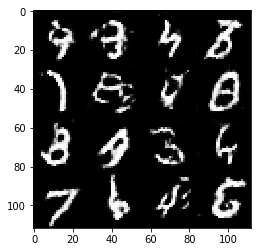

Epoch 2/2... Discriminator Loss: 0.6391... Generator Loss: 1.7093
Epoch 2/2... Discriminator Loss: 0.9354... Generator Loss: 0.6921
Epoch 2/2... Discriminator Loss: 0.8342... Generator Loss: 1.6181
Epoch 2/2... Discriminator Loss: 1.5919... Generator Loss: 0.3208
Epoch 2/2... Discriminator Loss: 2.0229... Generator Loss: 2.8268
Epoch 2/2... Discriminator Loss: 3.2445... Generator Loss: 0.0690
Epoch 2/2... Discriminator Loss: 1.2490... Generator Loss: 2.5431
Epoch 2/2... Discriminator Loss: 0.8316... Generator Loss: 0.9866
Epoch 2/2... Discriminator Loss: 1.3790... Generator Loss: 0.4494
Epoch 2/2... Discriminator Loss: 1.3119... Generator Loss: 2.1820


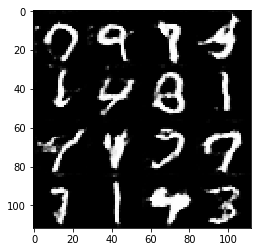

Epoch 2/2... Discriminator Loss: 1.0517... Generator Loss: 0.7261
Epoch 2/2... Discriminator Loss: 1.3141... Generator Loss: 0.4456
Epoch 2/2... Discriminator Loss: 1.0596... Generator Loss: 1.3568
Epoch 2/2... Discriminator Loss: 1.0418... Generator Loss: 0.7979
Epoch 2/2... Discriminator Loss: 1.2677... Generator Loss: 0.4807
Epoch 2/2... Discriminator Loss: 0.8933... Generator Loss: 1.2173
Epoch 2/2... Discriminator Loss: 1.0716... Generator Loss: 0.7391
Epoch 2/2... Discriminator Loss: 1.4272... Generator Loss: 0.4105
Epoch 2/2... Discriminator Loss: 1.0780... Generator Loss: 0.9879
Epoch 2/2... Discriminator Loss: 0.9897... Generator Loss: 0.6487


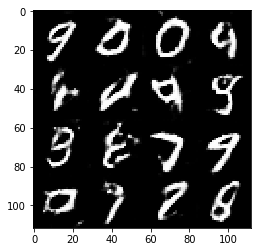

Epoch 2/2... Discriminator Loss: 0.8621... Generator Loss: 1.0222
Epoch 2/2... Discriminator Loss: 0.9397... Generator Loss: 0.8670
Epoch 2/2... Discriminator Loss: 1.1536... Generator Loss: 0.5191
Epoch 2/2... Discriminator Loss: 0.8610... Generator Loss: 1.0545
Epoch 2/2... Discriminator Loss: 1.1124... Generator Loss: 0.6029
Epoch 2/2... Discriminator Loss: 0.9043... Generator Loss: 0.7940
Epoch 2/2... Discriminator Loss: 1.0348... Generator Loss: 0.6399
Epoch 2/2... Discriminator Loss: 0.8722... Generator Loss: 0.8142
Epoch 2/2... Discriminator Loss: 0.7786... Generator Loss: 1.1930
Epoch 2/2... Discriminator Loss: 1.0885... Generator Loss: 0.5837


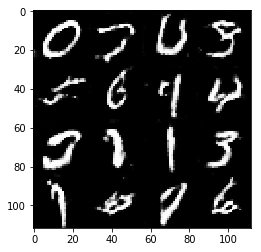

Epoch 2/2... Discriminator Loss: 0.9838... Generator Loss: 0.7845
Epoch 2/2... Discriminator Loss: 0.8907... Generator Loss: 0.8973
Epoch 2/2... Discriminator Loss: 1.1639... Generator Loss: 0.5311
Epoch 2/2... Discriminator Loss: 0.8201... Generator Loss: 1.5102
Epoch 2/2... Discriminator Loss: 1.1719... Generator Loss: 0.5228
Epoch 2/2... Discriminator Loss: 0.8645... Generator Loss: 1.1672
Epoch 2/2... Discriminator Loss: 1.3125... Generator Loss: 0.4626
Epoch 2/2... Discriminator Loss: 0.9389... Generator Loss: 1.1421
Epoch 2/2... Discriminator Loss: 1.0318... Generator Loss: 0.6431
Epoch 2/2... Discriminator Loss: 0.8764... Generator Loss: 0.7966


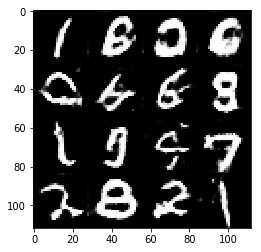

Epoch 2/2... Discriminator Loss: 0.7856... Generator Loss: 1.3506
Epoch 2/2... Discriminator Loss: 0.9285... Generator Loss: 0.7202
Epoch 2/2... Discriminator Loss: 1.4282... Generator Loss: 0.3819
Epoch 2/2... Discriminator Loss: 0.9511... Generator Loss: 2.0209
Epoch 2/2... Discriminator Loss: 1.2532... Generator Loss: 0.4508
Epoch 2/2... Discriminator Loss: 1.1696... Generator Loss: 1.2864
Epoch 2/2... Discriminator Loss: 1.5637... Generator Loss: 0.3418
Epoch 2/2... Discriminator Loss: 0.9462... Generator Loss: 2.1392
Epoch 2/2... Discriminator Loss: 1.3802... Generator Loss: 0.5363
Epoch 2/2... Discriminator Loss: 1.0908... Generator Loss: 0.6601


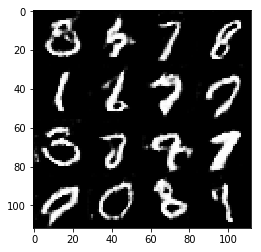

Epoch 2/2... Discriminator Loss: 0.7343... Generator Loss: 1.3139
Epoch 2/2... Discriminator Loss: 1.2965... Generator Loss: 0.4081
Epoch 2/2... Discriminator Loss: 1.0537... Generator Loss: 1.1786
Epoch 2/2... Discriminator Loss: 1.3289... Generator Loss: 0.4099
Epoch 2/2... Discriminator Loss: 0.9122... Generator Loss: 1.3192
Epoch 2/2... Discriminator Loss: 1.1475... Generator Loss: 0.5303
Epoch 2/2... Discriminator Loss: 0.9175... Generator Loss: 0.9137
Epoch 2/2... Discriminator Loss: 1.3275... Generator Loss: 0.4224
Epoch 2/2... Discriminator Loss: 0.7647... Generator Loss: 1.9649
Epoch 2/2... Discriminator Loss: 1.4194... Generator Loss: 0.3569


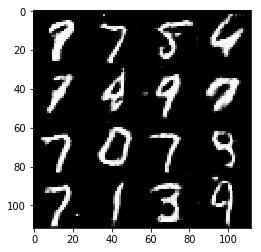

Epoch 2/2... Discriminator Loss: 0.9743... Generator Loss: 1.6107
Epoch 2/2... Discriminator Loss: 1.5021... Generator Loss: 0.3357
Epoch 2/2... Discriminator Loss: 0.7053... Generator Loss: 1.3181
Epoch 2/2... Discriminator Loss: 1.0067... Generator Loss: 0.7091
Epoch 2/2... Discriminator Loss: 0.9207... Generator Loss: 0.8289
Epoch 2/2... Discriminator Loss: 0.7090... Generator Loss: 1.3282
Epoch 2/2... Discriminator Loss: 1.0819... Generator Loss: 0.6092
Epoch 2/2... Discriminator Loss: 0.7577... Generator Loss: 0.9676
Epoch 2/2... Discriminator Loss: 0.6467... Generator Loss: 1.0363
Epoch 2/2... Discriminator Loss: 0.6608... Generator Loss: 1.7615


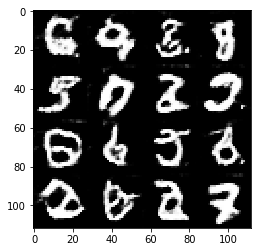

Epoch 2/2... Discriminator Loss: 1.1591... Generator Loss: 0.5194
Epoch 2/2... Discriminator Loss: 0.6904... Generator Loss: 1.5342
Epoch 2/2... Discriminator Loss: 1.1051... Generator Loss: 0.5705
Epoch 2/2... Discriminator Loss: 0.8420... Generator Loss: 1.7098
Epoch 2/2... Discriminator Loss: 1.3420... Generator Loss: 0.4415
Epoch 2/2... Discriminator Loss: 0.7978... Generator Loss: 1.2727
Epoch 2/2... Discriminator Loss: 1.3366... Generator Loss: 0.4730
Epoch 2/2... Discriminator Loss: 0.8344... Generator Loss: 1.7425
Epoch 2/2... Discriminator Loss: 0.7733... Generator Loss: 0.9780
Epoch 2/2... Discriminator Loss: 0.9721... Generator Loss: 0.7664


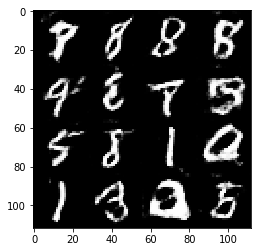

Epoch 2/2... Discriminator Loss: 1.0195... Generator Loss: 0.6045
Epoch 2/2... Discriminator Loss: 0.7225... Generator Loss: 1.3525
Epoch 2/2... Discriminator Loss: 0.8253... Generator Loss: 0.9992
Epoch 2/2... Discriminator Loss: 1.5336... Generator Loss: 0.3296
Epoch 2/2... Discriminator Loss: 1.2188... Generator Loss: 2.0949
Epoch 2/2... Discriminator Loss: 1.3002... Generator Loss: 0.5325
Epoch 2/2... Discriminator Loss: 0.8112... Generator Loss: 1.7420
Epoch 2/2... Discriminator Loss: 0.8674... Generator Loss: 0.9575
Epoch 2/2... Discriminator Loss: 1.0130... Generator Loss: 0.9943
Epoch 2/2... Discriminator Loss: 0.9568... Generator Loss: 1.0407


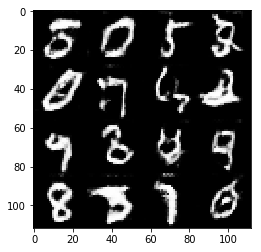

Epoch 2/2... Discriminator Loss: 1.3150... Generator Loss: 0.4788
Epoch 2/2... Discriminator Loss: 0.9982... Generator Loss: 1.9227
Epoch 2/2... Discriminator Loss: 1.0489... Generator Loss: 0.6443
Epoch 2/2... Discriminator Loss: 1.0086... Generator Loss: 0.6854
Epoch 2/2... Discriminator Loss: 0.6356... Generator Loss: 1.3936
Epoch 2/2... Discriminator Loss: 0.9818... Generator Loss: 0.7537
Epoch 2/2... Discriminator Loss: 1.0104... Generator Loss: 0.7413
Epoch 2/2... Discriminator Loss: 0.9186... Generator Loss: 0.7609
Epoch 2/2... Discriminator Loss: 0.6826... Generator Loss: 1.7925
Epoch 2/2... Discriminator Loss: 1.5178... Generator Loss: 0.3580


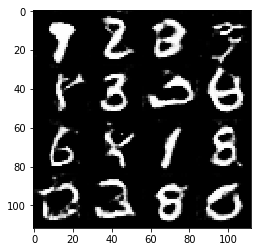

Epoch 2/2... Discriminator Loss: 1.0810... Generator Loss: 1.9298
Epoch 2/2... Discriminator Loss: 1.2554... Generator Loss: 0.4712
Epoch 2/2... Discriminator Loss: 0.9684... Generator Loss: 1.2884
Epoch 2/2... Discriminator Loss: 0.8284... Generator Loss: 0.9769
Epoch 2/2... Discriminator Loss: 0.9997... Generator Loss: 0.8532
Epoch 2/2... Discriminator Loss: 1.0635... Generator Loss: 0.7654
Epoch 2/2... Discriminator Loss: 0.9782... Generator Loss: 1.0953
Epoch 2/2... Discriminator Loss: 1.6255... Generator Loss: 0.3070
Epoch 2/2... Discriminator Loss: 0.9961... Generator Loss: 1.5162
Epoch 2/2... Discriminator Loss: 1.0185... Generator Loss: 0.7661


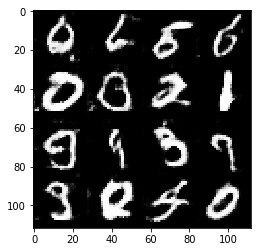

Epoch 2/2... Discriminator Loss: 1.1847... Generator Loss: 0.5858
Epoch 2/2... Discriminator Loss: 1.0432... Generator Loss: 1.1289
Epoch 2/2... Discriminator Loss: 1.7751... Generator Loss: 0.2598
Epoch 2/2... Discriminator Loss: 1.6587... Generator Loss: 3.1751
Epoch 2/2... Discriminator Loss: 1.2861... Generator Loss: 0.5473
Epoch 2/2... Discriminator Loss: 0.9327... Generator Loss: 0.9024
Epoch 2/2... Discriminator Loss: 0.8833... Generator Loss: 1.3056
Epoch 2/2... Discriminator Loss: 1.1929... Generator Loss: 0.5411
Epoch 2/2... Discriminator Loss: 0.7100... Generator Loss: 1.1458
Epoch 2/2... Discriminator Loss: 0.7811... Generator Loss: 1.3837


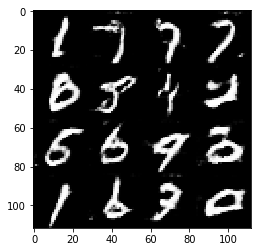

Epoch 2/2... Discriminator Loss: 1.1115... Generator Loss: 0.5248
Epoch 2/2... Discriminator Loss: 0.8719... Generator Loss: 0.8145
Epoch 2/2... Discriminator Loss: 0.7322... Generator Loss: 1.3698
Epoch 2/2... Discriminator Loss: 1.0772... Generator Loss: 0.6207
Epoch 2/2... Discriminator Loss: 0.8390... Generator Loss: 0.8813
Epoch 2/2... Discriminator Loss: 0.8488... Generator Loss: 0.8683
Epoch 2/2... Discriminator Loss: 0.6054... Generator Loss: 1.2499
Epoch 2/2... Discriminator Loss: 0.7410... Generator Loss: 0.9612
Epoch 2/2... Discriminator Loss: 0.7246... Generator Loss: 1.0459
Epoch 2/2... Discriminator Loss: 0.7297... Generator Loss: 0.9590


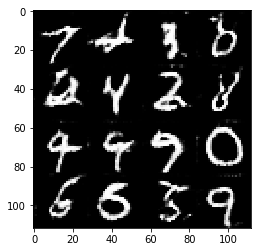

Epoch 2/2... Discriminator Loss: 0.6080... Generator Loss: 1.3670
Epoch 2/2... Discriminator Loss: 1.0736... Generator Loss: 0.5462
Epoch 2/2... Discriminator Loss: 0.7656... Generator Loss: 1.3529
Epoch 2/2... Discriminator Loss: 1.0856... Generator Loss: 0.6714
Epoch 2/2... Discriminator Loss: 1.0633... Generator Loss: 0.6370
Epoch 2/2... Discriminator Loss: 0.9404... Generator Loss: 1.5514
Epoch 2/2... Discriminator Loss: 1.4455... Generator Loss: 0.4497
Epoch 2/2... Discriminator Loss: 1.1957... Generator Loss: 2.2024
Epoch 2/2... Discriminator Loss: 1.7388... Generator Loss: 0.3505
Epoch 2/2... Discriminator Loss: 1.0874... Generator Loss: 1.1546


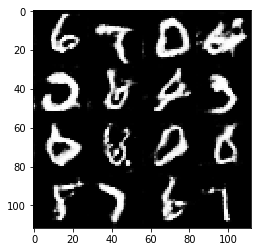

Epoch 2/2... Discriminator Loss: 1.0562... Generator Loss: 0.7889
Epoch 2/2... Discriminator Loss: 0.9503... Generator Loss: 0.8825
Epoch 2/2... Discriminator Loss: 0.7516... Generator Loss: 1.2748
Epoch 2/2... Discriminator Loss: 1.1317... Generator Loss: 0.6539
Epoch 2/2... Discriminator Loss: 0.8294... Generator Loss: 1.0765
Epoch 2/2... Discriminator Loss: 1.0247... Generator Loss: 0.6864
Epoch 2/2... Discriminator Loss: 0.9441... Generator Loss: 0.7687
Epoch 2/2... Discriminator Loss: 1.0013... Generator Loss: 0.7451
Epoch 2/2... Discriminator Loss: 0.8948... Generator Loss: 1.3444
Epoch 2/2... Discriminator Loss: 1.1280... Generator Loss: 0.5407


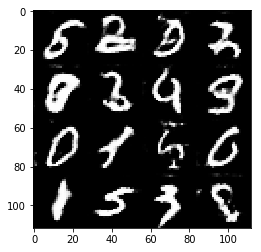

Epoch 2/2... Discriminator Loss: 0.7176... Generator Loss: 1.0097
Epoch 2/2... Discriminator Loss: 0.8021... Generator Loss: 0.9768
Epoch 2/2... Discriminator Loss: 0.9226... Generator Loss: 0.7371
Epoch 2/2... Discriminator Loss: 1.0528... Generator Loss: 0.7092
Epoch 2/2... Discriminator Loss: 0.8465... Generator Loss: 0.8444
Epoch 2/2... Discriminator Loss: 0.9439... Generator Loss: 0.6759
Epoch 2/2... Discriminator Loss: 0.8096... Generator Loss: 0.9308
Epoch 2/2... Discriminator Loss: 0.7142... Generator Loss: 1.0004
Epoch 2/2... Discriminator Loss: 0.5952... Generator Loss: 1.4002
Epoch 2/2... Discriminator Loss: 1.1166... Generator Loss: 0.5558


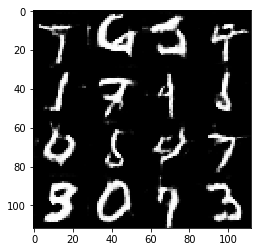

Epoch 2/2... Discriminator Loss: 0.5992... Generator Loss: 1.9414
Epoch 2/2... Discriminator Loss: 0.5643... Generator Loss: 1.1830
Epoch 2/2... Discriminator Loss: 0.6780... Generator Loss: 1.0177
Epoch 2/2... Discriminator Loss: 0.4953... Generator Loss: 1.9072
Epoch 2/2... Discriminator Loss: 2.0211... Generator Loss: 0.2059
Epoch 2/2... Discriminator Loss: 1.4270... Generator Loss: 3.4282
Epoch 2/2... Discriminator Loss: 1.7854... Generator Loss: 0.3050
Epoch 2/2... Discriminator Loss: 0.8706... Generator Loss: 1.4664
Epoch 2/2... Discriminator Loss: 0.5316... Generator Loss: 1.7048
Epoch 2/2... Discriminator Loss: 0.8121... Generator Loss: 0.9251


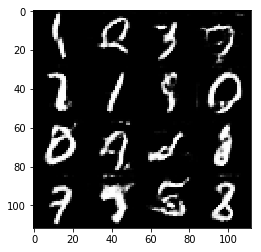

Epoch 2/2... Discriminator Loss: 1.1101... Generator Loss: 0.5525
Epoch 2/2... Discriminator Loss: 0.7370... Generator Loss: 1.4029
Epoch 2/2... Discriminator Loss: 0.6446... Generator Loss: 1.8814
Epoch 2/2... Discriminator Loss: 1.1679... Generator Loss: 0.5381
Epoch 2/2... Discriminator Loss: 0.9829... Generator Loss: 1.1770
Epoch 2/2... Discriminator Loss: 0.6943... Generator Loss: 1.2707
Epoch 2/2... Discriminator Loss: 1.3577... Generator Loss: 0.4430
Epoch 2/2... Discriminator Loss: 0.6983... Generator Loss: 1.9116
Epoch 2/2... Discriminator Loss: 1.1378... Generator Loss: 0.5575
Epoch 2/2... Discriminator Loss: 0.6413... Generator Loss: 1.4006


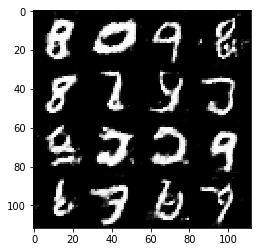

Epoch 2/2... Discriminator Loss: 0.8161... Generator Loss: 0.9079
Epoch 2/2... Discriminator Loss: 0.8265... Generator Loss: 1.5927
Epoch 2/2... Discriminator Loss: 1.4742... Generator Loss: 0.4058
Epoch 2/2... Discriminator Loss: 1.1144... Generator Loss: 2.2737
Epoch 2/2... Discriminator Loss: 1.8009... Generator Loss: 0.2582
Epoch 2/2... Discriminator Loss: 0.9678... Generator Loss: 1.8060
Epoch 2/2... Discriminator Loss: 0.8841... Generator Loss: 1.2051
Epoch 2/2... Discriminator Loss: 1.2819... Generator Loss: 0.4759
Epoch 2/2... Discriminator Loss: 0.9106... Generator Loss: 1.1616
Epoch 2/2... Discriminator Loss: 1.1483... Generator Loss: 0.6695


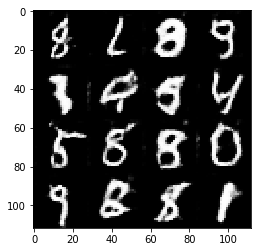

Epoch 2/2... Discriminator Loss: 0.7907... Generator Loss: 1.2271
Epoch 2/2... Discriminator Loss: 1.4555... Generator Loss: 0.3689
Epoch 2/2... Discriminator Loss: 1.0398... Generator Loss: 1.6457
Epoch 2/2... Discriminator Loss: 1.5923... Generator Loss: 0.3390
Epoch 2/2... Discriminator Loss: 1.4206... Generator Loss: 2.6227
Epoch 2/2... Discriminator Loss: 0.8538... Generator Loss: 0.9370
Epoch 2/2... Discriminator Loss: 0.9967... Generator Loss: 0.7030
Epoch 2/2... Discriminator Loss: 1.0130... Generator Loss: 1.3858
Epoch 2/2... Discriminator Loss: 0.9389... Generator Loss: 0.8370
Epoch 2/2... Discriminator Loss: 1.1394... Generator Loss: 0.6184


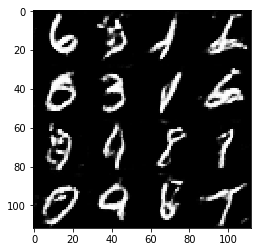

Epoch 2/2... Discriminator Loss: 0.8295... Generator Loss: 1.5050
Epoch 2/2... Discriminator Loss: 1.0474... Generator Loss: 0.8352
Epoch 2/2... Discriminator Loss: 1.0421... Generator Loss: 0.6615
Epoch 2/2... Discriminator Loss: 0.8699... Generator Loss: 1.1054
Epoch 2/2... Discriminator Loss: 0.9051... Generator Loss: 1.1338
Epoch 2/2... Discriminator Loss: 1.3875... Generator Loss: 0.4133
Epoch 2/2... Discriminator Loss: 0.8484... Generator Loss: 1.8403
Epoch 2/2... Discriminator Loss: 1.3098... Generator Loss: 0.4651
Epoch 2/2... Discriminator Loss: 1.0664... Generator Loss: 0.7253
Epoch 2/2... Discriminator Loss: 0.9293... Generator Loss: 0.9161


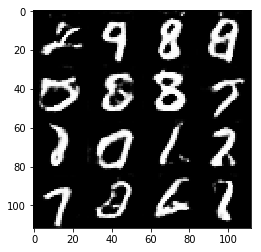

Epoch 2/2... Discriminator Loss: 0.8328... Generator Loss: 1.0296
Epoch 2/2... Discriminator Loss: 1.0664... Generator Loss: 0.6382
Epoch 2/2... Discriminator Loss: 0.8186... Generator Loss: 1.0124
Epoch 2/2... Discriminator Loss: 0.8191... Generator Loss: 0.8444
Epoch 2/2... Discriminator Loss: 0.8446... Generator Loss: 0.9266
Epoch 2/2... Discriminator Loss: 0.7698... Generator Loss: 0.9972
Epoch 2/2... Discriminator Loss: 1.0066... Generator Loss: 0.7039
Epoch 2/2... Discriminator Loss: 0.8039... Generator Loss: 0.9165
Epoch 2/2... Discriminator Loss: 0.6589... Generator Loss: 1.2204
Epoch 2/2... Discriminator Loss: 0.7168... Generator Loss: 0.9875


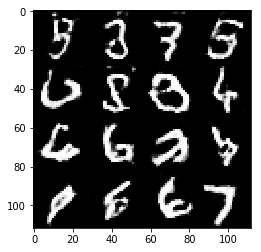

Epoch 2/2... Discriminator Loss: 0.5580... Generator Loss: 1.4363
Epoch 2/2... Discriminator Loss: 0.9032... Generator Loss: 0.7805
Epoch 2/2... Discriminator Loss: 0.8639... Generator Loss: 0.7954
Epoch 2/2... Discriminator Loss: 0.7106... Generator Loss: 1.7626
Epoch 2/2... Discriminator Loss: 1.4771... Generator Loss: 0.3756
Epoch 2/2... Discriminator Loss: 0.9299... Generator Loss: 0.8882
Epoch 2/2... Discriminator Loss: 0.9121... Generator Loss: 0.9065
Epoch 2/2... Discriminator Loss: 1.0946... Generator Loss: 0.5849
Epoch 2/2... Discriminator Loss: 0.7762... Generator Loss: 0.9797
Epoch 2/2... Discriminator Loss: 0.6463... Generator Loss: 1.3745


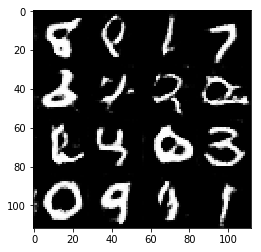

Epoch 2/2... Discriminator Loss: 1.3719... Generator Loss: 0.4769
Epoch 2/2... Discriminator Loss: 0.6444... Generator Loss: 1.2440
Epoch 2/2... Discriminator Loss: 0.6992... Generator Loss: 1.2427
Epoch 2/2... Discriminator Loss: 1.3142... Generator Loss: 0.4312
Epoch 2/2... Discriminator Loss: 0.8825... Generator Loss: 1.0495
Epoch 2/2... Discriminator Loss: 0.8579... Generator Loss: 0.8826
Epoch 2/2... Discriminator Loss: 2.1757... Generator Loss: 0.1745
Epoch 2/2... Discriminator Loss: 1.6554... Generator Loss: 2.7462
Epoch 2/2... Discriminator Loss: 1.5222... Generator Loss: 0.4217
Epoch 2/2... Discriminator Loss: 1.5071... Generator Loss: 2.6582


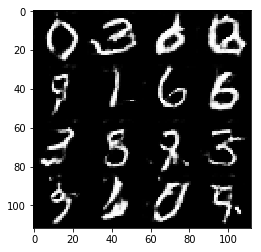

Epoch 2/2... Discriminator Loss: 1.8898... Generator Loss: 0.2483
Epoch 2/2... Discriminator Loss: 0.9981... Generator Loss: 1.5306
Epoch 2/2... Discriminator Loss: 0.8115... Generator Loss: 1.2186
Epoch 2/2... Discriminator Loss: 1.0472... Generator Loss: 0.7674
Epoch 2/2... Discriminator Loss: 1.0446... Generator Loss: 0.7553
Epoch 2/2... Discriminator Loss: 0.9725... Generator Loss: 1.0401
Epoch 2/2... Discriminator Loss: 1.0783... Generator Loss: 0.6729
Epoch 2/2... Discriminator Loss: 0.8968... Generator Loss: 1.8505
Epoch 2/2... Discriminator Loss: 0.9499... Generator Loss: 0.7402
Epoch 2/2... Discriminator Loss: 0.7810... Generator Loss: 1.1507


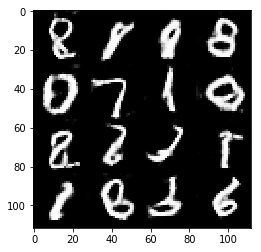

Epoch 2/2... Discriminator Loss: 0.9512... Generator Loss: 0.8710
Epoch 2/2... Discriminator Loss: 0.8745... Generator Loss: 1.9052
Epoch 2/2... Discriminator Loss: 0.9700... Generator Loss: 0.7340
Epoch 2/2... Discriminator Loss: 0.8862... Generator Loss: 1.2136
Epoch 2/2... Discriminator Loss: 1.0099... Generator Loss: 0.7212
Epoch 2/2... Discriminator Loss: 0.9690... Generator Loss: 1.0237
Epoch 2/2... Discriminator Loss: 1.0242... Generator Loss: 0.8501
Epoch 2/2... Discriminator Loss: 1.0059... Generator Loss: 0.7589
Epoch 2/2... Discriminator Loss: 0.9864... Generator Loss: 1.0849
Epoch 2/2... Discriminator Loss: 0.8351... Generator Loss: 1.1611


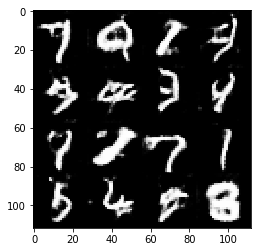

Epoch 2/2... Discriminator Loss: 1.3226... Generator Loss: 0.4263
Epoch 2/2... Discriminator Loss: 0.9180... Generator Loss: 1.2223
Epoch 2/2... Discriminator Loss: 0.7058... Generator Loss: 1.1127
Epoch 2/2... Discriminator Loss: 1.1724... Generator Loss: 0.5806
Epoch 2/2... Discriminator Loss: 0.6163... Generator Loss: 1.4835
Epoch 2/2... Discriminator Loss: 1.0474... Generator Loss: 0.5829
Epoch 2/2... Discriminator Loss: 0.8126... Generator Loss: 1.0202
Epoch 2/2... Discriminator Loss: 0.6965... Generator Loss: 1.2085
Epoch 2/2... Discriminator Loss: 0.5264... Generator Loss: 1.4062
Epoch 2/2... Discriminator Loss: 0.7924... Generator Loss: 0.8646


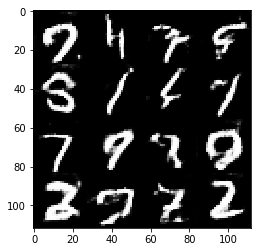

Epoch 2/2... Discriminator Loss: 0.7860... Generator Loss: 0.8610
Epoch 2/2... Discriminator Loss: 0.7002... Generator Loss: 1.1729
Epoch 2/2... Discriminator Loss: 1.1516... Generator Loss: 0.5069
Epoch 2/2... Discriminator Loss: 0.5862... Generator Loss: 1.9699
Epoch 2/2... Discriminator Loss: 1.1283... Generator Loss: 0.5038
Epoch 2/2... Discriminator Loss: 0.7472... Generator Loss: 1.4976
Epoch 2/2... Discriminator Loss: 0.8857... Generator Loss: 0.8204
Epoch 2/2... Discriminator Loss: 0.6953... Generator Loss: 1.0847
Epoch 2/2... Discriminator Loss: 0.6894... Generator Loss: 1.0895
Epoch 2/2... Discriminator Loss: 1.0607... Generator Loss: 0.5857


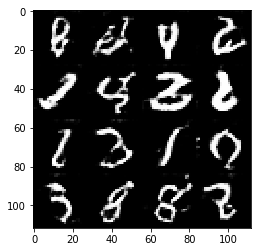

Epoch 2/2... Discriminator Loss: 0.8455... Generator Loss: 0.9457
Epoch 2/2... Discriminator Loss: 0.6631... Generator Loss: 1.2397
Epoch 2/2... Discriminator Loss: 0.9828... Generator Loss: 0.6145
Epoch 2/2... Discriminator Loss: 0.9651... Generator Loss: 0.6875
Epoch 2/2... Discriminator Loss: 0.7157... Generator Loss: 1.9378
Epoch 2/2... Discriminator Loss: 1.6082... Generator Loss: 0.3090
Epoch 2/2... Discriminator Loss: 0.9205... Generator Loss: 2.5386
Epoch 2/2... Discriminator Loss: 1.7216... Generator Loss: 0.3102
Epoch 2/2... Discriminator Loss: 0.7417... Generator Loss: 1.5000
Epoch 2/2... Discriminator Loss: 0.8394... Generator Loss: 1.1059


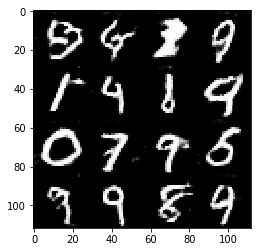

Epoch 2/2... Discriminator Loss: 0.9238... Generator Loss: 0.6966
Epoch 2/2... Discriminator Loss: 0.8773... Generator Loss: 0.9419
Epoch 2/2... Discriminator Loss: 0.9625... Generator Loss: 0.6760
Epoch 2/2... Discriminator Loss: 0.6951... Generator Loss: 1.1473
Epoch 2/2... Discriminator Loss: 0.8791... Generator Loss: 0.7842
Epoch 2/2... Discriminator Loss: 0.6712... Generator Loss: 1.2957
Epoch 2/2... Discriminator Loss: 0.5939... Generator Loss: 1.1976
Epoch 2/2... Discriminator Loss: 0.9094... Generator Loss: 0.7816
Epoch 2/2... Discriminator Loss: 0.6945... Generator Loss: 1.5206
Epoch 2/2... Discriminator Loss: 1.1979... Generator Loss: 0.5775


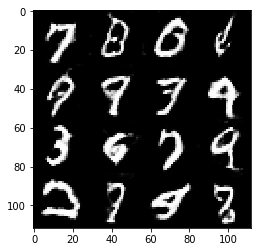

Epoch 2/2... Discriminator Loss: 0.6777... Generator Loss: 1.4753
Epoch 2/2... Discriminator Loss: 1.1443... Generator Loss: 0.5704
Epoch 2/2... Discriminator Loss: 0.7088... Generator Loss: 1.9921
Epoch 2/2... Discriminator Loss: 1.4022... Generator Loss: 0.4194
Epoch 2/2... Discriminator Loss: 0.9194... Generator Loss: 2.0840
Epoch 2/2... Discriminator Loss: 1.5605... Generator Loss: 0.3742
Epoch 2/2... Discriminator Loss: 0.7711... Generator Loss: 1.1598
Epoch 2/2... Discriminator Loss: 0.7003... Generator Loss: 1.1913
Epoch 2/2... Discriminator Loss: 1.1419... Generator Loss: 0.5401
Epoch 2/2... Discriminator Loss: 0.9454... Generator Loss: 1.4048


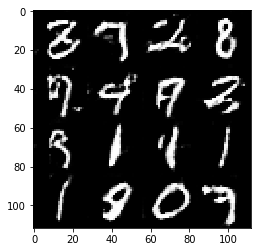

Epoch 2/2... Discriminator Loss: 0.8752... Generator Loss: 0.8202
Epoch 2/2... Discriminator Loss: 0.7871... Generator Loss: 1.1633
Epoch 2/2... Discriminator Loss: 0.9692... Generator Loss: 0.7094
Epoch 2/2... Discriminator Loss: 0.5606... Generator Loss: 1.3267
Epoch 2/2... Discriminator Loss: 0.7056... Generator Loss: 1.4014
Epoch 2/2... Discriminator Loss: 0.9558... Generator Loss: 0.7283
Epoch 2/2... Discriminator Loss: 0.7972... Generator Loss: 1.2582
Epoch 2/2... Discriminator Loss: 1.1762... Generator Loss: 0.5691
Epoch 2/2... Discriminator Loss: 0.6350... Generator Loss: 1.6354
Epoch 2/2... Discriminator Loss: 0.6494... Generator Loss: 1.1069


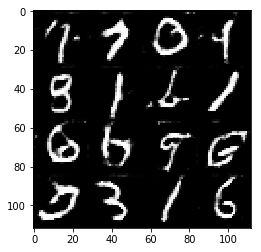

Epoch 2/2... Discriminator Loss: 0.7674... Generator Loss: 0.9187
Epoch 2/2... Discriminator Loss: 0.9389... Generator Loss: 0.6924
Epoch 2/2... Discriminator Loss: 0.7865... Generator Loss: 1.9613
Epoch 2/2... Discriminator Loss: 1.9059... Generator Loss: 0.2353
Epoch 2/2... Discriminator Loss: 2.2912... Generator Loss: 3.5285
Epoch 2/2... Discriminator Loss: 2.2688... Generator Loss: 0.1559
Epoch 2/2... Discriminator Loss: 1.5119... Generator Loss: 3.3590
Epoch 2/2... Discriminator Loss: 1.0502... Generator Loss: 0.7771
Epoch 2/2... Discriminator Loss: 0.8985... Generator Loss: 1.9604
Epoch 2/2... Discriminator Loss: 0.7635... Generator Loss: 1.1462


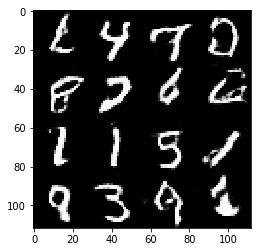

Epoch 2/2... Discriminator Loss: 1.0671... Generator Loss: 0.6491
Epoch 2/2... Discriminator Loss: 0.6914... Generator Loss: 1.4028
Epoch 2/2... Discriminator Loss: 0.7690... Generator Loss: 1.4876
Epoch 2/2... Discriminator Loss: 0.9116... Generator Loss: 0.9080
Epoch 2/2... Discriminator Loss: 0.7073... Generator Loss: 1.2041
Epoch 2/2... Discriminator Loss: 0.9473... Generator Loss: 1.1030
Epoch 2/2... Discriminator Loss: 0.9577... Generator Loss: 0.7986
Epoch 2/2... Discriminator Loss: 0.7421... Generator Loss: 1.7930
Epoch 2/2... Discriminator Loss: 0.9029... Generator Loss: 0.8066
Epoch 2/2... Discriminator Loss: 0.9786... Generator Loss: 0.7913


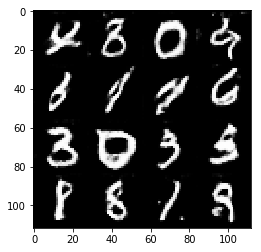

Epoch 2/2... Discriminator Loss: 0.8510... Generator Loss: 1.5202
Epoch 2/2... Discriminator Loss: 1.3435... Generator Loss: 0.4424
Epoch 2/2... Discriminator Loss: 1.1653... Generator Loss: 1.8995
Epoch 2/2... Discriminator Loss: 1.3424... Generator Loss: 0.4901
Epoch 2/2... Discriminator Loss: 0.9009... Generator Loss: 1.0642
Epoch 2/2... Discriminator Loss: 0.8059... Generator Loss: 1.3490
Epoch 2/2... Discriminator Loss: 1.0627... Generator Loss: 0.6328
Epoch 2/2... Discriminator Loss: 0.7900... Generator Loss: 1.1736
Epoch 2/2... Discriminator Loss: 0.8378... Generator Loss: 0.9533
Epoch 2/2... Discriminator Loss: 1.3018... Generator Loss: 0.5093


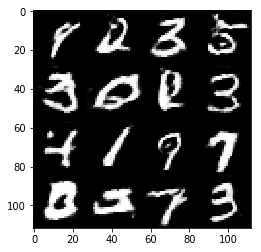

Epoch 2/2... Discriminator Loss: 0.7746... Generator Loss: 1.9314
Epoch 2/2... Discriminator Loss: 0.9655... Generator Loss: 0.6825
Epoch 2/2... Discriminator Loss: 0.9205... Generator Loss: 1.1066
Epoch 2/2... Discriminator Loss: 0.7520... Generator Loss: 0.9638
Epoch 2/2... Discriminator Loss: 1.2002... Generator Loss: 0.5617
Epoch 2/2... Discriminator Loss: 0.6589... Generator Loss: 1.4604
Epoch 2/2... Discriminator Loss: 0.7323... Generator Loss: 0.9647
Epoch 2/2... Discriminator Loss: 1.5292... Generator Loss: 0.3249
Epoch 2/2... Discriminator Loss: 1.0767... Generator Loss: 1.9414
Epoch 2/2... Discriminator Loss: 0.9909... Generator Loss: 0.7131


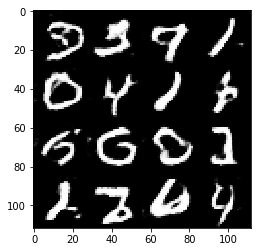

Epoch 2/2... Discriminator Loss: 0.9726... Generator Loss: 0.7046
Epoch 2/2... Discriminator Loss: 1.0301... Generator Loss: 0.6686
Epoch 2/2... Discriminator Loss: 0.7366... Generator Loss: 1.0911
Epoch 2/2... Discriminator Loss: 0.8487... Generator Loss: 1.1510
Epoch 2/2... Discriminator Loss: 1.5020... Generator Loss: 0.3584
Epoch 2/2... Discriminator Loss: 0.6093... Generator Loss: 1.9333
Epoch 2/2... Discriminator Loss: 0.8121... Generator Loss: 0.9705
Epoch 2/2... Discriminator Loss: 0.7191... Generator Loss: 1.2305
Epoch 2/2... Discriminator Loss: 0.8544... Generator Loss: 0.8456
Epoch 2/2... Discriminator Loss: 0.6727... Generator Loss: 1.2313


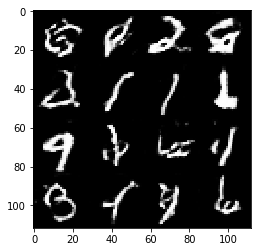

Epoch 2/2... Discriminator Loss: 1.0274... Generator Loss: 0.6318
Epoch 2/2... Discriminator Loss: 0.9172... Generator Loss: 0.9346
Epoch 2/2... Discriminator Loss: 0.7665... Generator Loss: 1.1922
Epoch 2/2... Discriminator Loss: 0.9078... Generator Loss: 0.7842
Epoch 2/2... Discriminator Loss: 0.8130... Generator Loss: 0.9482
Epoch 2/2... Discriminator Loss: 0.6441... Generator Loss: 1.3986
Epoch 2/2... Discriminator Loss: 1.4000... Generator Loss: 0.4122
Epoch 2/2... Discriminator Loss: 0.7509... Generator Loss: 1.2414
Epoch 2/2... Discriminator Loss: 0.8377... Generator Loss: 0.8250
Epoch 2/2... Discriminator Loss: 0.8868... Generator Loss: 0.8280


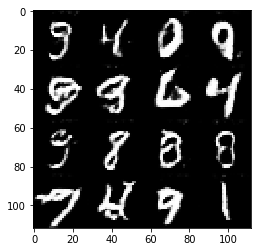

Epoch 2/2... Discriminator Loss: 0.9293... Generator Loss: 0.7278
Epoch 2/2... Discriminator Loss: 0.8616... Generator Loss: 0.8419
Epoch 2/2... Discriminator Loss: 0.7433... Generator Loss: 1.8944
Epoch 2/2... Discriminator Loss: 1.7344... Generator Loss: 0.2917
Epoch 2/2... Discriminator Loss: 0.7375... Generator Loss: 1.8184
Epoch 2/2... Discriminator Loss: 0.7245... Generator Loss: 1.0736
Epoch 2/2... Discriminator Loss: 1.1915... Generator Loss: 0.6091
Epoch 2/2... Discriminator Loss: 0.7955... Generator Loss: 1.0088
Epoch 2/2... Discriminator Loss: 0.5874... Generator Loss: 1.5505
Epoch 2/2... Discriminator Loss: 0.9737... Generator Loss: 0.7371


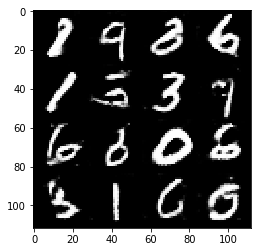

Epoch 2/2... Discriminator Loss: 0.6149... Generator Loss: 1.2653
Epoch 2/2... Discriminator Loss: 0.7599... Generator Loss: 1.0957
Epoch 2/2... Discriminator Loss: 1.5589... Generator Loss: 0.3503
Epoch 2/2... Discriminator Loss: 1.2117... Generator Loss: 2.1685
Epoch 2/2... Discriminator Loss: 1.4022... Generator Loss: 0.4605
Epoch 2/2... Discriminator Loss: 2.3826... Generator Loss: 3.5873
Epoch 2/2... Discriminator Loss: 2.4193... Generator Loss: 0.1464
Epoch 2/2... Discriminator Loss: 0.8586... Generator Loss: 1.7536
Epoch 2/2... Discriminator Loss: 1.2117... Generator Loss: 1.8474
Epoch 2/2... Discriminator Loss: 1.2841... Generator Loss: 0.4909


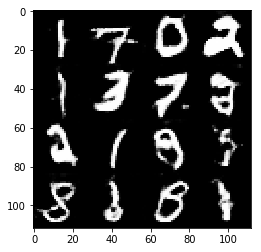

Epoch 2/2... Discriminator Loss: 0.9167... Generator Loss: 1.6924
Epoch 2/2... Discriminator Loss: 0.9009... Generator Loss: 1.1178
Epoch 2/2... Discriminator Loss: 1.4717... Generator Loss: 0.4044
Epoch 2/2... Discriminator Loss: 0.9869... Generator Loss: 1.9581
Epoch 2/2... Discriminator Loss: 1.1425... Generator Loss: 0.8951
Epoch 2/2... Discriminator Loss: 1.0870... Generator Loss: 0.7982
Epoch 2/2... Discriminator Loss: 0.9828... Generator Loss: 1.2539
Epoch 2/2... Discriminator Loss: 1.0479... Generator Loss: 0.6051
Epoch 2/2... Discriminator Loss: 0.9081... Generator Loss: 1.5317
Epoch 2/2... Discriminator Loss: 1.0022... Generator Loss: 0.7215


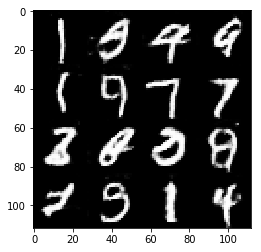

Epoch 2/2... Discriminator Loss: 0.8520... Generator Loss: 1.2262
Epoch 2/2... Discriminator Loss: 1.1064... Generator Loss: 0.5955
Epoch 2/2... Discriminator Loss: 0.9420... Generator Loss: 1.5118
Epoch 2/2... Discriminator Loss: 1.1679... Generator Loss: 0.5855
Epoch 2/2... Discriminator Loss: 0.7889... Generator Loss: 0.9650
Epoch 2/2... Discriminator Loss: 0.7640... Generator Loss: 1.1404
Epoch 2/2... Discriminator Loss: 1.0889... Generator Loss: 0.6223
Epoch 2/2... Discriminator Loss: 0.9167... Generator Loss: 0.8806
Epoch 2/2... Discriminator Loss: 0.6554... Generator Loss: 1.4812
Epoch 2/2... Discriminator Loss: 1.4575... Generator Loss: 0.3822


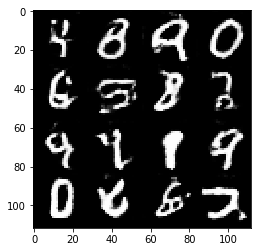

Epoch 2/2... Discriminator Loss: 0.7601... Generator Loss: 1.5077
Epoch 2/2... Discriminator Loss: 1.0426... Generator Loss: 0.6610
Epoch 2/2... Discriminator Loss: 0.8192... Generator Loss: 0.9139
Epoch 2/2... Discriminator Loss: 0.9509... Generator Loss: 0.7716
Epoch 2/2... Discriminator Loss: 1.0257... Generator Loss: 0.6569
Epoch 2/2... Discriminator Loss: 0.8064... Generator Loss: 1.1508
Epoch 2/2... Discriminator Loss: 1.1751... Generator Loss: 0.5647
Epoch 2/2... Discriminator Loss: 0.7163... Generator Loss: 1.9624
Epoch 2/2... Discriminator Loss: 1.1918... Generator Loss: 0.5582
Epoch 2/2... Discriminator Loss: 0.9474... Generator Loss: 0.6760


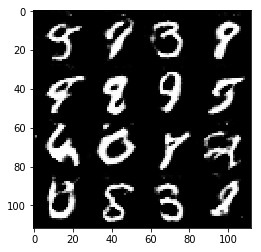

Epoch 2/2... Discriminator Loss: 0.7116... Generator Loss: 1.5255
Epoch 2/2... Discriminator Loss: 1.2328... Generator Loss: 0.5285
Epoch 2/2... Discriminator Loss: 0.8950... Generator Loss: 1.5413
Epoch 2/2... Discriminator Loss: 1.2584... Generator Loss: 0.4736
Epoch 2/2... Discriminator Loss: 0.8067... Generator Loss: 1.3259
Epoch 2/2... Discriminator Loss: 0.9065... Generator Loss: 0.7910
Epoch 2/2... Discriminator Loss: 0.9459... Generator Loss: 1.0887
Epoch 2/2... Discriminator Loss: 1.5094... Generator Loss: 0.3466
Epoch 2/2... Discriminator Loss: 0.9461... Generator Loss: 2.3742
Epoch 2/2... Discriminator Loss: 1.1846... Generator Loss: 0.5045


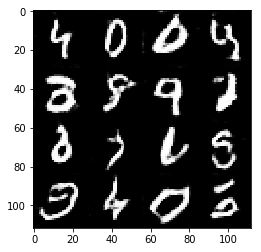

Epoch 2/2... Discriminator Loss: 0.8225... Generator Loss: 1.3016
Epoch 2/2... Discriminator Loss: 0.8249... Generator Loss: 1.0305
Epoch 2/2... Discriminator Loss: 0.7186... Generator Loss: 1.3616
Epoch 2/2... Discriminator Loss: 0.8780... Generator Loss: 0.7969
Epoch 2/2... Discriminator Loss: 0.8719... Generator Loss: 1.2927
Epoch 2/2... Discriminator Loss: 1.4402... Generator Loss: 0.3554
Epoch 2/2... Discriminator Loss: 0.6327... Generator Loss: 1.8683
Epoch 2/2... Discriminator Loss: 1.4749... Generator Loss: 0.4001
Epoch 2/2... Discriminator Loss: 0.6744... Generator Loss: 1.3715
Epoch 2/2... Discriminator Loss: 0.9315... Generator Loss: 0.7420


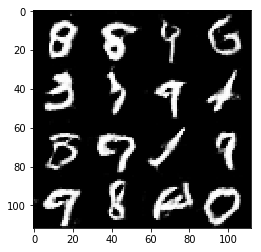

Epoch 2/2... Discriminator Loss: 0.7864... Generator Loss: 1.0188
Epoch 2/2... Discriminator Loss: 0.9866... Generator Loss: 0.7545
Epoch 2/2... Discriminator Loss: 0.5912... Generator Loss: 1.9783
Epoch 2/2... Discriminator Loss: 1.2314... Generator Loss: 0.4984
Epoch 2/2... Discriminator Loss: 0.7213... Generator Loss: 1.1404
Epoch 2/2... Discriminator Loss: 0.5855... Generator Loss: 1.6317
Epoch 2/2... Discriminator Loss: 0.5614... Generator Loss: 1.2241
Epoch 2/2... Discriminator Loss: 0.5378... Generator Loss: 1.3349
Epoch 2/2... Discriminator Loss: 0.8806... Generator Loss: 0.7653
Epoch 2/2... Discriminator Loss: 0.6764... Generator Loss: 1.1597


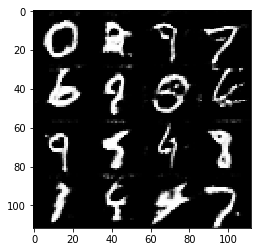

Epoch 2/2... Discriminator Loss: 0.5694... Generator Loss: 1.5340
Epoch 2/2... Discriminator Loss: 1.5696... Generator Loss: 0.3463
Epoch 2/2... Discriminator Loss: 0.6856... Generator Loss: 1.4033
Epoch 2/2... Discriminator Loss: 0.8517... Generator Loss: 0.8619
Epoch 2/2... Discriminator Loss: 0.7772... Generator Loss: 1.2901
Epoch 2/2... Discriminator Loss: 0.9006... Generator Loss: 0.7436
Epoch 2/2... Discriminator Loss: 0.8793... Generator Loss: 0.8854
Epoch 2/2... Discriminator Loss: 1.1098... Generator Loss: 0.6416
Epoch 2/2... Discriminator Loss: 0.6351... Generator Loss: 1.4176
Epoch 2/2... Discriminator Loss: 0.5485... Generator Loss: 1.2332


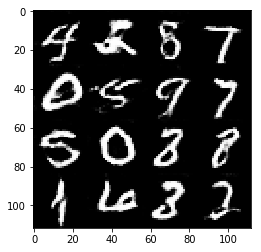

Epoch 2/2... Discriminator Loss: 0.9454... Generator Loss: 0.7213
Epoch 2/2... Discriminator Loss: 0.9145... Generator Loss: 2.3753
Epoch 2/2... Discriminator Loss: 1.4350... Generator Loss: 0.4960
Epoch 2/2... Discriminator Loss: 0.8951... Generator Loss: 1.8294
Epoch 2/2... Discriminator Loss: 1.3591... Generator Loss: 0.4466
Epoch 2/2... Discriminator Loss: 0.5485... Generator Loss: 1.8058
Epoch 2/2... Discriminator Loss: 0.8873... Generator Loss: 0.9296
Epoch 2/2... Discriminator Loss: 1.1373... Generator Loss: 0.6637
Epoch 2/2... Discriminator Loss: 1.0636... Generator Loss: 1.7775
Epoch 2/2... Discriminator Loss: 1.6059... Generator Loss: 0.3531


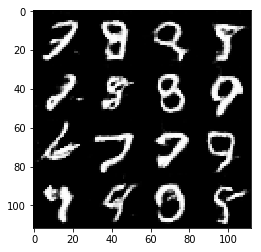

Epoch 2/2... Discriminator Loss: 1.2814... Generator Loss: 2.2806
Epoch 2/2... Discriminator Loss: 2.2079... Generator Loss: 0.2013
Epoch 2/2... Discriminator Loss: 1.3043... Generator Loss: 3.2162
Epoch 2/2... Discriminator Loss: 0.8362... Generator Loss: 1.0379
Epoch 2/2... Discriminator Loss: 1.1215... Generator Loss: 0.6476
Epoch 2/2... Discriminator Loss: 1.0111... Generator Loss: 2.0270
Epoch 2/2... Discriminator Loss: 1.2135... Generator Loss: 0.4973
Epoch 2/2... Discriminator Loss: 0.8699... Generator Loss: 1.7034
Epoch 2/2... Discriminator Loss: 0.9549... Generator Loss: 0.9722
Epoch 2/2... Discriminator Loss: 0.7448... Generator Loss: 1.0366


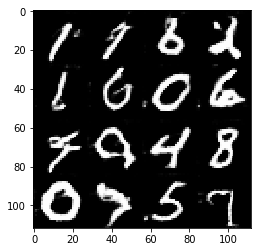

Epoch 2/2... Discriminator Loss: 0.8693... Generator Loss: 1.0438
Epoch 2/2... Discriminator Loss: 0.9442... Generator Loss: 1.5001
Epoch 2/2... Discriminator Loss: 1.3852... Generator Loss: 0.4914
Epoch 2/2... Discriminator Loss: 1.0631... Generator Loss: 2.2261
Epoch 2/2... Discriminator Loss: 1.5631... Generator Loss: 0.3685
Epoch 2/2... Discriminator Loss: 0.7621... Generator Loss: 1.2257
Epoch 2/2... Discriminator Loss: 0.8027... Generator Loss: 1.5328
Epoch 2/2... Discriminator Loss: 0.8696... Generator Loss: 0.9377
Epoch 2/2... Discriminator Loss: 1.1007... Generator Loss: 0.7258
Epoch 2/2... Discriminator Loss: 0.8984... Generator Loss: 1.4459


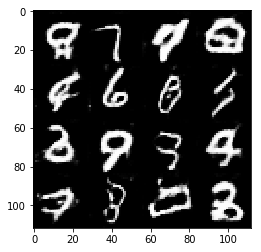

Epoch 2/2... Discriminator Loss: 1.4652... Generator Loss: 0.4305
Epoch 2/2... Discriminator Loss: 0.6802... Generator Loss: 1.4562
Epoch 2/2... Discriminator Loss: 0.7753... Generator Loss: 1.2894
Epoch 2/2... Discriminator Loss: 1.6407... Generator Loss: 0.3150
Epoch 2/2... Discriminator Loss: 0.6806... Generator Loss: 1.6836
Epoch 2/2... Discriminator Loss: 1.0247... Generator Loss: 0.6637
Epoch 2/2... Discriminator Loss: 0.8698... Generator Loss: 1.0111
Epoch 2/2... Discriminator Loss: 0.6959... Generator Loss: 1.2394
Epoch 2/2... Discriminator Loss: 1.5258... Generator Loss: 0.3343
Epoch 2/2... Discriminator Loss: 0.8187... Generator Loss: 1.0164


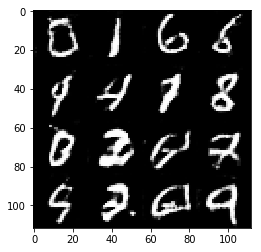

Epoch 2/2... Discriminator Loss: 0.7610... Generator Loss: 1.0923
Epoch 2/2... Discriminator Loss: 1.0233... Generator Loss: 0.5919
Epoch 2/2... Discriminator Loss: 0.8477... Generator Loss: 1.9645
Epoch 2/2... Discriminator Loss: 0.8134... Generator Loss: 0.8353
Epoch 2/2... Discriminator Loss: 1.1044... Generator Loss: 0.6562
Epoch 2/2... Discriminator Loss: 0.7796... Generator Loss: 1.5693
Epoch 2/2... Discriminator Loss: 1.1271... Generator Loss: 0.5349
Epoch 2/2... Discriminator Loss: 0.7868... Generator Loss: 1.0054
Epoch 2/2... Discriminator Loss: 0.7799... Generator Loss: 1.0807
Epoch 2/2... Discriminator Loss: 1.1538... Generator Loss: 0.5425


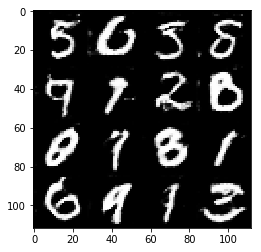

Epoch 2/2... Discriminator Loss: 0.7869... Generator Loss: 1.1747
Epoch 2/2... Discriminator Loss: 1.0289... Generator Loss: 0.6611
Epoch 2/2... Discriminator Loss: 0.6042... Generator Loss: 1.4691
Epoch 2/2... Discriminator Loss: 1.2680... Generator Loss: 0.4864
Epoch 2/2... Discriminator Loss: 0.7293... Generator Loss: 1.7656
Epoch 2/2... Discriminator Loss: 1.0553... Generator Loss: 0.6745
Epoch 2/2... Discriminator Loss: 0.6357... Generator Loss: 1.5181
Epoch 2/2... Discriminator Loss: 1.5161... Generator Loss: 0.3758
Epoch 2/2... Discriminator Loss: 1.0872... Generator Loss: 2.3566
Epoch 2/2... Discriminator Loss: 1.8529... Generator Loss: 0.2313


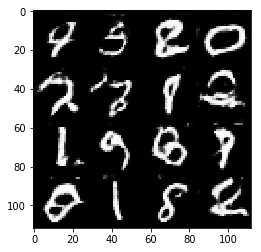

Epoch 2/2... Discriminator Loss: 0.6031... Generator Loss: 2.6526
Epoch 2/2... Discriminator Loss: 0.6132... Generator Loss: 1.1025
Epoch 2/2... Discriminator Loss: 0.6200... Generator Loss: 1.2258
Epoch 2/2... Discriminator Loss: 0.7278... Generator Loss: 0.9188
Epoch 2/2... Discriminator Loss: 0.7975... Generator Loss: 0.9322
Epoch 2/2... Discriminator Loss: 0.8291... Generator Loss: 0.9165
Epoch 2/2... Discriminator Loss: 0.6933... Generator Loss: 0.9967
Epoch 2/2... Discriminator Loss: 0.7360... Generator Loss: 0.9997
Epoch 2/2... Discriminator Loss: 0.5159... Generator Loss: 1.5772
Epoch 2/2... Discriminator Loss: 0.4969... Generator Loss: 1.3626


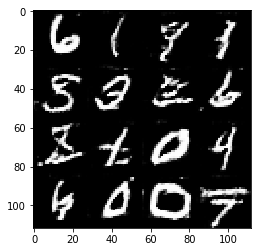

Epoch 2/2... Discriminator Loss: 1.0274... Generator Loss: 0.6154
Epoch 2/2... Discriminator Loss: 0.6146... Generator Loss: 1.2152
Epoch 2/2... Discriminator Loss: 0.6194... Generator Loss: 1.1735
Epoch 2/2... Discriminator Loss: 0.7640... Generator Loss: 0.8675
Epoch 2/2... Discriminator Loss: 0.7901... Generator Loss: 1.0300
Epoch 2/2... Discriminator Loss: 0.7908... Generator Loss: 0.8136
Epoch 2/2... Discriminator Loss: 1.1270... Generator Loss: 0.6298
Epoch 2/2... Discriminator Loss: 0.7818... Generator Loss: 1.7218
Epoch 2/2... Discriminator Loss: 1.4378... Generator Loss: 0.4073
Epoch 2/2... Discriminator Loss: 0.7614... Generator Loss: 1.6775


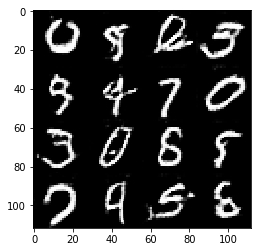

Epoch 2/2... Discriminator Loss: 2.3668... Generator Loss: 0.1700
Epoch 2/2... Discriminator Loss: 1.8909... Generator Loss: 3.3997
Epoch 2/2... Discriminator Loss: 1.3294... Generator Loss: 0.4540
Epoch 2/2... Discriminator Loss: 0.7657... Generator Loss: 1.4038
Epoch 2/2... Discriminator Loss: 0.8132... Generator Loss: 1.6046
Epoch 2/2... Discriminator Loss: 1.0352... Generator Loss: 0.7700
Epoch 2/2... Discriminator Loss: 0.7950... Generator Loss: 1.1976
Epoch 2/2... Discriminator Loss: 0.9981... Generator Loss: 0.9317
Epoch 2/2... Discriminator Loss: 0.8977... Generator Loss: 1.4970
Epoch 2/2... Discriminator Loss: 1.3562... Generator Loss: 0.4526


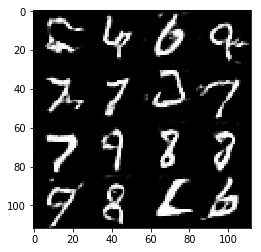

Epoch 2/2... Discriminator Loss: 0.7030... Generator Loss: 1.1661
Epoch 2/2... Discriminator Loss: 0.7498... Generator Loss: 1.3526
Epoch 2/2... Discriminator Loss: 1.0625... Generator Loss: 0.5819
Epoch 2/2... Discriminator Loss: 0.8975... Generator Loss: 0.7708
Epoch 2/2... Discriminator Loss: 0.8559... Generator Loss: 1.8528
Epoch 2/2... Discriminator Loss: 0.9894... Generator Loss: 0.6725
Epoch 2/2... Discriminator Loss: 0.8034... Generator Loss: 1.1252
Epoch 2/2... Discriminator Loss: 0.9065... Generator Loss: 0.7400
Epoch 2/2... Discriminator Loss: 1.0897... Generator Loss: 0.5900
Epoch 2/2... Discriminator Loss: 0.6962... Generator Loss: 1.4303


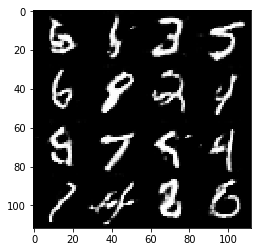

Epoch 2/2... Discriminator Loss: 0.7773... Generator Loss: 0.9209
Epoch 2/2... Discriminator Loss: 0.7831... Generator Loss: 0.8269
Epoch 2/2... Discriminator Loss: 0.7165... Generator Loss: 1.0874
Epoch 2/2... Discriminator Loss: 0.8264... Generator Loss: 0.8316
Epoch 2/2... Discriminator Loss: 0.8881... Generator Loss: 0.7237
Epoch 2/2... Discriminator Loss: 0.6067... Generator Loss: 1.2859
Epoch 2/2... Discriminator Loss: 0.7894... Generator Loss: 0.9112
Epoch 2/2... Discriminator Loss: 0.6862... Generator Loss: 0.9938
Epoch 2/2... Discriminator Loss: 0.7749... Generator Loss: 1.0894
Epoch 2/2... Discriminator Loss: 1.2057... Generator Loss: 0.5165


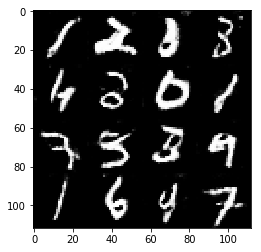

Epoch 2/2... Discriminator Loss: 0.5543... Generator Loss: 1.6584
Epoch 2/2... Discriminator Loss: 0.9984... Generator Loss: 0.8344
Epoch 2/2... Discriminator Loss: 0.8227... Generator Loss: 0.8711
Epoch 2/2... Discriminator Loss: 0.7196... Generator Loss: 0.9565
Epoch 2/2... Discriminator Loss: 0.5466... Generator Loss: 1.4804
Epoch 2/2... Discriminator Loss: 0.5132... Generator Loss: 1.4642
Epoch 2/2... Discriminator Loss: 0.8939... Generator Loss: 0.7048
Epoch 2/2... Discriminator Loss: 0.6314... Generator Loss: 1.2883
Epoch 2/2... Discriminator Loss: 1.2598... Generator Loss: 0.4894
Epoch 2/2... Discriminator Loss: 0.7282... Generator Loss: 1.7936


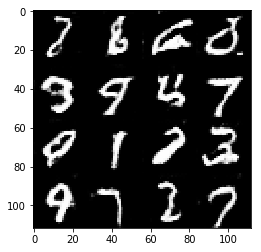

Epoch 2/2... Discriminator Loss: 1.0763... Generator Loss: 0.5713
Epoch 2/2... Discriminator Loss: 0.8100... Generator Loss: 1.1067
Epoch 2/2... Discriminator Loss: 0.7128... Generator Loss: 0.9829
Epoch 2/2... Discriminator Loss: 0.6678... Generator Loss: 1.2558
Epoch 2/2... Discriminator Loss: 0.4318... Generator Loss: 1.7968
Epoch 2/2... Discriminator Loss: 1.3877... Generator Loss: 0.4205
Epoch 2/2... Discriminator Loss: 1.5562... Generator Loss: 3.5192
Epoch 2/2... Discriminator Loss: 1.1489... Generator Loss: 0.6024
Epoch 2/2... Discriminator Loss: 0.7615... Generator Loss: 1.3763
Epoch 2/2... Discriminator Loss: 0.8233... Generator Loss: 1.3906


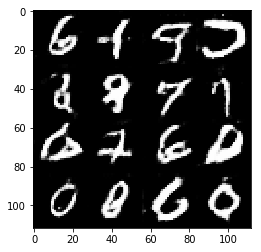

Epoch 2/2... Discriminator Loss: 1.0244... Generator Loss: 0.6494
Epoch 2/2... Discriminator Loss: 0.9756... Generator Loss: 1.8491
Epoch 2/2... Discriminator Loss: 1.0895... Generator Loss: 0.5662
Epoch 2/2... Discriminator Loss: 0.7845... Generator Loss: 1.3607
Epoch 2/2... Discriminator Loss: 0.8781... Generator Loss: 1.4391
Epoch 2/2... Discriminator Loss: 1.4249... Generator Loss: 0.4111
Epoch 2/2... Discriminator Loss: 0.9059... Generator Loss: 2.0098
Epoch 2/2... Discriminator Loss: 0.9420... Generator Loss: 0.7652
Epoch 2/2... Discriminator Loss: 0.7249... Generator Loss: 1.1996
Epoch 2/2... Discriminator Loss: 0.8354... Generator Loss: 1.3041


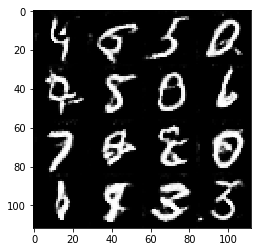

Epoch 2/2... Discriminator Loss: 1.0887... Generator Loss: 0.7477
Epoch 2/2... Discriminator Loss: 0.9328... Generator Loss: 1.2556
Epoch 2/2... Discriminator Loss: 0.9157... Generator Loss: 0.7462
Epoch 2/2... Discriminator Loss: 0.9787... Generator Loss: 1.4029
Epoch 2/2... Discriminator Loss: 0.9959... Generator Loss: 0.6922
Epoch 2/2... Discriminator Loss: 0.7879... Generator Loss: 1.5714
Epoch 2/2... Discriminator Loss: 0.9980... Generator Loss: 0.6732
Epoch 2/2... Discriminator Loss: 0.9032... Generator Loss: 0.8016
Epoch 2/2... Discriminator Loss: 0.8015... Generator Loss: 2.2926
Epoch 2/2... Discriminator Loss: 1.1363... Generator Loss: 0.5892


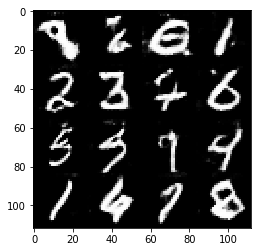

Epoch 2/2... Discriminator Loss: 0.7948... Generator Loss: 1.2559
Epoch 2/2... Discriminator Loss: 0.8631... Generator Loss: 0.9486
Epoch 2/2... Discriminator Loss: 1.1382... Generator Loss: 0.5955
Epoch 2/2... Discriminator Loss: 1.0540... Generator Loss: 1.8143
Epoch 2/2... Discriminator Loss: 1.5756... Generator Loss: 0.3031
Epoch 2/2... Discriminator Loss: 0.7937... Generator Loss: 1.9342
Epoch 2/2... Discriminator Loss: 0.6530... Generator Loss: 1.2268
Epoch 2/2... Discriminator Loss: 1.4226... Generator Loss: 0.3635
Epoch 2/2... Discriminator Loss: 0.8208... Generator Loss: 1.5930
Epoch 2/2... Discriminator Loss: 0.9151... Generator Loss: 0.7594


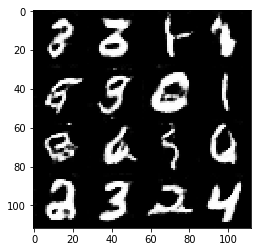

Epoch 2/2... Discriminator Loss: 0.8193... Generator Loss: 0.8912
Epoch 2/2... Discriminator Loss: 0.6566... Generator Loss: 1.1497
Epoch 2/2... Discriminator Loss: 1.2598... Generator Loss: 0.4972
Epoch 2/2... Discriminator Loss: 0.5795... Generator Loss: 1.5341
Epoch 2/2... Discriminator Loss: 1.0466... Generator Loss: 0.6152
Epoch 2/2... Discriminator Loss: 0.7153... Generator Loss: 1.2545
Epoch 2/2... Discriminator Loss: 0.7295... Generator Loss: 1.7559
Epoch 2/2... Discriminator Loss: 1.5534... Generator Loss: 0.3375
Epoch 2/2... Discriminator Loss: 0.9694... Generator Loss: 1.5140
Epoch 2/2... Discriminator Loss: 1.3760... Generator Loss: 0.3692


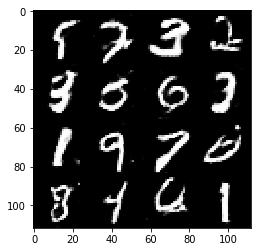

Epoch 2/2... Discriminator Loss: 0.6410... Generator Loss: 1.8402
Epoch 2/2... Discriminator Loss: 0.9332... Generator Loss: 0.7657
Epoch 2/2... Discriminator Loss: 0.7885... Generator Loss: 1.0021
Epoch 2/2... Discriminator Loss: 0.5574... Generator Loss: 1.5479
Epoch 2/2... Discriminator Loss: 0.8127... Generator Loss: 0.8479
Epoch 2/2... Discriminator Loss: 0.5924... Generator Loss: 1.2485
Epoch 2/2... Discriminator Loss: 1.1857... Generator Loss: 0.5369
Epoch 2/2... Discriminator Loss: 0.6258... Generator Loss: 1.3985
Epoch 2/2... Discriminator Loss: 0.8256... Generator Loss: 0.8322
Epoch 2/2... Discriminator Loss: 0.6361... Generator Loss: 1.2169


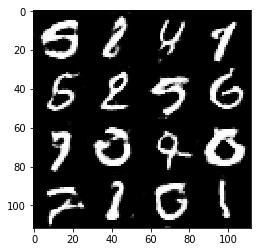

Epoch 2/2... Discriminator Loss: 1.0548... Generator Loss: 0.5970
Epoch 2/2... Discriminator Loss: 0.6652... Generator Loss: 1.7760
Epoch 2/2... Discriminator Loss: 1.1035... Generator Loss: 0.5559
Epoch 2/2... Discriminator Loss: 0.9466... Generator Loss: 1.9695
Epoch 2/2... Discriminator Loss: 1.1337... Generator Loss: 0.5434
Epoch 2/2... Discriminator Loss: 0.8364... Generator Loss: 1.1594
Epoch 2/2... Discriminator Loss: 0.6429... Generator Loss: 1.3198
Epoch 2/2... Discriminator Loss: 1.6223... Generator Loss: 0.3538
Epoch 2/2... Discriminator Loss: 0.9599... Generator Loss: 2.3228
Epoch 2/2... Discriminator Loss: 1.5311... Generator Loss: 0.3742


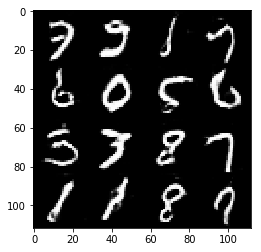

Epoch 2/2... Discriminator Loss: 1.3806... Generator Loss: 1.9257
Epoch 2/2... Discriminator Loss: 1.8038... Generator Loss: 0.2956
Epoch 2/2... Discriminator Loss: 0.8692... Generator Loss: 2.4773
Epoch 2/2... Discriminator Loss: 0.7536... Generator Loss: 1.0415
Epoch 2/2... Discriminator Loss: 0.8490... Generator Loss: 0.8962
Epoch 2/2... Discriminator Loss: 0.6897... Generator Loss: 1.3539
Epoch 2/2... Discriminator Loss: 0.8488... Generator Loss: 0.8878
Epoch 2/2... Discriminator Loss: 0.7145... Generator Loss: 1.1267
Epoch 2/2... Discriminator Loss: 0.8570... Generator Loss: 0.8908
Epoch 2/2... Discriminator Loss: 0.9002... Generator Loss: 1.0335


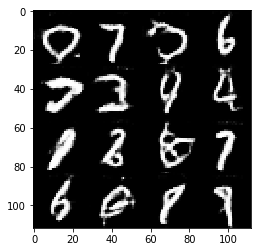

Epoch 2/2... Discriminator Loss: 1.3322... Generator Loss: 0.4974
Epoch 2/2... Discriminator Loss: 1.0814... Generator Loss: 0.8581
Epoch 2/2... Discriminator Loss: 0.7573... Generator Loss: 0.9227
Epoch 2/2... Discriminator Loss: 0.7237... Generator Loss: 1.0894
Epoch 2/2... Discriminator Loss: 1.2591... Generator Loss: 0.5084
Epoch 2/2... Discriminator Loss: 0.9239... Generator Loss: 0.7742
Epoch 2/2... Discriminator Loss: 0.6243... Generator Loss: 1.2631
Epoch 2/2... Discriminator Loss: 0.7339... Generator Loss: 1.0807
Epoch 2/2... Discriminator Loss: 0.4896... Generator Loss: 1.5425
Epoch 2/2... Discriminator Loss: 0.7264... Generator Loss: 0.9443


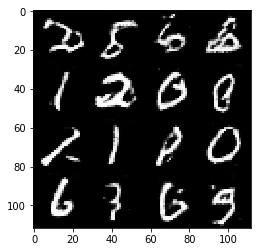

Epoch 2/2... Discriminator Loss: 0.9324... Generator Loss: 0.7325
Epoch 2/2... Discriminator Loss: 0.8205... Generator Loss: 1.7668
Epoch 2/2... Discriminator Loss: 0.8029... Generator Loss: 0.8305
Epoch 2/2... Discriminator Loss: 0.5667... Generator Loss: 1.7481
Epoch 2/2... Discriminator Loss: 1.0059... Generator Loss: 0.6670
Epoch 2/2... Discriminator Loss: 0.5549... Generator Loss: 1.8877
Epoch 2/2... Discriminator Loss: 0.7376... Generator Loss: 0.8722
Epoch 2/2... Discriminator Loss: 0.6071... Generator Loss: 2.0449
Epoch 2/2... Discriminator Loss: 1.0499... Generator Loss: 0.5714
Epoch 2/2... Discriminator Loss: 0.4781... Generator Loss: 1.9548


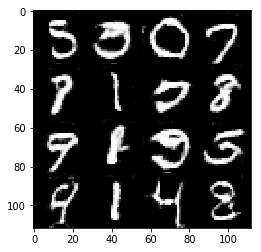

Epoch 2/2... Discriminator Loss: 0.6888... Generator Loss: 1.1836
Epoch 2/2... Discriminator Loss: 1.3709... Generator Loss: 0.3853
Epoch 2/2... Discriminator Loss: 0.6671... Generator Loss: 2.1158
Epoch 2/2... Discriminator Loss: 0.8042... Generator Loss: 0.8598
Epoch 2/2... Discriminator Loss: 0.5605... Generator Loss: 1.4137
Epoch 2/2... Discriminator Loss: 0.8132... Generator Loss: 0.8760
Epoch 2/2... Discriminator Loss: 0.8009... Generator Loss: 1.1081
Epoch 2/2... Discriminator Loss: 1.3834... Generator Loss: 0.4306
Epoch 2/2... Discriminator Loss: 0.8610... Generator Loss: 1.8162
Epoch 2/2... Discriminator Loss: 1.6293... Generator Loss: 0.3306


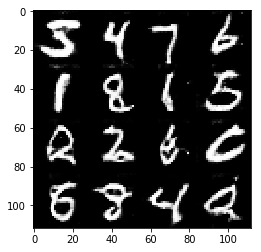

Epoch 2/2... Discriminator Loss: 0.8037... Generator Loss: 2.1413
Epoch 2/2... Discriminator Loss: 0.9253... Generator Loss: 0.7320
Epoch 2/2... Discriminator Loss: 0.7166... Generator Loss: 1.0926
Epoch 2/2... Discriminator Loss: 1.0867... Generator Loss: 0.6481
Epoch 2/2... Discriminator Loss: 0.5941... Generator Loss: 1.7323
Epoch 2/2... Discriminator Loss: 0.7076... Generator Loss: 1.0918
Epoch 2/2... Discriminator Loss: 0.8293... Generator Loss: 0.8048
Epoch 2/2... Discriminator Loss: 0.8502... Generator Loss: 0.8562
Epoch 2/2... Discriminator Loss: 0.6328... Generator Loss: 1.1916
Epoch 2/2... Discriminator Loss: 0.6810... Generator Loss: 1.0874


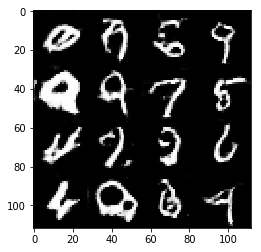

Epoch 2/2... Discriminator Loss: 0.4899... Generator Loss: 1.6568
Epoch 2/2... Discriminator Loss: 0.8521... Generator Loss: 0.7440
Epoch 2/2... Discriminator Loss: 0.8670... Generator Loss: 0.7661
Epoch 2/2... Discriminator Loss: 0.6245... Generator Loss: 1.5837
Epoch 2/2... Discriminator Loss: 1.0191... Generator Loss: 0.6108
Epoch 2/2... Discriminator Loss: 0.6804... Generator Loss: 1.3014
Epoch 2/2... Discriminator Loss: 0.5047... Generator Loss: 1.3013
Epoch 2/2... Discriminator Loss: 0.9898... Generator Loss: 0.7177
Epoch 2/2... Discriminator Loss: 0.6399... Generator Loss: 1.0313
Epoch 2/2... Discriminator Loss: 0.5379... Generator Loss: 1.6523


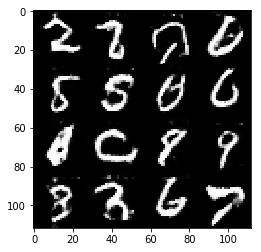

Epoch 2/2... Discriminator Loss: 1.6020... Generator Loss: 0.3214
Epoch 2/2... Discriminator Loss: 0.4852... Generator Loss: 2.5709
Epoch 2/2... Discriminator Loss: 1.0472... Generator Loss: 0.6546
Epoch 2/2... Discriminator Loss: 1.3390... Generator Loss: 0.4442
Epoch 2/2... Discriminator Loss: 1.3348... Generator Loss: 3.6211
Epoch 2/2... Discriminator Loss: 2.3531... Generator Loss: 0.1784
Epoch 2/2... Discriminator Loss: 3.6311... Generator Loss: 4.7600
Epoch 2/2... Discriminator Loss: 4.6003... Generator Loss: 0.0237
Epoch 2/2... Discriminator Loss: 0.6303... Generator Loss: 2.1365
Epoch 2/2... Discriminator Loss: 0.9869... Generator Loss: 2.4086


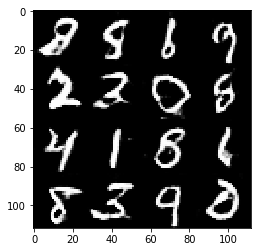

Epoch 2/2... Discriminator Loss: 1.1401... Generator Loss: 0.5810
Epoch 2/2... Discriminator Loss: 0.8463... Generator Loss: 2.2049
Epoch 2/2... Discriminator Loss: 0.8043... Generator Loss: 1.0736
Epoch 2/2... Discriminator Loss: 1.0312... Generator Loss: 0.7348
Epoch 2/2... Discriminator Loss: 0.9003... Generator Loss: 1.4176
Epoch 2/2... Discriminator Loss: 0.8359... Generator Loss: 0.9253
Epoch 2/2... Discriminator Loss: 0.9553... Generator Loss: 0.9815
Epoch 2/2... Discriminator Loss: 0.8714... Generator Loss: 0.8617
Epoch 2/2... Discriminator Loss: 0.8244... Generator Loss: 1.1018
Epoch 2/2... Discriminator Loss: 0.9424... Generator Loss: 0.7941


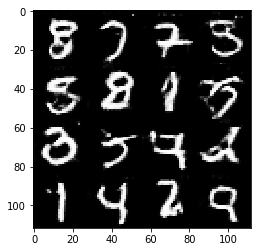

Epoch 2/2... Discriminator Loss: 0.8271... Generator Loss: 1.0471
Epoch 2/2... Discriminator Loss: 1.1460... Generator Loss: 0.5654
Epoch 2/2... Discriminator Loss: 0.8589... Generator Loss: 0.9959
Epoch 2/2... Discriminator Loss: 0.9972... Generator Loss: 0.7081
Epoch 2/2... Discriminator Loss: 0.9945... Generator Loss: 0.7124
Epoch 2/2... Discriminator Loss: 0.7550... Generator Loss: 1.1461
Epoch 2/2... Discriminator Loss: 1.0042... Generator Loss: 0.6019
Epoch 2/2... Discriminator Loss: 0.7921... Generator Loss: 0.9074
Epoch 2/2... Discriminator Loss: 0.5676... Generator Loss: 1.3841
Epoch 2/2... Discriminator Loss: 0.6480... Generator Loss: 1.0190


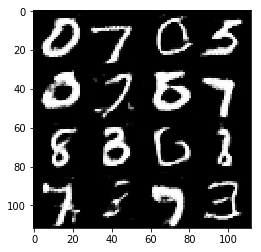

Epoch 2/2... Discriminator Loss: 1.0363... Generator Loss: 0.6253
Epoch 2/2... Discriminator Loss: 0.6876... Generator Loss: 1.4184
Epoch 2/2... Discriminator Loss: 0.7667... Generator Loss: 0.9037
Epoch 2/2... Discriminator Loss: 0.9200... Generator Loss: 0.8574
Epoch 2/2... Discriminator Loss: 0.5606... Generator Loss: 1.3016
Epoch 2/2... Discriminator Loss: 1.1754... Generator Loss: 0.5825
Epoch 2/2... Discriminator Loss: 0.6169... Generator Loss: 1.3758
Epoch 2/2... Discriminator Loss: 0.9926... Generator Loss: 0.6657
Epoch 2/2... Discriminator Loss: 0.5642... Generator Loss: 1.4101
Epoch 2/2... Discriminator Loss: 0.8131... Generator Loss: 0.9161


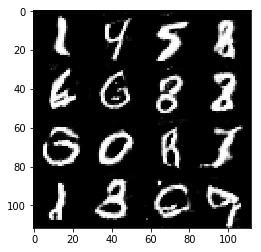

Epoch 2/2... Discriminator Loss: 1.0358... Generator Loss: 0.6455
Epoch 2/2... Discriminator Loss: 0.9774... Generator Loss: 0.6928
Epoch 2/2... Discriminator Loss: 0.5201... Generator Loss: 1.7207
Epoch 2/2... Discriminator Loss: 0.6734... Generator Loss: 0.9956
Epoch 2/2... Discriminator Loss: 0.9517... Generator Loss: 0.6900
Epoch 2/2... Discriminator Loss: 0.6240... Generator Loss: 1.4506
Epoch 2/2... Discriminator Loss: 0.7209... Generator Loss: 0.9493
Epoch 2/2... Discriminator Loss: 1.5310... Generator Loss: 0.3522
Epoch 2/2... Discriminator Loss: 1.0557... Generator Loss: 2.8184
Epoch 2/2... Discriminator Loss: 1.5511... Generator Loss: 0.3278


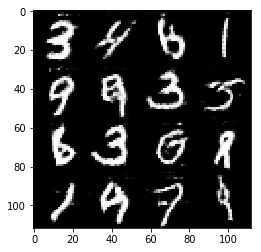

Epoch 2/2... Discriminator Loss: 0.7392... Generator Loss: 1.6835
Epoch 2/2... Discriminator Loss: 0.6664... Generator Loss: 1.0472
Epoch 2/2... Discriminator Loss: 1.0599... Generator Loss: 0.6202
Epoch 2/2... Discriminator Loss: 0.6038... Generator Loss: 1.4073
Epoch 2/2... Discriminator Loss: 1.0026... Generator Loss: 0.6967
Epoch 2/2... Discriminator Loss: 0.8004... Generator Loss: 0.8884
Epoch 2/2... Discriminator Loss: 0.7257... Generator Loss: 1.8896
Epoch 2/2... Discriminator Loss: 1.5543... Generator Loss: 0.3441
Epoch 2/2... Discriminator Loss: 0.6195... Generator Loss: 1.3187
Epoch 2/2... Discriminator Loss: 0.8314... Generator Loss: 0.8705


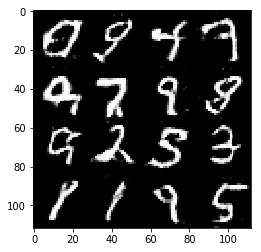

Epoch 2/2... Discriminator Loss: 0.8300... Generator Loss: 0.7722
Epoch 2/2... Discriminator Loss: 0.6640... Generator Loss: 1.7987
Epoch 2/2... Discriminator Loss: 1.0063... Generator Loss: 0.6344
Epoch 2/2... Discriminator Loss: 0.8241... Generator Loss: 0.8735


In [12]:
batch_size = 64
z_dim = 100
learning_rate = 0.0004
beta1 = 0.5

"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
epochs = 2

mnist_dataset = helper.Dataset('mnist', glob(os.path.join(data_dir, 'mnist/*.jpg')))
with tf.Graph().as_default():
    train(epochs, batch_size, z_dim, 
          learning_rate, beta1, mnist_dataset.get_batches, 
          mnist_dataset.shape, mnist_dataset.image_mode)
    
    

### CelebA
Run your GANs on CelebA.  It will take around 20 minutes on the average GPU to run one epoch.  You can run the whole epoch or stop when it starts to generate realistic faces.

Epoch 1/1... Discriminator Loss: 8.3864... Generator Loss: 0.0004
Epoch 1/1... Discriminator Loss: 1.1948... Generator Loss: 0.6121
Epoch 1/1... Discriminator Loss: 0.6675... Generator Loss: 4.0216
Epoch 1/1... Discriminator Loss: 0.9010... Generator Loss: 1.0718
Epoch 1/1... Discriminator Loss: 0.4981... Generator Loss: 1.7252
Epoch 1/1... Discriminator Loss: 0.3604... Generator Loss: 2.5566
Epoch 1/1... Discriminator Loss: 0.2319... Generator Loss: 2.2490
Epoch 1/1... Discriminator Loss: 0.0745... Generator Loss: 4.7460
Epoch 1/1... Discriminator Loss: 0.0887... Generator Loss: 3.1831
Epoch 1/1... Discriminator Loss: 0.1965... Generator Loss: 2.3560


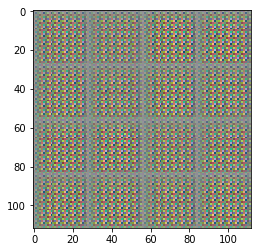

Epoch 1/1... Discriminator Loss: 0.1171... Generator Loss: 2.8187
Epoch 1/1... Discriminator Loss: 0.0565... Generator Loss: 5.5088
Epoch 1/1... Discriminator Loss: 0.0422... Generator Loss: 4.3627
Epoch 1/1... Discriminator Loss: 0.0364... Generator Loss: 3.9014
Epoch 1/1... Discriminator Loss: 0.0276... Generator Loss: 4.5667
Epoch 1/1... Discriminator Loss: 0.4263... Generator Loss: 1.3619
Epoch 1/1... Discriminator Loss: 0.0333... Generator Loss: 16.0758
Epoch 1/1... Discriminator Loss: 0.0783... Generator Loss: 16.1689
Epoch 1/1... Discriminator Loss: 0.0204... Generator Loss: 11.5002
Epoch 1/1... Discriminator Loss: 0.0076... Generator Loss: 8.2272


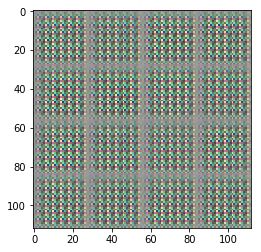

Epoch 1/1... Discriminator Loss: 0.0058... Generator Loss: 6.1308
Epoch 1/1... Discriminator Loss: 0.0204... Generator Loss: 4.3159
Epoch 1/1... Discriminator Loss: 0.0066... Generator Loss: 6.7407
Epoch 1/1... Discriminator Loss: 0.0081... Generator Loss: 5.5652
Epoch 1/1... Discriminator Loss: 0.1296... Generator Loss: 2.7608
Epoch 1/1... Discriminator Loss: 0.0222... Generator Loss: 15.2337
Epoch 1/1... Discriminator Loss: 0.0088... Generator Loss: 17.8468
Epoch 1/1... Discriminator Loss: 0.0090... Generator Loss: 16.0259
Epoch 1/1... Discriminator Loss: 0.0033... Generator Loss: 13.2216
Epoch 1/1... Discriminator Loss: 0.0025... Generator Loss: 8.3292


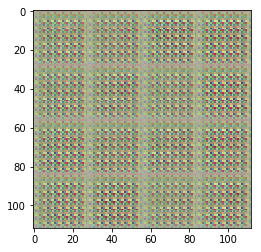

Epoch 1/1... Discriminator Loss: 0.0111... Generator Loss: 5.0896
Epoch 1/1... Discriminator Loss: 0.0139... Generator Loss: 4.8616
Epoch 1/1... Discriminator Loss: 0.0178... Generator Loss: 4.9546
Epoch 1/1... Discriminator Loss: 0.0345... Generator Loss: 3.9981
Epoch 1/1... Discriminator Loss: 0.0032... Generator Loss: 6.4046
Epoch 1/1... Discriminator Loss: 0.0252... Generator Loss: 4.5417
Epoch 1/1... Discriminator Loss: 0.1002... Generator Loss: 3.1962
Epoch 1/1... Discriminator Loss: 0.0123... Generator Loss: 7.0668
Epoch 1/1... Discriminator Loss: 0.0114... Generator Loss: 7.6410
Epoch 1/1... Discriminator Loss: 0.0364... Generator Loss: 4.6189


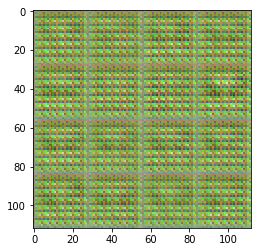

Epoch 1/1... Discriminator Loss: 0.0371... Generator Loss: 4.0623
Epoch 1/1... Discriminator Loss: 0.0226... Generator Loss: 5.0530
Epoch 1/1... Discriminator Loss: 0.2464... Generator Loss: 2.2714
Epoch 1/1... Discriminator Loss: 0.2608... Generator Loss: 17.2899
Epoch 1/1... Discriminator Loss: 0.0082... Generator Loss: 7.0111
Epoch 1/1... Discriminator Loss: 7.7125... Generator Loss: 0.0023
Epoch 1/1... Discriminator Loss: 3.5701... Generator Loss: 26.4469
Epoch 1/1... Discriminator Loss: 0.0361... Generator Loss: 20.1820
Epoch 1/1... Discriminator Loss: 1.2009... Generator Loss: 1.3634
Epoch 1/1... Discriminator Loss: 0.0916... Generator Loss: 5.3727


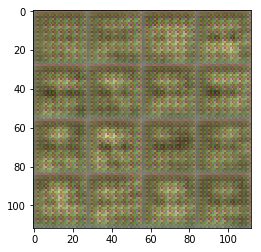

Epoch 1/1... Discriminator Loss: 1.5335... Generator Loss: 1.0253
Epoch 1/1... Discriminator Loss: 0.6681... Generator Loss: 6.5115
Epoch 1/1... Discriminator Loss: 0.3322... Generator Loss: 5.3584
Epoch 1/1... Discriminator Loss: 3.2562... Generator Loss: 0.2608
Epoch 1/1... Discriminator Loss: 0.7988... Generator Loss: 9.4702
Epoch 1/1... Discriminator Loss: 0.3173... Generator Loss: 3.6236
Epoch 1/1... Discriminator Loss: 2.8084... Generator Loss: 0.5311
Epoch 1/1... Discriminator Loss: 0.6944... Generator Loss: 5.6567
Epoch 1/1... Discriminator Loss: 0.5122... Generator Loss: 2.2624
Epoch 1/1... Discriminator Loss: 1.4044... Generator Loss: 0.6963


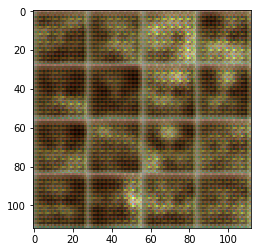

Epoch 1/1... Discriminator Loss: 0.5991... Generator Loss: 4.1124
Epoch 1/1... Discriminator Loss: 0.7573... Generator Loss: 1.4775
Epoch 1/1... Discriminator Loss: 1.1746... Generator Loss: 0.6921
Epoch 1/1... Discriminator Loss: 0.6429... Generator Loss: 3.4329
Epoch 1/1... Discriminator Loss: 0.8846... Generator Loss: 1.4050
Epoch 1/1... Discriminator Loss: 1.5487... Generator Loss: 0.6179
Epoch 1/1... Discriminator Loss: 0.8625... Generator Loss: 2.2787
Epoch 1/1... Discriminator Loss: 1.7535... Generator Loss: 0.5140
Epoch 1/1... Discriminator Loss: 0.9308... Generator Loss: 3.5095
Epoch 1/1... Discriminator Loss: 0.8831... Generator Loss: 1.2179


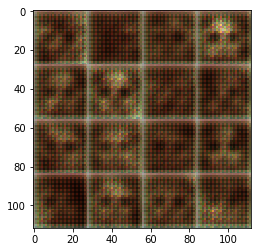

Epoch 1/1... Discriminator Loss: 1.0653... Generator Loss: 0.7432
Epoch 1/1... Discriminator Loss: 0.5595... Generator Loss: 2.6905
Epoch 1/1... Discriminator Loss: 1.7314... Generator Loss: 0.6695
Epoch 1/1... Discriminator Loss: 1.0621... Generator Loss: 3.9547
Epoch 1/1... Discriminator Loss: 1.5340... Generator Loss: 0.4369
Epoch 1/1... Discriminator Loss: 0.7767... Generator Loss: 4.1543
Epoch 1/1... Discriminator Loss: 0.5609... Generator Loss: 1.6049
Epoch 1/1... Discriminator Loss: 0.5511... Generator Loss: 1.3898
Epoch 1/1... Discriminator Loss: 0.5421... Generator Loss: 2.0875
Epoch 1/1... Discriminator Loss: 0.7740... Generator Loss: 1.1562


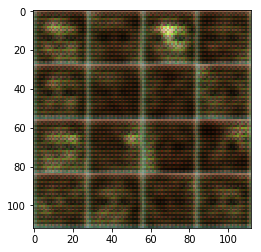

Epoch 1/1... Discriminator Loss: 0.7103... Generator Loss: 1.1005
Epoch 1/1... Discriminator Loss: 0.5624... Generator Loss: 2.9998
Epoch 1/1... Discriminator Loss: 0.9595... Generator Loss: 0.9036
Epoch 1/1... Discriminator Loss: 0.8184... Generator Loss: 6.2331
Epoch 1/1... Discriminator Loss: 0.2893... Generator Loss: 1.7756
Epoch 1/1... Discriminator Loss: 1.2053... Generator Loss: 0.5546
Epoch 1/1... Discriminator Loss: 0.5203... Generator Loss: 6.5100
Epoch 1/1... Discriminator Loss: 0.2213... Generator Loss: 4.7881
Epoch 1/1... Discriminator Loss: 1.0871... Generator Loss: 0.8974
Epoch 1/1... Discriminator Loss: 0.3248... Generator Loss: 2.7137


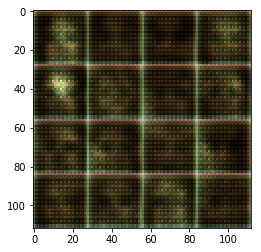

Epoch 1/1... Discriminator Loss: 0.3305... Generator Loss: 2.8473
Epoch 1/1... Discriminator Loss: 0.7025... Generator Loss: 1.0717
Epoch 1/1... Discriminator Loss: 0.5185... Generator Loss: 1.5423
Epoch 1/1... Discriminator Loss: 0.4560... Generator Loss: 2.3570
Epoch 1/1... Discriminator Loss: 2.1665... Generator Loss: 0.2081
Epoch 1/1... Discriminator Loss: 3.1028... Generator Loss: 10.1263
Epoch 1/1... Discriminator Loss: 1.4403... Generator Loss: 0.5763
Epoch 1/1... Discriminator Loss: 0.1346... Generator Loss: 3.0135
Epoch 1/1... Discriminator Loss: 0.1816... Generator Loss: 3.7544
Epoch 1/1... Discriminator Loss: 0.2449... Generator Loss: 2.4676


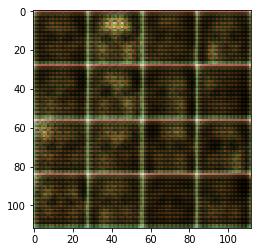

Epoch 1/1... Discriminator Loss: 0.4167... Generator Loss: 1.6724
Epoch 1/1... Discriminator Loss: 0.3335... Generator Loss: 2.1001
Epoch 1/1... Discriminator Loss: 0.4092... Generator Loss: 1.6504
Epoch 1/1... Discriminator Loss: 0.3596... Generator Loss: 2.4237
Epoch 1/1... Discriminator Loss: 0.2637... Generator Loss: 2.3077
Epoch 1/1... Discriminator Loss: 0.3125... Generator Loss: 1.9901
Epoch 1/1... Discriminator Loss: 0.2437... Generator Loss: 2.2210
Epoch 1/1... Discriminator Loss: 0.3321... Generator Loss: 2.0986
Epoch 1/1... Discriminator Loss: 0.9176... Generator Loss: 0.8266
Epoch 1/1... Discriminator Loss: 1.0872... Generator Loss: 5.8163


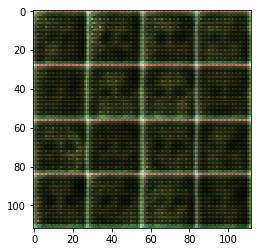

Epoch 1/1... Discriminator Loss: 3.2627... Generator Loss: 0.0645
Epoch 1/1... Discriminator Loss: 1.5253... Generator Loss: 12.9957
Epoch 1/1... Discriminator Loss: 0.3969... Generator Loss: 6.6600
Epoch 1/1... Discriminator Loss: 1.2330... Generator Loss: 0.6877
Epoch 1/1... Discriminator Loss: 0.2712... Generator Loss: 4.5865
Epoch 1/1... Discriminator Loss: 0.2307... Generator Loss: 4.9443
Epoch 1/1... Discriminator Loss: 0.1811... Generator Loss: 3.4559
Epoch 1/1... Discriminator Loss: 0.3408... Generator Loss: 2.2149
Epoch 1/1... Discriminator Loss: 0.2688... Generator Loss: 2.2718
Epoch 1/1... Discriminator Loss: 0.1908... Generator Loss: 2.6180


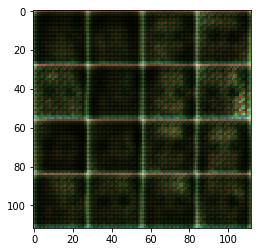

Epoch 1/1... Discriminator Loss: 0.1927... Generator Loss: 2.2886
Epoch 1/1... Discriminator Loss: 0.2729... Generator Loss: 2.2257
Epoch 1/1... Discriminator Loss: 0.6567... Generator Loss: 1.1302
Epoch 1/1... Discriminator Loss: 0.4006... Generator Loss: 5.4905
Epoch 1/1... Discriminator Loss: 0.1264... Generator Loss: 3.2205
Epoch 1/1... Discriminator Loss: 0.8997... Generator Loss: 0.7791
Epoch 1/1... Discriminator Loss: 0.4409... Generator Loss: 11.4507
Epoch 1/1... Discriminator Loss: 0.2186... Generator Loss: 8.6388
Epoch 1/1... Discriminator Loss: 0.1160... Generator Loss: 3.2847
Epoch 1/1... Discriminator Loss: 0.5809... Generator Loss: 1.3753


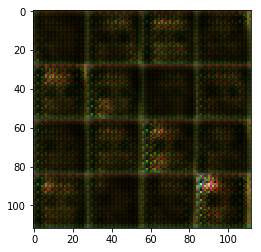

Epoch 1/1... Discriminator Loss: 0.2461... Generator Loss: 7.4786
Epoch 1/1... Discriminator Loss: 0.1216... Generator Loss: 6.7289
Epoch 1/1... Discriminator Loss: 0.2656... Generator Loss: 2.2779
Epoch 1/1... Discriminator Loss: 0.1906... Generator Loss: 2.2612
Epoch 1/1... Discriminator Loss: 0.1494... Generator Loss: 3.4218
Epoch 1/1... Discriminator Loss: 0.0913... Generator Loss: 3.4412
Epoch 1/1... Discriminator Loss: 0.2739... Generator Loss: 2.0359
Epoch 1/1... Discriminator Loss: 0.0665... Generator Loss: 7.3518
Epoch 1/1... Discriminator Loss: 0.1288... Generator Loss: 3.0360
Epoch 1/1... Discriminator Loss: 0.2310... Generator Loss: 2.1472


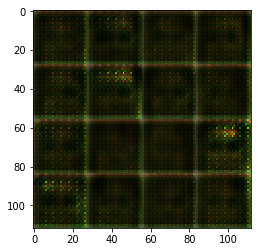

Epoch 1/1... Discriminator Loss: 0.0634... Generator Loss: 5.9082
Epoch 1/1... Discriminator Loss: 0.1035... Generator Loss: 4.0656
Epoch 1/1... Discriminator Loss: 0.5871... Generator Loss: 1.0489
Epoch 1/1... Discriminator Loss: 0.4447... Generator Loss: 5.9745
Epoch 1/1... Discriminator Loss: 0.2021... Generator Loss: 2.1020
Epoch 1/1... Discriminator Loss: 0.0869... Generator Loss: 3.0842
Epoch 1/1... Discriminator Loss: 0.0212... Generator Loss: 6.0859
Epoch 1/1... Discriminator Loss: 0.6231... Generator Loss: 0.9609
Epoch 1/1... Discriminator Loss: 0.5292... Generator Loss: 5.1272
Epoch 1/1... Discriminator Loss: 1.2651... Generator Loss: 0.5042


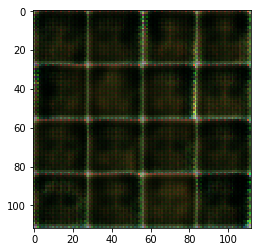

Epoch 1/1... Discriminator Loss: 1.9815... Generator Loss: 11.0795
Epoch 1/1... Discriminator Loss: 0.9459... Generator Loss: 1.4478
Epoch 1/1... Discriminator Loss: 1.2179... Generator Loss: 0.7321
Epoch 1/1... Discriminator Loss: 0.6545... Generator Loss: 3.6665
Epoch 1/1... Discriminator Loss: 0.8393... Generator Loss: 1.8095
Epoch 1/1... Discriminator Loss: 1.7461... Generator Loss: 0.4683
Epoch 1/1... Discriminator Loss: 1.6002... Generator Loss: 5.6860
Epoch 1/1... Discriminator Loss: 1.9956... Generator Loss: 0.2942
Epoch 1/1... Discriminator Loss: 0.6357... Generator Loss: 3.0942
Epoch 1/1... Discriminator Loss: 0.6901... Generator Loss: 1.5001


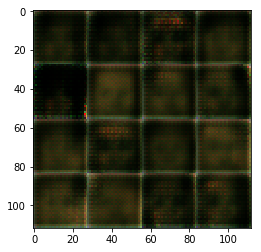

Epoch 1/1... Discriminator Loss: 1.9343... Generator Loss: 0.4811
Epoch 1/1... Discriminator Loss: 3.2292... Generator Loss: 6.5946
Epoch 1/1... Discriminator Loss: 2.2158... Generator Loss: 0.1985
Epoch 1/1... Discriminator Loss: 0.5958... Generator Loss: 2.0704
Epoch 1/1... Discriminator Loss: 0.5440... Generator Loss: 2.7254
Epoch 1/1... Discriminator Loss: 1.7761... Generator Loss: 0.3992
Epoch 1/1... Discriminator Loss: 1.5438... Generator Loss: 1.9839
Epoch 1/1... Discriminator Loss: 1.5663... Generator Loss: 0.5162
Epoch 1/1... Discriminator Loss: 1.1353... Generator Loss: 0.7605
Epoch 1/1... Discriminator Loss: 0.9744... Generator Loss: 1.7233


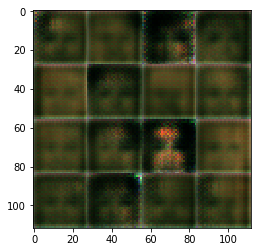

Epoch 1/1... Discriminator Loss: 0.9856... Generator Loss: 0.8785
Epoch 1/1... Discriminator Loss: 0.7198... Generator Loss: 1.9116
Epoch 1/1... Discriminator Loss: 1.2280... Generator Loss: 0.6674
Epoch 1/1... Discriminator Loss: 1.0713... Generator Loss: 1.4301
Epoch 1/1... Discriminator Loss: 0.9123... Generator Loss: 0.8950
Epoch 1/1... Discriminator Loss: 0.7829... Generator Loss: 1.1820
Epoch 1/1... Discriminator Loss: 0.4222... Generator Loss: 2.9781
Epoch 1/1... Discriminator Loss: 1.0650... Generator Loss: 0.6839
Epoch 1/1... Discriminator Loss: 1.2880... Generator Loss: 2.8802
Epoch 1/1... Discriminator Loss: 2.4971... Generator Loss: 0.1296


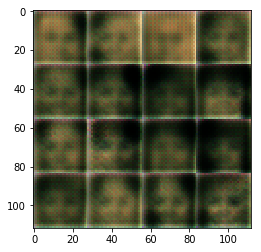

Epoch 1/1... Discriminator Loss: 1.9359... Generator Loss: 4.2268
Epoch 1/1... Discriminator Loss: 0.8170... Generator Loss: 0.9136
Epoch 1/1... Discriminator Loss: 1.1590... Generator Loss: 0.6758
Epoch 1/1... Discriminator Loss: 0.7831... Generator Loss: 2.1613
Epoch 1/1... Discriminator Loss: 1.3366... Generator Loss: 0.6202
Epoch 1/1... Discriminator Loss: 1.3862... Generator Loss: 0.4819
Epoch 1/1... Discriminator Loss: 1.3326... Generator Loss: 2.3909
Epoch 1/1... Discriminator Loss: 1.2478... Generator Loss: 0.5722
Epoch 1/1... Discriminator Loss: 0.7668... Generator Loss: 2.4727
Epoch 1/1... Discriminator Loss: 1.2538... Generator Loss: 0.5010


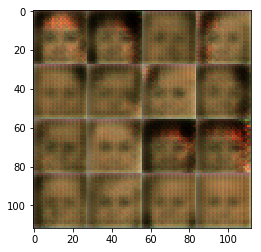

Epoch 1/1... Discriminator Loss: 1.7201... Generator Loss: 3.8954
Epoch 1/1... Discriminator Loss: 1.3798... Generator Loss: 0.5198
Epoch 1/1... Discriminator Loss: 0.9587... Generator Loss: 1.8751
Epoch 1/1... Discriminator Loss: 1.3906... Generator Loss: 0.4757
Epoch 1/1... Discriminator Loss: 1.1582... Generator Loss: 1.6620
Epoch 1/1... Discriminator Loss: 1.2969... Generator Loss: 0.5938
Epoch 1/1... Discriminator Loss: 0.8048... Generator Loss: 1.3147
Epoch 1/1... Discriminator Loss: 0.8984... Generator Loss: 1.0512
Epoch 1/1... Discriminator Loss: 0.5075... Generator Loss: 2.0482
Epoch 1/1... Discriminator Loss: 1.8725... Generator Loss: 0.2372


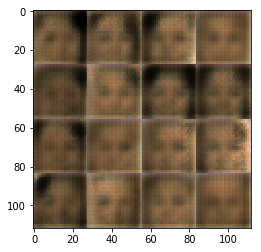

Epoch 1/1... Discriminator Loss: 2.1592... Generator Loss: 4.1065
Epoch 1/1... Discriminator Loss: 1.1503... Generator Loss: 0.7248
Epoch 1/1... Discriminator Loss: 1.4497... Generator Loss: 0.4211
Epoch 1/1... Discriminator Loss: 1.6356... Generator Loss: 2.0760
Epoch 1/1... Discriminator Loss: 1.2704... Generator Loss: 0.5079
Epoch 1/1... Discriminator Loss: 1.2237... Generator Loss: 0.7407
Epoch 1/1... Discriminator Loss: 1.1632... Generator Loss: 1.7068
Epoch 1/1... Discriminator Loss: 0.8633... Generator Loss: 0.8735
Epoch 1/1... Discriminator Loss: 0.5637... Generator Loss: 2.0488
Epoch 1/1... Discriminator Loss: 1.1206... Generator Loss: 0.6126


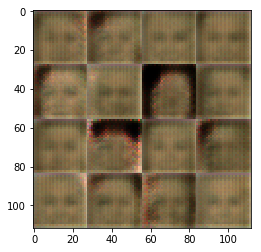

Epoch 1/1... Discriminator Loss: 1.0113... Generator Loss: 3.5116
Epoch 1/1... Discriminator Loss: 2.2831... Generator Loss: 0.1710
Epoch 1/1... Discriminator Loss: 1.6051... Generator Loss: 3.1986
Epoch 1/1... Discriminator Loss: 0.7059... Generator Loss: 1.2857
Epoch 1/1... Discriminator Loss: 1.6754... Generator Loss: 0.2651
Epoch 1/1... Discriminator Loss: 0.8611... Generator Loss: 3.7898
Epoch 1/1... Discriminator Loss: 1.1114... Generator Loss: 0.6214
Epoch 1/1... Discriminator Loss: 0.8630... Generator Loss: 1.0981
Epoch 1/1... Discriminator Loss: 1.0024... Generator Loss: 1.0226
Epoch 1/1... Discriminator Loss: 1.0685... Generator Loss: 0.7827


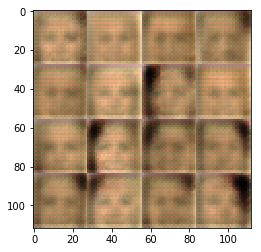

Epoch 1/1... Discriminator Loss: 1.1369... Generator Loss: 1.2207
Epoch 1/1... Discriminator Loss: 1.6160... Generator Loss: 0.3483
Epoch 1/1... Discriminator Loss: 1.3235... Generator Loss: 1.2477
Epoch 1/1... Discriminator Loss: 1.3315... Generator Loss: 0.6953
Epoch 1/1... Discriminator Loss: 0.5672... Generator Loss: 2.7382
Epoch 1/1... Discriminator Loss: 1.7202... Generator Loss: 0.2510
Epoch 1/1... Discriminator Loss: 0.9621... Generator Loss: 2.5051
Epoch 1/1... Discriminator Loss: 0.7082... Generator Loss: 1.3639
Epoch 1/1... Discriminator Loss: 0.8997... Generator Loss: 0.7911
Epoch 1/1... Discriminator Loss: 0.8835... Generator Loss: 2.4726


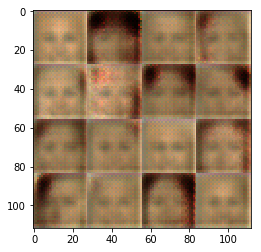

Epoch 1/1... Discriminator Loss: 1.0914... Generator Loss: 0.6212
Epoch 1/1... Discriminator Loss: 0.8601... Generator Loss: 1.5088
Epoch 1/1... Discriminator Loss: 1.5319... Generator Loss: 0.3981
Epoch 1/1... Discriminator Loss: 1.3633... Generator Loss: 2.3689
Epoch 1/1... Discriminator Loss: 0.9567... Generator Loss: 0.7247
Epoch 1/1... Discriminator Loss: 0.7907... Generator Loss: 1.0421
Epoch 1/1... Discriminator Loss: 1.0494... Generator Loss: 0.9614
Epoch 1/1... Discriminator Loss: 1.0770... Generator Loss: 0.9995
Epoch 1/1... Discriminator Loss: 0.7446... Generator Loss: 1.4284
Epoch 1/1... Discriminator Loss: 0.8417... Generator Loss: 0.9298


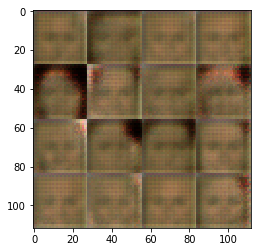

Epoch 1/1... Discriminator Loss: 0.4850... Generator Loss: 3.6088
Epoch 1/1... Discriminator Loss: 2.6649... Generator Loss: 0.1002
Epoch 1/1... Discriminator Loss: 3.1477... Generator Loss: 6.1691
Epoch 1/1... Discriminator Loss: 0.7466... Generator Loss: 1.7844
Epoch 1/1... Discriminator Loss: 1.4227... Generator Loss: 0.3431
Epoch 1/1... Discriminator Loss: 0.7525... Generator Loss: 0.9321
Epoch 1/1... Discriminator Loss: 0.9490... Generator Loss: 1.5800
Epoch 1/1... Discriminator Loss: 1.0448... Generator Loss: 0.8496
Epoch 1/1... Discriminator Loss: 1.0559... Generator Loss: 0.8277
Epoch 1/1... Discriminator Loss: 1.0040... Generator Loss: 1.0891


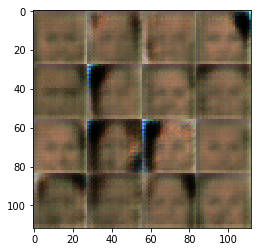

Epoch 1/1... Discriminator Loss: 0.6514... Generator Loss: 1.5512
Epoch 1/1... Discriminator Loss: 0.8398... Generator Loss: 1.0607
Epoch 1/1... Discriminator Loss: 1.1159... Generator Loss: 0.8896
Epoch 1/1... Discriminator Loss: 1.2569... Generator Loss: 0.6635
Epoch 1/1... Discriminator Loss: 1.0311... Generator Loss: 1.8351
Epoch 1/1... Discriminator Loss: 0.8447... Generator Loss: 0.9230
Epoch 1/1... Discriminator Loss: 0.8128... Generator Loss: 0.8827
Epoch 1/1... Discriminator Loss: 0.7091... Generator Loss: 1.7419
Epoch 1/1... Discriminator Loss: 0.5619... Generator Loss: 1.2626
Epoch 1/1... Discriminator Loss: 0.4412... Generator Loss: 2.0649


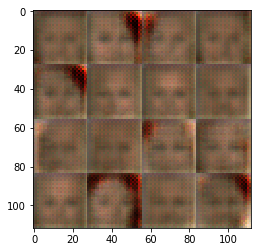

Epoch 1/1... Discriminator Loss: 2.2598... Generator Loss: 0.1759
Epoch 1/1... Discriminator Loss: 4.0162... Generator Loss: 6.0826
Epoch 1/1... Discriminator Loss: 1.0059... Generator Loss: 0.9781
Epoch 1/1... Discriminator Loss: 1.9200... Generator Loss: 0.2156
Epoch 1/1... Discriminator Loss: 1.3587... Generator Loss: 2.2146
Epoch 1/1... Discriminator Loss: 1.0507... Generator Loss: 0.6520
Epoch 1/1... Discriminator Loss: 0.8584... Generator Loss: 0.9988
Epoch 1/1... Discriminator Loss: 0.9890... Generator Loss: 1.1783
Epoch 1/1... Discriminator Loss: 1.1845... Generator Loss: 0.6437
Epoch 1/1... Discriminator Loss: 0.8456... Generator Loss: 2.0450


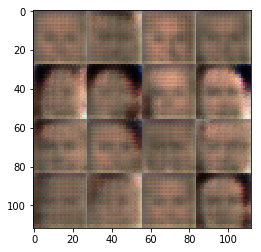

Epoch 1/1... Discriminator Loss: 0.3806... Generator Loss: 2.0371
Epoch 1/1... Discriminator Loss: 2.0689... Generator Loss: 0.2015
Epoch 1/1... Discriminator Loss: 0.8649... Generator Loss: 3.0752
Epoch 1/1... Discriminator Loss: 0.6003... Generator Loss: 1.8496
Epoch 1/1... Discriminator Loss: 1.8072... Generator Loss: 0.2508
Epoch 1/1... Discriminator Loss: 1.2744... Generator Loss: 2.5627
Epoch 1/1... Discriminator Loss: 1.1791... Generator Loss: 0.6440
Epoch 1/1... Discriminator Loss: 1.0750... Generator Loss: 0.8399
Epoch 1/1... Discriminator Loss: 0.9353... Generator Loss: 1.3178
Epoch 1/1... Discriminator Loss: 0.8989... Generator Loss: 1.0424


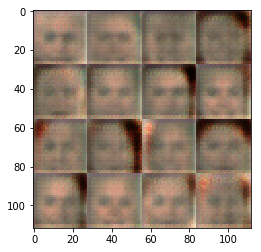

Epoch 1/1... Discriminator Loss: 0.5612... Generator Loss: 1.6705
Epoch 1/1... Discriminator Loss: 0.4351... Generator Loss: 1.9752
Epoch 1/1... Discriminator Loss: 2.0849... Generator Loss: 0.1905
Epoch 1/1... Discriminator Loss: 1.9036... Generator Loss: 3.7846
Epoch 1/1... Discriminator Loss: 0.6521... Generator Loss: 1.3049
Epoch 1/1... Discriminator Loss: 1.9153... Generator Loss: 0.2189
Epoch 1/1... Discriminator Loss: 2.0057... Generator Loss: 2.9269
Epoch 1/1... Discriminator Loss: 1.0427... Generator Loss: 1.1011
Epoch 1/1... Discriminator Loss: 1.6761... Generator Loss: 0.2760
Epoch 1/1... Discriminator Loss: 1.2743... Generator Loss: 2.4142


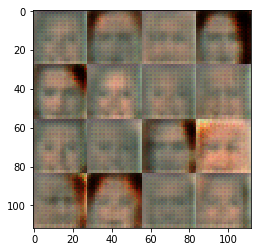

Epoch 1/1... Discriminator Loss: 0.5691... Generator Loss: 1.8293
Epoch 1/1... Discriminator Loss: 1.0128... Generator Loss: 0.6680
Epoch 1/1... Discriminator Loss: 1.3897... Generator Loss: 0.5031
Epoch 1/1... Discriminator Loss: 1.4394... Generator Loss: 1.9314
Epoch 1/1... Discriminator Loss: 1.6020... Generator Loss: 0.3562
Epoch 1/1... Discriminator Loss: 0.8753... Generator Loss: 1.1865
Epoch 1/1... Discriminator Loss: 0.6502... Generator Loss: 1.6882
Epoch 1/1... Discriminator Loss: 1.2237... Generator Loss: 0.5116
Epoch 1/1... Discriminator Loss: 1.1981... Generator Loss: 0.9392
Epoch 1/1... Discriminator Loss: 0.9152... Generator Loss: 1.8143


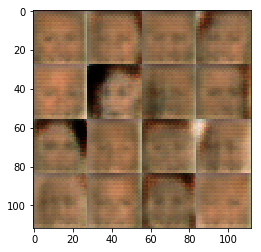

Epoch 1/1... Discriminator Loss: 0.4042... Generator Loss: 2.3472
Epoch 1/1... Discriminator Loss: 2.3844... Generator Loss: 0.1339
Epoch 1/1... Discriminator Loss: 1.4221... Generator Loss: 2.8597
Epoch 1/1... Discriminator Loss: 0.7469... Generator Loss: 2.3743
Epoch 1/1... Discriminator Loss: 1.9722... Generator Loss: 0.2684
Epoch 1/1... Discriminator Loss: 0.8447... Generator Loss: 1.5003
Epoch 1/1... Discriminator Loss: 1.0656... Generator Loss: 1.0709
Epoch 1/1... Discriminator Loss: 1.0805... Generator Loss: 0.7920
Epoch 1/1... Discriminator Loss: 0.9162... Generator Loss: 0.9123
Epoch 1/1... Discriminator Loss: 1.3717... Generator Loss: 0.8872


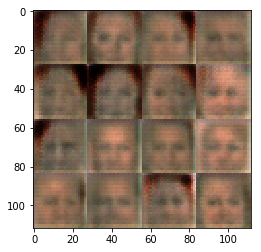

Epoch 1/1... Discriminator Loss: 1.3717... Generator Loss: 0.6039
Epoch 1/1... Discriminator Loss: 1.2636... Generator Loss: 0.9832
Epoch 1/1... Discriminator Loss: 1.1456... Generator Loss: 1.0155
Epoch 1/1... Discriminator Loss: 0.9850... Generator Loss: 1.0958
Epoch 1/1... Discriminator Loss: 0.9862... Generator Loss: 0.8491
Epoch 1/1... Discriminator Loss: 0.6187... Generator Loss: 1.6437
Epoch 1/1... Discriminator Loss: 1.7375... Generator Loss: 0.3141
Epoch 1/1... Discriminator Loss: 1.3400... Generator Loss: 1.6598
Epoch 1/1... Discriminator Loss: 0.7009... Generator Loss: 1.4212
Epoch 1/1... Discriminator Loss: 1.4255... Generator Loss: 0.4366


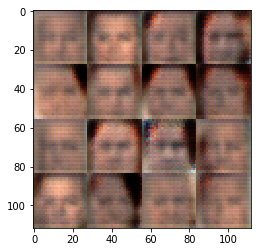

Epoch 1/1... Discriminator Loss: 1.1238... Generator Loss: 1.6023
Epoch 1/1... Discriminator Loss: 1.2963... Generator Loss: 0.6760
Epoch 1/1... Discriminator Loss: 1.1416... Generator Loss: 1.0189
Epoch 1/1... Discriminator Loss: 1.2218... Generator Loss: 0.6356
Epoch 1/1... Discriminator Loss: 1.0568... Generator Loss: 2.2839
Epoch 1/1... Discriminator Loss: 1.7059... Generator Loss: 0.3156
Epoch 1/1... Discriminator Loss: 1.3579... Generator Loss: 1.3146
Epoch 1/1... Discriminator Loss: 0.5361... Generator Loss: 2.5936
Epoch 1/1... Discriminator Loss: 0.6652... Generator Loss: 1.0107
Epoch 1/1... Discriminator Loss: 1.1637... Generator Loss: 0.4712


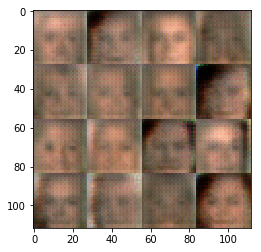

Epoch 1/1... Discriminator Loss: 1.1277... Generator Loss: 2.3483
Epoch 1/1... Discriminator Loss: 0.7471... Generator Loss: 1.1510
Epoch 1/1... Discriminator Loss: 1.6933... Generator Loss: 0.2933
Epoch 1/1... Discriminator Loss: 1.9590... Generator Loss: 3.3047
Epoch 1/1... Discriminator Loss: 1.2627... Generator Loss: 0.4463
Epoch 1/1... Discriminator Loss: 1.3054... Generator Loss: 0.9137
Epoch 1/1... Discriminator Loss: 1.3599... Generator Loss: 0.9664
Epoch 1/1... Discriminator Loss: 1.7022... Generator Loss: 0.3365
Epoch 1/1... Discriminator Loss: 1.6898... Generator Loss: 1.2749
Epoch 1/1... Discriminator Loss: 1.4223... Generator Loss: 0.6191


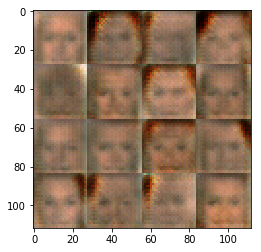

Epoch 1/1... Discriminator Loss: 1.2167... Generator Loss: 0.9658
Epoch 1/1... Discriminator Loss: 0.6350... Generator Loss: 2.7915
Epoch 1/1... Discriminator Loss: 0.6323... Generator Loss: 1.1452
Epoch 1/1... Discriminator Loss: 1.8946... Generator Loss: 0.2851
Epoch 1/1... Discriminator Loss: 1.1328... Generator Loss: 2.1634
Epoch 1/1... Discriminator Loss: 1.2110... Generator Loss: 0.5804
Epoch 1/1... Discriminator Loss: 1.1495... Generator Loss: 0.7283
Epoch 1/1... Discriminator Loss: 1.2383... Generator Loss: 1.4378
Epoch 1/1... Discriminator Loss: 1.4564... Generator Loss: 0.4556
Epoch 1/1... Discriminator Loss: 1.2150... Generator Loss: 1.6346


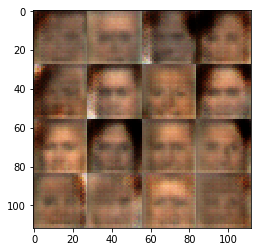

Epoch 1/1... Discriminator Loss: 1.2849... Generator Loss: 0.5061
Epoch 1/1... Discriminator Loss: 1.0246... Generator Loss: 0.9776
Epoch 1/1... Discriminator Loss: 1.0167... Generator Loss: 1.1014
Epoch 1/1... Discriminator Loss: 1.1150... Generator Loss: 0.8236
Epoch 1/1... Discriminator Loss: 1.1676... Generator Loss: 0.8477
Epoch 1/1... Discriminator Loss: 0.8036... Generator Loss: 4.0844
Epoch 1/1... Discriminator Loss: 1.3911... Generator Loss: 0.3984
Epoch 1/1... Discriminator Loss: 0.6519... Generator Loss: 1.8000
Epoch 1/1... Discriminator Loss: 1.1515... Generator Loss: 0.5949
Epoch 1/1... Discriminator Loss: 1.1778... Generator Loss: 1.3258


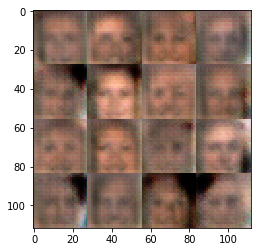

Epoch 1/1... Discriminator Loss: 0.8471... Generator Loss: 1.1769
Epoch 1/1... Discriminator Loss: 0.6069... Generator Loss: 1.8482
Epoch 1/1... Discriminator Loss: 1.5671... Generator Loss: 0.3335
Epoch 1/1... Discriminator Loss: 1.9711... Generator Loss: 4.3435
Epoch 1/1... Discriminator Loss: 1.1093... Generator Loss: 0.6782
Epoch 1/1... Discriminator Loss: 0.9135... Generator Loss: 0.9830
Epoch 1/1... Discriminator Loss: 1.0452... Generator Loss: 0.9282
Epoch 1/1... Discriminator Loss: 1.2675... Generator Loss: 0.5906
Epoch 1/1... Discriminator Loss: 1.1653... Generator Loss: 1.6024
Epoch 1/1... Discriminator Loss: 1.3235... Generator Loss: 0.4766


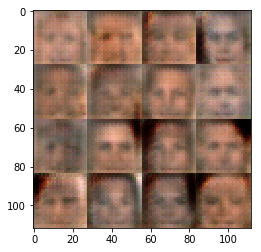

Epoch 1/1... Discriminator Loss: 1.5061... Generator Loss: 0.6014
Epoch 1/1... Discriminator Loss: 1.6095... Generator Loss: 0.9253
Epoch 1/1... Discriminator Loss: 1.8231... Generator Loss: 0.3611
Epoch 1/1... Discriminator Loss: 1.3457... Generator Loss: 2.7442
Epoch 1/1... Discriminator Loss: 0.3393... Generator Loss: 2.5030
Epoch 1/1... Discriminator Loss: 1.8939... Generator Loss: 0.2188
Epoch 1/1... Discriminator Loss: 0.6641... Generator Loss: 1.5773
Epoch 1/1... Discriminator Loss: 0.9313... Generator Loss: 1.0710
Epoch 1/1... Discriminator Loss: 0.9458... Generator Loss: 0.9987
Epoch 1/1... Discriminator Loss: 0.8949... Generator Loss: 1.2968


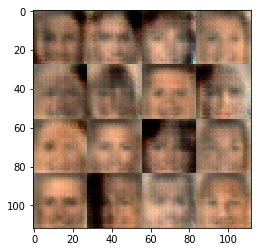

Epoch 1/1... Discriminator Loss: 1.3713... Generator Loss: 0.4734
Epoch 1/1... Discriminator Loss: 1.6368... Generator Loss: 2.0837
Epoch 1/1... Discriminator Loss: 1.5307... Generator Loss: 0.3475
Epoch 1/1... Discriminator Loss: 1.1018... Generator Loss: 1.6409
Epoch 1/1... Discriminator Loss: 1.0160... Generator Loss: 1.0349
Epoch 1/1... Discriminator Loss: 1.2669... Generator Loss: 0.4951
Epoch 1/1... Discriminator Loss: 1.3375... Generator Loss: 1.2711
Epoch 1/1... Discriminator Loss: 1.1112... Generator Loss: 1.0399
Epoch 1/1... Discriminator Loss: 1.4498... Generator Loss: 0.4965
Epoch 1/1... Discriminator Loss: 1.1278... Generator Loss: 1.6298


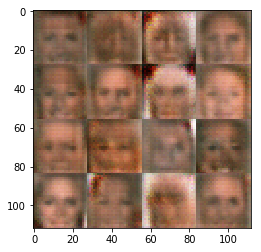

Epoch 1/1... Discriminator Loss: 0.6911... Generator Loss: 1.4200
Epoch 1/1... Discriminator Loss: 0.7891... Generator Loss: 0.8801
Epoch 1/1... Discriminator Loss: 0.7506... Generator Loss: 1.2194
Epoch 1/1... Discriminator Loss: 0.6526... Generator Loss: 2.1861
Epoch 1/1... Discriminator Loss: 1.7295... Generator Loss: 0.2953
Epoch 1/1... Discriminator Loss: 1.7623... Generator Loss: 2.5624
Epoch 1/1... Discriminator Loss: 1.1430... Generator Loss: 0.5178
Epoch 1/1... Discriminator Loss: 0.9766... Generator Loss: 1.0869
Epoch 1/1... Discriminator Loss: 1.0544... Generator Loss: 1.2290
Epoch 1/1... Discriminator Loss: 1.2550... Generator Loss: 0.6383


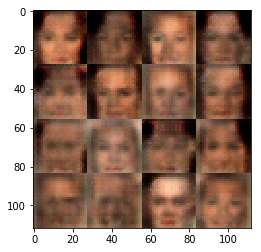

Epoch 1/1... Discriminator Loss: 1.3055... Generator Loss: 1.4214
Epoch 1/1... Discriminator Loss: 0.9458... Generator Loss: 1.0877
Epoch 1/1... Discriminator Loss: 1.0151... Generator Loss: 0.8518
Epoch 1/1... Discriminator Loss: 1.1120... Generator Loss: 1.2626
Epoch 1/1... Discriminator Loss: 0.8563... Generator Loss: 0.9678
Epoch 1/1... Discriminator Loss: 0.4642... Generator Loss: 1.6413
Epoch 1/1... Discriminator Loss: 1.6142... Generator Loss: 0.2913
Epoch 1/1... Discriminator Loss: 1.2971... Generator Loss: 3.2406
Epoch 1/1... Discriminator Loss: 1.2484... Generator Loss: 0.5902
Epoch 1/1... Discriminator Loss: 1.0851... Generator Loss: 1.1656


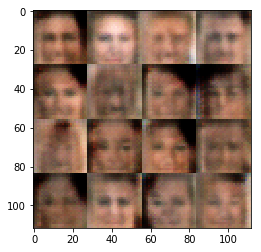

Epoch 1/1... Discriminator Loss: 1.3883... Generator Loss: 0.4313
Epoch 1/1... Discriminator Loss: 1.3048... Generator Loss: 0.9737
Epoch 1/1... Discriminator Loss: 1.0925... Generator Loss: 1.1009
Epoch 1/1... Discriminator Loss: 1.1454... Generator Loss: 0.7650
Epoch 1/1... Discriminator Loss: 1.1235... Generator Loss: 1.1718
Epoch 1/1... Discriminator Loss: 0.8630... Generator Loss: 1.2763
Epoch 1/1... Discriminator Loss: 0.4648... Generator Loss: 2.9385
Epoch 1/1... Discriminator Loss: 1.9297... Generator Loss: 0.2483
Epoch 1/1... Discriminator Loss: 1.4097... Generator Loss: 2.2306
Epoch 1/1... Discriminator Loss: 0.7430... Generator Loss: 1.0253


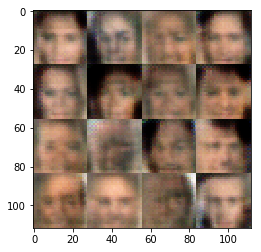

Epoch 1/1... Discriminator Loss: 1.1756... Generator Loss: 0.6206
Epoch 1/1... Discriminator Loss: 1.0262... Generator Loss: 1.4057
Epoch 1/1... Discriminator Loss: 1.0158... Generator Loss: 0.8301
Epoch 1/1... Discriminator Loss: 1.2317... Generator Loss: 0.6675
Epoch 1/1... Discriminator Loss: 1.3307... Generator Loss: 1.4229
Epoch 1/1... Discriminator Loss: 0.4755... Generator Loss: 1.8800
Epoch 1/1... Discriminator Loss: 0.4201... Generator Loss: 1.7266
Epoch 1/1... Discriminator Loss: 1.1728... Generator Loss: 0.5900
Epoch 1/1... Discriminator Loss: 1.0577... Generator Loss: 2.4622
Epoch 1/1... Discriminator Loss: 0.9594... Generator Loss: 0.7405


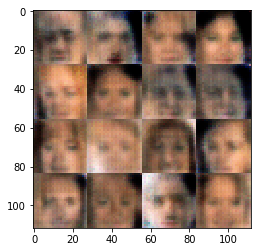

Epoch 1/1... Discriminator Loss: 0.9622... Generator Loss: 1.7898
Epoch 1/1... Discriminator Loss: 1.2321... Generator Loss: 0.4439
Epoch 1/1... Discriminator Loss: 1.2668... Generator Loss: 2.1247
Epoch 1/1... Discriminator Loss: 0.7447... Generator Loss: 1.0789
Epoch 1/1... Discriminator Loss: 1.0306... Generator Loss: 0.9228
Epoch 1/1... Discriminator Loss: 0.9319... Generator Loss: 1.0924
Epoch 1/1... Discriminator Loss: 1.0878... Generator Loss: 0.7453
Epoch 1/1... Discriminator Loss: 1.0714... Generator Loss: 1.3769
Epoch 1/1... Discriminator Loss: 1.7145... Generator Loss: 0.2819
Epoch 1/1... Discriminator Loss: 1.8240... Generator Loss: 1.6810


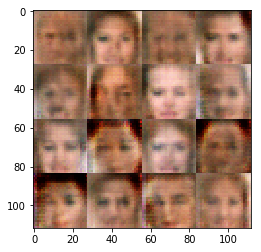

Epoch 1/1... Discriminator Loss: 1.5610... Generator Loss: 0.3927
Epoch 1/1... Discriminator Loss: 1.1349... Generator Loss: 2.2402
Epoch 1/1... Discriminator Loss: 1.3002... Generator Loss: 0.4320
Epoch 1/1... Discriminator Loss: 0.9990... Generator Loss: 0.9580
Epoch 1/1... Discriminator Loss: 1.1786... Generator Loss: 1.1967
Epoch 1/1... Discriminator Loss: 1.6341... Generator Loss: 0.2980
Epoch 1/1... Discriminator Loss: 1.7190... Generator Loss: 2.2500
Epoch 1/1... Discriminator Loss: 1.9028... Generator Loss: 0.2548
Epoch 1/1... Discriminator Loss: 1.5711... Generator Loss: 1.3218
Epoch 1/1... Discriminator Loss: 1.1918... Generator Loss: 1.2156


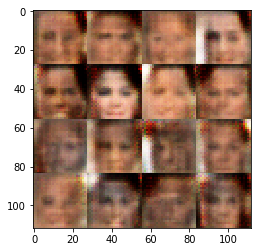

Epoch 1/1... Discriminator Loss: 0.7304... Generator Loss: 1.3070
Epoch 1/1... Discriminator Loss: 0.3091... Generator Loss: 2.7006
Epoch 1/1... Discriminator Loss: 1.2791... Generator Loss: 0.4755
Epoch 1/1... Discriminator Loss: 0.6070... Generator Loss: 2.9440
Epoch 1/1... Discriminator Loss: 1.3332... Generator Loss: 0.4789
Epoch 1/1... Discriminator Loss: 1.1454... Generator Loss: 0.9210
Epoch 1/1... Discriminator Loss: 0.9320... Generator Loss: 1.4545
Epoch 1/1... Discriminator Loss: 0.7721... Generator Loss: 1.0273
Epoch 1/1... Discriminator Loss: 1.0119... Generator Loss: 0.8962
Epoch 1/1... Discriminator Loss: 1.0293... Generator Loss: 1.2808


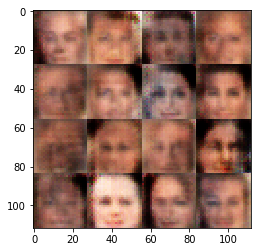

Epoch 1/1... Discriminator Loss: 1.1113... Generator Loss: 0.7560
Epoch 1/1... Discriminator Loss: 1.1081... Generator Loss: 0.8270
Epoch 1/1... Discriminator Loss: 1.0513... Generator Loss: 1.4148
Epoch 1/1... Discriminator Loss: 1.1965... Generator Loss: 0.6123
Epoch 1/1... Discriminator Loss: 0.7982... Generator Loss: 2.7846
Epoch 1/1... Discriminator Loss: 1.4066... Generator Loss: 0.3884
Epoch 1/1... Discriminator Loss: 1.5260... Generator Loss: 1.8381
Epoch 1/1... Discriminator Loss: 1.3304... Generator Loss: 0.4477
Epoch 1/1... Discriminator Loss: 1.0718... Generator Loss: 0.9586
Epoch 1/1... Discriminator Loss: 1.2346... Generator Loss: 1.1236


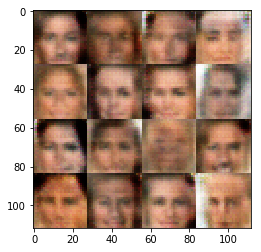

Epoch 1/1... Discriminator Loss: 0.9531... Generator Loss: 0.9133
Epoch 1/1... Discriminator Loss: 0.8765... Generator Loss: 1.2301
Epoch 1/1... Discriminator Loss: 0.3380... Generator Loss: 3.1139
Epoch 1/1... Discriminator Loss: 1.4191... Generator Loss: 0.3772
Epoch 1/1... Discriminator Loss: 1.1657... Generator Loss: 1.8952
Epoch 1/1... Discriminator Loss: 1.2429... Generator Loss: 0.7391
Epoch 1/1... Discriminator Loss: 1.2598... Generator Loss: 0.7367
Epoch 1/1... Discriminator Loss: 1.3046... Generator Loss: 0.5960
Epoch 1/1... Discriminator Loss: 1.1680... Generator Loss: 1.5106
Epoch 1/1... Discriminator Loss: 1.1555... Generator Loss: 0.6278


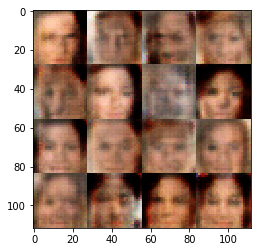

Epoch 1/1... Discriminator Loss: 0.9606... Generator Loss: 1.1723
Epoch 1/1... Discriminator Loss: 0.5462... Generator Loss: 2.4171
Epoch 1/1... Discriminator Loss: 0.9248... Generator Loss: 0.7279
Epoch 1/1... Discriminator Loss: 0.7152... Generator Loss: 1.5671
Epoch 1/1... Discriminator Loss: 1.0287... Generator Loss: 1.5354
Epoch 1/1... Discriminator Loss: 1.6606... Generator Loss: 0.2827
Epoch 1/1... Discriminator Loss: 1.6763... Generator Loss: 2.5583
Epoch 1/1... Discriminator Loss: 1.4271... Generator Loss: 0.4186
Epoch 1/1... Discriminator Loss: 1.2809... Generator Loss: 1.3777
Epoch 1/1... Discriminator Loss: 1.3148... Generator Loss: 0.4781


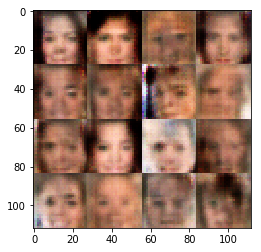

Epoch 1/1... Discriminator Loss: 1.1120... Generator Loss: 1.3340
Epoch 1/1... Discriminator Loss: 1.2489... Generator Loss: 0.8084
Epoch 1/1... Discriminator Loss: 1.0490... Generator Loss: 0.8241
Epoch 1/1... Discriminator Loss: 0.8088... Generator Loss: 1.5573
Epoch 1/1... Discriminator Loss: 1.1121... Generator Loss: 0.6450
Epoch 1/1... Discriminator Loss: 1.0132... Generator Loss: 1.4754
Epoch 1/1... Discriminator Loss: 0.7876... Generator Loss: 1.2555
Epoch 1/1... Discriminator Loss: 1.1699... Generator Loss: 0.5208
Epoch 1/1... Discriminator Loss: 1.1897... Generator Loss: 2.2959
Epoch 1/1... Discriminator Loss: 1.6504... Generator Loss: 0.3079


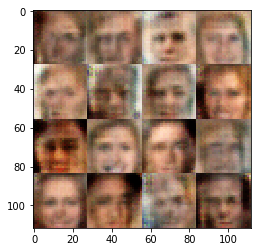

Epoch 1/1... Discriminator Loss: 1.4506... Generator Loss: 1.7146
Epoch 1/1... Discriminator Loss: 1.3311... Generator Loss: 0.4175
Epoch 1/1... Discriminator Loss: 1.8648... Generator Loss: 2.0605
Epoch 1/1... Discriminator Loss: 1.2350... Generator Loss: 0.4674
Epoch 1/1... Discriminator Loss: 1.2331... Generator Loss: 0.5703
Epoch 1/1... Discriminator Loss: 1.0097... Generator Loss: 2.6111
Epoch 1/1... Discriminator Loss: 1.0954... Generator Loss: 0.6979
Epoch 1/1... Discriminator Loss: 0.6967... Generator Loss: 1.2110
Epoch 1/1... Discriminator Loss: 1.3704... Generator Loss: 0.4261
Epoch 1/1... Discriminator Loss: 1.4486... Generator Loss: 1.9115


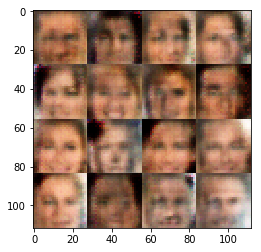

Epoch 1/1... Discriminator Loss: 1.4682... Generator Loss: 0.3757
Epoch 1/1... Discriminator Loss: 2.0019... Generator Loss: 1.6573
Epoch 1/1... Discriminator Loss: 1.3896... Generator Loss: 0.4188
Epoch 1/1... Discriminator Loss: 1.0923... Generator Loss: 1.1348
Epoch 1/1... Discriminator Loss: 1.3337... Generator Loss: 0.8168
Epoch 1/1... Discriminator Loss: 1.1709... Generator Loss: 0.8511
Epoch 1/1... Discriminator Loss: 0.6955... Generator Loss: 1.5410
Epoch 1/1... Discriminator Loss: 0.7652... Generator Loss: 1.0636
Epoch 1/1... Discriminator Loss: 0.3861... Generator Loss: 1.8828
Epoch 1/1... Discriminator Loss: 0.8895... Generator Loss: 0.7349


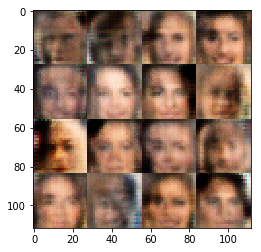

Epoch 1/1... Discriminator Loss: 1.0663... Generator Loss: 1.1927
Epoch 1/1... Discriminator Loss: 0.9058... Generator Loss: 0.9567
Epoch 1/1... Discriminator Loss: 0.9328... Generator Loss: 0.9005
Epoch 1/1... Discriminator Loss: 1.0631... Generator Loss: 1.1915
Epoch 1/1... Discriminator Loss: 1.0442... Generator Loss: 0.6488
Epoch 1/1... Discriminator Loss: 0.8462... Generator Loss: 1.8629
Epoch 1/1... Discriminator Loss: 1.2301... Generator Loss: 0.4854
Epoch 1/1... Discriminator Loss: 1.5385... Generator Loss: 1.8687
Epoch 1/1... Discriminator Loss: 1.3169... Generator Loss: 0.4625
Epoch 1/1... Discriminator Loss: 0.9412... Generator Loss: 1.5094


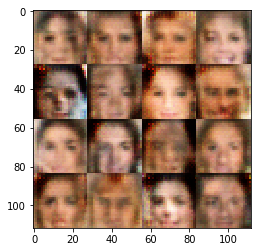

Epoch 1/1... Discriminator Loss: 0.6378... Generator Loss: 2.2969
Epoch 1/1... Discriminator Loss: 1.0555... Generator Loss: 0.5367
Epoch 1/1... Discriminator Loss: 0.9418... Generator Loss: 0.9894
Epoch 1/1... Discriminator Loss: 0.8927... Generator Loss: 1.3326
Epoch 1/1... Discriminator Loss: 1.2059... Generator Loss: 0.5349
Epoch 1/1... Discriminator Loss: 1.1290... Generator Loss: 1.5542
Epoch 1/1... Discriminator Loss: 0.7233... Generator Loss: 0.9988
Epoch 1/1... Discriminator Loss: 1.0101... Generator Loss: 0.7387
Epoch 1/1... Discriminator Loss: 0.8000... Generator Loss: 2.0955
Epoch 1/1... Discriminator Loss: 1.7274... Generator Loss: 0.2584


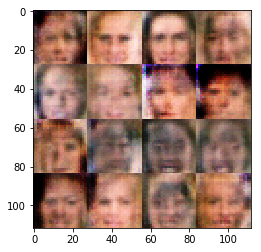

Epoch 1/1... Discriminator Loss: 2.9855... Generator Loss: 2.9671
Epoch 1/1... Discriminator Loss: 1.4241... Generator Loss: 0.4578
Epoch 1/1... Discriminator Loss: 1.3013... Generator Loss: 0.6076
Epoch 1/1... Discriminator Loss: 1.2810... Generator Loss: 1.1884
Epoch 1/1... Discriminator Loss: 0.7878... Generator Loss: 1.3376
Epoch 1/1... Discriminator Loss: 1.5529... Generator Loss: 0.3278
Epoch 1/1... Discriminator Loss: 1.0374... Generator Loss: 2.6556
Epoch 1/1... Discriminator Loss: 0.8581... Generator Loss: 0.9679
Epoch 1/1... Discriminator Loss: 1.1704... Generator Loss: 0.6586
Epoch 1/1... Discriminator Loss: 0.9615... Generator Loss: 1.3817


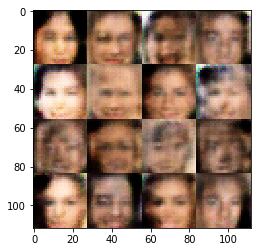

Epoch 1/1... Discriminator Loss: 0.9858... Generator Loss: 0.9533
Epoch 1/1... Discriminator Loss: 1.0621... Generator Loss: 0.7495
Epoch 1/1... Discriminator Loss: 0.9863... Generator Loss: 0.9726
Epoch 1/1... Discriminator Loss: 1.0868... Generator Loss: 0.9732
Epoch 1/1... Discriminator Loss: 0.9736... Generator Loss: 1.0087
Epoch 1/1... Discriminator Loss: 1.1304... Generator Loss: 0.6477
Epoch 1/1... Discriminator Loss: 1.6441... Generator Loss: 2.5177
Epoch 1/1... Discriminator Loss: 0.8799... Generator Loss: 0.7821
Epoch 1/1... Discriminator Loss: 0.7920... Generator Loss: 0.9062
Epoch 1/1... Discriminator Loss: 1.1178... Generator Loss: 1.6558


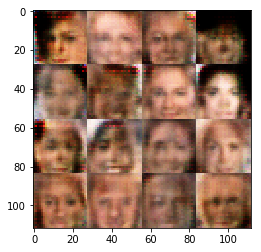

Epoch 1/1... Discriminator Loss: 1.0804... Generator Loss: 0.6080
Epoch 1/1... Discriminator Loss: 1.4577... Generator Loss: 1.2627
Epoch 1/1... Discriminator Loss: 1.3742... Generator Loss: 0.4985
Epoch 1/1... Discriminator Loss: 1.6873... Generator Loss: 1.0083
Epoch 1/1... Discriminator Loss: 1.4563... Generator Loss: 0.4208
Epoch 1/1... Discriminator Loss: 1.4251... Generator Loss: 1.4367
Epoch 1/1... Discriminator Loss: 1.2450... Generator Loss: 0.6679
Epoch 1/1... Discriminator Loss: 1.2352... Generator Loss: 0.8650
Epoch 1/1... Discriminator Loss: 0.9394... Generator Loss: 1.0894
Epoch 1/1... Discriminator Loss: 0.3721... Generator Loss: 3.0408


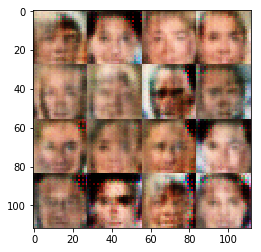

Epoch 1/1... Discriminator Loss: 1.8360... Generator Loss: 0.2435
Epoch 1/1... Discriminator Loss: 1.1881... Generator Loss: 2.4822
Epoch 1/1... Discriminator Loss: 0.8555... Generator Loss: 0.9133
Epoch 1/1... Discriminator Loss: 1.1325... Generator Loss: 0.5389
Epoch 1/1... Discriminator Loss: 0.8532... Generator Loss: 1.5694
Epoch 1/1... Discriminator Loss: 0.9214... Generator Loss: 1.0783
Epoch 1/1... Discriminator Loss: 1.0309... Generator Loss: 0.7106
Epoch 1/1... Discriminator Loss: 1.0380... Generator Loss: 1.0262
Epoch 1/1... Discriminator Loss: 0.9178... Generator Loss: 1.0688
Epoch 1/1... Discriminator Loss: 1.0960... Generator Loss: 0.6471


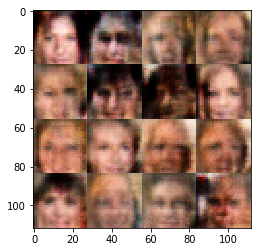

Epoch 1/1... Discriminator Loss: 0.7915... Generator Loss: 2.7210
Epoch 1/1... Discriminator Loss: 1.5203... Generator Loss: 0.3879
Epoch 1/1... Discriminator Loss: 1.2433... Generator Loss: 1.5789
Epoch 1/1... Discriminator Loss: 1.0506... Generator Loss: 0.8223
Epoch 1/1... Discriminator Loss: 0.6767... Generator Loss: 1.9160
Epoch 1/1... Discriminator Loss: 1.1655... Generator Loss: 0.5197
Epoch 1/1... Discriminator Loss: 1.3832... Generator Loss: 1.5111
Epoch 1/1... Discriminator Loss: 1.5806... Generator Loss: 0.3315
Epoch 1/1... Discriminator Loss: 1.0787... Generator Loss: 1.8168
Epoch 1/1... Discriminator Loss: 0.8113... Generator Loss: 0.9536


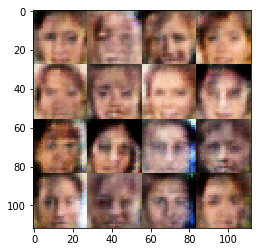

Epoch 1/1... Discriminator Loss: 0.8088... Generator Loss: 1.3450
Epoch 1/1... Discriminator Loss: 1.4087... Generator Loss: 0.3809
Epoch 1/1... Discriminator Loss: 1.6892... Generator Loss: 1.8074
Epoch 1/1... Discriminator Loss: 1.4653... Generator Loss: 0.4384
Epoch 1/1... Discriminator Loss: 1.0536... Generator Loss: 0.8272
Epoch 1/1... Discriminator Loss: 0.7584... Generator Loss: 4.5404
Epoch 1/1... Discriminator Loss: 1.1622... Generator Loss: 0.5342
Epoch 1/1... Discriminator Loss: 0.7477... Generator Loss: 1.4368
Epoch 1/1... Discriminator Loss: 1.2200... Generator Loss: 0.5493
Epoch 1/1... Discriminator Loss: 1.2141... Generator Loss: 1.2875


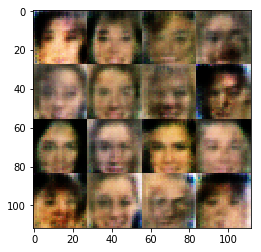

Epoch 1/1... Discriminator Loss: 1.2222... Generator Loss: 0.5779
Epoch 1/1... Discriminator Loss: 1.0756... Generator Loss: 1.2989
Epoch 1/1... Discriminator Loss: 1.4415... Generator Loss: 0.3554
Epoch 1/1... Discriminator Loss: 1.1996... Generator Loss: 1.6063
Epoch 1/1... Discriminator Loss: 1.0170... Generator Loss: 0.9662
Epoch 1/1... Discriminator Loss: 1.4362... Generator Loss: 0.4456
Epoch 1/1... Discriminator Loss: 1.3166... Generator Loss: 0.9600
Epoch 1/1... Discriminator Loss: 0.9123... Generator Loss: 0.9528
Epoch 1/1... Discriminator Loss: 0.4140... Generator Loss: 2.6953
Epoch 1/1... Discriminator Loss: 1.3963... Generator Loss: 0.4119


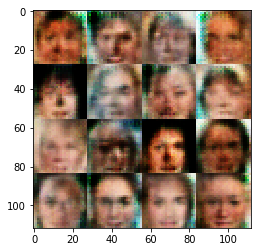

Epoch 1/1... Discriminator Loss: 1.1798... Generator Loss: 1.4775
Epoch 1/1... Discriminator Loss: 1.0023... Generator Loss: 0.8130
Epoch 1/1... Discriminator Loss: 1.1474... Generator Loss: 0.7675
Epoch 1/1... Discriminator Loss: 0.8632... Generator Loss: 1.4789
Epoch 1/1... Discriminator Loss: 1.0758... Generator Loss: 0.5688
Epoch 1/1... Discriminator Loss: 1.0607... Generator Loss: 2.3445
Epoch 1/1... Discriminator Loss: 0.9360... Generator Loss: 0.8798
Epoch 1/1... Discriminator Loss: 1.3082... Generator Loss: 0.7449
Epoch 1/1... Discriminator Loss: 1.3439... Generator Loss: 0.7984
Epoch 1/1... Discriminator Loss: 1.6168... Generator Loss: 0.4563


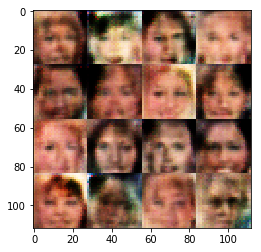

Epoch 1/1... Discriminator Loss: 1.3104... Generator Loss: 0.9561
Epoch 1/1... Discriminator Loss: 1.5214... Generator Loss: 0.4532
Epoch 1/1... Discriminator Loss: 1.3063... Generator Loss: 1.0375
Epoch 1/1... Discriminator Loss: 1.4983... Generator Loss: 0.7366
Epoch 1/1... Discriminator Loss: 1.4703... Generator Loss: 0.4992
Epoch 1/1... Discriminator Loss: 1.1995... Generator Loss: 1.3919
Epoch 1/1... Discriminator Loss: 0.8380... Generator Loss: 0.9717
Epoch 1/1... Discriminator Loss: 1.7085... Generator Loss: 0.3043
Epoch 1/1... Discriminator Loss: 1.7920... Generator Loss: 1.8990
Epoch 1/1... Discriminator Loss: 1.1477... Generator Loss: 0.5297


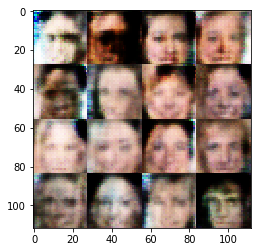

Epoch 1/1... Discriminator Loss: 0.8324... Generator Loss: 1.0088
Epoch 1/1... Discriminator Loss: 0.9824... Generator Loss: 1.1645
Epoch 1/1... Discriminator Loss: 0.8822... Generator Loss: 0.8874
Epoch 1/1... Discriminator Loss: 0.9469... Generator Loss: 1.1642
Epoch 1/1... Discriminator Loss: 0.5135... Generator Loss: 1.8483
Epoch 1/1... Discriminator Loss: 0.3758... Generator Loss: 1.8712
Epoch 1/1... Discriminator Loss: 1.9721... Generator Loss: 0.2108
Epoch 1/1... Discriminator Loss: 2.6659... Generator Loss: 3.7564
Epoch 1/1... Discriminator Loss: 0.6914... Generator Loss: 1.4233
Epoch 1/1... Discriminator Loss: 2.1303... Generator Loss: 0.1685


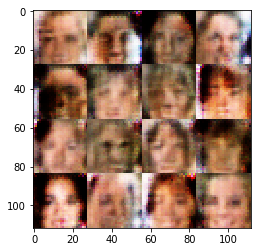

Epoch 1/1... Discriminator Loss: 0.9676... Generator Loss: 1.7220
Epoch 1/1... Discriminator Loss: 0.7831... Generator Loss: 1.8344
Epoch 1/1... Discriminator Loss: 1.2085... Generator Loss: 0.5677
Epoch 1/1... Discriminator Loss: 1.0435... Generator Loss: 0.8402
Epoch 1/1... Discriminator Loss: 1.2761... Generator Loss: 0.9323
Epoch 1/1... Discriminator Loss: 1.0209... Generator Loss: 0.7764
Epoch 1/1... Discriminator Loss: 0.8516... Generator Loss: 1.0540
Epoch 1/1... Discriminator Loss: 1.0152... Generator Loss: 0.8054
Epoch 1/1... Discriminator Loss: 0.8912... Generator Loss: 1.5606
Epoch 1/1... Discriminator Loss: 1.2341... Generator Loss: 0.4943


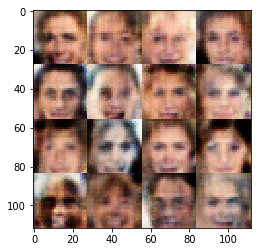

Epoch 1/1... Discriminator Loss: 1.3042... Generator Loss: 1.4057
Epoch 1/1... Discriminator Loss: 0.8320... Generator Loss: 1.3030
Epoch 1/1... Discriminator Loss: 1.6329... Generator Loss: 0.3205
Epoch 1/1... Discriminator Loss: 2.8965... Generator Loss: 2.3562
Epoch 1/1... Discriminator Loss: 2.0014... Generator Loss: 0.1882
Epoch 1/1... Discriminator Loss: 1.2439... Generator Loss: 1.2396
Epoch 1/1... Discriminator Loss: 0.9664... Generator Loss: 1.3943
Epoch 1/1... Discriminator Loss: 1.2577... Generator Loss: 0.5027
Epoch 1/1... Discriminator Loss: 1.0774... Generator Loss: 0.8708
Epoch 1/1... Discriminator Loss: 0.9493... Generator Loss: 1.4764


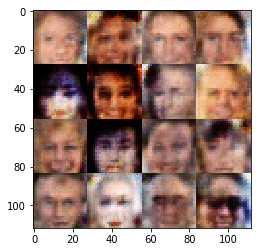

Epoch 1/1... Discriminator Loss: 2.2769... Generator Loss: 0.1534
Epoch 1/1... Discriminator Loss: 1.5745... Generator Loss: 1.5832
Epoch 1/1... Discriminator Loss: 1.4099... Generator Loss: 0.7083
Epoch 1/1... Discriminator Loss: 0.6374... Generator Loss: 1.6105
Epoch 1/1... Discriminator Loss: 1.1827... Generator Loss: 0.5942
Epoch 1/1... Discriminator Loss: 1.2228... Generator Loss: 0.8739
Epoch 1/1... Discriminator Loss: 1.1408... Generator Loss: 0.9721
Epoch 1/1... Discriminator Loss: 0.7117... Generator Loss: 1.4434
Epoch 1/1... Discriminator Loss: 0.6787... Generator Loss: 1.3335
Epoch 1/1... Discriminator Loss: 1.1106... Generator Loss: 0.5354


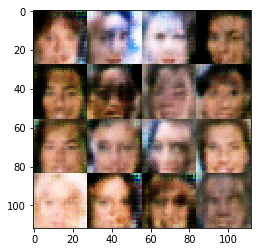

Epoch 1/1... Discriminator Loss: 0.9901... Generator Loss: 1.5632
Epoch 1/1... Discriminator Loss: 0.8512... Generator Loss: 1.0760
Epoch 1/1... Discriminator Loss: 0.7294... Generator Loss: 1.0249
Epoch 1/1... Discriminator Loss: 0.8344... Generator Loss: 1.1394
Epoch 1/1... Discriminator Loss: 0.9471... Generator Loss: 0.8246
Epoch 1/1... Discriminator Loss: 0.9186... Generator Loss: 2.2772
Epoch 1/1... Discriminator Loss: 1.1819... Generator Loss: 0.5708
Epoch 1/1... Discriminator Loss: 1.4162... Generator Loss: 1.3715
Epoch 1/1... Discriminator Loss: 1.8441... Generator Loss: 0.2494
Epoch 1/1... Discriminator Loss: 1.5926... Generator Loss: 1.9666


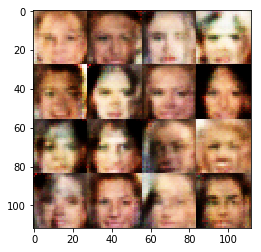

Epoch 1/1... Discriminator Loss: 0.7031... Generator Loss: 1.7259
Epoch 1/1... Discriminator Loss: 1.3482... Generator Loss: 0.4013
Epoch 1/1... Discriminator Loss: 0.9526... Generator Loss: 1.3910
Epoch 1/1... Discriminator Loss: 0.6291... Generator Loss: 2.3004
Epoch 1/1... Discriminator Loss: 1.3308... Generator Loss: 0.4294
Epoch 1/1... Discriminator Loss: 1.3806... Generator Loss: 0.8844
Epoch 1/1... Discriminator Loss: 0.9288... Generator Loss: 1.2599
Epoch 1/1... Discriminator Loss: 1.2092... Generator Loss: 0.5586
Epoch 1/1... Discriminator Loss: 1.4920... Generator Loss: 1.2520
Epoch 1/1... Discriminator Loss: 1.6155... Generator Loss: 0.3255


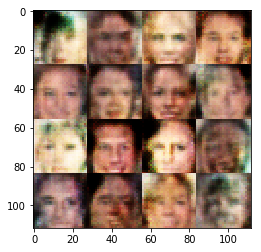

Epoch 1/1... Discriminator Loss: 1.2536... Generator Loss: 1.5860
Epoch 1/1... Discriminator Loss: 1.6399... Generator Loss: 0.3469
Epoch 1/1... Discriminator Loss: 0.7709... Generator Loss: 2.1557
Epoch 1/1... Discriminator Loss: 0.8532... Generator Loss: 1.0256
Epoch 1/1... Discriminator Loss: 0.5905... Generator Loss: 1.5242
Epoch 1/1... Discriminator Loss: 0.4156... Generator Loss: 1.9546
Epoch 1/1... Discriminator Loss: 1.6553... Generator Loss: 0.2715
Epoch 1/1... Discriminator Loss: 1.5793... Generator Loss: 2.6020
Epoch 1/1... Discriminator Loss: 0.9319... Generator Loss: 0.9726
Epoch 1/1... Discriminator Loss: 1.3185... Generator Loss: 0.4090


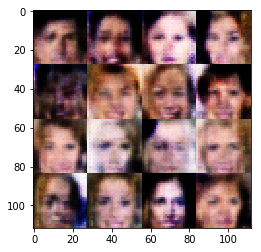

Epoch 1/1... Discriminator Loss: 1.1788... Generator Loss: 1.1599
Epoch 1/1... Discriminator Loss: 1.0492... Generator Loss: 0.8959
Epoch 1/1... Discriminator Loss: 0.9534... Generator Loss: 0.8434
Epoch 1/1... Discriminator Loss: 1.0115... Generator Loss: 0.9215
Epoch 1/1... Discriminator Loss: 0.9965... Generator Loss: 1.0582
Epoch 1/1... Discriminator Loss: 1.2716... Generator Loss: 0.6390
Epoch 1/1... Discriminator Loss: 1.2602... Generator Loss: 0.7239
Epoch 1/1... Discriminator Loss: 1.0017... Generator Loss: 1.0990
Epoch 1/1... Discriminator Loss: 0.6319... Generator Loss: 1.3589
Epoch 1/1... Discriminator Loss: 1.0718... Generator Loss: 0.5893


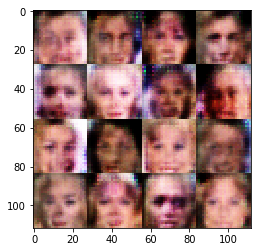

Epoch 1/1... Discriminator Loss: 1.3106... Generator Loss: 2.8788
Epoch 1/1... Discriminator Loss: 1.0994... Generator Loss: 0.7875
Epoch 1/1... Discriminator Loss: 1.7925... Generator Loss: 1.1847
Epoch 1/1... Discriminator Loss: 2.7289... Generator Loss: 0.0887
Epoch 1/1... Discriminator Loss: 1.9455... Generator Loss: 1.5837
Epoch 1/1... Discriminator Loss: 1.3336... Generator Loss: 0.7337
Epoch 1/1... Discriminator Loss: 1.3569... Generator Loss: 0.5572
Epoch 1/1... Discriminator Loss: 1.3493... Generator Loss: 0.7904
Epoch 1/1... Discriminator Loss: 1.3770... Generator Loss: 0.7115
Epoch 1/1... Discriminator Loss: 1.6214... Generator Loss: 0.5950


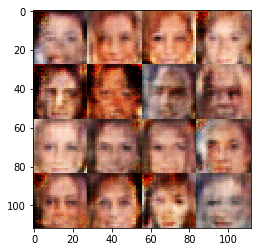

Epoch 1/1... Discriminator Loss: 1.5891... Generator Loss: 0.5897
Epoch 1/1... Discriminator Loss: 1.1886... Generator Loss: 0.8142
Epoch 1/1... Discriminator Loss: 1.2709... Generator Loss: 0.6758
Epoch 1/1... Discriminator Loss: 1.4441... Generator Loss: 0.6367
Epoch 1/1... Discriminator Loss: 1.5163... Generator Loss: 0.7157
Epoch 1/1... Discriminator Loss: 1.5150... Generator Loss: 0.6282
Epoch 1/1... Discriminator Loss: 1.4874... Generator Loss: 0.5455
Epoch 1/1... Discriminator Loss: 1.4283... Generator Loss: 0.6868
Epoch 1/1... Discriminator Loss: 1.4369... Generator Loss: 0.6324
Epoch 1/1... Discriminator Loss: 1.1470... Generator Loss: 0.9469


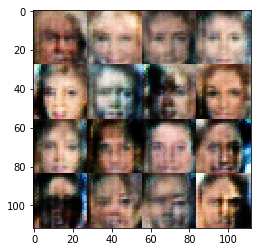

Epoch 1/1... Discriminator Loss: 0.7281... Generator Loss: 1.6421
Epoch 1/1... Discriminator Loss: 0.7443... Generator Loss: 1.0546
Epoch 1/1... Discriminator Loss: 1.2585... Generator Loss: 0.4988
Epoch 1/1... Discriminator Loss: 1.3209... Generator Loss: 1.6448
Epoch 1/1... Discriminator Loss: 1.2148... Generator Loss: 0.7602
Epoch 1/1... Discriminator Loss: 0.9405... Generator Loss: 0.7987
Epoch 1/1... Discriminator Loss: 0.9561... Generator Loss: 1.7693
Epoch 1/1... Discriminator Loss: 1.3163... Generator Loss: 0.4685
Epoch 1/1... Discriminator Loss: 1.2287... Generator Loss: 1.4823
Epoch 1/1... Discriminator Loss: 1.5731... Generator Loss: 0.3720


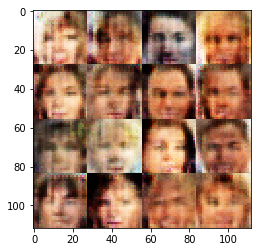

Epoch 1/1... Discriminator Loss: 1.2482... Generator Loss: 0.9980
Epoch 1/1... Discriminator Loss: 1.2180... Generator Loss: 1.0392
Epoch 1/1... Discriminator Loss: 0.7075... Generator Loss: 1.3357
Epoch 1/1... Discriminator Loss: 1.1308... Generator Loss: 0.5486
Epoch 1/1... Discriminator Loss: 2.0633... Generator Loss: 1.4717
Epoch 1/1... Discriminator Loss: 1.4428... Generator Loss: 0.3696
Epoch 1/1... Discriminator Loss: 1.2326... Generator Loss: 1.4152
Epoch 1/1... Discriminator Loss: 1.0945... Generator Loss: 0.8938
Epoch 1/1... Discriminator Loss: 1.2687... Generator Loss: 0.5036
Epoch 1/1... Discriminator Loss: 1.1832... Generator Loss: 0.8240


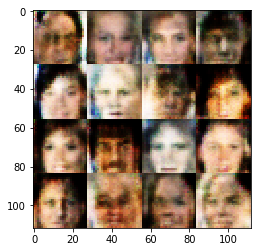

Epoch 1/1... Discriminator Loss: 1.3138... Generator Loss: 0.9009
Epoch 1/1... Discriminator Loss: 1.5283... Generator Loss: 0.4908
Epoch 1/1... Discriminator Loss: 1.4399... Generator Loss: 0.5543
Epoch 1/1... Discriminator Loss: 1.3867... Generator Loss: 0.7597
Epoch 1/1... Discriminator Loss: 1.2277... Generator Loss: 0.9601
Epoch 1/1... Discriminator Loss: 0.9187... Generator Loss: 1.4081
Epoch 1/1... Discriminator Loss: 0.5315... Generator Loss: 1.3906
Epoch 1/1... Discriminator Loss: 1.8582... Generator Loss: 0.2361
Epoch 1/1... Discriminator Loss: 1.9226... Generator Loss: 2.3225
Epoch 1/1... Discriminator Loss: 1.1990... Generator Loss: 0.6810


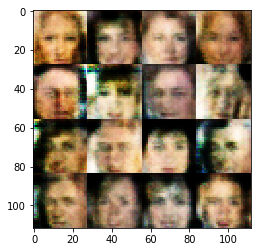

Epoch 1/1... Discriminator Loss: 1.1719... Generator Loss: 0.6108
Epoch 1/1... Discriminator Loss: 0.9619... Generator Loss: 1.1690
Epoch 1/1... Discriminator Loss: 1.1207... Generator Loss: 0.6891
Epoch 1/1... Discriminator Loss: 0.9978... Generator Loss: 0.8788
Epoch 1/1... Discriminator Loss: 1.1322... Generator Loss: 1.0584
Epoch 1/1... Discriminator Loss: 1.2350... Generator Loss: 0.6128
Epoch 1/1... Discriminator Loss: 0.5950... Generator Loss: 1.9051
Epoch 1/1... Discriminator Loss: 1.3628... Generator Loss: 0.4659
Epoch 1/1... Discriminator Loss: 1.2878... Generator Loss: 1.5114
Epoch 1/1... Discriminator Loss: 1.1342... Generator Loss: 0.6019


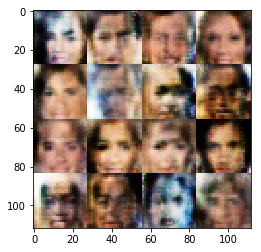

Epoch 1/1... Discriminator Loss: 0.7261... Generator Loss: 2.7437
Epoch 1/1... Discriminator Loss: 1.5006... Generator Loss: 0.3233
Epoch 1/1... Discriminator Loss: 1.3150... Generator Loss: 1.9625
Epoch 1/1... Discriminator Loss: 0.9462... Generator Loss: 1.1180
Epoch 1/1... Discriminator Loss: 1.5816... Generator Loss: 0.3177
Epoch 1/1... Discriminator Loss: 1.0936... Generator Loss: 1.5124
Epoch 1/1... Discriminator Loss: 1.2403... Generator Loss: 0.8119
Epoch 1/1... Discriminator Loss: 1.3346... Generator Loss: 0.6362
Epoch 1/1... Discriminator Loss: 0.7950... Generator Loss: 1.2907
Epoch 1/1... Discriminator Loss: 0.5270... Generator Loss: 1.6671


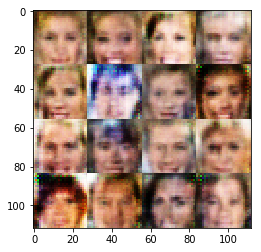

Epoch 1/1... Discriminator Loss: 1.1779... Generator Loss: 0.5273
Epoch 1/1... Discriminator Loss: 0.9073... Generator Loss: 1.9390
Epoch 1/1... Discriminator Loss: 1.0720... Generator Loss: 0.7226
Epoch 1/1... Discriminator Loss: 0.9946... Generator Loss: 1.0607
Epoch 1/1... Discriminator Loss: 1.1513... Generator Loss: 0.8236
Epoch 1/1... Discriminator Loss: 1.1788... Generator Loss: 0.6820
Epoch 1/1... Discriminator Loss: 1.1950... Generator Loss: 0.8981
Epoch 1/1... Discriminator Loss: 1.3186... Generator Loss: 0.7840
Epoch 1/1... Discriminator Loss: 1.2298... Generator Loss: 0.5669
Epoch 1/1... Discriminator Loss: 1.0099... Generator Loss: 1.3110


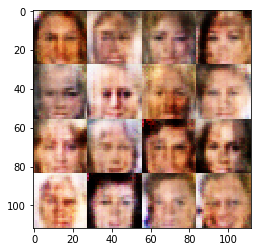

Epoch 1/1... Discriminator Loss: 0.7229... Generator Loss: 1.4801
Epoch 1/1... Discriminator Loss: 1.6983... Generator Loss: 0.2608
Epoch 1/1... Discriminator Loss: 0.7851... Generator Loss: 3.5739
Epoch 1/1... Discriminator Loss: 1.0993... Generator Loss: 0.6405
Epoch 1/1... Discriminator Loss: 0.6453... Generator Loss: 1.2727
Epoch 1/1... Discriminator Loss: 1.0325... Generator Loss: 0.8950
Epoch 1/1... Discriminator Loss: 1.0337... Generator Loss: 0.6664
Epoch 1/1... Discriminator Loss: 1.0200... Generator Loss: 1.6749
Epoch 1/1... Discriminator Loss: 0.9918... Generator Loss: 0.6465
Epoch 1/1... Discriminator Loss: 0.6810... Generator Loss: 1.5104


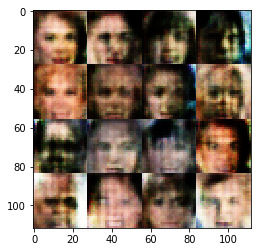

Epoch 1/1... Discriminator Loss: 1.2040... Generator Loss: 0.5797
Epoch 1/1... Discriminator Loss: 0.8533... Generator Loss: 1.5524
Epoch 1/1... Discriminator Loss: 0.9235... Generator Loss: 0.8696
Epoch 1/1... Discriminator Loss: 0.9693... Generator Loss: 1.2530
Epoch 1/1... Discriminator Loss: 1.6415... Generator Loss: 0.3561
Epoch 1/1... Discriminator Loss: 1.3980... Generator Loss: 1.6638
Epoch 1/1... Discriminator Loss: 0.5159... Generator Loss: 2.4109
Epoch 1/1... Discriminator Loss: 2.6512... Generator Loss: 0.1165
Epoch 1/1... Discriminator Loss: 1.4212... Generator Loss: 3.2107
Epoch 1/1... Discriminator Loss: 1.0054... Generator Loss: 0.7774


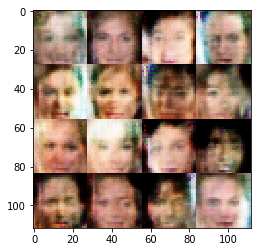

Epoch 1/1... Discriminator Loss: 0.9961... Generator Loss: 0.7470
Epoch 1/1... Discriminator Loss: 0.9014... Generator Loss: 1.4354
Epoch 1/1... Discriminator Loss: 0.7729... Generator Loss: 1.0321
Epoch 1/1... Discriminator Loss: 0.8296... Generator Loss: 1.3582
Epoch 1/1... Discriminator Loss: 1.0678... Generator Loss: 0.7843
Epoch 1/1... Discriminator Loss: 0.9673... Generator Loss: 1.4338
Epoch 1/1... Discriminator Loss: 1.5297... Generator Loss: 0.3306
Epoch 1/1... Discriminator Loss: 1.4103... Generator Loss: 1.8841
Epoch 1/1... Discriminator Loss: 0.9503... Generator Loss: 0.9575
Epoch 1/1... Discriminator Loss: 0.6257... Generator Loss: 1.2725


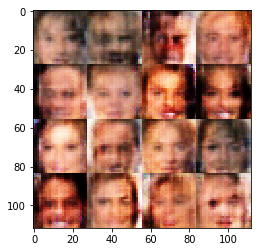

Epoch 1/1... Discriminator Loss: 0.7864... Generator Loss: 1.0712
Epoch 1/1... Discriminator Loss: 1.1701... Generator Loss: 0.6953
Epoch 1/1... Discriminator Loss: 1.4272... Generator Loss: 1.1112
Epoch 1/1... Discriminator Loss: 1.2329... Generator Loss: 0.4717
Epoch 1/1... Discriminator Loss: 0.9598... Generator Loss: 1.9885
Epoch 1/1... Discriminator Loss: 0.7823... Generator Loss: 0.9955
Epoch 1/1... Discriminator Loss: 0.9793... Generator Loss: 0.8385
Epoch 1/1... Discriminator Loss: 1.1048... Generator Loss: 0.7306
Epoch 1/1... Discriminator Loss: 1.1859... Generator Loss: 1.3075
Epoch 1/1... Discriminator Loss: 1.4403... Generator Loss: 0.3991


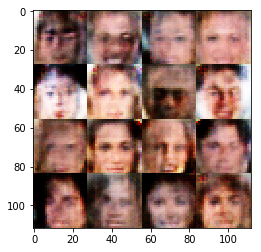

Epoch 1/1... Discriminator Loss: 1.3494... Generator Loss: 3.1420
Epoch 1/1... Discriminator Loss: 1.1714... Generator Loss: 0.5700
Epoch 1/1... Discriminator Loss: 1.2531... Generator Loss: 0.9146
Epoch 1/1... Discriminator Loss: 1.2980... Generator Loss: 0.6004
Epoch 1/1... Discriminator Loss: 1.3432... Generator Loss: 0.8998
Epoch 1/1... Discriminator Loss: 1.3892... Generator Loss: 0.4907
Epoch 1/1... Discriminator Loss: 1.3725... Generator Loss: 0.6168
Epoch 1/1... Discriminator Loss: 1.3226... Generator Loss: 1.0245
Epoch 1/1... Discriminator Loss: 1.4489... Generator Loss: 0.5380
Epoch 1/1... Discriminator Loss: 1.3566... Generator Loss: 0.8678


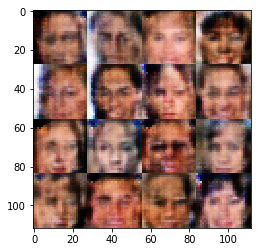

Epoch 1/1... Discriminator Loss: 1.2920... Generator Loss: 0.7574
Epoch 1/1... Discriminator Loss: 1.0561... Generator Loss: 0.9477
Epoch 1/1... Discriminator Loss: 0.5581... Generator Loss: 2.8850
Epoch 1/1... Discriminator Loss: 1.9190... Generator Loss: 0.2540
Epoch 1/1... Discriminator Loss: 1.1400... Generator Loss: 1.0063
Epoch 1/1... Discriminator Loss: 1.0948... Generator Loss: 1.2447
Epoch 1/1... Discriminator Loss: 1.3310... Generator Loss: 0.4893
Epoch 1/1... Discriminator Loss: 0.9874... Generator Loss: 1.0383
Epoch 1/1... Discriminator Loss: 0.9399... Generator Loss: 0.8662
Epoch 1/1... Discriminator Loss: 0.9076... Generator Loss: 1.3391


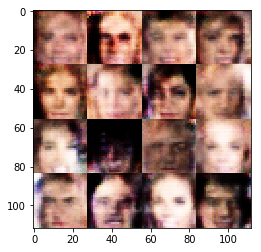

Epoch 1/1... Discriminator Loss: 0.8389... Generator Loss: 0.9841
Epoch 1/1... Discriminator Loss: 0.6477... Generator Loss: 1.3237
Epoch 1/1... Discriminator Loss: 0.7993... Generator Loss: 1.1712
Epoch 1/1... Discriminator Loss: 0.6986... Generator Loss: 1.2805
Epoch 1/1... Discriminator Loss: 0.9404... Generator Loss: 0.7134
Epoch 1/1... Discriminator Loss: 1.4238... Generator Loss: 2.5487
Epoch 1/1... Discriminator Loss: 1.4196... Generator Loss: 0.7755
Epoch 1/1... Discriminator Loss: 1.6354... Generator Loss: 0.3911
Epoch 1/1... Discriminator Loss: 2.0206... Generator Loss: 0.8312
Epoch 1/1... Discriminator Loss: 1.8712... Generator Loss: 0.3028


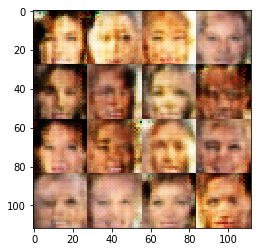

Epoch 1/1... Discriminator Loss: 1.6531... Generator Loss: 0.7672
Epoch 1/1... Discriminator Loss: 1.4862... Generator Loss: 0.7737
Epoch 1/1... Discriminator Loss: 1.3488... Generator Loss: 0.5621
Epoch 1/1... Discriminator Loss: 1.2681... Generator Loss: 0.8994
Epoch 1/1... Discriminator Loss: 0.9050... Generator Loss: 1.7983
Epoch 1/1... Discriminator Loss: 1.6936... Generator Loss: 0.2972
Epoch 1/1... Discriminator Loss: 1.2520... Generator Loss: 0.7317
Epoch 1/1... Discriminator Loss: 1.2881... Generator Loss: 1.4253
Epoch 1/1... Discriminator Loss: 1.3426... Generator Loss: 0.6245
Epoch 1/1... Discriminator Loss: 1.1604... Generator Loss: 0.6437


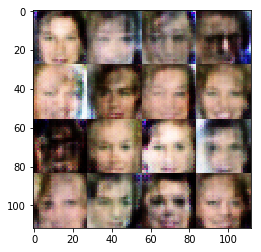

Epoch 1/1... Discriminator Loss: 1.3484... Generator Loss: 0.7514
Epoch 1/1... Discriminator Loss: 1.1645... Generator Loss: 0.7952
Epoch 1/1... Discriminator Loss: 1.2823... Generator Loss: 0.7118
Epoch 1/1... Discriminator Loss: 1.1497... Generator Loss: 0.8369
Epoch 1/1... Discriminator Loss: 1.2915... Generator Loss: 0.6042
Epoch 1/1... Discriminator Loss: 1.0908... Generator Loss: 0.9770
Epoch 1/1... Discriminator Loss: 0.4664... Generator Loss: 2.5838
Epoch 1/1... Discriminator Loss: 2.1398... Generator Loss: 0.1706
Epoch 1/1... Discriminator Loss: 1.5312... Generator Loss: 2.2535
Epoch 1/1... Discriminator Loss: 1.3286... Generator Loss: 0.5973


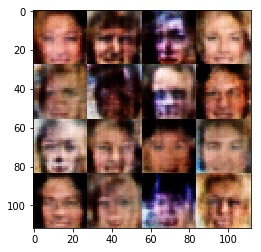

Epoch 1/1... Discriminator Loss: 1.2454... Generator Loss: 0.9158
Epoch 1/1... Discriminator Loss: 1.1431... Generator Loss: 0.9232
Epoch 1/1... Discriminator Loss: 1.0730... Generator Loss: 0.7906
Epoch 1/1... Discriminator Loss: 1.4241... Generator Loss: 0.6324
Epoch 1/1... Discriminator Loss: 1.2493... Generator Loss: 0.8201
Epoch 1/1... Discriminator Loss: 1.1040... Generator Loss: 0.8399
Epoch 1/1... Discriminator Loss: 1.1884... Generator Loss: 0.6826
Epoch 1/1... Discriminator Loss: 1.1923... Generator Loss: 0.9710
Epoch 1/1... Discriminator Loss: 0.7875... Generator Loss: 1.3304
Epoch 1/1... Discriminator Loss: 1.4073... Generator Loss: 0.5025


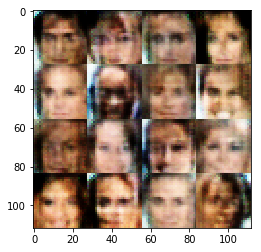

Epoch 1/1... Discriminator Loss: 1.4636... Generator Loss: 0.7801
Epoch 1/1... Discriminator Loss: 1.3488... Generator Loss: 0.6517
Epoch 1/1... Discriminator Loss: 1.3955... Generator Loss: 0.7650
Epoch 1/1... Discriminator Loss: 1.2503... Generator Loss: 0.6930
Epoch 1/1... Discriminator Loss: 0.9869... Generator Loss: 0.9609
Epoch 1/1... Discriminator Loss: 0.9748... Generator Loss: 1.1358
Epoch 1/1... Discriminator Loss: 1.4572... Generator Loss: 0.4979
Epoch 1/1... Discriminator Loss: 1.5443... Generator Loss: 1.3187
Epoch 1/1... Discriminator Loss: 1.5894... Generator Loss: 0.3795
Epoch 1/1... Discriminator Loss: 0.8809... Generator Loss: 2.7886


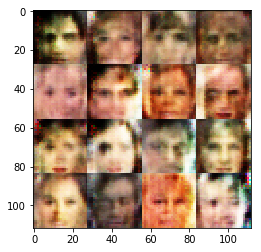

Epoch 1/1... Discriminator Loss: 0.6336... Generator Loss: 1.3348
Epoch 1/1... Discriminator Loss: 0.9208... Generator Loss: 0.7348
Epoch 1/1... Discriminator Loss: 0.8778... Generator Loss: 1.6195
Epoch 1/1... Discriminator Loss: 0.9906... Generator Loss: 0.8165
Epoch 1/1... Discriminator Loss: 0.9715... Generator Loss: 0.8563
Epoch 1/1... Discriminator Loss: 1.1265... Generator Loss: 0.8243
Epoch 1/1... Discriminator Loss: 0.9275... Generator Loss: 1.0718
Epoch 1/1... Discriminator Loss: 1.0325... Generator Loss: 0.8585
Epoch 1/1... Discriminator Loss: 0.7569... Generator Loss: 1.4619
Epoch 1/1... Discriminator Loss: 0.5660... Generator Loss: 2.0990


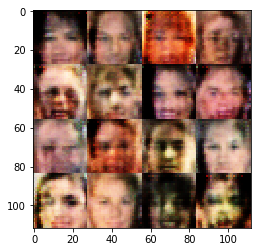

Epoch 1/1... Discriminator Loss: 1.4856... Generator Loss: 0.3263
Epoch 1/1... Discriminator Loss: 2.5828... Generator Loss: 3.3657
Epoch 1/1... Discriminator Loss: 1.3422... Generator Loss: 0.4136
Epoch 1/1... Discriminator Loss: 1.0764... Generator Loss: 0.7413
Epoch 1/1... Discriminator Loss: 1.3658... Generator Loss: 1.2885
Epoch 1/1... Discriminator Loss: 1.3655... Generator Loss: 0.5982
Epoch 1/1... Discriminator Loss: 1.2511... Generator Loss: 0.9069
Epoch 1/1... Discriminator Loss: 1.2730... Generator Loss: 0.6652
Epoch 1/1... Discriminator Loss: 1.2238... Generator Loss: 0.7650
Epoch 1/1... Discriminator Loss: 0.7308... Generator Loss: 2.1944


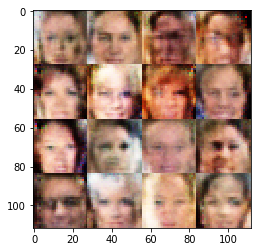

Epoch 1/1... Discriminator Loss: 1.0400... Generator Loss: 0.6366
Epoch 1/1... Discriminator Loss: 0.9476... Generator Loss: 0.9592
Epoch 1/1... Discriminator Loss: 1.2605... Generator Loss: 1.1785
Epoch 1/1... Discriminator Loss: 1.1025... Generator Loss: 0.7391
Epoch 1/1... Discriminator Loss: 1.0054... Generator Loss: 1.1780
Epoch 1/1... Discriminator Loss: 1.0562... Generator Loss: 0.7316
Epoch 1/1... Discriminator Loss: 1.0239... Generator Loss: 0.9737
Epoch 1/1... Discriminator Loss: 1.2214... Generator Loss: 0.7254
Epoch 1/1... Discriminator Loss: 1.1484... Generator Loss: 0.8855
Epoch 1/1... Discriminator Loss: 1.1610... Generator Loss: 0.7141


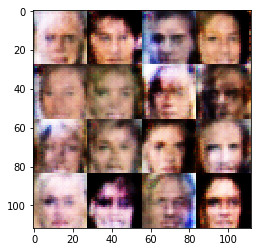

Epoch 1/1... Discriminator Loss: 1.3221... Generator Loss: 1.0814
Epoch 1/1... Discriminator Loss: 1.9912... Generator Loss: 0.2061
Epoch 1/1... Discriminator Loss: 1.7988... Generator Loss: 1.9111
Epoch 1/1... Discriminator Loss: 1.7310... Generator Loss: 0.3563
Epoch 1/1... Discriminator Loss: 1.1635... Generator Loss: 1.0857
Epoch 1/1... Discriminator Loss: 1.2691... Generator Loss: 0.9200
Epoch 1/1... Discriminator Loss: 1.2372... Generator Loss: 0.6621
Epoch 1/1... Discriminator Loss: 0.4754... Generator Loss: 3.3045
Epoch 1/1... Discriminator Loss: 0.9863... Generator Loss: 0.6188
Epoch 1/1... Discriminator Loss: 0.4562... Generator Loss: 1.9473


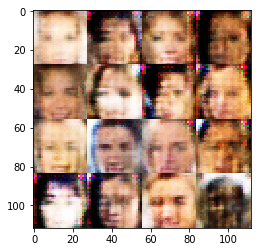

Epoch 1/1... Discriminator Loss: 0.4671... Generator Loss: 1.8791
Epoch 1/1... Discriminator Loss: 1.2764... Generator Loss: 0.5412
Epoch 1/1... Discriminator Loss: 1.0171... Generator Loss: 1.4894
Epoch 1/1... Discriminator Loss: 0.9059... Generator Loss: 0.9341
Epoch 1/1... Discriminator Loss: 0.8418... Generator Loss: 0.8096
Epoch 1/1... Discriminator Loss: 0.8357... Generator Loss: 1.6261
Epoch 1/1... Discriminator Loss: 0.9009... Generator Loss: 0.8047
Epoch 1/1... Discriminator Loss: 1.0378... Generator Loss: 0.7985
Epoch 1/1... Discriminator Loss: 0.9648... Generator Loss: 1.1896
Epoch 1/1... Discriminator Loss: 1.1513... Generator Loss: 0.5348


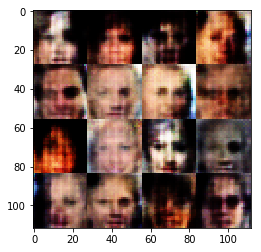

Epoch 1/1... Discriminator Loss: 1.3118... Generator Loss: 2.3523
Epoch 1/1... Discriminator Loss: 0.9757... Generator Loss: 0.7737
Epoch 1/1... Discriminator Loss: 1.0010... Generator Loss: 1.0155
Epoch 1/1... Discriminator Loss: 1.1108... Generator Loss: 0.9686
Epoch 1/1... Discriminator Loss: 1.1215... Generator Loss: 0.8577
Epoch 1/1... Discriminator Loss: 1.1922... Generator Loss: 0.7138
Epoch 1/1... Discriminator Loss: 1.0962... Generator Loss: 1.1625
Epoch 1/1... Discriminator Loss: 1.1299... Generator Loss: 0.7349
Epoch 1/1... Discriminator Loss: 1.0671... Generator Loss: 0.9554
Epoch 1/1... Discriminator Loss: 1.2291... Generator Loss: 1.0276


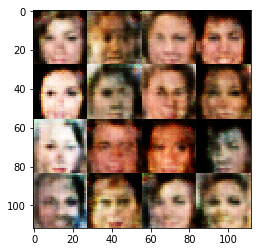

Epoch 1/1... Discriminator Loss: 1.2912... Generator Loss: 0.5408
Epoch 1/1... Discriminator Loss: 1.2883... Generator Loss: 0.6338
Epoch 1/1... Discriminator Loss: 1.2055... Generator Loss: 1.2997
Epoch 1/1... Discriminator Loss: 1.3115... Generator Loss: 0.5172
Epoch 1/1... Discriminator Loss: 1.1135... Generator Loss: 1.2864
Epoch 1/1... Discriminator Loss: 1.0307... Generator Loss: 0.7679
Epoch 1/1... Discriminator Loss: 0.7390... Generator Loss: 1.3862
Epoch 1/1... Discriminator Loss: 1.1426... Generator Loss: 0.5674
Epoch 1/1... Discriminator Loss: 1.2565... Generator Loss: 1.3864
Epoch 1/1... Discriminator Loss: 1.0736... Generator Loss: 0.6805


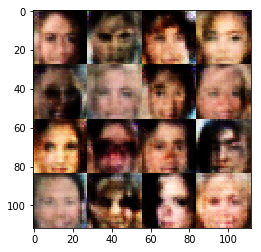

Epoch 1/1... Discriminator Loss: 1.3069... Generator Loss: 0.7136
Epoch 1/1... Discriminator Loss: 1.0981... Generator Loss: 0.7132
Epoch 1/1... Discriminator Loss: 0.9599... Generator Loss: 1.3421
Epoch 1/1... Discriminator Loss: 0.5158... Generator Loss: 1.4579
Epoch 1/1... Discriminator Loss: 0.4251... Generator Loss: 1.6951
Epoch 1/1... Discriminator Loss: 1.8991... Generator Loss: 0.2197
Epoch 1/1... Discriminator Loss: 2.7951... Generator Loss: 3.4301
Epoch 1/1... Discriminator Loss: 1.1891... Generator Loss: 1.1387
Epoch 1/1... Discriminator Loss: 1.8168... Generator Loss: 0.2218
Epoch 1/1... Discriminator Loss: 1.0423... Generator Loss: 0.9715


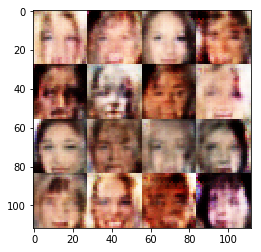

Epoch 1/1... Discriminator Loss: 1.4238... Generator Loss: 1.3366
Epoch 1/1... Discriminator Loss: 1.4022... Generator Loss: 0.5405
Epoch 1/1... Discriminator Loss: 1.3251... Generator Loss: 0.6231
Epoch 1/1... Discriminator Loss: 1.3916... Generator Loss: 0.9109
Epoch 1/1... Discriminator Loss: 1.2879... Generator Loss: 0.8011
Epoch 1/1... Discriminator Loss: 0.6136... Generator Loss: 2.2371
Epoch 1/1... Discriminator Loss: 1.2011... Generator Loss: 0.4846
Epoch 1/1... Discriminator Loss: 1.2534... Generator Loss: 0.6784
Epoch 1/1... Discriminator Loss: 1.2182... Generator Loss: 1.0489
Epoch 1/1... Discriminator Loss: 1.0800... Generator Loss: 0.9023


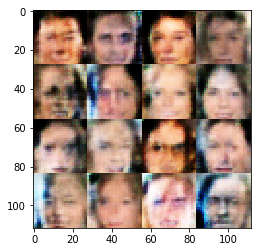

Epoch 1/1... Discriminator Loss: 0.9887... Generator Loss: 0.8232
Epoch 1/1... Discriminator Loss: 1.1100... Generator Loss: 1.0733
Epoch 1/1... Discriminator Loss: 0.7479... Generator Loss: 1.7431
Epoch 1/1... Discriminator Loss: 1.5155... Generator Loss: 0.3032
Epoch 1/1... Discriminator Loss: 1.2531... Generator Loss: 1.7485
Epoch 1/1... Discriminator Loss: 1.2215... Generator Loss: 0.4854
Epoch 1/1... Discriminator Loss: 1.1215... Generator Loss: 1.4160
Epoch 1/1... Discriminator Loss: 1.2935... Generator Loss: 0.6018
Epoch 1/1... Discriminator Loss: 0.8414... Generator Loss: 1.2405
Epoch 1/1... Discriminator Loss: 0.3295... Generator Loss: 2.7063


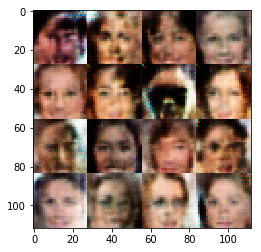

Epoch 1/1... Discriminator Loss: 1.5836... Generator Loss: 0.2978
Epoch 1/1... Discriminator Loss: 1.4934... Generator Loss: 2.6897
Epoch 1/1... Discriminator Loss: 0.9841... Generator Loss: 1.3372
Epoch 1/1... Discriminator Loss: 1.6510... Generator Loss: 0.2852
Epoch 1/1... Discriminator Loss: 1.4803... Generator Loss: 1.6663
Epoch 1/1... Discriminator Loss: 1.3343... Generator Loss: 0.5474
Epoch 1/1... Discriminator Loss: 1.1919... Generator Loss: 0.6839
Epoch 1/1... Discriminator Loss: 1.1297... Generator Loss: 1.1570
Epoch 1/1... Discriminator Loss: 1.2849... Generator Loss: 0.7460
Epoch 1/1... Discriminator Loss: 1.4196... Generator Loss: 0.5769


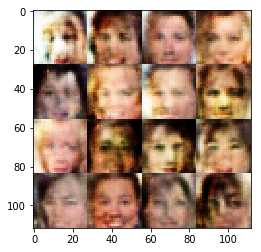

Epoch 1/1... Discriminator Loss: 1.4568... Generator Loss: 0.7417
Epoch 1/1... Discriminator Loss: 1.2333... Generator Loss: 0.8439
Epoch 1/1... Discriminator Loss: 1.1242... Generator Loss: 0.9850
Epoch 1/1... Discriminator Loss: 0.6854... Generator Loss: 1.6861
Epoch 1/1... Discriminator Loss: 1.3757... Generator Loss: 0.4177
Epoch 1/1... Discriminator Loss: 0.9966... Generator Loss: 1.2603
Epoch 1/1... Discriminator Loss: 0.9884... Generator Loss: 0.9520
Epoch 1/1... Discriminator Loss: 1.2877... Generator Loss: 0.6198
Epoch 1/1... Discriminator Loss: 1.1926... Generator Loss: 1.1188
Epoch 1/1... Discriminator Loss: 1.2685... Generator Loss: 0.6006


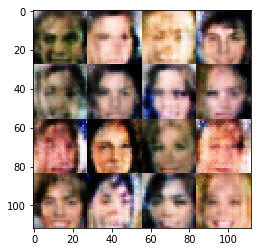

Epoch 1/1... Discriminator Loss: 1.2382... Generator Loss: 0.6419
Epoch 1/1... Discriminator Loss: 1.2566... Generator Loss: 0.9843
Epoch 1/1... Discriminator Loss: 1.4237... Generator Loss: 0.5433
Epoch 1/1... Discriminator Loss: 1.2768... Generator Loss: 0.6239
Epoch 1/1... Discriminator Loss: 1.2168... Generator Loss: 1.0280
Epoch 1/1... Discriminator Loss: 0.6370... Generator Loss: 1.4436
Epoch 1/1... Discriminator Loss: 0.8649... Generator Loss: 0.8472
Epoch 1/1... Discriminator Loss: 0.6784... Generator Loss: 1.1570
Epoch 1/1... Discriminator Loss: 0.9317... Generator Loss: 0.9036
Epoch 1/1... Discriminator Loss: 0.6629... Generator Loss: 2.2348


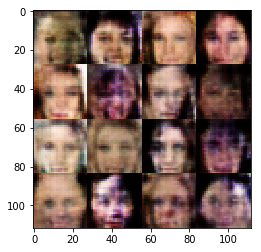

Epoch 1/1... Discriminator Loss: 1.3627... Generator Loss: 0.3727
Epoch 1/1... Discriminator Loss: 1.0714... Generator Loss: 2.3122
Epoch 1/1... Discriminator Loss: 0.9047... Generator Loss: 0.8112
Epoch 1/1... Discriminator Loss: 0.9757... Generator Loss: 1.0821
Epoch 1/1... Discriminator Loss: 1.0433... Generator Loss: 0.6440
Epoch 1/1... Discriminator Loss: 1.3913... Generator Loss: 1.6231
Epoch 1/1... Discriminator Loss: 1.2428... Generator Loss: 0.5472
Epoch 1/1... Discriminator Loss: 1.0390... Generator Loss: 0.9291
Epoch 1/1... Discriminator Loss: 1.1533... Generator Loss: 1.0882
Epoch 1/1... Discriminator Loss: 1.1323... Generator Loss: 0.6598


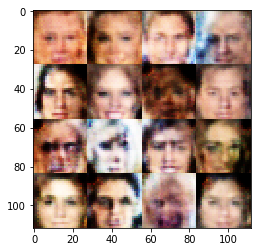

Epoch 1/1... Discriminator Loss: 1.1189... Generator Loss: 1.0557
Epoch 1/1... Discriminator Loss: 1.4883... Generator Loss: 0.4797
Epoch 1/1... Discriminator Loss: 1.0999... Generator Loss: 1.6178
Epoch 1/1... Discriminator Loss: 0.5037... Generator Loss: 1.7754
Epoch 1/1... Discriminator Loss: 1.5559... Generator Loss: 0.3492
Epoch 1/1... Discriminator Loss: 1.6701... Generator Loss: 3.6826
Epoch 1/1... Discriminator Loss: 1.7610... Generator Loss: 0.2625
Epoch 1/1... Discriminator Loss: 0.9083... Generator Loss: 1.3159
Epoch 1/1... Discriminator Loss: 1.0018... Generator Loss: 1.9302
Epoch 1/1... Discriminator Loss: 0.9170... Generator Loss: 0.8512


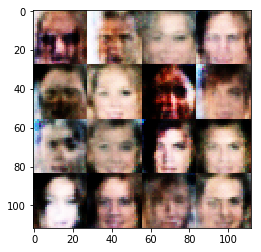

Epoch 1/1... Discriminator Loss: 0.9769... Generator Loss: 1.0793
Epoch 1/1... Discriminator Loss: 1.1252... Generator Loss: 0.7918
Epoch 1/1... Discriminator Loss: 1.0629... Generator Loss: 0.9518
Epoch 1/1... Discriminator Loss: 1.3903... Generator Loss: 0.5753
Epoch 1/1... Discriminator Loss: 1.1464... Generator Loss: 1.0422
Epoch 1/1... Discriminator Loss: 1.2396... Generator Loss: 0.5480
Epoch 1/1... Discriminator Loss: 1.3567... Generator Loss: 1.1354
Epoch 1/1... Discriminator Loss: 1.2997... Generator Loss: 0.6082
Epoch 1/1... Discriminator Loss: 1.3402... Generator Loss: 0.5647
Epoch 1/1... Discriminator Loss: 1.3921... Generator Loss: 1.1213


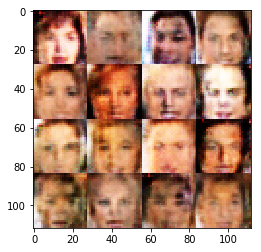

Epoch 1/1... Discriminator Loss: 1.3655... Generator Loss: 0.5801
Epoch 1/1... Discriminator Loss: 1.0278... Generator Loss: 1.3165
Epoch 1/1... Discriminator Loss: 1.3922... Generator Loss: 0.4852
Epoch 1/1... Discriminator Loss: 0.8061... Generator Loss: 1.5291
Epoch 1/1... Discriminator Loss: 1.1557... Generator Loss: 0.6672
Epoch 1/1... Discriminator Loss: 1.2757... Generator Loss: 0.5414
Epoch 1/1... Discriminator Loss: 1.3580... Generator Loss: 1.1210
Epoch 1/1... Discriminator Loss: 1.2490... Generator Loss: 0.5833
Epoch 1/1... Discriminator Loss: 1.1624... Generator Loss: 0.8974
Epoch 1/1... Discriminator Loss: 1.1857... Generator Loss: 0.8537


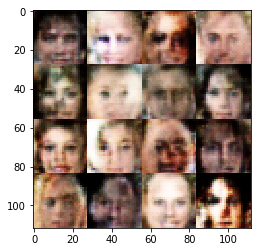

Epoch 1/1... Discriminator Loss: 1.0254... Generator Loss: 0.9031
Epoch 1/1... Discriminator Loss: 1.2806... Generator Loss: 0.5198
Epoch 1/1... Discriminator Loss: 1.0816... Generator Loss: 1.0600
Epoch 1/1... Discriminator Loss: 1.1170... Generator Loss: 0.7550
Epoch 1/1... Discriminator Loss: 0.5809... Generator Loss: 1.9418
Epoch 1/1... Discriminator Loss: 0.6263... Generator Loss: 1.1954
Epoch 1/1... Discriminator Loss: 1.5028... Generator Loss: 0.3498
Epoch 1/1... Discriminator Loss: 1.2403... Generator Loss: 2.3762
Epoch 1/1... Discriminator Loss: 0.9310... Generator Loss: 0.8848
Epoch 1/1... Discriminator Loss: 1.3705... Generator Loss: 0.4231


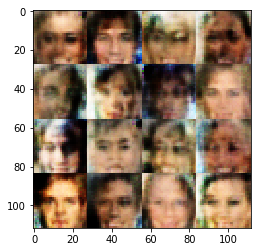

Epoch 1/1... Discriminator Loss: 1.2359... Generator Loss: 1.8411
Epoch 1/1... Discriminator Loss: 1.4765... Generator Loss: 0.3546
Epoch 1/1... Discriminator Loss: 0.9715... Generator Loss: 1.2371
Epoch 1/1... Discriminator Loss: 1.1597... Generator Loss: 0.8651
Epoch 1/1... Discriminator Loss: 0.9589... Generator Loss: 0.9895
Epoch 1/1... Discriminator Loss: 1.3675... Generator Loss: 0.4864
Epoch 1/1... Discriminator Loss: 1.3695... Generator Loss: 0.9110
Epoch 1/1... Discriminator Loss: 1.0513... Generator Loss: 0.9305
Epoch 1/1... Discriminator Loss: 0.9051... Generator Loss: 1.4261
Epoch 1/1... Discriminator Loss: 1.6028... Generator Loss: 0.2983


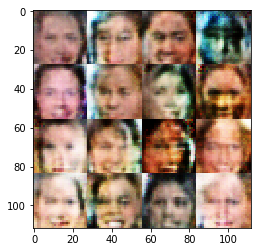

Epoch 1/1... Discriminator Loss: 0.6312... Generator Loss: 3.5024
Epoch 1/1... Discriminator Loss: 1.0121... Generator Loss: 0.6583
Epoch 1/1... Discriminator Loss: 0.6517... Generator Loss: 2.0907
Epoch 1/1... Discriminator Loss: 1.0405... Generator Loss: 0.7087
Epoch 1/1... Discriminator Loss: 1.0619... Generator Loss: 1.1186
Epoch 1/1... Discriminator Loss: 1.2419... Generator Loss: 0.5726
Epoch 1/1... Discriminator Loss: 0.9617... Generator Loss: 1.3439
Epoch 1/1... Discriminator Loss: 1.4013... Generator Loss: 0.3835
Epoch 1/1... Discriminator Loss: 1.1791... Generator Loss: 1.6000
Epoch 1/1... Discriminator Loss: 1.3020... Generator Loss: 0.6347


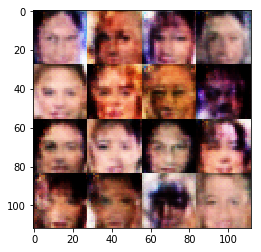

Epoch 1/1... Discriminator Loss: 1.0755... Generator Loss: 0.7088
Epoch 1/1... Discriminator Loss: 0.9188... Generator Loss: 1.6017
Epoch 1/1... Discriminator Loss: 0.7244... Generator Loss: 0.9899
Epoch 1/1... Discriminator Loss: 1.1559... Generator Loss: 0.6225
Epoch 1/1... Discriminator Loss: 1.2443... Generator Loss: 1.5091
Epoch 1/1... Discriminator Loss: 1.5043... Generator Loss: 0.3406
Epoch 1/1... Discriminator Loss: 0.8878... Generator Loss: 2.0037
Epoch 1/1... Discriminator Loss: 0.8106... Generator Loss: 0.9594
Epoch 1/1... Discriminator Loss: 0.9212... Generator Loss: 0.9438
Epoch 1/1... Discriminator Loss: 0.5920... Generator Loss: 1.7264


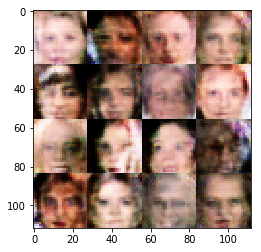

Epoch 1/1... Discriminator Loss: 1.6539... Generator Loss: 0.3511
Epoch 1/1... Discriminator Loss: 1.3375... Generator Loss: 2.4184
Epoch 1/1... Discriminator Loss: 1.4576... Generator Loss: 0.3683
Epoch 1/1... Discriminator Loss: 0.9425... Generator Loss: 1.8067
Epoch 1/1... Discriminator Loss: 1.0423... Generator Loss: 0.6771
Epoch 1/1... Discriminator Loss: 0.9094... Generator Loss: 1.1819
Epoch 1/1... Discriminator Loss: 0.5126... Generator Loss: 2.5822
Epoch 1/1... Discriminator Loss: 1.5395... Generator Loss: 0.3132
Epoch 1/1... Discriminator Loss: 2.2862... Generator Loss: 3.0971
Epoch 1/1... Discriminator Loss: 0.9078... Generator Loss: 0.8360


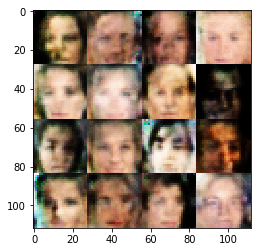

Epoch 1/1... Discriminator Loss: 1.0340... Generator Loss: 0.5898
Epoch 1/1... Discriminator Loss: 1.3273... Generator Loss: 1.4389
Epoch 1/1... Discriminator Loss: 1.0334... Generator Loss: 0.7141
Epoch 1/1... Discriminator Loss: 0.6387... Generator Loss: 1.6040
Epoch 1/1... Discriminator Loss: 1.1874... Generator Loss: 0.5979
Epoch 1/1... Discriminator Loss: 1.3359... Generator Loss: 2.7315
Epoch 1/1... Discriminator Loss: 1.1538... Generator Loss: 0.6850
Epoch 1/1... Discriminator Loss: 1.3792... Generator Loss: 1.3319
Epoch 1/1... Discriminator Loss: 1.7074... Generator Loss: 0.2767
Epoch 1/1... Discriminator Loss: 1.3937... Generator Loss: 1.1898


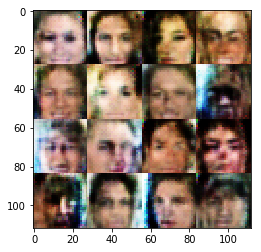

Epoch 1/1... Discriminator Loss: 1.1040... Generator Loss: 0.7834
Epoch 1/1... Discriminator Loss: 1.2185... Generator Loss: 0.6872
Epoch 1/1... Discriminator Loss: 1.3668... Generator Loss: 0.5386
Epoch 1/1... Discriminator Loss: 1.4040... Generator Loss: 1.1274
Epoch 1/1... Discriminator Loss: 1.4520... Generator Loss: 0.5032
Epoch 1/1... Discriminator Loss: 1.3744... Generator Loss: 0.8791
Epoch 1/1... Discriminator Loss: 1.0113... Generator Loss: 1.0930
Epoch 1/1... Discriminator Loss: 0.8480... Generator Loss: 0.9828
Epoch 1/1... Discriminator Loss: 0.7480... Generator Loss: 1.1261
Epoch 1/1... Discriminator Loss: 1.1822... Generator Loss: 0.6607


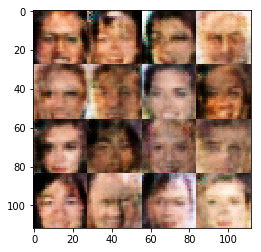

Epoch 1/1... Discriminator Loss: 1.1292... Generator Loss: 1.2612
Epoch 1/1... Discriminator Loss: 1.4960... Generator Loss: 0.3549
Epoch 1/1... Discriminator Loss: 0.9720... Generator Loss: 1.7190
Epoch 1/1... Discriminator Loss: 0.9568... Generator Loss: 0.7617
Epoch 1/1... Discriminator Loss: 0.8699... Generator Loss: 1.0885
Epoch 1/1... Discriminator Loss: 1.3834... Generator Loss: 0.4390
Epoch 1/1... Discriminator Loss: 1.4192... Generator Loss: 1.3322
Epoch 1/1... Discriminator Loss: 1.5670... Generator Loss: 0.3633
Epoch 1/1... Discriminator Loss: 1.4960... Generator Loss: 1.0422
Epoch 1/1... Discriminator Loss: 1.3344... Generator Loss: 0.6643


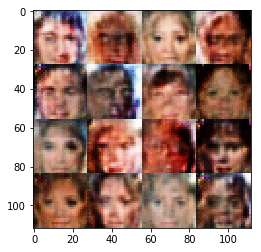

Epoch 1/1... Discriminator Loss: 1.4313... Generator Loss: 0.5085
Epoch 1/1... Discriminator Loss: 1.2456... Generator Loss: 0.9706
Epoch 1/1... Discriminator Loss: 0.6797... Generator Loss: 2.5908
Epoch 1/1... Discriminator Loss: 1.2051... Generator Loss: 0.4738
Epoch 1/1... Discriminator Loss: 1.4835... Generator Loss: 0.4297
Epoch 1/1... Discriminator Loss: 1.4308... Generator Loss: 1.9073
Epoch 1/1... Discriminator Loss: 1.1617... Generator Loss: 0.6089
Epoch 1/1... Discriminator Loss: 0.8367... Generator Loss: 1.0710
Epoch 1/1... Discriminator Loss: 0.7550... Generator Loss: 1.9060
Epoch 1/1... Discriminator Loss: 0.7845... Generator Loss: 0.8511


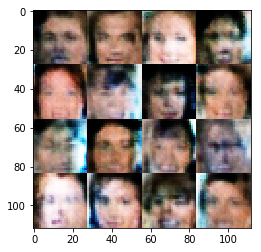

Epoch 1/1... Discriminator Loss: 0.9313... Generator Loss: 1.2000
Epoch 1/1... Discriminator Loss: 0.9339... Generator Loss: 0.8831
Epoch 1/1... Discriminator Loss: 1.0151... Generator Loss: 0.8590
Epoch 1/1... Discriminator Loss: 1.1280... Generator Loss: 0.8398
Epoch 1/1... Discriminator Loss: 1.1684... Generator Loss: 0.6232
Epoch 1/1... Discriminator Loss: 0.8523... Generator Loss: 1.1963
Epoch 1/1... Discriminator Loss: 1.1445... Generator Loss: 0.9282
Epoch 1/1... Discriminator Loss: 1.2543... Generator Loss: 0.5494
Epoch 1/1... Discriminator Loss: 1.3569... Generator Loss: 1.4422
Epoch 1/1... Discriminator Loss: 1.2025... Generator Loss: 0.5994


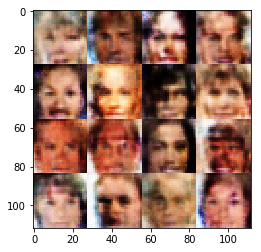

Epoch 1/1... Discriminator Loss: 1.1808... Generator Loss: 1.0690
Epoch 1/1... Discriminator Loss: 0.4962... Generator Loss: 1.9635
Epoch 1/1... Discriminator Loss: 1.2212... Generator Loss: 0.4829
Epoch 1/1... Discriminator Loss: 0.6741... Generator Loss: 1.7012
Epoch 1/1... Discriminator Loss: 1.3638... Generator Loss: 0.4830
Epoch 1/1... Discriminator Loss: 1.2284... Generator Loss: 1.8083
Epoch 1/1... Discriminator Loss: 1.5744... Generator Loss: 0.3042
Epoch 1/1... Discriminator Loss: 2.2060... Generator Loss: 3.1344
Epoch 1/1... Discriminator Loss: 0.9510... Generator Loss: 1.6709
Epoch 1/1... Discriminator Loss: 1.2687... Generator Loss: 0.4606


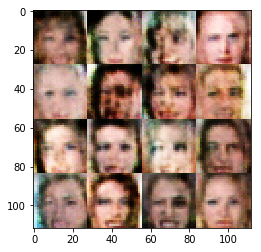

Epoch 1/1... Discriminator Loss: 1.1572... Generator Loss: 1.1542
Epoch 1/1... Discriminator Loss: 1.2062... Generator Loss: 0.7037
Epoch 1/1... Discriminator Loss: 1.3090... Generator Loss: 0.7655
Epoch 1/1... Discriminator Loss: 1.4156... Generator Loss: 0.7254
Epoch 1/1... Discriminator Loss: 1.5857... Generator Loss: 0.4693
Epoch 1/1... Discriminator Loss: 1.4468... Generator Loss: 0.7166
Epoch 1/1... Discriminator Loss: 1.0503... Generator Loss: 1.4975
Epoch 1/1... Discriminator Loss: 0.6946... Generator Loss: 1.3350
Epoch 1/1... Discriminator Loss: 1.5974... Generator Loss: 0.3172
Epoch 1/1... Discriminator Loss: 1.1487... Generator Loss: 1.7248


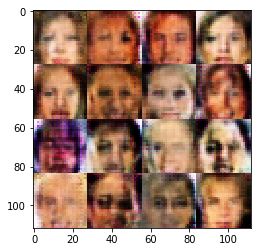

Epoch 1/1... Discriminator Loss: 1.2381... Generator Loss: 0.7666
Epoch 1/1... Discriminator Loss: 1.3578... Generator Loss: 0.4582
Epoch 1/1... Discriminator Loss: 1.1209... Generator Loss: 0.9137
Epoch 1/1... Discriminator Loss: 1.1982... Generator Loss: 0.9929
Epoch 1/1... Discriminator Loss: 1.1290... Generator Loss: 0.6207
Epoch 1/1... Discriminator Loss: 1.0708... Generator Loss: 0.8666
Epoch 1/1... Discriminator Loss: 1.0943... Generator Loss: 0.7199
Epoch 1/1... Discriminator Loss: 1.1429... Generator Loss: 1.4241
Epoch 1/1... Discriminator Loss: 1.1580... Generator Loss: 0.6084
Epoch 1/1... Discriminator Loss: 0.9985... Generator Loss: 0.9459


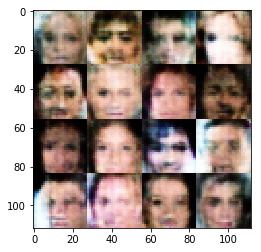

Epoch 1/1... Discriminator Loss: 1.2477... Generator Loss: 0.8021
Epoch 1/1... Discriminator Loss: 1.0415... Generator Loss: 0.8220
Epoch 1/1... Discriminator Loss: 1.0170... Generator Loss: 0.9073
Epoch 1/1... Discriminator Loss: 1.0977... Generator Loss: 0.9346
Epoch 1/1... Discriminator Loss: 0.8190... Generator Loss: 1.1358
Epoch 1/1... Discriminator Loss: 0.6607... Generator Loss: 1.0197
Epoch 1/1... Discriminator Loss: 0.7674... Generator Loss: 1.6157
Epoch 1/1... Discriminator Loss: 1.3305... Generator Loss: 0.5158
Epoch 1/1... Discriminator Loss: 1.6728... Generator Loss: 2.2786
Epoch 1/1... Discriminator Loss: 1.8491... Generator Loss: 0.2292


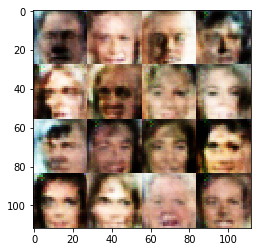

Epoch 1/1... Discriminator Loss: 1.3413... Generator Loss: 1.2375
Epoch 1/1... Discriminator Loss: 0.9218... Generator Loss: 1.4137
Epoch 1/1... Discriminator Loss: 1.2207... Generator Loss: 0.5756
Epoch 1/1... Discriminator Loss: 1.2167... Generator Loss: 1.0386
Epoch 1/1... Discriminator Loss: 1.2206... Generator Loss: 0.6836
Epoch 1/1... Discriminator Loss: 1.2804... Generator Loss: 0.7022
Epoch 1/1... Discriminator Loss: 0.6645... Generator Loss: 2.7340
Epoch 1/1... Discriminator Loss: 0.7035... Generator Loss: 1.0548
Epoch 1/1... Discriminator Loss: 0.9078... Generator Loss: 0.8095
Epoch 1/1... Discriminator Loss: 1.1813... Generator Loss: 2.2911


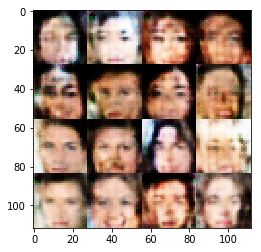

Epoch 1/1... Discriminator Loss: 1.0604... Generator Loss: 0.5825
Epoch 1/1... Discriminator Loss: 1.0019... Generator Loss: 1.1141
Epoch 1/1... Discriminator Loss: 1.0434... Generator Loss: 0.7696
Epoch 1/1... Discriminator Loss: 1.1682... Generator Loss: 0.6670
Epoch 1/1... Discriminator Loss: 0.9753... Generator Loss: 1.3854
Epoch 1/1... Discriminator Loss: 1.3092... Generator Loss: 0.5222
Epoch 1/1... Discriminator Loss: 1.0069... Generator Loss: 0.9480
Epoch 1/1... Discriminator Loss: 0.9861... Generator Loss: 0.9770
Epoch 1/1... Discriminator Loss: 0.6687... Generator Loss: 1.4785
Epoch 1/1... Discriminator Loss: 0.7625... Generator Loss: 1.2297


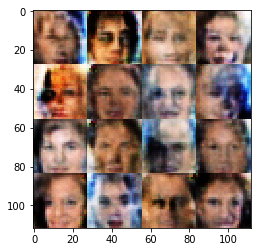

Epoch 1/1... Discriminator Loss: 0.7970... Generator Loss: 1.0132
Epoch 1/1... Discriminator Loss: 0.9495... Generator Loss: 0.9725
Epoch 1/1... Discriminator Loss: 1.0692... Generator Loss: 0.6240
Epoch 1/1... Discriminator Loss: 1.2953... Generator Loss: 1.8655
Epoch 1/1... Discriminator Loss: 0.9725... Generator Loss: 0.6363
Epoch 1/1... Discriminator Loss: 1.5530... Generator Loss: 1.5413
Epoch 1/1... Discriminator Loss: 0.9985... Generator Loss: 0.8994
Epoch 1/1... Discriminator Loss: 1.5441... Generator Loss: 0.4757
Epoch 1/1... Discriminator Loss: 1.4706... Generator Loss: 0.8839
Epoch 1/1... Discriminator Loss: 1.5436... Generator Loss: 0.6026


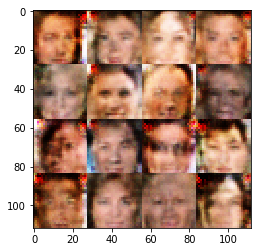

Epoch 1/1... Discriminator Loss: 0.8268... Generator Loss: 1.5714
Epoch 1/1... Discriminator Loss: 0.6435... Generator Loss: 1.2275
Epoch 1/1... Discriminator Loss: 0.8572... Generator Loss: 0.9185
Epoch 1/1... Discriminator Loss: 0.8557... Generator Loss: 1.4886
Epoch 1/1... Discriminator Loss: 1.1723... Generator Loss: 0.5409
Epoch 1/1... Discriminator Loss: 0.8784... Generator Loss: 1.3274
Epoch 1/1... Discriminator Loss: 0.9959... Generator Loss: 1.0246
Epoch 1/1... Discriminator Loss: 1.2035... Generator Loss: 0.4907
Epoch 1/1... Discriminator Loss: 1.3030... Generator Loss: 2.3638
Epoch 1/1... Discriminator Loss: 1.0221... Generator Loss: 0.7921


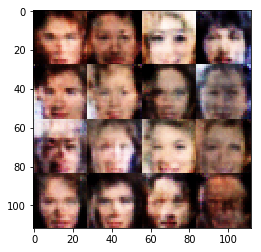

Epoch 1/1... Discriminator Loss: 1.0852... Generator Loss: 0.6387
Epoch 1/1... Discriminator Loss: 0.9914... Generator Loss: 1.0100
Epoch 1/1... Discriminator Loss: 1.1579... Generator Loss: 1.0000
Epoch 1/1... Discriminator Loss: 1.1610... Generator Loss: 0.7565
Epoch 1/1... Discriminator Loss: 0.8300... Generator Loss: 1.0104
Epoch 1/1... Discriminator Loss: 0.8154... Generator Loss: 1.6676
Epoch 1/1... Discriminator Loss: 2.0873... Generator Loss: 0.1702
Epoch 1/1... Discriminator Loss: 1.6195... Generator Loss: 4.5539
Epoch 1/1... Discriminator Loss: 1.0064... Generator Loss: 0.7572
Epoch 1/1... Discriminator Loss: 0.6746... Generator Loss: 1.1927


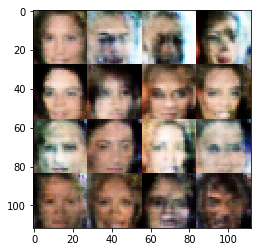

Epoch 1/1... Discriminator Loss: 0.8209... Generator Loss: 1.1553
Epoch 1/1... Discriminator Loss: 1.0215... Generator Loss: 1.0579
Epoch 1/1... Discriminator Loss: 1.0833... Generator Loss: 1.2585
Epoch 1/1... Discriminator Loss: 1.1720... Generator Loss: 0.6651
Epoch 1/1... Discriminator Loss: 1.1423... Generator Loss: 1.2593
Epoch 1/1... Discriminator Loss: 1.3381... Generator Loss: 0.4296
Epoch 1/1... Discriminator Loss: 1.1822... Generator Loss: 1.1901
Epoch 1/1... Discriminator Loss: 1.2352... Generator Loss: 0.5713
Epoch 1/1... Discriminator Loss: 1.0904... Generator Loss: 1.2361
Epoch 1/1... Discriminator Loss: 1.0010... Generator Loss: 0.9459


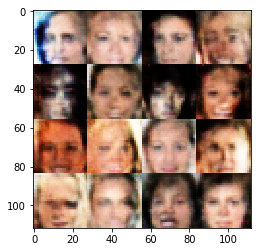

Epoch 1/1... Discriminator Loss: 1.3976... Generator Loss: 0.4485
Epoch 1/1... Discriminator Loss: 1.4408... Generator Loss: 1.3286
Epoch 1/1... Discriminator Loss: 1.6313... Generator Loss: 0.3235
Epoch 1/1... Discriminator Loss: 1.1302... Generator Loss: 1.3413
Epoch 1/1... Discriminator Loss: 0.9942... Generator Loss: 0.9288
Epoch 1/1... Discriminator Loss: 0.5998... Generator Loss: 2.1539
Epoch 1/1... Discriminator Loss: 1.7850... Generator Loss: 0.2655
Epoch 1/1... Discriminator Loss: 1.3050... Generator Loss: 2.0281
Epoch 1/1... Discriminator Loss: 1.8132... Generator Loss: 0.2138
Epoch 1/1... Discriminator Loss: 1.1002... Generator Loss: 1.4652


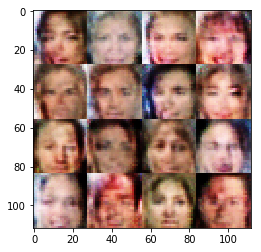

Epoch 1/1... Discriminator Loss: 1.1180... Generator Loss: 0.8601
Epoch 1/1... Discriminator Loss: 0.9722... Generator Loss: 0.7916
Epoch 1/1... Discriminator Loss: 0.5739... Generator Loss: 2.2435
Epoch 1/1... Discriminator Loss: 1.2779... Generator Loss: 0.4569
Epoch 1/1... Discriminator Loss: 1.1930... Generator Loss: 1.1700
Epoch 1/1... Discriminator Loss: 1.0189... Generator Loss: 0.6998
Epoch 1/1... Discriminator Loss: 0.5177... Generator Loss: 2.2146
Epoch 1/1... Discriminator Loss: 0.4891... Generator Loss: 1.5989
Epoch 1/1... Discriminator Loss: 0.6621... Generator Loss: 0.9758
Epoch 1/1... Discriminator Loss: 0.9294... Generator Loss: 1.3427


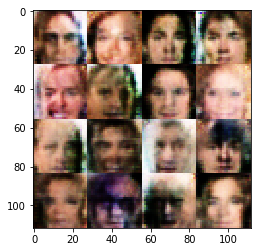

Epoch 1/1... Discriminator Loss: 1.0094... Generator Loss: 0.7757
Epoch 1/1... Discriminator Loss: 1.1356... Generator Loss: 1.2028
Epoch 1/1... Discriminator Loss: 1.3183... Generator Loss: 0.4145
Epoch 1/1... Discriminator Loss: 1.5505... Generator Loss: 1.9713
Epoch 1/1... Discriminator Loss: 1.3302... Generator Loss: 0.4469
Epoch 1/1... Discriminator Loss: 0.9264... Generator Loss: 1.2139
Epoch 1/1... Discriminator Loss: 0.9839... Generator Loss: 0.9447
Epoch 1/1... Discriminator Loss: 1.0530... Generator Loss: 0.7156
Epoch 1/1... Discriminator Loss: 0.9277... Generator Loss: 1.7364
Epoch 1/1... Discriminator Loss: 0.6408... Generator Loss: 1.3325


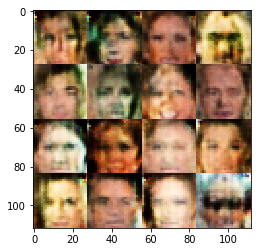

Epoch 1/1... Discriminator Loss: 1.3388... Generator Loss: 0.4066
Epoch 1/1... Discriminator Loss: 1.3862... Generator Loss: 2.4915
Epoch 1/1... Discriminator Loss: 0.5267... Generator Loss: 1.2958
Epoch 1/1... Discriminator Loss: 1.1985... Generator Loss: 0.4700
Epoch 1/1... Discriminator Loss: 1.3235... Generator Loss: 2.1180
Epoch 1/1... Discriminator Loss: 1.0316... Generator Loss: 0.8216
Epoch 1/1... Discriminator Loss: 1.1487... Generator Loss: 0.5327
Epoch 1/1... Discriminator Loss: 1.1261... Generator Loss: 1.2238
Epoch 1/1... Discriminator Loss: 1.1381... Generator Loss: 0.8106
Epoch 1/1... Discriminator Loss: 0.7875... Generator Loss: 0.9984


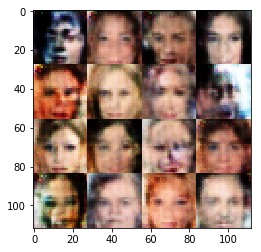

Epoch 1/1... Discriminator Loss: 1.0991... Generator Loss: 0.7264
Epoch 1/1... Discriminator Loss: 0.9738... Generator Loss: 1.4380
Epoch 1/1... Discriminator Loss: 0.8231... Generator Loss: 0.9523
Epoch 1/1... Discriminator Loss: 0.6876... Generator Loss: 1.2552
Epoch 1/1... Discriminator Loss: 0.9285... Generator Loss: 0.7642
Epoch 1/1... Discriminator Loss: 0.9438... Generator Loss: 2.7027
Epoch 1/1... Discriminator Loss: 0.7865... Generator Loss: 1.1717
Epoch 1/1... Discriminator Loss: 2.0233... Generator Loss: 0.1697
Epoch 1/1... Discriminator Loss: 2.8876... Generator Loss: 2.8964
Epoch 1/1... Discriminator Loss: 1.1697... Generator Loss: 1.1077


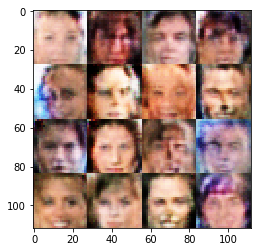

Epoch 1/1... Discriminator Loss: 1.6724... Generator Loss: 0.2895
Epoch 1/1... Discriminator Loss: 1.2629... Generator Loss: 1.2426
Epoch 1/1... Discriminator Loss: 0.5481... Generator Loss: 2.5206
Epoch 1/1... Discriminator Loss: 0.4421... Generator Loss: 1.3992
Epoch 1/1... Discriminator Loss: 1.4443... Generator Loss: 0.3431
Epoch 1/1... Discriminator Loss: 1.2731... Generator Loss: 1.3908
Epoch 1/1... Discriminator Loss: 0.7696... Generator Loss: 1.1767
Epoch 1/1... Discriminator Loss: 1.2837... Generator Loss: 0.5118
Epoch 1/1... Discriminator Loss: 1.1090... Generator Loss: 1.4413
Epoch 1/1... Discriminator Loss: 1.4582... Generator Loss: 0.4824


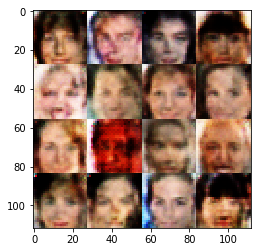

Epoch 1/1... Discriminator Loss: 1.0080... Generator Loss: 1.0767
Epoch 1/1... Discriminator Loss: 0.8945... Generator Loss: 0.8768
Epoch 1/1... Discriminator Loss: 1.0336... Generator Loss: 0.8053
Epoch 1/1... Discriminator Loss: 1.0794... Generator Loss: 0.9943
Epoch 1/1... Discriminator Loss: 1.1142... Generator Loss: 0.6588
Epoch 1/1... Discriminator Loss: 1.0438... Generator Loss: 1.3289
Epoch 1/1... Discriminator Loss: 0.8873... Generator Loss: 0.7827
Epoch 1/1... Discriminator Loss: 0.5830... Generator Loss: 1.7453
Epoch 1/1... Discriminator Loss: 1.0308... Generator Loss: 0.6925
Epoch 1/1... Discriminator Loss: 0.7298... Generator Loss: 2.0280


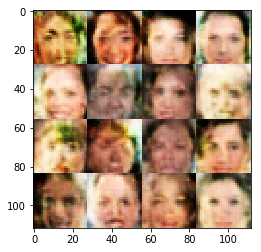

Epoch 1/1... Discriminator Loss: 0.5506... Generator Loss: 1.3581
Epoch 1/1... Discriminator Loss: 1.3964... Generator Loss: 0.4299
Epoch 1/1... Discriminator Loss: 1.3729... Generator Loss: 1.9472
Epoch 1/1... Discriminator Loss: 1.1930... Generator Loss: 0.4638
Epoch 1/1... Discriminator Loss: 0.9067... Generator Loss: 1.4338
Epoch 1/1... Discriminator Loss: 1.2131... Generator Loss: 1.1889
Epoch 1/1... Discriminator Loss: 1.5280... Generator Loss: 0.3297
Epoch 1/1... Discriminator Loss: 1.4059... Generator Loss: 0.9548
Epoch 1/1... Discriminator Loss: 1.0770... Generator Loss: 0.9458
Epoch 1/1... Discriminator Loss: 1.3610... Generator Loss: 0.4657


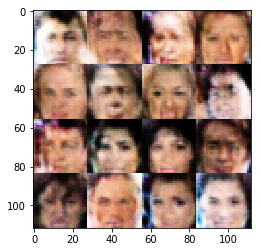

Epoch 1/1... Discriminator Loss: 1.4230... Generator Loss: 1.7765
Epoch 1/1... Discriminator Loss: 0.8335... Generator Loss: 0.9122
Epoch 1/1... Discriminator Loss: 0.4281... Generator Loss: 1.6346
Epoch 1/1... Discriminator Loss: 1.6316... Generator Loss: 1.7129
Epoch 1/1... Discriminator Loss: 1.7424... Generator Loss: 0.2491
Epoch 1/1... Discriminator Loss: 1.9505... Generator Loss: 2.4771
Epoch 1/1... Discriminator Loss: 1.2124... Generator Loss: 0.7109
Epoch 1/1... Discriminator Loss: 1.4076... Generator Loss: 0.4190
Epoch 1/1... Discriminator Loss: 1.2096... Generator Loss: 0.9021
Epoch 1/1... Discriminator Loss: 1.3259... Generator Loss: 0.9256


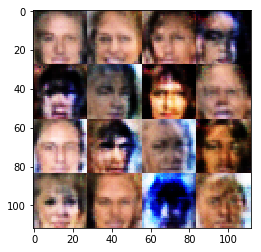

Epoch 1/1... Discriminator Loss: 1.2522... Generator Loss: 0.7099
Epoch 1/1... Discriminator Loss: 1.3513... Generator Loss: 0.5426
Epoch 1/1... Discriminator Loss: 0.9019... Generator Loss: 0.9675
Epoch 1/1... Discriminator Loss: 0.2611... Generator Loss: 3.1193
Epoch 1/1... Discriminator Loss: 0.8215... Generator Loss: 0.7060
Epoch 1/1... Discriminator Loss: 1.4102... Generator Loss: 0.4138
Epoch 1/1... Discriminator Loss: 1.3757... Generator Loss: 3.3511
Epoch 1/1... Discriminator Loss: 0.9940... Generator Loss: 1.0550
Epoch 1/1... Discriminator Loss: 1.6444... Generator Loss: 0.3451
Epoch 1/1... Discriminator Loss: 1.6447... Generator Loss: 1.4202


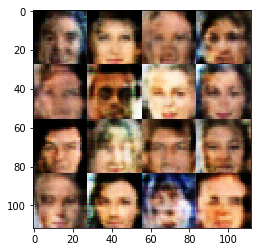

Epoch 1/1... Discriminator Loss: 1.0540... Generator Loss: 0.8480
Epoch 1/1... Discriminator Loss: 1.1368... Generator Loss: 0.9477
Epoch 1/1... Discriminator Loss: 1.0735... Generator Loss: 1.1441
Epoch 1/1... Discriminator Loss: 0.9900... Generator Loss: 1.2115
Epoch 1/1... Discriminator Loss: 1.0341... Generator Loss: 0.6061
Epoch 1/1... Discriminator Loss: 1.2025... Generator Loss: 1.1994
Epoch 1/1... Discriminator Loss: 0.8425... Generator Loss: 1.1175
Epoch 1/1... Discriminator Loss: 0.5881... Generator Loss: 1.2423
Epoch 1/1... Discriminator Loss: 1.0746... Generator Loss: 0.6637
Epoch 1/1... Discriminator Loss: 1.3383... Generator Loss: 1.6852


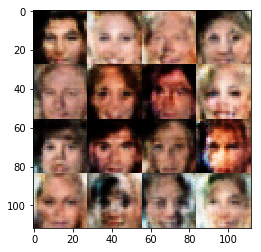

Epoch 1/1... Discriminator Loss: 1.0938... Generator Loss: 0.6416
Epoch 1/1... Discriminator Loss: 1.1527... Generator Loss: 0.6968
Epoch 1/1... Discriminator Loss: 1.0591... Generator Loss: 1.0448
Epoch 1/1... Discriminator Loss: 1.4132... Generator Loss: 0.4353
Epoch 1/1... Discriminator Loss: 1.1189... Generator Loss: 1.8155
Epoch 1/1... Discriminator Loss: 1.3885... Generator Loss: 0.4002
Epoch 1/1... Discriminator Loss: 0.8855... Generator Loss: 1.9492
Epoch 1/1... Discriminator Loss: 0.3304... Generator Loss: 2.6492
Epoch 1/1... Discriminator Loss: 1.1775... Generator Loss: 0.5109
Epoch 1/1... Discriminator Loss: 1.2110... Generator Loss: 1.6159


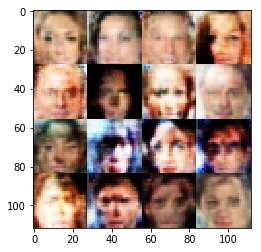

Epoch 1/1... Discriminator Loss: 0.6882... Generator Loss: 1.1785
Epoch 1/1... Discriminator Loss: 1.0481... Generator Loss: 0.6609
Epoch 1/1... Discriminator Loss: 0.9429... Generator Loss: 1.2871
Epoch 1/1... Discriminator Loss: 1.0256... Generator Loss: 0.7874
Epoch 1/1... Discriminator Loss: 1.0483... Generator Loss: 1.3934
Epoch 1/1... Discriminator Loss: 1.1997... Generator Loss: 0.4641
Epoch 1/1... Discriminator Loss: 1.0713... Generator Loss: 1.1906
Epoch 1/1... Discriminator Loss: 1.0850... Generator Loss: 0.8272
Epoch 1/1... Discriminator Loss: 0.6045... Generator Loss: 1.4114
Epoch 1/1... Discriminator Loss: 0.5436... Generator Loss: 1.3035


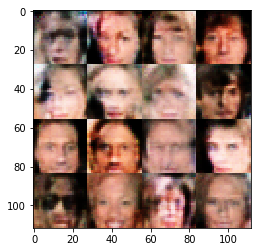

Epoch 1/1... Discriminator Loss: 0.4922... Generator Loss: 2.1977
Epoch 1/1... Discriminator Loss: 0.8610... Generator Loss: 0.9251
Epoch 1/1... Discriminator Loss: 1.2177... Generator Loss: 0.5394
Epoch 1/1... Discriminator Loss: 1.5106... Generator Loss: 1.7665
Epoch 1/1... Discriminator Loss: 1.7109... Generator Loss: 0.2332
Epoch 1/1... Discriminator Loss: 1.3346... Generator Loss: 2.3432
Epoch 1/1... Discriminator Loss: 0.9371... Generator Loss: 1.1862
Epoch 1/1... Discriminator Loss: 1.1891... Generator Loss: 0.4819
Epoch 1/1... Discriminator Loss: 0.7258... Generator Loss: 2.0743
Epoch 1/1... Discriminator Loss: 1.1539... Generator Loss: 0.6112


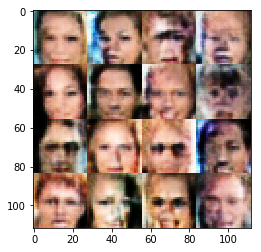

Epoch 1/1... Discriminator Loss: 0.8956... Generator Loss: 1.0496
Epoch 1/1... Discriminator Loss: 1.0498... Generator Loss: 0.8044
Epoch 1/1... Discriminator Loss: 0.7733... Generator Loss: 1.3643
Epoch 1/1... Discriminator Loss: 1.1123... Generator Loss: 0.5827
Epoch 1/1... Discriminator Loss: 0.9174... Generator Loss: 2.3620
Epoch 1/1... Discriminator Loss: 1.1394... Generator Loss: 0.9289
Epoch 1/1... Discriminator Loss: 1.6936... Generator Loss: 0.2453
Epoch 1/1... Discriminator Loss: 2.5800... Generator Loss: 2.6230
Epoch 1/1... Discriminator Loss: 1.1143... Generator Loss: 0.9902
Epoch 1/1... Discriminator Loss: 1.6328... Generator Loss: 0.3120


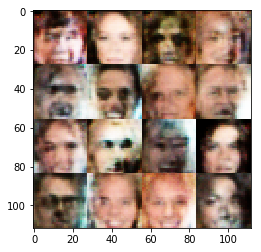

Epoch 1/1... Discriminator Loss: 1.1727... Generator Loss: 0.9756
Epoch 1/1... Discriminator Loss: 0.9145... Generator Loss: 2.5058
Epoch 1/1... Discriminator Loss: 0.7969... Generator Loss: 1.0763
Epoch 1/1... Discriminator Loss: 1.1317... Generator Loss: 0.5339
Epoch 1/1... Discriminator Loss: 0.8672... Generator Loss: 1.3056
Epoch 1/1... Discriminator Loss: 0.7322... Generator Loss: 1.8549
Epoch 1/1... Discriminator Loss: 0.5365... Generator Loss: 1.1688
Epoch 1/1... Discriminator Loss: 1.0331... Generator Loss: 0.5985
Epoch 1/1... Discriminator Loss: 1.3916... Generator Loss: 2.0842
Epoch 1/1... Discriminator Loss: 1.2859... Generator Loss: 0.7191


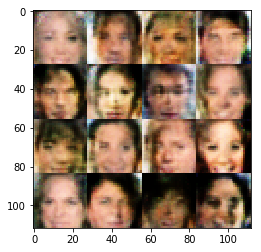

Epoch 1/1... Discriminator Loss: 1.4644... Generator Loss: 0.3627
Epoch 1/1... Discriminator Loss: 1.3999... Generator Loss: 1.7333
Epoch 1/1... Discriminator Loss: 1.1549... Generator Loss: 1.0436
Epoch 1/1... Discriminator Loss: 1.0891... Generator Loss: 0.6008
Epoch 1/1... Discriminator Loss: 1.1712... Generator Loss: 0.7797
Epoch 1/1... Discriminator Loss: 1.0417... Generator Loss: 1.3795
Epoch 1/1... Discriminator Loss: 1.4104... Generator Loss: 0.4873
Epoch 1/1... Discriminator Loss: 1.3870... Generator Loss: 0.5657
Epoch 1/1... Discriminator Loss: 1.3703... Generator Loss: 1.3706
Epoch 1/1... Discriminator Loss: 1.3782... Generator Loss: 0.5569


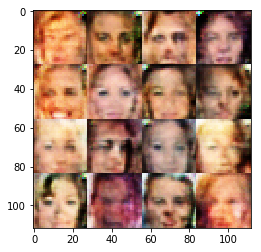

Epoch 1/1... Discriminator Loss: 0.3971... Generator Loss: 3.5778
Epoch 1/1... Discriminator Loss: 0.9500... Generator Loss: 0.8380
Epoch 1/1... Discriminator Loss: 0.5297... Generator Loss: 1.3363
Epoch 1/1... Discriminator Loss: 0.7135... Generator Loss: 1.2771
Epoch 1/1... Discriminator Loss: 0.7195... Generator Loss: 1.4097
Epoch 1/1... Discriminator Loss: 0.6486... Generator Loss: 1.3450
Epoch 1/1... Discriminator Loss: 0.3617... Generator Loss: 2.5536
Epoch 1/1... Discriminator Loss: 0.3078... Generator Loss: 2.4504
Epoch 1/1... Discriminator Loss: 1.3338... Generator Loss: 0.4024
Epoch 1/1... Discriminator Loss: 1.5456... Generator Loss: 2.8545


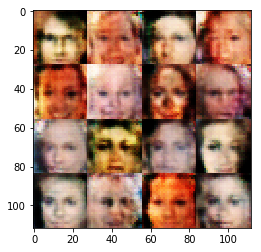

Epoch 1/1... Discriminator Loss: 0.6472... Generator Loss: 1.8380
Epoch 1/1... Discriminator Loss: 1.3987... Generator Loss: 0.3317
Epoch 1/1... Discriminator Loss: 1.5586... Generator Loss: 2.3836
Epoch 1/1... Discriminator Loss: 0.7624... Generator Loss: 1.0727
Epoch 1/1... Discriminator Loss: 0.9601... Generator Loss: 0.6959
Epoch 1/1... Discriminator Loss: 0.7931... Generator Loss: 1.6431
Epoch 1/1... Discriminator Loss: 0.6512... Generator Loss: 1.2489
Epoch 1/1... Discriminator Loss: 1.0090... Generator Loss: 0.6403
Epoch 1/1... Discriminator Loss: 0.8873... Generator Loss: 1.4668
Epoch 1/1... Discriminator Loss: 0.7510... Generator Loss: 1.0807


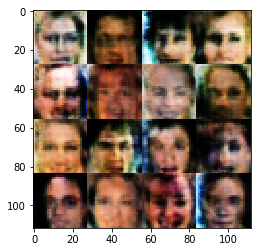

Epoch 1/1... Discriminator Loss: 1.2720... Generator Loss: 0.4252
Epoch 1/1... Discriminator Loss: 1.4340... Generator Loss: 1.9624
Epoch 1/1... Discriminator Loss: 1.0214... Generator Loss: 0.6776
Epoch 1/1... Discriminator Loss: 0.9916... Generator Loss: 0.7494
Epoch 1/1... Discriminator Loss: 1.1320... Generator Loss: 1.4028
Epoch 1/1... Discriminator Loss: 1.0249... Generator Loss: 0.7025
Epoch 1/1... Discriminator Loss: 0.9035... Generator Loss: 1.2073
Epoch 1/1... Discriminator Loss: 0.7509... Generator Loss: 1.4389
Epoch 1/1... Discriminator Loss: 1.0632... Generator Loss: 0.5980
Epoch 1/1... Discriminator Loss: 1.1749... Generator Loss: 1.2803


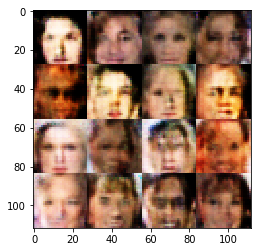

Epoch 1/1... Discriminator Loss: 0.7348... Generator Loss: 0.8640
Epoch 1/1... Discriminator Loss: 1.1798... Generator Loss: 1.0658
Epoch 1/1... Discriminator Loss: 0.9316... Generator Loss: 1.2212
Epoch 1/1... Discriminator Loss: 1.6962... Generator Loss: 0.2578
Epoch 1/1... Discriminator Loss: 1.7758... Generator Loss: 1.8020
Epoch 1/1... Discriminator Loss: 1.0885... Generator Loss: 0.6188
Epoch 1/1... Discriminator Loss: 0.9185... Generator Loss: 1.0675
Epoch 1/1... Discriminator Loss: 0.8297... Generator Loss: 1.2890
Epoch 1/1... Discriminator Loss: 1.3391... Generator Loss: 0.5330
Epoch 1/1... Discriminator Loss: 0.8797... Generator Loss: 1.4813


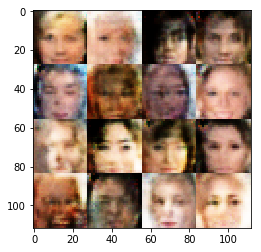

Epoch 1/1... Discriminator Loss: 0.8600... Generator Loss: 0.7901
Epoch 1/1... Discriminator Loss: 0.9935... Generator Loss: 0.9713
Epoch 1/1... Discriminator Loss: 0.7944... Generator Loss: 1.1706
Epoch 1/1... Discriminator Loss: 0.5915... Generator Loss: 1.4168
Epoch 1/1... Discriminator Loss: 0.7155... Generator Loss: 0.9119
Epoch 1/1... Discriminator Loss: 0.7007... Generator Loss: 1.3600
Epoch 1/1... Discriminator Loss: 1.4259... Generator Loss: 1.2139
Epoch 1/1... Discriminator Loss: 1.7375... Generator Loss: 0.2412
Epoch 1/1... Discriminator Loss: 1.8708... Generator Loss: 2.0705
Epoch 1/1... Discriminator Loss: 1.0740... Generator Loss: 0.6104


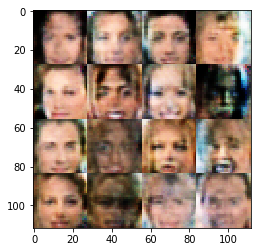

Epoch 1/1... Discriminator Loss: 0.9999... Generator Loss: 0.8545
Epoch 1/1... Discriminator Loss: 1.1776... Generator Loss: 0.7189
Epoch 1/1... Discriminator Loss: 0.9762... Generator Loss: 1.0676
Epoch 1/1... Discriminator Loss: 1.4738... Generator Loss: 0.3443
Epoch 1/1... Discriminator Loss: 1.1645... Generator Loss: 2.0426
Epoch 1/1... Discriminator Loss: 0.5470... Generator Loss: 1.5636
Epoch 1/1... Discriminator Loss: 1.5733... Generator Loss: 0.3016
Epoch 1/1... Discriminator Loss: 1.3841... Generator Loss: 2.4327
Epoch 1/1... Discriminator Loss: 0.9852... Generator Loss: 0.7587
Epoch 1/1... Discriminator Loss: 0.8535... Generator Loss: 0.9726


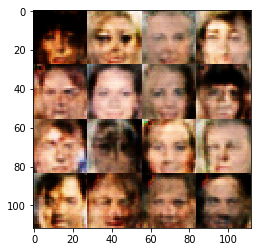

Epoch 1/1... Discriminator Loss: 1.0550... Generator Loss: 0.7826
Epoch 1/1... Discriminator Loss: 1.0704... Generator Loss: 0.9808
Epoch 1/1... Discriminator Loss: 0.7577... Generator Loss: 1.1943
Epoch 1/1... Discriminator Loss: 0.3948... Generator Loss: 2.6346
Epoch 1/1... Discriminator Loss: 2.3269... Generator Loss: 0.1290
Epoch 1/1... Discriminator Loss: 3.9794... Generator Loss: 4.3580
Epoch 1/1... Discriminator Loss: 1.5831... Generator Loss: 0.9600
Epoch 1/1... Discriminator Loss: 1.2343... Generator Loss: 0.4718
Epoch 1/1... Discriminator Loss: 1.0827... Generator Loss: 1.5123
Epoch 1/1... Discriminator Loss: 1.0940... Generator Loss: 0.9830


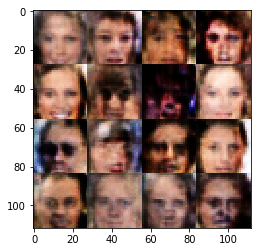

Epoch 1/1... Discriminator Loss: 1.1811... Generator Loss: 0.5211
Epoch 1/1... Discriminator Loss: 1.1663... Generator Loss: 0.9505
Epoch 1/1... Discriminator Loss: 1.1900... Generator Loss: 0.8748
Epoch 1/1... Discriminator Loss: 1.1624... Generator Loss: 0.7088
Epoch 1/1... Discriminator Loss: 1.1907... Generator Loss: 0.9004
Epoch 1/1... Discriminator Loss: 1.2303... Generator Loss: 0.6782
Epoch 1/1... Discriminator Loss: 1.2947... Generator Loss: 0.7231
Epoch 1/1... Discriminator Loss: 1.1763... Generator Loss: 0.8476
Epoch 1/1... Discriminator Loss: 1.4064... Generator Loss: 0.6089
Epoch 1/1... Discriminator Loss: 1.1374... Generator Loss: 1.1417


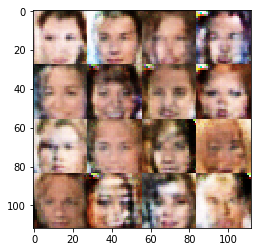

Epoch 1/1... Discriminator Loss: 0.5385... Generator Loss: 2.0672
Epoch 1/1... Discriminator Loss: 1.3526... Generator Loss: 0.4133
Epoch 1/1... Discriminator Loss: 1.2520... Generator Loss: 0.9364
Epoch 1/1... Discriminator Loss: 1.3247... Generator Loss: 1.3896
Epoch 1/1... Discriminator Loss: 1.3010... Generator Loss: 0.4433
Epoch 1/1... Discriminator Loss: 1.2057... Generator Loss: 0.9717
Epoch 1/1... Discriminator Loss: 1.1401... Generator Loss: 0.8374
Epoch 1/1... Discriminator Loss: 1.3914... Generator Loss: 0.4893
Epoch 1/1... Discriminator Loss: 1.1715... Generator Loss: 0.8360
Epoch 1/1... Discriminator Loss: 1.2883... Generator Loss: 0.6024


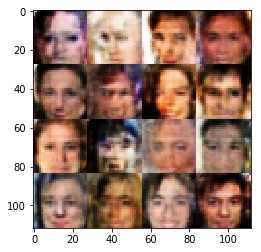

Epoch 1/1... Discriminator Loss: 0.9840... Generator Loss: 1.1480
Epoch 1/1... Discriminator Loss: 1.6204... Generator Loss: 0.4075
Epoch 1/1... Discriminator Loss: 1.0555... Generator Loss: 1.2716
Epoch 1/1... Discriminator Loss: 0.9059... Generator Loss: 1.5288
Epoch 1/1... Discriminator Loss: 0.3616... Generator Loss: 2.8173
Epoch 1/1... Discriminator Loss: 2.4309... Generator Loss: 0.1278
Epoch 1/1... Discriminator Loss: 0.8556... Generator Loss: 1.0911
Epoch 1/1... Discriminator Loss: 1.1464... Generator Loss: 1.4526
Epoch 1/1... Discriminator Loss: 1.2926... Generator Loss: 0.4820
Epoch 1/1... Discriminator Loss: 1.6232... Generator Loss: 0.3299


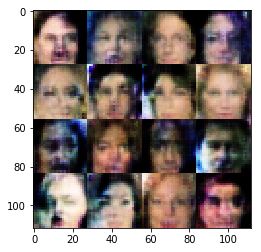

Epoch 1/1... Discriminator Loss: 0.8191... Generator Loss: 1.7586
Epoch 1/1... Discriminator Loss: 1.0782... Generator Loss: 0.9892
Epoch 1/1... Discriminator Loss: 0.9656... Generator Loss: 0.8420
Epoch 1/1... Discriminator Loss: 0.8750... Generator Loss: 1.2223
Epoch 1/1... Discriminator Loss: 1.0874... Generator Loss: 0.6693
Epoch 1/1... Discriminator Loss: 0.9754... Generator Loss: 0.9407
Epoch 1/1... Discriminator Loss: 0.8781... Generator Loss: 1.1477
Epoch 1/1... Discriminator Loss: 0.9092... Generator Loss: 0.8780
Epoch 1/1... Discriminator Loss: 0.8210... Generator Loss: 1.7728
Epoch 1/1... Discriminator Loss: 1.3151... Generator Loss: 0.4213


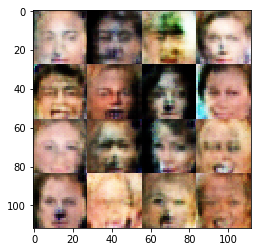

Epoch 1/1... Discriminator Loss: 1.6634... Generator Loss: 2.6379
Epoch 1/1... Discriminator Loss: 1.2468... Generator Loss: 0.4408
Epoch 1/1... Discriminator Loss: 1.0224... Generator Loss: 0.9733
Epoch 1/1... Discriminator Loss: 1.2657... Generator Loss: 0.8763
Epoch 1/1... Discriminator Loss: 1.2600... Generator Loss: 0.5672
Epoch 1/1... Discriminator Loss: 1.1826... Generator Loss: 1.0453
Epoch 1/1... Discriminator Loss: 1.2987... Generator Loss: 0.5656
Epoch 1/1... Discriminator Loss: 1.1232... Generator Loss: 1.1047
Epoch 1/1... Discriminator Loss: 1.0316... Generator Loss: 0.9187
Epoch 1/1... Discriminator Loss: 0.7064... Generator Loss: 1.1757


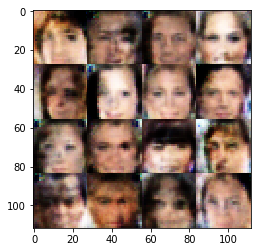

Epoch 1/1... Discriminator Loss: 0.7381... Generator Loss: 1.0975
Epoch 1/1... Discriminator Loss: 1.2733... Generator Loss: 0.4519
Epoch 1/1... Discriminator Loss: 1.5783... Generator Loss: 2.1921
Epoch 1/1... Discriminator Loss: 0.7372... Generator Loss: 0.9943
Epoch 1/1... Discriminator Loss: 1.5534... Generator Loss: 0.3169
Epoch 1/1... Discriminator Loss: 1.2141... Generator Loss: 2.4268
Epoch 1/1... Discriminator Loss: 0.8905... Generator Loss: 0.8888
Epoch 1/1... Discriminator Loss: 0.8223... Generator Loss: 0.8627
Epoch 1/1... Discriminator Loss: 0.9174... Generator Loss: 1.2597
Epoch 1/1... Discriminator Loss: 0.9276... Generator Loss: 0.7571


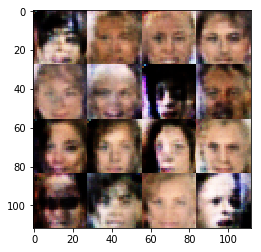

Epoch 1/1... Discriminator Loss: 0.9014... Generator Loss: 1.1068
Epoch 1/1... Discriminator Loss: 0.9731... Generator Loss: 1.0312
Epoch 1/1... Discriminator Loss: 0.9815... Generator Loss: 0.7142
Epoch 1/1... Discriminator Loss: 0.8266... Generator Loss: 1.0993
Epoch 1/1... Discriminator Loss: 0.7352... Generator Loss: 1.6382
Epoch 1/1... Discriminator Loss: 0.9929... Generator Loss: 0.7176
Epoch 1/1... Discriminator Loss: 0.5725... Generator Loss: 2.3490
Epoch 1/1... Discriminator Loss: 1.0000... Generator Loss: 0.6184
Epoch 1/1... Discriminator Loss: 1.2763... Generator Loss: 1.8004
Epoch 1/1... Discriminator Loss: 1.4995... Generator Loss: 0.3386


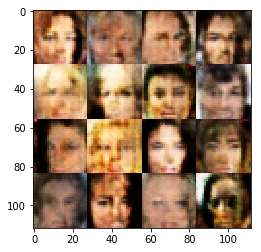

Epoch 1/1... Discriminator Loss: 1.9503... Generator Loss: 2.2952
Epoch 1/1... Discriminator Loss: 1.2860... Generator Loss: 0.4500
Epoch 1/1... Discriminator Loss: 1.3321... Generator Loss: 1.6506
Epoch 1/1... Discriminator Loss: 1.2161... Generator Loss: 0.5931
Epoch 1/1... Discriminator Loss: 1.2248... Generator Loss: 0.6934
Epoch 1/1... Discriminator Loss: 0.9428... Generator Loss: 1.1149
Epoch 1/1... Discriminator Loss: 1.5282... Generator Loss: 0.4329
Epoch 1/1... Discriminator Loss: 1.1799... Generator Loss: 0.8189
Epoch 1/1... Discriminator Loss: 1.0430... Generator Loss: 0.9271
Epoch 1/1... Discriminator Loss: 0.6334... Generator Loss: 1.5858


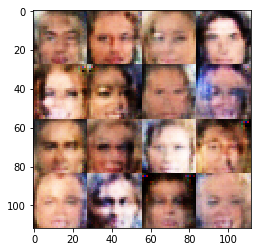

Epoch 1/1... Discriminator Loss: 1.1173... Generator Loss: 0.5241
Epoch 1/1... Discriminator Loss: 0.9140... Generator Loss: 1.7243
Epoch 1/1... Discriminator Loss: 0.9083... Generator Loss: 0.9219
Epoch 1/1... Discriminator Loss: 1.2972... Generator Loss: 0.5190
Epoch 1/1... Discriminator Loss: 0.7909... Generator Loss: 1.4648
Epoch 1/1... Discriminator Loss: 0.9800... Generator Loss: 0.7281
Epoch 1/1... Discriminator Loss: 1.0305... Generator Loss: 1.3573
Epoch 1/1... Discriminator Loss: 1.2170... Generator Loss: 0.5025
Epoch 1/1... Discriminator Loss: 0.7288... Generator Loss: 1.2148
Epoch 1/1... Discriminator Loss: 1.2024... Generator Loss: 0.6855


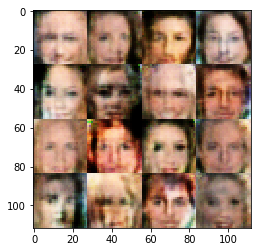

Epoch 1/1... Discriminator Loss: 0.9924... Generator Loss: 1.8033
Epoch 1/1... Discriminator Loss: 1.6930... Generator Loss: 0.2783
Epoch 1/1... Discriminator Loss: 1.3847... Generator Loss: 1.1961
Epoch 1/1... Discriminator Loss: 1.3175... Generator Loss: 0.6847
Epoch 1/1... Discriminator Loss: 1.0782... Generator Loss: 0.8197
Epoch 1/1... Discriminator Loss: 1.2603... Generator Loss: 0.7805
Epoch 1/1... Discriminator Loss: 0.8934... Generator Loss: 0.9946
Epoch 1/1... Discriminator Loss: 0.8865... Generator Loss: 1.2161
Epoch 1/1... Discriminator Loss: 0.7169... Generator Loss: 1.2550
Epoch 1/1... Discriminator Loss: 0.4642... Generator Loss: 1.8912


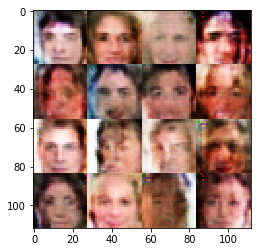

Epoch 1/1... Discriminator Loss: 1.6484... Generator Loss: 0.2787
Epoch 1/1... Discriminator Loss: 1.3824... Generator Loss: 2.9156
Epoch 1/1... Discriminator Loss: 0.9803... Generator Loss: 0.9718
Epoch 1/1... Discriminator Loss: 1.5969... Generator Loss: 0.2909
Epoch 1/1... Discriminator Loss: 1.0346... Generator Loss: 1.5211
Epoch 1/1... Discriminator Loss: 0.8429... Generator Loss: 1.0564
Epoch 1/1... Discriminator Loss: 1.0862... Generator Loss: 0.6820
Epoch 1/1... Discriminator Loss: 1.1087... Generator Loss: 0.8207
Epoch 1/1... Discriminator Loss: 0.7568... Generator Loss: 1.4107
Epoch 1/1... Discriminator Loss: 0.9459... Generator Loss: 0.9445


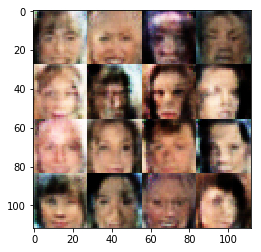

Epoch 1/1... Discriminator Loss: 1.1667... Generator Loss: 0.7529
Epoch 1/1... Discriminator Loss: 1.0230... Generator Loss: 0.8094
Epoch 1/1... Discriminator Loss: 0.5298... Generator Loss: 2.1900
Epoch 1/1... Discriminator Loss: 0.7504... Generator Loss: 0.9128
Epoch 1/1... Discriminator Loss: 1.0213... Generator Loss: 1.0054
Epoch 1/1... Discriminator Loss: 0.9619... Generator Loss: 1.1814
Epoch 1/1... Discriminator Loss: 1.3617... Generator Loss: 0.3954
Epoch 1/1... Discriminator Loss: 1.1222... Generator Loss: 2.1175
Epoch 1/1... Discriminator Loss: 1.2532... Generator Loss: 0.4440
Epoch 1/1... Discriminator Loss: 1.0981... Generator Loss: 1.4206


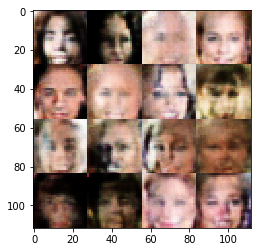

Epoch 1/1... Discriminator Loss: 1.4214... Generator Loss: 0.4208
Epoch 1/1... Discriminator Loss: 1.1273... Generator Loss: 1.7572
Epoch 1/1... Discriminator Loss: 1.0358... Generator Loss: 0.7401
Epoch 1/1... Discriminator Loss: 0.8949... Generator Loss: 0.9676
Epoch 1/1... Discriminator Loss: 1.1762... Generator Loss: 0.9817
Epoch 1/1... Discriminator Loss: 1.3613... Generator Loss: 0.4102
Epoch 1/1... Discriminator Loss: 1.2745... Generator Loss: 1.5176
Epoch 1/1... Discriminator Loss: 0.8272... Generator Loss: 0.9451
Epoch 1/1... Discriminator Loss: 0.5074... Generator Loss: 2.4692
Epoch 1/1... Discriminator Loss: 0.6005... Generator Loss: 1.1837


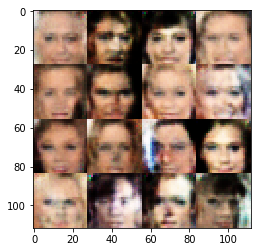

Epoch 1/1... Discriminator Loss: 0.9776... Generator Loss: 0.7917
Epoch 1/1... Discriminator Loss: 0.9924... Generator Loss: 1.9656
Epoch 1/1... Discriminator Loss: 1.0493... Generator Loss: 0.7689
Epoch 1/1... Discriminator Loss: 1.3149... Generator Loss: 0.5029
Epoch 1/1... Discriminator Loss: 1.2893... Generator Loss: 1.2011
Epoch 1/1... Discriminator Loss: 0.8836... Generator Loss: 0.7052
Epoch 1/1... Discriminator Loss: 0.7033... Generator Loss: 2.1879
Epoch 1/1... Discriminator Loss: 1.4415... Generator Loss: 0.3692
Epoch 1/1... Discriminator Loss: 1.1603... Generator Loss: 1.1808
Epoch 1/1... Discriminator Loss: 0.9320... Generator Loss: 0.9471


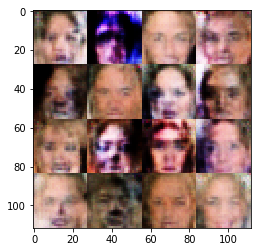

Epoch 1/1... Discriminator Loss: 0.9449... Generator Loss: 0.9128
Epoch 1/1... Discriminator Loss: 1.0365... Generator Loss: 0.8193
Epoch 1/1... Discriminator Loss: 1.0093... Generator Loss: 1.1579
Epoch 1/1... Discriminator Loss: 0.8110... Generator Loss: 1.1150
Epoch 1/1... Discriminator Loss: 0.5922... Generator Loss: 1.4388
Epoch 1/1... Discriminator Loss: 0.4212... Generator Loss: 1.7705
Epoch 1/1... Discriminator Loss: 0.9686... Generator Loss: 0.6535
Epoch 1/1... Discriminator Loss: 1.1435... Generator Loss: 2.5840
Epoch 1/1... Discriminator Loss: 0.8879... Generator Loss: 0.8109
Epoch 1/1... Discriminator Loss: 1.2393... Generator Loss: 0.5216


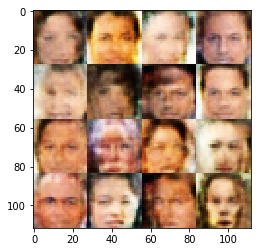

Epoch 1/1... Discriminator Loss: 1.3696... Generator Loss: 1.3384
Epoch 1/1... Discriminator Loss: 1.3980... Generator Loss: 0.3592
Epoch 1/1... Discriminator Loss: 1.7644... Generator Loss: 2.5385
Epoch 1/1... Discriminator Loss: 1.4485... Generator Loss: 0.3786
Epoch 1/1... Discriminator Loss: 0.8734... Generator Loss: 0.7827
Epoch 1/1... Discriminator Loss: 1.3049... Generator Loss: 1.8359
Epoch 1/1... Discriminator Loss: 1.3933... Generator Loss: 0.4227
Epoch 1/1... Discriminator Loss: 1.1486... Generator Loss: 1.0274
Epoch 1/1... Discriminator Loss: 1.1255... Generator Loss: 1.0605
Epoch 1/1... Discriminator Loss: 0.3097... Generator Loss: 3.0812


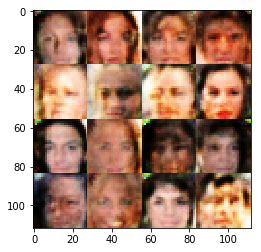

Epoch 1/1... Discriminator Loss: 0.5233... Generator Loss: 1.3629
Epoch 1/1... Discriminator Loss: 1.2373... Generator Loss: 0.4553
Epoch 1/1... Discriminator Loss: 1.1797... Generator Loss: 2.0140
Epoch 1/1... Discriminator Loss: 1.0874... Generator Loss: 0.7900
Epoch 1/1... Discriminator Loss: 1.3265... Generator Loss: 0.5064
Epoch 1/1... Discriminator Loss: 1.2508... Generator Loss: 1.2856
Epoch 1/1... Discriminator Loss: 1.1461... Generator Loss: 0.4977
Epoch 1/1... Discriminator Loss: 1.0718... Generator Loss: 1.8317
Epoch 1/1... Discriminator Loss: 1.0517... Generator Loss: 0.8021
Epoch 1/1... Discriminator Loss: 1.2599... Generator Loss: 0.5123


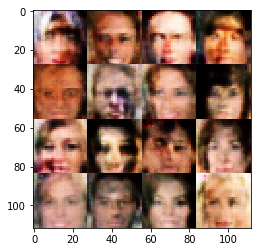

Epoch 1/1... Discriminator Loss: 1.0854... Generator Loss: 1.3110
Epoch 1/1... Discriminator Loss: 0.7215... Generator Loss: 1.0197
Epoch 1/1... Discriminator Loss: 0.9358... Generator Loss: 0.8484
Epoch 1/1... Discriminator Loss: 1.0277... Generator Loss: 0.8659
Epoch 1/1... Discriminator Loss: 0.6524... Generator Loss: 1.4269
Epoch 1/1... Discriminator Loss: 1.2003... Generator Loss: 0.5633
Epoch 1/1... Discriminator Loss: 1.1180... Generator Loss: 1.8537
Epoch 1/1... Discriminator Loss: 1.2760... Generator Loss: 0.4464
Epoch 1/1... Discriminator Loss: 1.0881... Generator Loss: 0.8611
Epoch 1/1... Discriminator Loss: 1.2969... Generator Loss: 0.9318


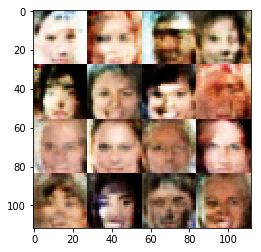

Epoch 1/1... Discriminator Loss: 0.9101... Generator Loss: 1.3757
Epoch 1/1... Discriminator Loss: 1.1577... Generator Loss: 0.5164
Epoch 1/1... Discriminator Loss: 1.5653... Generator Loss: 1.7984
Epoch 1/1... Discriminator Loss: 1.3340... Generator Loss: 0.4806
Epoch 1/1... Discriminator Loss: 1.0948... Generator Loss: 0.6742
Epoch 1/1... Discriminator Loss: 1.3920... Generator Loss: 0.9677
Epoch 1/1... Discriminator Loss: 1.2776... Generator Loss: 0.5475
Epoch 1/1... Discriminator Loss: 1.0669... Generator Loss: 1.1073
Epoch 1/1... Discriminator Loss: 0.6110... Generator Loss: 1.8787
Epoch 1/1... Discriminator Loss: 1.3552... Generator Loss: 0.3838


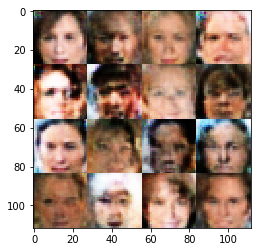

Epoch 1/1... Discriminator Loss: 1.2095... Generator Loss: 1.6881
Epoch 1/1... Discriminator Loss: 1.7501... Generator Loss: 0.2641
Epoch 1/1... Discriminator Loss: 1.3318... Generator Loss: 1.2257
Epoch 1/1... Discriminator Loss: 1.4971... Generator Loss: 0.7156
Epoch 1/1... Discriminator Loss: 1.3222... Generator Loss: 0.4936
Epoch 1/1... Discriminator Loss: 1.2956... Generator Loss: 0.7509
Epoch 1/1... Discriminator Loss: 1.1139... Generator Loss: 0.8052
Epoch 1/1... Discriminator Loss: 1.0722... Generator Loss: 0.7206
Epoch 1/1... Discriminator Loss: 0.7502... Generator Loss: 1.8616
Epoch 1/1... Discriminator Loss: 0.6374... Generator Loss: 1.2472


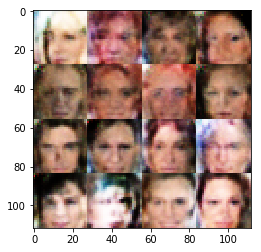

Epoch 1/1... Discriminator Loss: 1.9543... Generator Loss: 0.2137
Epoch 1/1... Discriminator Loss: 2.0259... Generator Loss: 1.6891
Epoch 1/1... Discriminator Loss: 1.2580... Generator Loss: 0.6470
Epoch 1/1... Discriminator Loss: 1.2617... Generator Loss: 0.6575
Epoch 1/1... Discriminator Loss: 1.3033... Generator Loss: 0.6794
Epoch 1/1... Discriminator Loss: 1.2606... Generator Loss: 0.7622
Epoch 1/1... Discriminator Loss: 1.1073... Generator Loss: 0.8315
Epoch 1/1... Discriminator Loss: 1.1067... Generator Loss: 0.8630
Epoch 1/1... Discriminator Loss: 0.5417... Generator Loss: 2.0862
Epoch 1/1... Discriminator Loss: 0.8372... Generator Loss: 0.8243


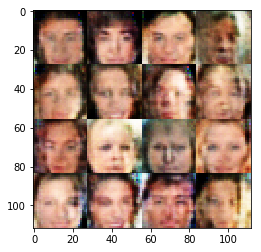

Epoch 1/1... Discriminator Loss: 0.7061... Generator Loss: 1.0251
Epoch 1/1... Discriminator Loss: 1.1003... Generator Loss: 0.9378
Epoch 1/1... Discriminator Loss: 0.6361... Generator Loss: 1.7098
Epoch 1/1... Discriminator Loss: 1.2129... Generator Loss: 0.4994
Epoch 1/1... Discriminator Loss: 1.1788... Generator Loss: 0.9769
Epoch 1/1... Discriminator Loss: 1.2192... Generator Loss: 0.5423
Epoch 1/1... Discriminator Loss: 1.0567... Generator Loss: 1.2417
Epoch 1/1... Discriminator Loss: 0.8305... Generator Loss: 0.9752
Epoch 1/1... Discriminator Loss: 1.0826... Generator Loss: 0.7731
Epoch 1/1... Discriminator Loss: 0.6927... Generator Loss: 1.6331


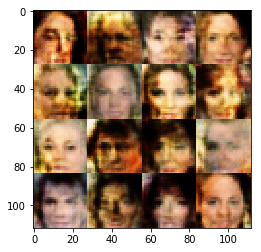

Epoch 1/1... Discriminator Loss: 0.4526... Generator Loss: 1.5450
Epoch 1/1... Discriminator Loss: 0.9317... Generator Loss: 0.7153
Epoch 1/1... Discriminator Loss: 1.2585... Generator Loss: 1.7513
Epoch 1/1... Discriminator Loss: 1.1282... Generator Loss: 0.4726
Epoch 1/1... Discriminator Loss: 0.8421... Generator Loss: 0.8139
Epoch 1/1... Discriminator Loss: 1.0057... Generator Loss: 1.3717
Epoch 1/1... Discriminator Loss: 0.8904... Generator Loss: 0.7709
Epoch 1/1... Discriminator Loss: 1.4272... Generator Loss: 1.5004
Epoch 1/1... Discriminator Loss: 1.1076... Generator Loss: 0.6551
Epoch 1/1... Discriminator Loss: 1.0226... Generator Loss: 0.7007


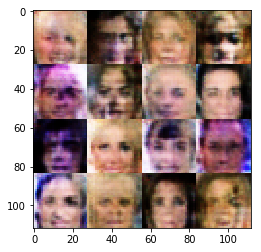

Epoch 1/1... Discriminator Loss: 0.9880... Generator Loss: 1.5831
Epoch 1/1... Discriminator Loss: 1.2835... Generator Loss: 0.4186
Epoch 1/1... Discriminator Loss: 1.4996... Generator Loss: 1.0898
Epoch 1/1... Discriminator Loss: 1.1783... Generator Loss: 0.5648
Epoch 1/1... Discriminator Loss: 1.0141... Generator Loss: 1.2566
Epoch 1/1... Discriminator Loss: 0.4303... Generator Loss: 1.9486
Epoch 1/1... Discriminator Loss: 0.5908... Generator Loss: 1.3829
Epoch 1/1... Discriminator Loss: 0.6648... Generator Loss: 1.1972
Epoch 1/1... Discriminator Loss: 0.7881... Generator Loss: 2.0901
Epoch 1/1... Discriminator Loss: 0.7842... Generator Loss: 1.1644


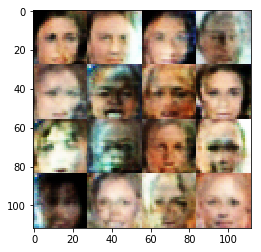

Epoch 1/1... Discriminator Loss: 1.6215... Generator Loss: 0.2831
Epoch 1/1... Discriminator Loss: 2.0134... Generator Loss: 2.1185
Epoch 1/1... Discriminator Loss: 1.3958... Generator Loss: 0.4317
Epoch 1/1... Discriminator Loss: 2.2539... Generator Loss: 2.2137
Epoch 1/1... Discriminator Loss: 1.6570... Generator Loss: 0.2941
Epoch 1/1... Discriminator Loss: 1.2878... Generator Loss: 1.0052
Epoch 1/1... Discriminator Loss: 1.1084... Generator Loss: 1.0202
Epoch 1/1... Discriminator Loss: 1.2026... Generator Loss: 0.5201
Epoch 1/1... Discriminator Loss: 0.9900... Generator Loss: 1.2943
Epoch 1/1... Discriminator Loss: 1.3007... Generator Loss: 0.5465


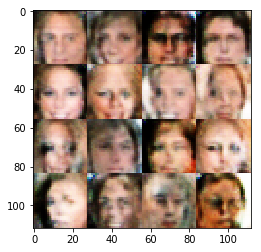

Epoch 1/1... Discriminator Loss: 1.2973... Generator Loss: 0.6748
Epoch 1/1... Discriminator Loss: 1.2507... Generator Loss: 1.4665
Epoch 1/1... Discriminator Loss: 1.0590... Generator Loss: 0.7141
Epoch 1/1... Discriminator Loss: 0.7626... Generator Loss: 1.0238
Epoch 1/1... Discriminator Loss: 1.4956... Generator Loss: 0.4534
Epoch 1/1... Discriminator Loss: 0.9641... Generator Loss: 1.6643
Epoch 1/1... Discriminator Loss: 1.7656... Generator Loss: 0.2343
Epoch 1/1... Discriminator Loss: 1.5062... Generator Loss: 1.7981
Epoch 1/1... Discriminator Loss: 1.5612... Generator Loss: 0.3876
Epoch 1/1... Discriminator Loss: 1.1420... Generator Loss: 0.7608


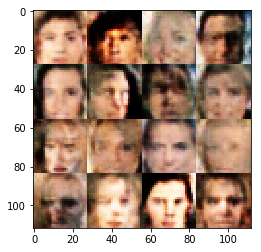

Epoch 1/1... Discriminator Loss: 0.8745... Generator Loss: 1.1926
Epoch 1/1... Discriminator Loss: 0.6810... Generator Loss: 1.4125
Epoch 1/1... Discriminator Loss: 0.8851... Generator Loss: 0.7851
Epoch 1/1... Discriminator Loss: 0.8538... Generator Loss: 1.2779
Epoch 1/1... Discriminator Loss: 1.0595... Generator Loss: 0.6082
Epoch 1/1... Discriminator Loss: 1.1085... Generator Loss: 1.0821
Epoch 1/1... Discriminator Loss: 0.5149... Generator Loss: 2.1549
Epoch 1/1... Discriminator Loss: 1.4369... Generator Loss: 0.3410
Epoch 1/1... Discriminator Loss: 1.5885... Generator Loss: 1.7268
Epoch 1/1... Discriminator Loss: 0.9174... Generator Loss: 0.7260


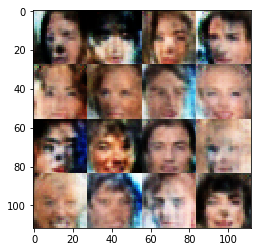

Epoch 1/1... Discriminator Loss: 0.9766... Generator Loss: 0.8134
Epoch 1/1... Discriminator Loss: 1.2650... Generator Loss: 1.7135
Epoch 1/1... Discriminator Loss: 1.0880... Generator Loss: 0.6623
Epoch 1/1... Discriminator Loss: 1.0993... Generator Loss: 0.9989
Epoch 1/1... Discriminator Loss: 1.2861... Generator Loss: 0.5769
Epoch 1/1... Discriminator Loss: 1.0440... Generator Loss: 1.0330
Epoch 1/1... Discriminator Loss: 0.6375... Generator Loss: 2.2296
Epoch 1/1... Discriminator Loss: 0.6568... Generator Loss: 1.3058
Epoch 1/1... Discriminator Loss: 0.3075... Generator Loss: 2.3919
Epoch 1/1... Discriminator Loss: 0.6955... Generator Loss: 0.9330


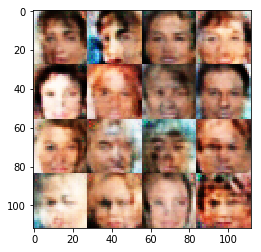

Epoch 1/1... Discriminator Loss: 0.7761... Generator Loss: 0.9051
Epoch 1/1... Discriminator Loss: 0.6233... Generator Loss: 1.2036
Epoch 1/1... Discriminator Loss: 0.7326... Generator Loss: 1.5327
Epoch 1/1... Discriminator Loss: 0.7238... Generator Loss: 1.0597
Epoch 1/1... Discriminator Loss: 0.7321... Generator Loss: 1.8286
Epoch 1/1... Discriminator Loss: 0.9967... Generator Loss: 0.6268
Epoch 1/1... Discriminator Loss: 1.0735... Generator Loss: 1.4695
Epoch 1/1... Discriminator Loss: 1.1372... Generator Loss: 0.5088
Epoch 1/1... Discriminator Loss: 1.4278... Generator Loss: 3.7889
Epoch 1/1... Discriminator Loss: 0.9531... Generator Loss: 0.8380


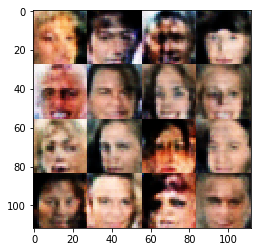

Epoch 1/1... Discriminator Loss: 1.2245... Generator Loss: 0.5075
Epoch 1/1... Discriminator Loss: 1.0939... Generator Loss: 1.0607
Epoch 1/1... Discriminator Loss: 1.1418... Generator Loss: 0.5577
Epoch 1/1... Discriminator Loss: 0.9490... Generator Loss: 2.0177
Epoch 1/1... Discriminator Loss: 1.1296... Generator Loss: 0.5665
Epoch 1/1... Discriminator Loss: 1.1067... Generator Loss: 0.8477
Epoch 1/1... Discriminator Loss: 1.1166... Generator Loss: 1.0736
Epoch 1/1... Discriminator Loss: 0.8643... Generator Loss: 1.0813
Epoch 1/1... Discriminator Loss: 0.7380... Generator Loss: 1.0924
Epoch 1/1... Discriminator Loss: 1.2412... Generator Loss: 0.5994


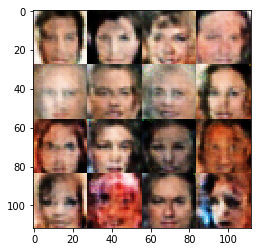

Epoch 1/1... Discriminator Loss: 1.0882... Generator Loss: 1.1208
Epoch 1/1... Discriminator Loss: 1.5670... Generator Loss: 0.3079
Epoch 1/1... Discriminator Loss: 0.6787... Generator Loss: 1.5054
Epoch 1/1... Discriminator Loss: 0.7937... Generator Loss: 1.2097
Epoch 1/1... Discriminator Loss: 0.8463... Generator Loss: 0.8810
Epoch 1/1... Discriminator Loss: 0.9797... Generator Loss: 1.4250
Epoch 1/1... Discriminator Loss: 0.6827... Generator Loss: 1.0752
Epoch 1/1... Discriminator Loss: 0.5849... Generator Loss: 1.2313
Epoch 1/1... Discriminator Loss: 0.5205... Generator Loss: 1.4478
Epoch 1/1... Discriminator Loss: 0.7256... Generator Loss: 1.2814


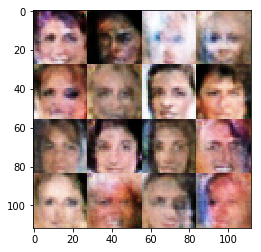

Epoch 1/1... Discriminator Loss: 1.0542... Generator Loss: 0.8379
Epoch 1/1... Discriminator Loss: 0.4514... Generator Loss: 1.3590
Epoch 1/1... Discriminator Loss: 0.7486... Generator Loss: 3.2435
Epoch 1/1... Discriminator Loss: 1.1673... Generator Loss: 1.1933
Epoch 1/1... Discriminator Loss: 1.6547... Generator Loss: 0.2799
Epoch 1/1... Discriminator Loss: 1.8446... Generator Loss: 1.9697
Epoch 1/1... Discriminator Loss: 1.2628... Generator Loss: 0.5141
Epoch 1/1... Discriminator Loss: 0.8930... Generator Loss: 1.2189
Epoch 1/1... Discriminator Loss: 0.7701... Generator Loss: 1.2295
Epoch 1/1... Discriminator Loss: 0.7667... Generator Loss: 0.8959


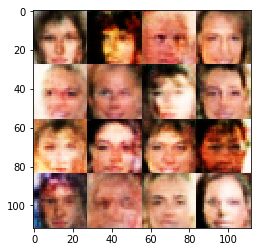

Epoch 1/1... Discriminator Loss: 0.8190... Generator Loss: 1.5823
Epoch 1/1... Discriminator Loss: 1.1793... Generator Loss: 0.5109
Epoch 1/1... Discriminator Loss: 1.1478... Generator Loss: 1.8571
Epoch 1/1... Discriminator Loss: 0.8821... Generator Loss: 0.7354
Epoch 1/1... Discriminator Loss: 0.4779... Generator Loss: 2.1010
Epoch 1/1... Discriminator Loss: 0.9236... Generator Loss: 0.7259
Epoch 1/1... Discriminator Loss: 0.9825... Generator Loss: 1.0390
Epoch 1/1... Discriminator Loss: 0.6501... Generator Loss: 1.0676
Epoch 1/1... Discriminator Loss: 0.5987... Generator Loss: 1.7300
Epoch 1/1... Discriminator Loss: 0.9011... Generator Loss: 0.7222


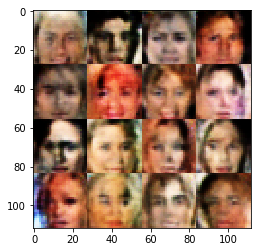

Epoch 1/1... Discriminator Loss: 0.3874... Generator Loss: 2.6378
Epoch 1/1... Discriminator Loss: 1.1354... Generator Loss: 0.5098
Epoch 1/1... Discriminator Loss: 2.2499... Generator Loss: 2.5536
Epoch 1/1... Discriminator Loss: 1.2957... Generator Loss: 0.4557
Epoch 1/1... Discriminator Loss: 1.0131... Generator Loss: 0.7057
Epoch 1/1... Discriminator Loss: 1.3177... Generator Loss: 1.2168
Epoch 1/1... Discriminator Loss: 1.2817... Generator Loss: 0.4230
Epoch 1/1... Discriminator Loss: 1.5453... Generator Loss: 2.1942
Epoch 1/1... Discriminator Loss: 1.2121... Generator Loss: 0.7717
Epoch 1/1... Discriminator Loss: 1.2107... Generator Loss: 0.7308


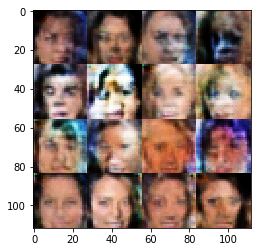

Epoch 1/1... Discriminator Loss: 1.1991... Generator Loss: 0.8273
Epoch 1/1... Discriminator Loss: 1.3966... Generator Loss: 0.5677
Epoch 1/1... Discriminator Loss: 1.3484... Generator Loss: 0.6773
Epoch 1/1... Discriminator Loss: 1.2943... Generator Loss: 0.7383
Epoch 1/1... Discriminator Loss: 1.2460... Generator Loss: 0.7520
Epoch 1/1... Discriminator Loss: 1.2201... Generator Loss: 0.6673
Epoch 1/1... Discriminator Loss: 0.9749... Generator Loss: 1.6709
Epoch 1/1... Discriminator Loss: 0.6371... Generator Loss: 1.3180
Epoch 1/1... Discriminator Loss: 1.1896... Generator Loss: 0.4665
Epoch 1/1... Discriminator Loss: 0.6909... Generator Loss: 1.2782


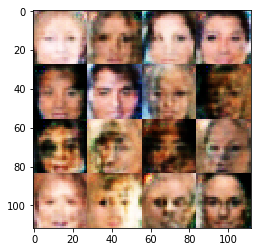

Epoch 1/1... Discriminator Loss: 0.8257... Generator Loss: 1.3128
Epoch 1/1... Discriminator Loss: 1.0695... Generator Loss: 0.7160
Epoch 1/1... Discriminator Loss: 0.7792... Generator Loss: 0.9894
Epoch 1/1... Discriminator Loss: 0.8931... Generator Loss: 0.8480
Epoch 1/1... Discriminator Loss: 0.9985... Generator Loss: 1.1437
Epoch 1/1... Discriminator Loss: 1.1767... Generator Loss: 0.5427
Epoch 1/1... Discriminator Loss: 1.1142... Generator Loss: 1.6494
Epoch 1/1... Discriminator Loss: 1.4294... Generator Loss: 0.3537
Epoch 1/1... Discriminator Loss: 1.9619... Generator Loss: 2.2910
Epoch 1/1... Discriminator Loss: 1.0469... Generator Loss: 0.7031


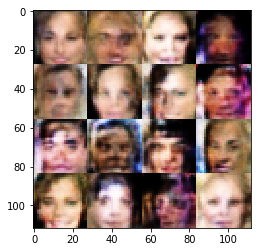

Epoch 1/1... Discriminator Loss: 1.1821... Generator Loss: 0.5023
Epoch 1/1... Discriminator Loss: 1.1744... Generator Loss: 1.7250
Epoch 1/1... Discriminator Loss: 1.1979... Generator Loss: 0.5291
Epoch 1/1... Discriminator Loss: 1.0726... Generator Loss: 0.9521
Epoch 1/1... Discriminator Loss: 1.2693... Generator Loss: 0.8101
Epoch 1/1... Discriminator Loss: 1.3071... Generator Loss: 0.6104
Epoch 1/1... Discriminator Loss: 1.2315... Generator Loss: 0.7053
Epoch 1/1... Discriminator Loss: 1.3109... Generator Loss: 0.7436
Epoch 1/1... Discriminator Loss: 0.9079... Generator Loss: 1.2600
Epoch 1/1... Discriminator Loss: 1.4007... Generator Loss: 0.4418


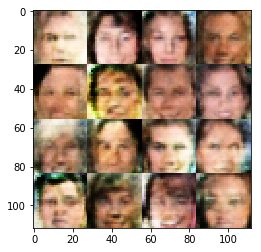

Epoch 1/1... Discriminator Loss: 1.3380... Generator Loss: 1.1007
Epoch 1/1... Discriminator Loss: 1.1900... Generator Loss: 0.6447
Epoch 1/1... Discriminator Loss: 1.2449... Generator Loss: 0.6531
Epoch 1/1... Discriminator Loss: 1.3454... Generator Loss: 1.0098
Epoch 1/1... Discriminator Loss: 1.2815... Generator Loss: 0.5575
Epoch 1/1... Discriminator Loss: 0.9644... Generator Loss: 1.0133
Epoch 1/1... Discriminator Loss: 0.9135... Generator Loss: 1.3740
Epoch 1/1... Discriminator Loss: 1.1860... Generator Loss: 0.4925
Epoch 1/1... Discriminator Loss: 1.0763... Generator Loss: 1.9461
Epoch 1/1... Discriminator Loss: 1.0450... Generator Loss: 0.6099


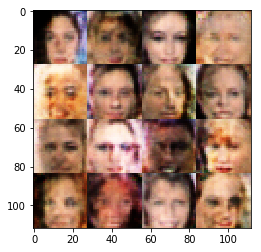

Epoch 1/1... Discriminator Loss: 1.1825... Generator Loss: 0.8536
Epoch 1/1... Discriminator Loss: 1.2456... Generator Loss: 0.6480
Epoch 1/1... Discriminator Loss: 0.4749... Generator Loss: 2.4187
Epoch 1/1... Discriminator Loss: 1.2667... Generator Loss: 0.4831
Epoch 1/1... Discriminator Loss: 0.8205... Generator Loss: 1.3566
Epoch 1/1... Discriminator Loss: 0.7665... Generator Loss: 1.2344
Epoch 1/1... Discriminator Loss: 1.1105... Generator Loss: 0.6368
Epoch 1/1... Discriminator Loss: 0.7683... Generator Loss: 1.4217
Epoch 1/1... Discriminator Loss: 1.6981... Generator Loss: 0.2844
Epoch 1/1... Discriminator Loss: 2.4591... Generator Loss: 2.3152


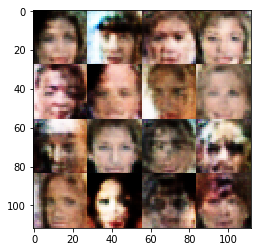

Epoch 1/1... Discriminator Loss: 1.5551... Generator Loss: 0.4587
Epoch 1/1... Discriminator Loss: 0.9584... Generator Loss: 0.8405
Epoch 1/1... Discriminator Loss: 1.1647... Generator Loss: 1.0576
Epoch 1/1... Discriminator Loss: 1.0598... Generator Loss: 0.8968
Epoch 1/1... Discriminator Loss: 0.7915... Generator Loss: 1.3157
Epoch 1/1... Discriminator Loss: 0.7862... Generator Loss: 1.0845
Epoch 1/1... Discriminator Loss: 0.6979... Generator Loss: 1.2309
Epoch 1/1... Discriminator Loss: 0.6810... Generator Loss: 1.2832
Epoch 1/1... Discriminator Loss: 1.0038... Generator Loss: 0.7241
Epoch 1/1... Discriminator Loss: 0.7335... Generator Loss: 1.0719


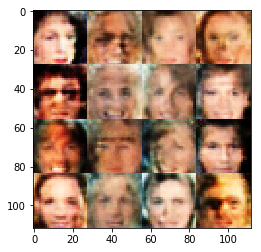

Epoch 1/1... Discriminator Loss: 0.9448... Generator Loss: 1.1625
Epoch 1/1... Discriminator Loss: 1.1138... Generator Loss: 0.5644
Epoch 1/1... Discriminator Loss: 0.8378... Generator Loss: 1.1675
Epoch 1/1... Discriminator Loss: 0.9070... Generator Loss: 0.9615
Epoch 1/1... Discriminator Loss: 1.0051... Generator Loss: 0.8457
Epoch 1/1... Discriminator Loss: 0.8184... Generator Loss: 1.0936
Epoch 1/1... Discriminator Loss: 1.1252... Generator Loss: 1.3162
Epoch 1/1... Discriminator Loss: 1.6700... Generator Loss: 0.2523
Epoch 1/1... Discriminator Loss: 1.1729... Generator Loss: 2.3012
Epoch 1/1... Discriminator Loss: 0.9839... Generator Loss: 0.6133


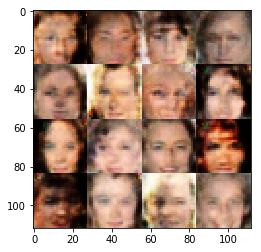

Epoch 1/1... Discriminator Loss: 0.5256... Generator Loss: 2.6801
Epoch 1/1... Discriminator Loss: 1.6014... Generator Loss: 0.2864
Epoch 1/1... Discriminator Loss: 1.5700... Generator Loss: 2.6782
Epoch 1/1... Discriminator Loss: 1.0580... Generator Loss: 0.8654
Epoch 1/1... Discriminator Loss: 1.0511... Generator Loss: 0.7039
Epoch 1/1... Discriminator Loss: 1.0957... Generator Loss: 1.0006
Epoch 1/1... Discriminator Loss: 1.2926... Generator Loss: 0.4656
Epoch 1/1... Discriminator Loss: 1.1956... Generator Loss: 1.3234
Epoch 1/1... Discriminator Loss: 1.0534... Generator Loss: 0.7480
Epoch 1/1... Discriminator Loss: 1.0681... Generator Loss: 0.7560


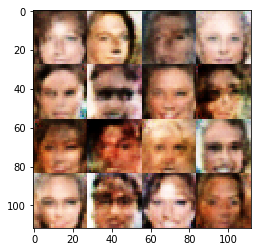

Epoch 1/1... Discriminator Loss: 1.0043... Generator Loss: 1.3014
Epoch 1/1... Discriminator Loss: 0.9536... Generator Loss: 0.7134
Epoch 1/1... Discriminator Loss: 0.7768... Generator Loss: 1.1768
Epoch 1/1... Discriminator Loss: 1.1796... Generator Loss: 0.6522
Epoch 1/1... Discriminator Loss: 0.9319... Generator Loss: 1.1043
Epoch 1/1... Discriminator Loss: 1.1205... Generator Loss: 0.5974
Epoch 1/1... Discriminator Loss: 1.0819... Generator Loss: 0.9530
Epoch 1/1... Discriminator Loss: 0.9067... Generator Loss: 1.6970
Epoch 1/1... Discriminator Loss: 1.3549... Generator Loss: 0.3737
Epoch 1/1... Discriminator Loss: 1.9034... Generator Loss: 1.8609


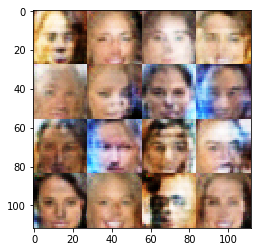

Epoch 1/1... Discriminator Loss: 2.0980... Generator Loss: 0.2088
Epoch 1/1... Discriminator Loss: 1.2144... Generator Loss: 1.5374
Epoch 1/1... Discriminator Loss: 1.3183... Generator Loss: 0.6882
Epoch 1/1... Discriminator Loss: 1.2293... Generator Loss: 0.5891
Epoch 1/1... Discriminator Loss: 1.4580... Generator Loss: 0.8699
Epoch 1/1... Discriminator Loss: 1.4685... Generator Loss: 0.6250
Epoch 1/1... Discriminator Loss: 1.4040... Generator Loss: 0.4953
Epoch 1/1... Discriminator Loss: 1.3899... Generator Loss: 0.6330
Epoch 1/1... Discriminator Loss: 1.6046... Generator Loss: 0.6577
Epoch 1/1... Discriminator Loss: 1.6363... Generator Loss: 0.3948


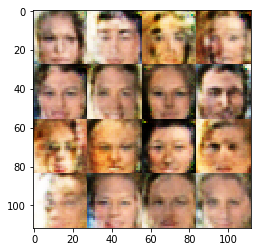

Epoch 1/1... Discriminator Loss: 1.0931... Generator Loss: 2.2763
Epoch 1/1... Discriminator Loss: 1.4177... Generator Loss: 0.3817
Epoch 1/1... Discriminator Loss: 0.9195... Generator Loss: 1.3546
Epoch 1/1... Discriminator Loss: 0.6193... Generator Loss: 1.3639
Epoch 1/1... Discriminator Loss: 1.5657... Generator Loss: 0.3112
Epoch 1/1... Discriminator Loss: 1.4211... Generator Loss: 1.7378
Epoch 1/1... Discriminator Loss: 0.6862... Generator Loss: 1.3082
Epoch 1/1... Discriminator Loss: 1.8232... Generator Loss: 0.2281
Epoch 1/1... Discriminator Loss: 1.2134... Generator Loss: 1.5017
Epoch 1/1... Discriminator Loss: 1.2326... Generator Loss: 0.6473


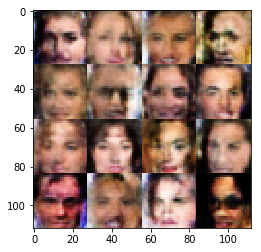

Epoch 1/1... Discriminator Loss: 1.3598... Generator Loss: 0.5528
Epoch 1/1... Discriminator Loss: 1.1272... Generator Loss: 0.6775
Epoch 1/1... Discriminator Loss: 0.9727... Generator Loss: 1.0020
Epoch 1/1... Discriminator Loss: 0.9228... Generator Loss: 0.9324
Epoch 1/1... Discriminator Loss: 0.5607... Generator Loss: 1.4211
Epoch 1/1... Discriminator Loss: 0.6676... Generator Loss: 0.9983
Epoch 1/1... Discriminator Loss: 1.0476... Generator Loss: 0.6866
Epoch 1/1... Discriminator Loss: 1.5858... Generator Loss: 2.2294
Epoch 1/1... Discriminator Loss: 1.5023... Generator Loss: 0.4332
Epoch 1/1... Discriminator Loss: 1.3536... Generator Loss: 0.6846


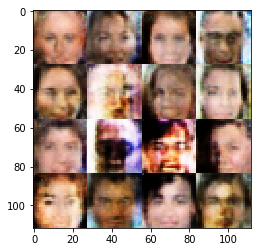

Epoch 1/1... Discriminator Loss: 1.3353... Generator Loss: 0.6669
Epoch 1/1... Discriminator Loss: 1.2409... Generator Loss: 0.6726
Epoch 1/1... Discriminator Loss: 1.2244... Generator Loss: 0.6217
Epoch 1/1... Discriminator Loss: 1.5623... Generator Loss: 0.5855
Epoch 1/1... Discriminator Loss: 1.0627... Generator Loss: 0.8281
Epoch 1/1... Discriminator Loss: 1.1778... Generator Loss: 0.6102
Epoch 1/1... Discriminator Loss: 1.3218... Generator Loss: 1.4113
Epoch 1/1... Discriminator Loss: 1.3856... Generator Loss: 0.4158
Epoch 1/1... Discriminator Loss: 1.0831... Generator Loss: 0.9024
Epoch 1/1... Discriminator Loss: 0.9940... Generator Loss: 0.9560


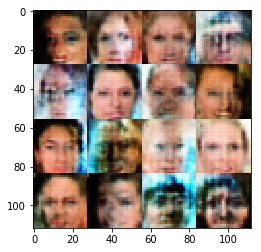

Epoch 1/1... Discriminator Loss: 1.3410... Generator Loss: 0.4547
Epoch 1/1... Discriminator Loss: 1.3043... Generator Loss: 1.3007
Epoch 1/1... Discriminator Loss: 0.4131... Generator Loss: 2.0585
Epoch 1/1... Discriminator Loss: 1.4763... Generator Loss: 0.3534
Epoch 1/1... Discriminator Loss: 1.5201... Generator Loss: 1.6047
Epoch 1/1... Discriminator Loss: 1.4053... Generator Loss: 0.4731
Epoch 1/1... Discriminator Loss: 1.4597... Generator Loss: 0.5969
Epoch 1/1... Discriminator Loss: 1.2952... Generator Loss: 0.9313
Epoch 1/1... Discriminator Loss: 1.7118... Generator Loss: 0.3188
Epoch 1/1... Discriminator Loss: 1.7431... Generator Loss: 1.5814


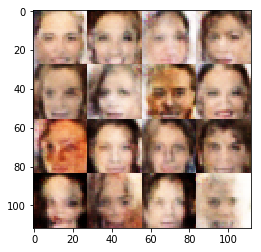

Epoch 1/1... Discriminator Loss: 1.5072... Generator Loss: 0.4356
Epoch 1/1... Discriminator Loss: 1.1426... Generator Loss: 0.6806
Epoch 1/1... Discriminator Loss: 1.3396... Generator Loss: 0.8182
Epoch 1/1... Discriminator Loss: 1.2495... Generator Loss: 0.8468
Epoch 1/1... Discriminator Loss: 0.7490... Generator Loss: 1.2420
Epoch 1/1... Discriminator Loss: 1.1174... Generator Loss: 0.5826
Epoch 1/1... Discriminator Loss: 1.1570... Generator Loss: 1.4299
Epoch 1/1... Discriminator Loss: 0.6922... Generator Loss: 1.1475
Epoch 1/1... Discriminator Loss: 1.2526... Generator Loss: 0.5608
Epoch 1/1... Discriminator Loss: 1.1473... Generator Loss: 1.3799


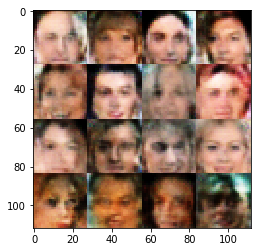

Epoch 1/1... Discriminator Loss: 1.2738... Generator Loss: 0.5041
Epoch 1/1... Discriminator Loss: 1.1291... Generator Loss: 1.7040
Epoch 1/1... Discriminator Loss: 1.5006... Generator Loss: 0.3437
Epoch 1/1... Discriminator Loss: 1.3521... Generator Loss: 1.9413
Epoch 1/1... Discriminator Loss: 0.8762... Generator Loss: 1.0233
Epoch 1/1... Discriminator Loss: 1.5859... Generator Loss: 0.3107
Epoch 1/1... Discriminator Loss: 1.3602... Generator Loss: 0.8340
Epoch 1/1... Discriminator Loss: 1.5328... Generator Loss: 0.9058
Epoch 1/1... Discriminator Loss: 1.5220... Generator Loss: 0.3795
Epoch 1/1... Discriminator Loss: 1.0467... Generator Loss: 1.4172


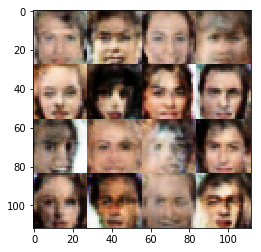

Epoch 1/1... Discriminator Loss: 0.5526... Generator Loss: 1.8387
Epoch 1/1... Discriminator Loss: 0.8323... Generator Loss: 0.7477
Epoch 1/1... Discriminator Loss: 1.1554... Generator Loss: 1.0748
Epoch 1/1... Discriminator Loss: 0.9379... Generator Loss: 0.8677
Epoch 1/1... Discriminator Loss: 0.8127... Generator Loss: 0.9441
Epoch 1/1... Discriminator Loss: 0.8606... Generator Loss: 1.3169
Epoch 1/1... Discriminator Loss: 1.0562... Generator Loss: 0.8252
Epoch 1/1... Discriminator Loss: 0.4802... Generator Loss: 1.6660
Epoch 1/1... Discriminator Loss: 0.9773... Generator Loss: 0.6484
Epoch 1/1... Discriminator Loss: 1.0178... Generator Loss: 2.0936


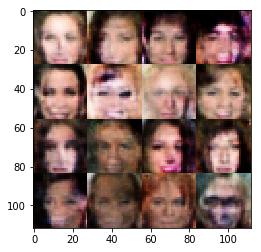

Epoch 1/1... Discriminator Loss: 1.0747... Generator Loss: 0.6836
Epoch 1/1... Discriminator Loss: 1.1654... Generator Loss: 1.0155
Epoch 1/1... Discriminator Loss: 1.0670... Generator Loss: 0.6589
Epoch 1/1... Discriminator Loss: 1.1995... Generator Loss: 0.8689
Epoch 1/1... Discriminator Loss: 0.9849... Generator Loss: 1.4673
Epoch 1/1... Discriminator Loss: 1.3137... Generator Loss: 0.4558
Epoch 1/1... Discriminator Loss: 1.1843... Generator Loss: 0.7800
Epoch 1/1... Discriminator Loss: 1.1492... Generator Loss: 0.7621
Epoch 1/1... Discriminator Loss: 0.9560... Generator Loss: 0.8020
Epoch 1/1... Discriminator Loss: 0.7527... Generator Loss: 1.8301


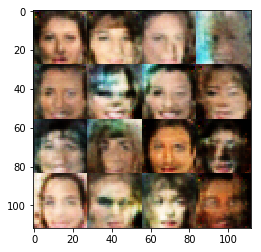

Epoch 1/1... Discriminator Loss: 0.9925... Generator Loss: 0.7758
Epoch 1/1... Discriminator Loss: 0.6917... Generator Loss: 1.1007
Epoch 1/1... Discriminator Loss: 1.0613... Generator Loss: 0.8244
Epoch 1/1... Discriminator Loss: 0.7331... Generator Loss: 1.4232
Epoch 1/1... Discriminator Loss: 1.1296... Generator Loss: 0.7408
Epoch 1/1... Discriminator Loss: 1.2032... Generator Loss: 0.5410
Epoch 1/1... Discriminator Loss: 0.9635... Generator Loss: 1.1549
Epoch 1/1... Discriminator Loss: 1.1915... Generator Loss: 0.7032
Epoch 1/1... Discriminator Loss: 1.2340... Generator Loss: 1.2946
Epoch 1/1... Discriminator Loss: 0.7901... Generator Loss: 1.2808


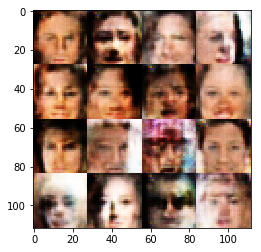

Epoch 1/1... Discriminator Loss: 1.6651... Generator Loss: 0.2787
Epoch 1/1... Discriminator Loss: 1.2193... Generator Loss: 1.9743
Epoch 1/1... Discriminator Loss: 0.8491... Generator Loss: 0.9818
Epoch 1/1... Discriminator Loss: 1.5724... Generator Loss: 0.3186
Epoch 1/1... Discriminator Loss: 1.0883... Generator Loss: 2.0297
Epoch 1/1... Discriminator Loss: 1.2901... Generator Loss: 0.4630
Epoch 1/1... Discriminator Loss: 1.2316... Generator Loss: 1.4543
Epoch 1/1... Discriminator Loss: 0.8925... Generator Loss: 0.7652
Epoch 1/1... Discriminator Loss: 0.3095... Generator Loss: 2.8122
Epoch 1/1... Discriminator Loss: 1.0823... Generator Loss: 0.5322


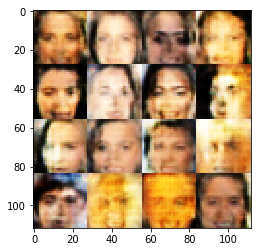

Epoch 1/1... Discriminator Loss: 1.0164... Generator Loss: 1.2604
Epoch 1/1... Discriminator Loss: 0.8652... Generator Loss: 1.1294
Epoch 1/1... Discriminator Loss: 1.1177... Generator Loss: 0.5266
Epoch 1/1... Discriminator Loss: 0.9967... Generator Loss: 1.1763
Epoch 1/1... Discriminator Loss: 0.7646... Generator Loss: 0.9581
Epoch 1/1... Discriminator Loss: 1.8100... Generator Loss: 0.2865
Epoch 1/1... Discriminator Loss: 2.1305... Generator Loss: 2.2482
Epoch 1/1... Discriminator Loss: 1.1969... Generator Loss: 0.7447
Epoch 1/1... Discriminator Loss: 1.3257... Generator Loss: 0.5427
Epoch 1/1... Discriminator Loss: 1.0139... Generator Loss: 0.9160


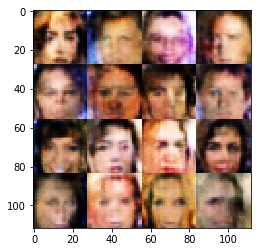

Epoch 1/1... Discriminator Loss: 1.1586... Generator Loss: 0.7408
Epoch 1/1... Discriminator Loss: 1.4029... Generator Loss: 0.5588
Epoch 1/1... Discriminator Loss: 1.1054... Generator Loss: 0.8653
Epoch 1/1... Discriminator Loss: 1.7255... Generator Loss: 0.2662
Epoch 1/1... Discriminator Loss: 1.6451... Generator Loss: 2.3445
Epoch 1/1... Discriminator Loss: 0.3778... Generator Loss: 2.8905
Epoch 1/1... Discriminator Loss: 1.9618... Generator Loss: 0.1929
Epoch 1/1... Discriminator Loss: 1.2334... Generator Loss: 1.4557
Epoch 1/1... Discriminator Loss: 1.0670... Generator Loss: 1.1023
Epoch 1/1... Discriminator Loss: 1.2775... Generator Loss: 0.4928


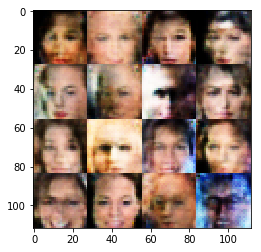

Epoch 1/1... Discriminator Loss: 1.1279... Generator Loss: 0.7360
Epoch 1/1... Discriminator Loss: 1.2794... Generator Loss: 0.5935
Epoch 1/1... Discriminator Loss: 1.0505... Generator Loss: 0.7838
Epoch 1/1... Discriminator Loss: 1.1424... Generator Loss: 0.9516
Epoch 1/1... Discriminator Loss: 1.1374... Generator Loss: 0.6636
Epoch 1/1... Discriminator Loss: 0.8146... Generator Loss: 1.0253
Epoch 1/1... Discriminator Loss: 0.8552... Generator Loss: 1.0275
Epoch 1/1... Discriminator Loss: 0.9553... Generator Loss: 1.0978
Epoch 1/1... Discriminator Loss: 0.9569... Generator Loss: 0.9583
Epoch 1/1... Discriminator Loss: 1.4096... Generator Loss: 0.3992


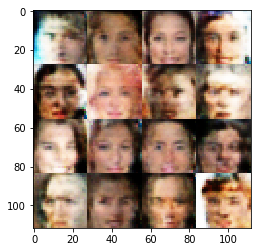

Epoch 1/1... Discriminator Loss: 1.0350... Generator Loss: 4.6260
Epoch 1/1... Discriminator Loss: 1.3697... Generator Loss: 0.4059
Epoch 1/1... Discriminator Loss: 1.1232... Generator Loss: 1.1655
Epoch 1/1... Discriminator Loss: 0.9240... Generator Loss: 0.8680
Epoch 1/1... Discriminator Loss: 1.4004... Generator Loss: 0.3817
Epoch 1/1... Discriminator Loss: 1.3807... Generator Loss: 1.8401
Epoch 1/1... Discriminator Loss: 1.1746... Generator Loss: 0.5320
Epoch 1/1... Discriminator Loss: 1.0502... Generator Loss: 0.9053
Epoch 1/1... Discriminator Loss: 0.9938... Generator Loss: 1.0357
Epoch 1/1... Discriminator Loss: 0.7692... Generator Loss: 1.1248


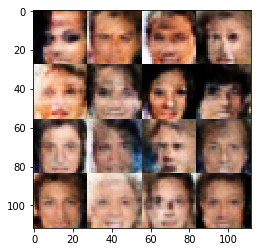

Epoch 1/1... Discriminator Loss: 1.0993... Generator Loss: 0.7166
Epoch 1/1... Discriminator Loss: 1.2509... Generator Loss: 0.7527
Epoch 1/1... Discriminator Loss: 1.0256... Generator Loss: 1.1139
Epoch 1/1... Discriminator Loss: 1.4053... Generator Loss: 0.4636
Epoch 1/1... Discriminator Loss: 1.0194... Generator Loss: 2.1457
Epoch 1/1... Discriminator Loss: 1.3103... Generator Loss: 0.4442
Epoch 1/1... Discriminator Loss: 1.6556... Generator Loss: 2.0457
Epoch 1/1... Discriminator Loss: 0.9774... Generator Loss: 0.8509
Epoch 1/1... Discriminator Loss: 1.2672... Generator Loss: 0.4450
Epoch 1/1... Discriminator Loss: 1.3839... Generator Loss: 1.5899


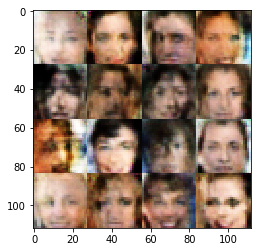

Epoch 1/1... Discriminator Loss: 1.2998... Generator Loss: 0.5378
Epoch 1/1... Discriminator Loss: 1.0645... Generator Loss: 0.7868
Epoch 1/1... Discriminator Loss: 1.0430... Generator Loss: 1.1104
Epoch 1/1... Discriminator Loss: 0.9172... Generator Loss: 0.8882
Epoch 1/1... Discriminator Loss: 0.8588... Generator Loss: 0.9018
Epoch 1/1... Discriminator Loss: 0.8638... Generator Loss: 0.9485
Epoch 1/1... Discriminator Loss: 0.6493... Generator Loss: 1.7844
Epoch 1/1... Discriminator Loss: 0.8989... Generator Loss: 0.8483
Epoch 1/1... Discriminator Loss: 0.5325... Generator Loss: 2.1103
Epoch 1/1... Discriminator Loss: 1.8843... Generator Loss: 0.2125


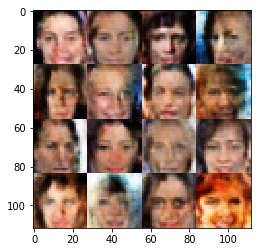

Epoch 1/1... Discriminator Loss: 1.6636... Generator Loss: 1.1677
Epoch 1/1... Discriminator Loss: 1.1402... Generator Loss: 0.5220
Epoch 1/1... Discriminator Loss: 0.8397... Generator Loss: 1.2889
Epoch 1/1... Discriminator Loss: 0.7178... Generator Loss: 0.9544
Epoch 1/1... Discriminator Loss: 0.4380... Generator Loss: 1.7141
Epoch 1/1... Discriminator Loss: 1.0302... Generator Loss: 0.8452
Epoch 1/1... Discriminator Loss: 1.3670... Generator Loss: 0.9947
Epoch 1/1... Discriminator Loss: 1.5121... Generator Loss: 0.3441
Epoch 1/1... Discriminator Loss: 1.3817... Generator Loss: 1.5181
Epoch 1/1... Discriminator Loss: 1.3323... Generator Loss: 0.4623


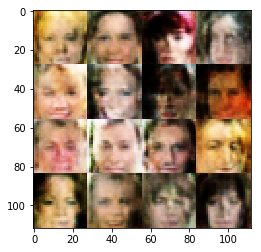

Epoch 1/1... Discriminator Loss: 1.2356... Generator Loss: 0.8521
Epoch 1/1... Discriminator Loss: 1.1506... Generator Loss: 0.9378
Epoch 1/1... Discriminator Loss: 1.1743... Generator Loss: 0.6400
Epoch 1/1... Discriminator Loss: 0.6693... Generator Loss: 1.7793
Epoch 1/1... Discriminator Loss: 0.9051... Generator Loss: 0.7569
Epoch 1/1... Discriminator Loss: 0.7391... Generator Loss: 1.3351
Epoch 1/1... Discriminator Loss: 1.1771... Generator Loss: 0.5081
Epoch 1/1... Discriminator Loss: 1.2540... Generator Loss: 1.4072
Epoch 1/1... Discriminator Loss: 2.1657... Generator Loss: 0.1596
Epoch 1/1... Discriminator Loss: 1.6571... Generator Loss: 2.8043


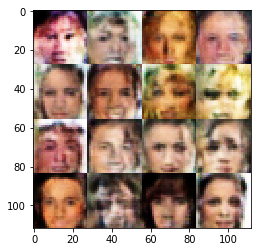

Epoch 1/1... Discriminator Loss: 1.1802... Generator Loss: 0.8948
Epoch 1/1... Discriminator Loss: 1.3378... Generator Loss: 0.4769
Epoch 1/1... Discriminator Loss: 0.7566... Generator Loss: 1.6904
Epoch 1/1... Discriminator Loss: 0.7975... Generator Loss: 1.8356
Epoch 1/1... Discriminator Loss: 1.0908... Generator Loss: 0.5505
Epoch 1/1... Discriminator Loss: 0.7770... Generator Loss: 1.5182
Epoch 1/1... Discriminator Loss: 0.9835... Generator Loss: 0.7951
Epoch 1/1... Discriminator Loss: 0.9514... Generator Loss: 1.0255
Epoch 1/1... Discriminator Loss: 1.3333... Generator Loss: 0.4935
Epoch 1/1... Discriminator Loss: 1.2034... Generator Loss: 1.3690


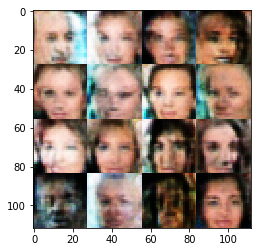

Epoch 1/1... Discriminator Loss: 1.2007... Generator Loss: 0.6074
Epoch 1/1... Discriminator Loss: 0.9791... Generator Loss: 0.7979
Epoch 1/1... Discriminator Loss: 0.7876... Generator Loss: 1.1566
Epoch 1/1... Discriminator Loss: 1.0499... Generator Loss: 0.7340
Epoch 1/1... Discriminator Loss: 0.7553... Generator Loss: 1.4303
Epoch 1/1... Discriminator Loss: 0.8297... Generator Loss: 1.0059
Epoch 1/1... Discriminator Loss: 1.2912... Generator Loss: 0.3905
Epoch 1/1... Discriminator Loss: 0.8758... Generator Loss: 1.7579
Epoch 1/1... Discriminator Loss: 1.1018... Generator Loss: 1.0592
Epoch 1/1... Discriminator Loss: 0.9097... Generator Loss: 0.6644


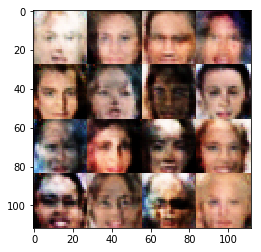

Epoch 1/1... Discriminator Loss: 1.1771... Generator Loss: 2.0338
Epoch 1/1... Discriminator Loss: 1.0786... Generator Loss: 0.6358
Epoch 1/1... Discriminator Loss: 1.2993... Generator Loss: 1.2975
Epoch 1/1... Discriminator Loss: 1.2025... Generator Loss: 0.6212
Epoch 1/1... Discriminator Loss: 1.1828... Generator Loss: 0.7217
Epoch 1/1... Discriminator Loss: 1.1281... Generator Loss: 1.0214
Epoch 1/1... Discriminator Loss: 1.2500... Generator Loss: 0.6264
Epoch 1/1... Discriminator Loss: 0.6454... Generator Loss: 1.6971
Epoch 1/1... Discriminator Loss: 0.3052... Generator Loss: 2.2967
Epoch 1/1... Discriminator Loss: 1.3538... Generator Loss: 0.3891


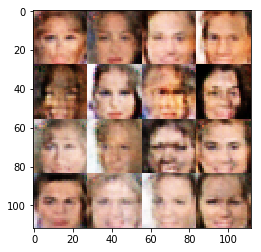

Epoch 1/1... Discriminator Loss: 1.1231... Generator Loss: 1.6656
Epoch 1/1... Discriminator Loss: 1.4627... Generator Loss: 0.3998
Epoch 1/1... Discriminator Loss: 1.0024... Generator Loss: 0.8253
Epoch 1/1... Discriminator Loss: 1.1291... Generator Loss: 0.9663
Epoch 1/1... Discriminator Loss: 0.7706... Generator Loss: 1.0963
Epoch 1/1... Discriminator Loss: 0.7022... Generator Loss: 1.0691
Epoch 1/1... Discriminator Loss: 0.6154... Generator Loss: 2.7131
Epoch 1/1... Discriminator Loss: 0.6463... Generator Loss: 1.1149
Epoch 1/1... Discriminator Loss: 0.8967... Generator Loss: 0.8544
Epoch 1/1... Discriminator Loss: 1.6633... Generator Loss: 1.8919


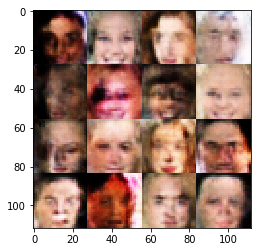

Epoch 1/1... Discriminator Loss: 1.4332... Generator Loss: 0.3672
Epoch 1/1... Discriminator Loss: 1.5378... Generator Loss: 1.6475
Epoch 1/1... Discriminator Loss: 1.4046... Generator Loss: 0.3971
Epoch 1/1... Discriminator Loss: 1.0208... Generator Loss: 1.0286
Epoch 1/1... Discriminator Loss: 0.5425... Generator Loss: 3.2445
Epoch 1/1... Discriminator Loss: 1.5069... Generator Loss: 0.3155
Epoch 1/1... Discriminator Loss: 0.7937... Generator Loss: 2.1062
Epoch 1/1... Discriminator Loss: 0.9365... Generator Loss: 0.7822
Epoch 1/1... Discriminator Loss: 1.1874... Generator Loss: 0.5648
Epoch 1/1... Discriminator Loss: 0.8493... Generator Loss: 1.9324


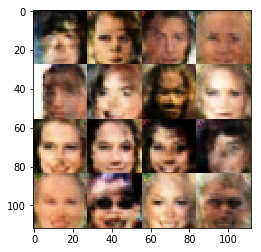

Epoch 1/1... Discriminator Loss: 0.9245... Generator Loss: 0.8744
Epoch 1/1... Discriminator Loss: 1.5900... Generator Loss: 0.2958
Epoch 1/1... Discriminator Loss: 1.9019... Generator Loss: 1.9970
Epoch 1/1... Discriminator Loss: 1.2937... Generator Loss: 0.5490
Epoch 1/1... Discriminator Loss: 1.3269... Generator Loss: 0.3915
Epoch 1/1... Discriminator Loss: 0.9410... Generator Loss: 1.6127
Epoch 1/1... Discriminator Loss: 0.5511... Generator Loss: 1.4348
Epoch 1/1... Discriminator Loss: 1.1148... Generator Loss: 0.5165
Epoch 1/1... Discriminator Loss: 1.1082... Generator Loss: 1.1858
Epoch 1/1... Discriminator Loss: 1.1133... Generator Loss: 0.9816


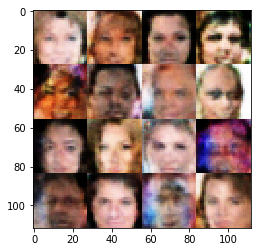

Epoch 1/1... Discriminator Loss: 1.0579... Generator Loss: 0.6523
Epoch 1/1... Discriminator Loss: 0.9693... Generator Loss: 1.5555
Epoch 1/1... Discriminator Loss: 1.0977... Generator Loss: 0.6195
Epoch 1/1... Discriminator Loss: 1.1206... Generator Loss: 0.7429
Epoch 1/1... Discriminator Loss: 1.1406... Generator Loss: 1.2248
Epoch 1/1... Discriminator Loss: 1.0592... Generator Loss: 0.5616
Epoch 1/1... Discriminator Loss: 1.4535... Generator Loss: 1.5713
Epoch 1/1... Discriminator Loss: 0.8657... Generator Loss: 0.8494
Epoch 1/1... Discriminator Loss: 0.9853... Generator Loss: 0.8261
Epoch 1/1... Discriminator Loss: 0.9397... Generator Loss: 1.0010


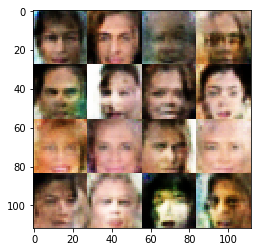

Epoch 1/1... Discriminator Loss: 1.3565... Generator Loss: 0.4713
Epoch 1/1... Discriminator Loss: 1.0124... Generator Loss: 1.8568
Epoch 1/1... Discriminator Loss: 1.0501... Generator Loss: 0.6735
Epoch 1/1... Discriminator Loss: 1.1688... Generator Loss: 0.7331
Epoch 1/1... Discriminator Loss: 0.8786... Generator Loss: 1.2572
Epoch 1/1... Discriminator Loss: 1.0221... Generator Loss: 0.6906
Epoch 1/1... Discriminator Loss: 1.0310... Generator Loss: 1.3542
Epoch 1/1... Discriminator Loss: 0.6775... Generator Loss: 0.9841
Epoch 1/1... Discriminator Loss: 0.4750... Generator Loss: 2.0609
Epoch 1/1... Discriminator Loss: 1.0800... Generator Loss: 0.5663


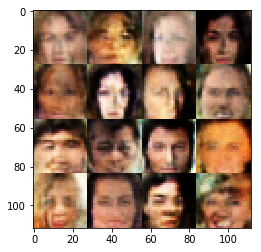

Epoch 1/1... Discriminator Loss: 0.8595... Generator Loss: 2.2242
Epoch 1/1... Discriminator Loss: 1.0159... Generator Loss: 0.7302
Epoch 1/1... Discriminator Loss: 0.9061... Generator Loss: 0.8791
Epoch 1/1... Discriminator Loss: 1.0055... Generator Loss: 1.0662
Epoch 1/1... Discriminator Loss: 0.8454... Generator Loss: 0.9100
Epoch 1/1... Discriminator Loss: 0.4449... Generator Loss: 1.7035
Epoch 1/1... Discriminator Loss: 1.9100... Generator Loss: 0.2224
Epoch 1/1... Discriminator Loss: 1.6471... Generator Loss: 2.4874
Epoch 1/1... Discriminator Loss: 0.9508... Generator Loss: 0.8146
Epoch 1/1... Discriminator Loss: 1.3486... Generator Loss: 0.5518


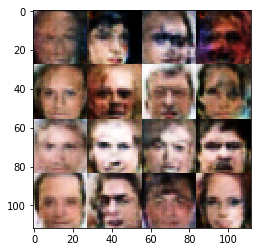

Epoch 1/1... Discriminator Loss: 0.7043... Generator Loss: 1.1570
Epoch 1/1... Discriminator Loss: 0.6657... Generator Loss: 1.3049
Epoch 1/1... Discriminator Loss: 1.0657... Generator Loss: 0.6008
Epoch 1/1... Discriminator Loss: 1.2079... Generator Loss: 2.5958
Epoch 1/1... Discriminator Loss: 1.0952... Generator Loss: 0.7114
Epoch 1/1... Discriminator Loss: 1.0750... Generator Loss: 0.9257
Epoch 1/1... Discriminator Loss: 0.8591... Generator Loss: 0.8635
Epoch 1/1... Discriminator Loss: 1.1343... Generator Loss: 1.2227
Epoch 1/1... Discriminator Loss: 1.2535... Generator Loss: 0.5139
Epoch 1/1... Discriminator Loss: 1.2548... Generator Loss: 1.1979


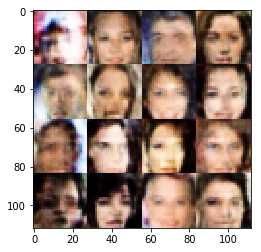

Epoch 1/1... Discriminator Loss: 1.5758... Generator Loss: 0.3972
Epoch 1/1... Discriminator Loss: 1.4067... Generator Loss: 1.0054
Epoch 1/1... Discriminator Loss: 1.5414... Generator Loss: 0.4360
Epoch 1/1... Discriminator Loss: 0.9646... Generator Loss: 1.5686
Epoch 1/1... Discriminator Loss: 0.8618... Generator Loss: 0.8966
Epoch 1/1... Discriminator Loss: 1.0547... Generator Loss: 0.6211
Epoch 1/1... Discriminator Loss: 0.8565... Generator Loss: 1.2362
Epoch 1/1... Discriminator Loss: 0.8840... Generator Loss: 1.0252
Epoch 1/1... Discriminator Loss: 0.4956... Generator Loss: 1.4052
Epoch 1/1... Discriminator Loss: 1.0678... Generator Loss: 1.0753


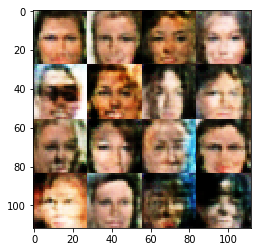

Epoch 1/1... Discriminator Loss: 1.5426... Generator Loss: 0.6154
Epoch 1/1... Discriminator Loss: 1.4696... Generator Loss: 0.3975
Epoch 1/1... Discriminator Loss: 1.2109... Generator Loss: 1.1720
Epoch 1/1... Discriminator Loss: 1.4388... Generator Loss: 0.3990
Epoch 1/1... Discriminator Loss: 1.5518... Generator Loss: 1.7139
Epoch 1/1... Discriminator Loss: 1.4936... Generator Loss: 0.3681
Epoch 1/1... Discriminator Loss: 1.1223... Generator Loss: 0.7032
Epoch 1/1... Discriminator Loss: 1.1446... Generator Loss: 1.2834
Epoch 1/1... Discriminator Loss: 0.9921... Generator Loss: 0.6910
Epoch 1/1... Discriminator Loss: 0.6650... Generator Loss: 1.5418


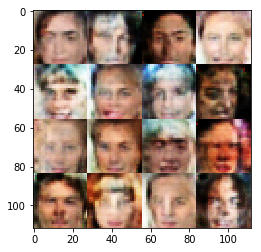

Epoch 1/1... Discriminator Loss: 0.9522... Generator Loss: 0.8032
Epoch 1/1... Discriminator Loss: 0.9703... Generator Loss: 0.9428
Epoch 1/1... Discriminator Loss: 0.7608... Generator Loss: 1.5204
Epoch 1/1... Discriminator Loss: 1.3463... Generator Loss: 0.4337
Epoch 1/1... Discriminator Loss: 1.4777... Generator Loss: 1.9448
Epoch 1/1... Discriminator Loss: 1.5242... Generator Loss: 0.3614
Epoch 1/1... Discriminator Loss: 1.0762... Generator Loss: 0.7770
Epoch 1/1... Discriminator Loss: 0.8741... Generator Loss: 1.4142
Epoch 1/1... Discriminator Loss: 1.2374... Generator Loss: 0.5097
Epoch 1/1... Discriminator Loss: 0.9349... Generator Loss: 1.7383


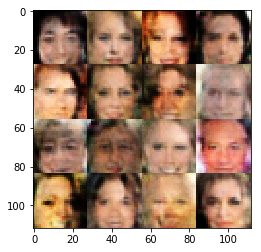

Epoch 1/1... Discriminator Loss: 0.9382... Generator Loss: 0.7770
Epoch 1/1... Discriminator Loss: 0.7508... Generator Loss: 1.1462
Epoch 1/1... Discriminator Loss: 1.1322... Generator Loss: 0.6415
Epoch 1/1... Discriminator Loss: 1.1619... Generator Loss: 1.6563
Epoch 1/1... Discriminator Loss: 1.0614... Generator Loss: 0.8441
Epoch 1/1... Discriminator Loss: 1.1337... Generator Loss: 0.5162
Epoch 1/1... Discriminator Loss: 3.5056... Generator Loss: 2.9285
Epoch 1/1... Discriminator Loss: 1.3366... Generator Loss: 0.4250
Epoch 1/1... Discriminator Loss: 1.2583... Generator Loss: 0.8255
Epoch 1/1... Discriminator Loss: 1.2578... Generator Loss: 0.6966


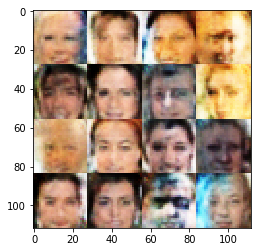

Epoch 1/1... Discriminator Loss: 1.2288... Generator Loss: 0.6800
Epoch 1/1... Discriminator Loss: 1.0986... Generator Loss: 0.7355
Epoch 1/1... Discriminator Loss: 1.1907... Generator Loss: 0.7846
Epoch 1/1... Discriminator Loss: 0.6053... Generator Loss: 2.1865
Epoch 1/1... Discriminator Loss: 1.2277... Generator Loss: 0.5154
Epoch 1/1... Discriminator Loss: 1.0081... Generator Loss: 1.0026
Epoch 1/1... Discriminator Loss: 1.0856... Generator Loss: 0.6154
Epoch 1/1... Discriminator Loss: 0.8874... Generator Loss: 1.0982
Epoch 1/1... Discriminator Loss: 0.7239... Generator Loss: 2.0889
Epoch 1/1... Discriminator Loss: 1.4065... Generator Loss: 0.3798


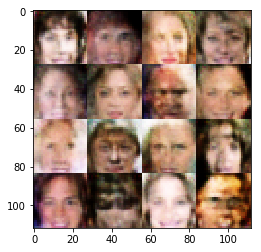

Epoch 1/1... Discriminator Loss: 1.5749... Generator Loss: 1.4492
Epoch 1/1... Discriminator Loss: 1.0682... Generator Loss: 0.5963
Epoch 1/1... Discriminator Loss: 0.6760... Generator Loss: 1.4610
Epoch 1/1... Discriminator Loss: 0.9100... Generator Loss: 0.9647
Epoch 1/1... Discriminator Loss: 1.1933... Generator Loss: 0.7338
Epoch 1/1... Discriminator Loss: 0.6919... Generator Loss: 1.4418
Epoch 1/1... Discriminator Loss: 0.5532... Generator Loss: 1.5194
Epoch 1/1... Discriminator Loss: 1.0647... Generator Loss: 0.8656
Epoch 1/1... Discriminator Loss: 0.4786... Generator Loss: 1.9434
Epoch 1/1... Discriminator Loss: 1.1357... Generator Loss: 0.5586


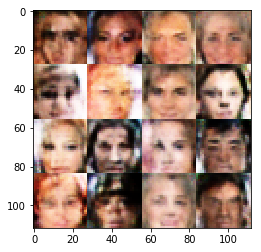

Epoch 1/1... Discriminator Loss: 1.4832... Generator Loss: 1.7149
Epoch 1/1... Discriminator Loss: 1.3729... Generator Loss: 0.3692
Epoch 1/1... Discriminator Loss: 1.5300... Generator Loss: 2.0827
Epoch 1/1... Discriminator Loss: 1.3318... Generator Loss: 0.6030
Epoch 1/1... Discriminator Loss: 1.1591... Generator Loss: 0.5533
Epoch 1/1... Discriminator Loss: 1.0512... Generator Loss: 1.2382
Epoch 1/1... Discriminator Loss: 1.0783... Generator Loss: 0.8305
Epoch 1/1... Discriminator Loss: 1.7387... Generator Loss: 0.2969
Epoch 1/1... Discriminator Loss: 1.2653... Generator Loss: 1.9678
Epoch 1/1... Discriminator Loss: 0.4956... Generator Loss: 2.1077


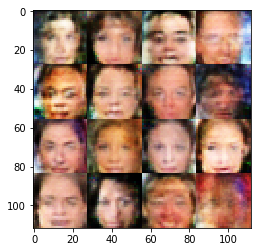

Epoch 1/1... Discriminator Loss: 2.2306... Generator Loss: 0.1403
Epoch 1/1... Discriminator Loss: 1.2372... Generator Loss: 1.4254
Epoch 1/1... Discriminator Loss: 1.4461... Generator Loss: 0.5949
Epoch 1/1... Discriminator Loss: 1.0052... Generator Loss: 0.7684
Epoch 1/1... Discriminator Loss: 0.7347... Generator Loss: 1.4168
Epoch 1/1... Discriminator Loss: 1.1626... Generator Loss: 0.6744
Epoch 1/1... Discriminator Loss: 0.7344... Generator Loss: 1.2100
Epoch 1/1... Discriminator Loss: 0.9418... Generator Loss: 0.9113
Epoch 1/1... Discriminator Loss: 0.8438... Generator Loss: 1.1250
Epoch 1/1... Discriminator Loss: 0.9722... Generator Loss: 0.8212


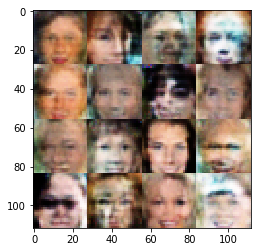

Epoch 1/1... Discriminator Loss: 0.8467... Generator Loss: 1.1175
Epoch 1/1... Discriminator Loss: 1.2320... Generator Loss: 0.6312
Epoch 1/1... Discriminator Loss: 1.0046... Generator Loss: 0.9384
Epoch 1/1... Discriminator Loss: 0.7545... Generator Loss: 1.5813
Epoch 1/1... Discriminator Loss: 1.2386... Generator Loss: 0.5370
Epoch 1/1... Discriminator Loss: 1.0279... Generator Loss: 1.0247
Epoch 1/1... Discriminator Loss: 0.8064... Generator Loss: 1.3363
Epoch 1/1... Discriminator Loss: 0.5139... Generator Loss: 1.4012
Epoch 1/1... Discriminator Loss: 0.8390... Generator Loss: 0.7447
Epoch 1/1... Discriminator Loss: 1.3568... Generator Loss: 1.2830


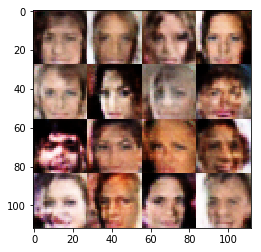

Epoch 1/1... Discriminator Loss: 0.7844... Generator Loss: 1.0515
Epoch 1/1... Discriminator Loss: 0.6837... Generator Loss: 1.0930
Epoch 1/1... Discriminator Loss: 1.4101... Generator Loss: 0.5050
Epoch 1/1... Discriminator Loss: 1.2460... Generator Loss: 1.5708
Epoch 1/1... Discriminator Loss: 0.9197... Generator Loss: 0.7668
Epoch 1/1... Discriminator Loss: 0.9432... Generator Loss: 2.2194
Epoch 1/1... Discriminator Loss: 0.7530... Generator Loss: 0.9527
Epoch 1/1... Discriminator Loss: 0.7822... Generator Loss: 1.2022
Epoch 1/1... Discriminator Loss: 1.0193... Generator Loss: 0.8347
Epoch 1/1... Discriminator Loss: 1.0406... Generator Loss: 0.9455


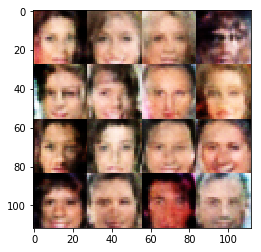

Epoch 1/1... Discriminator Loss: 0.9213... Generator Loss: 1.0442
Epoch 1/1... Discriminator Loss: 0.7063... Generator Loss: 1.1059
Epoch 1/1... Discriminator Loss: 0.8130... Generator Loss: 1.4133
Epoch 1/1... Discriminator Loss: 0.7087... Generator Loss: 1.1013
Epoch 1/1... Discriminator Loss: 0.9726... Generator Loss: 1.8599
Epoch 1/1... Discriminator Loss: 1.3298... Generator Loss: 0.4350
Epoch 1/1... Discriminator Loss: 1.2628... Generator Loss: 0.7708
Epoch 1/1... Discriminator Loss: 0.5603... Generator Loss: 2.6155
Epoch 1/1... Discriminator Loss: 1.7763... Generator Loss: 0.2322
Epoch 1/1... Discriminator Loss: 1.9755... Generator Loss: 2.3516


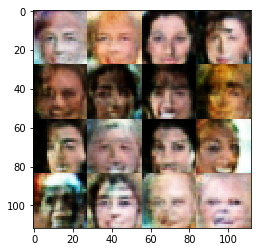

Epoch 1/1... Discriminator Loss: 1.5366... Generator Loss: 0.3898
Epoch 1/1... Discriminator Loss: 1.3683... Generator Loss: 0.8427
Epoch 1/1... Discriminator Loss: 1.1556... Generator Loss: 0.6010
Epoch 1/1... Discriminator Loss: 0.9985... Generator Loss: 0.7413
Epoch 1/1... Discriminator Loss: 0.8944... Generator Loss: 1.1147
Epoch 1/1... Discriminator Loss: 1.1538... Generator Loss: 0.5478
Epoch 1/1... Discriminator Loss: 0.9650... Generator Loss: 1.4608
Epoch 1/1... Discriminator Loss: 1.2240... Generator Loss: 0.5050
Epoch 1/1... Discriminator Loss: 1.1874... Generator Loss: 0.7551
Epoch 1/1... Discriminator Loss: 0.7840... Generator Loss: 1.3820


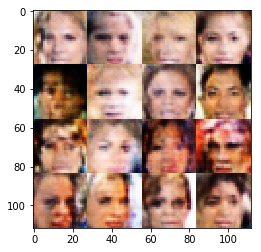

Epoch 1/1... Discriminator Loss: 1.1035... Generator Loss: 0.6156
Epoch 1/1... Discriminator Loss: 1.0680... Generator Loss: 0.8540
Epoch 1/1... Discriminator Loss: 0.9868... Generator Loss: 0.9450
Epoch 1/1... Discriminator Loss: 0.8133... Generator Loss: 0.9873
Epoch 1/1... Discriminator Loss: 0.9281... Generator Loss: 0.7669
Epoch 1/1... Discriminator Loss: 0.8926... Generator Loss: 2.1444
Epoch 1/1... Discriminator Loss: 1.5297... Generator Loss: 0.3156
Epoch 1/1... Discriminator Loss: 1.8236... Generator Loss: 2.5309
Epoch 1/1... Discriminator Loss: 2.0132... Generator Loss: 0.1897
Epoch 1/1... Discriminator Loss: 1.1304... Generator Loss: 1.0412


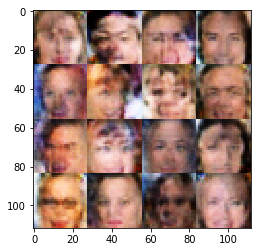

Epoch 1/1... Discriminator Loss: 0.9535... Generator Loss: 1.4559
Epoch 1/1... Discriminator Loss: 1.7811... Generator Loss: 0.2564
Epoch 1/1... Discriminator Loss: 1.3099... Generator Loss: 1.2526
Epoch 1/1... Discriminator Loss: 1.1318... Generator Loss: 0.5694
Epoch 1/1... Discriminator Loss: 0.5390... Generator Loss: 2.0527
Epoch 1/1... Discriminator Loss: 0.6397... Generator Loss: 1.0635
Epoch 1/1... Discriminator Loss: 1.0796... Generator Loss: 0.7796
Epoch 1/1... Discriminator Loss: 1.0789... Generator Loss: 1.2823
Epoch 1/1... Discriminator Loss: 0.9492... Generator Loss: 0.6943
Epoch 1/1... Discriminator Loss: 0.5226... Generator Loss: 1.7413


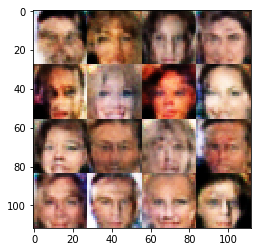

Epoch 1/1... Discriminator Loss: 1.0267... Generator Loss: 0.9476
Epoch 1/1... Discriminator Loss: 1.2935... Generator Loss: 0.8562
Epoch 1/1... Discriminator Loss: 1.6257... Generator Loss: 0.2836
Epoch 1/1... Discriminator Loss: 1.9550... Generator Loss: 2.6187
Epoch 1/1... Discriminator Loss: 1.6008... Generator Loss: 0.3246
Epoch 1/1... Discriminator Loss: 1.0641... Generator Loss: 0.9113
Epoch 1/1... Discriminator Loss: 0.9631... Generator Loss: 1.0643
Epoch 1/1... Discriminator Loss: 1.3577... Generator Loss: 0.4133
Epoch 1/1... Discriminator Loss: 1.5728... Generator Loss: 1.7961
Epoch 1/1... Discriminator Loss: 1.1988... Generator Loss: 0.5120


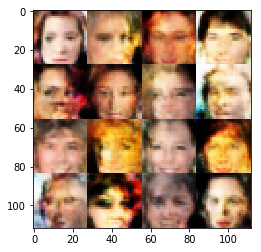

Epoch 1/1... Discriminator Loss: 1.2311... Generator Loss: 0.5461
Epoch 1/1... Discriminator Loss: 1.3573... Generator Loss: 1.4631
Epoch 1/1... Discriminator Loss: 1.2912... Generator Loss: 0.5095
Epoch 1/1... Discriminator Loss: 1.1733... Generator Loss: 0.6581
Epoch 1/1... Discriminator Loss: 1.1007... Generator Loss: 1.1813
Epoch 1/1... Discriminator Loss: 1.4330... Generator Loss: 0.4103
Epoch 1/1... Discriminator Loss: 0.8561... Generator Loss: 1.5337
Epoch 1/1... Discriminator Loss: 0.3870... Generator Loss: 2.2072
Epoch 1/1... Discriminator Loss: 0.8831... Generator Loss: 0.6890
Epoch 1/1... Discriminator Loss: 0.9639... Generator Loss: 1.2557


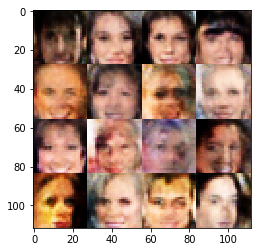

Epoch 1/1... Discriminator Loss: 0.7991... Generator Loss: 0.9982
Epoch 1/1... Discriminator Loss: 0.8692... Generator Loss: 0.8520
Epoch 1/1... Discriminator Loss: 0.7152... Generator Loss: 0.9684
Epoch 1/1... Discriminator Loss: 0.8441... Generator Loss: 1.3076
Epoch 1/1... Discriminator Loss: 0.6810... Generator Loss: 2.8658
Epoch 1/1... Discriminator Loss: 1.1337... Generator Loss: 0.5133
Epoch 1/1... Discriminator Loss: 1.1468... Generator Loss: 1.2591
Epoch 1/1... Discriminator Loss: 0.7174... Generator Loss: 0.9770
Epoch 1/1... Discriminator Loss: 0.6339... Generator Loss: 1.2174
Epoch 1/1... Discriminator Loss: 1.2474... Generator Loss: 1.3330


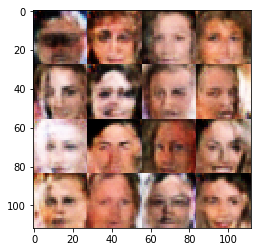

Epoch 1/1... Discriminator Loss: 0.6152... Generator Loss: 1.6345
Epoch 1/1... Discriminator Loss: 0.6357... Generator Loss: 0.9916
Epoch 1/1... Discriminator Loss: 1.1107... Generator Loss: 0.6201
Epoch 1/1... Discriminator Loss: 1.6208... Generator Loss: 2.2301
Epoch 1/1... Discriminator Loss: 1.3467... Generator Loss: 0.4160
Epoch 1/1... Discriminator Loss: 0.8779... Generator Loss: 1.3036
Epoch 1/1... Discriminator Loss: 1.0408... Generator Loss: 0.6187
Epoch 1/1... Discriminator Loss: 1.3496... Generator Loss: 1.5702
Epoch 1/1... Discriminator Loss: 1.8568... Generator Loss: 0.2645
Epoch 1/1... Discriminator Loss: 0.9585... Generator Loss: 2.0164


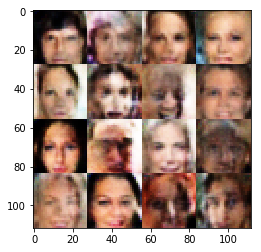

Epoch 1/1... Discriminator Loss: 1.0603... Generator Loss: 0.6367
Epoch 1/1... Discriminator Loss: 1.0381... Generator Loss: 0.9518
Epoch 1/1... Discriminator Loss: 1.2971... Generator Loss: 0.5287
Epoch 1/1... Discriminator Loss: 1.1592... Generator Loss: 1.0477
Epoch 1/1... Discriminator Loss: 1.0998... Generator Loss: 0.7915
Epoch 1/1... Discriminator Loss: 0.7267... Generator Loss: 1.2864
Epoch 1/1... Discriminator Loss: 1.2249... Generator Loss: 0.4980
Epoch 1/1... Discriminator Loss: 1.2779... Generator Loss: 2.4389
Epoch 1/1... Discriminator Loss: 0.4681... Generator Loss: 1.4268
Epoch 1/1... Discriminator Loss: 1.4272... Generator Loss: 0.3644


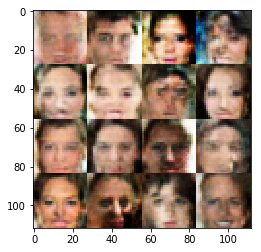

Epoch 1/1... Discriminator Loss: 1.5132... Generator Loss: 1.7442
Epoch 1/1... Discriminator Loss: 1.9016... Generator Loss: 0.2093
Epoch 1/1... Discriminator Loss: 0.6166... Generator Loss: 1.4151
Epoch 1/1... Discriminator Loss: 1.1836... Generator Loss: 0.8088
Epoch 1/1... Discriminator Loss: 0.3903... Generator Loss: 2.2645
Epoch 1/1... Discriminator Loss: 1.1688... Generator Loss: 0.4527
Epoch 1/1... Discriminator Loss: 1.2322... Generator Loss: 0.9085
Epoch 1/1... Discriminator Loss: 1.4213... Generator Loss: 1.1328
Epoch 1/1... Discriminator Loss: 1.2120... Generator Loss: 0.6367
Epoch 1/1... Discriminator Loss: 1.5911... Generator Loss: 1.1999


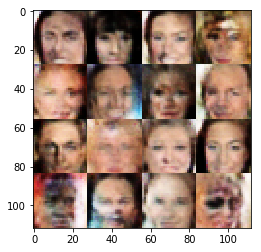

Epoch 1/1... Discriminator Loss: 1.5669... Generator Loss: 0.2935
Epoch 1/1... Discriminator Loss: 0.9976... Generator Loss: 1.1983
Epoch 1/1... Discriminator Loss: 1.2303... Generator Loss: 0.8946
Epoch 1/1... Discriminator Loss: 1.4038... Generator Loss: 0.4727
Epoch 1/1... Discriminator Loss: 1.1833... Generator Loss: 0.8640
Epoch 1/1... Discriminator Loss: 1.2860... Generator Loss: 0.7762
Epoch 1/1... Discriminator Loss: 0.6461... Generator Loss: 2.2519
Epoch 1/1... Discriminator Loss: 0.8689... Generator Loss: 1.1799
Epoch 1/1... Discriminator Loss: 0.5398... Generator Loss: 1.2611
Epoch 1/1... Discriminator Loss: 0.2781... Generator Loss: 3.1315


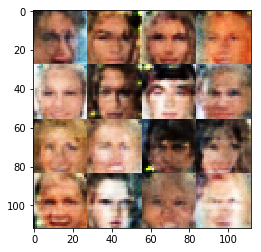

Epoch 1/1... Discriminator Loss: 0.8770... Generator Loss: 0.8159
Epoch 1/1... Discriminator Loss: 0.2464... Generator Loss: 3.0789
Epoch 1/1... Discriminator Loss: 0.5108... Generator Loss: 1.6463
Epoch 1/1... Discriminator Loss: 0.5796... Generator Loss: 1.4183
Epoch 1/1... Discriminator Loss: 0.1863... Generator Loss: 3.1191
Epoch 1/1... Discriminator Loss: 0.5912... Generator Loss: 1.3416
Epoch 1/1... Discriminator Loss: 0.1629... Generator Loss: 3.8026
Epoch 1/1... Discriminator Loss: 0.1522... Generator Loss: 3.7497
Epoch 1/1... Discriminator Loss: 0.3792... Generator Loss: 1.6628
Epoch 1/1... Discriminator Loss: 0.1168... Generator Loss: 3.2684


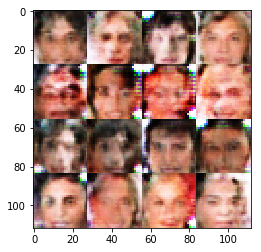

Epoch 1/1... Discriminator Loss: 0.1406... Generator Loss: 2.4970
Epoch 1/1... Discriminator Loss: 0.2428... Generator Loss: 1.9429
Epoch 1/1... Discriminator Loss: 0.3070... Generator Loss: 1.5701
Epoch 1/1... Discriminator Loss: 0.7013... Generator Loss: 0.8713
Epoch 1/1... Discriminator Loss: 0.3274... Generator Loss: 2.3568
Epoch 1/1... Discriminator Loss: 0.6550... Generator Loss: 2.0979
Epoch 1/1... Discriminator Loss: 1.0525... Generator Loss: 1.7838
Epoch 1/1... Discriminator Loss: 2.1902... Generator Loss: 0.1507
Epoch 1/1... Discriminator Loss: 0.6100... Generator Loss: 2.1919
Epoch 1/1... Discriminator Loss: 0.5640... Generator Loss: 1.9636


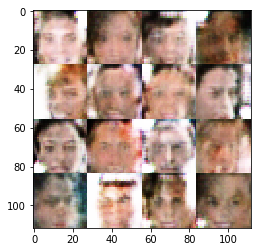

Epoch 1/1... Discriminator Loss: 0.7491... Generator Loss: 1.0096
Epoch 1/1... Discriminator Loss: 0.1931... Generator Loss: 3.1589
Epoch 1/1... Discriminator Loss: 0.2201... Generator Loss: 2.6562
Epoch 1/1... Discriminator Loss: 0.4753... Generator Loss: 1.3904
Epoch 1/1... Discriminator Loss: 1.0833... Generator Loss: 0.5666
Epoch 1/1... Discriminator Loss: 0.5046... Generator Loss: 1.5044
Epoch 1/1... Discriminator Loss: 0.7640... Generator Loss: 2.0922
Epoch 1/1... Discriminator Loss: 0.8693... Generator Loss: 1.2524
Epoch 1/1... Discriminator Loss: 2.3502... Generator Loss: 0.1323
Epoch 1/1... Discriminator Loss: 2.0987... Generator Loss: 2.6991


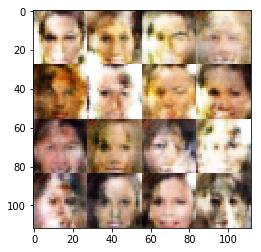

Epoch 1/1... Discriminator Loss: 1.1265... Generator Loss: 0.7627
Epoch 1/1... Discriminator Loss: 1.5672... Generator Loss: 0.3311
Epoch 1/1... Discriminator Loss: 0.7703... Generator Loss: 1.7132
Epoch 1/1... Discriminator Loss: 1.3762... Generator Loss: 0.4621
Epoch 1/1... Discriminator Loss: 1.2903... Generator Loss: 1.4652
Epoch 1/1... Discriminator Loss: 1.6745... Generator Loss: 0.3320
Epoch 1/1... Discriminator Loss: 1.0925... Generator Loss: 1.2814
Epoch 1/1... Discriminator Loss: 0.7299... Generator Loss: 1.6454
Epoch 1/1... Discriminator Loss: 1.2025... Generator Loss: 0.6968
Epoch 1/1... Discriminator Loss: 0.9061... Generator Loss: 1.0310


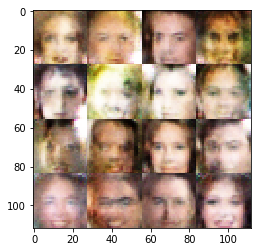

Epoch 1/1... Discriminator Loss: 1.0675... Generator Loss: 1.1709
Epoch 1/1... Discriminator Loss: 1.0967... Generator Loss: 0.7403
Epoch 1/1... Discriminator Loss: 0.7524... Generator Loss: 1.7565
Epoch 1/1... Discriminator Loss: 1.4313... Generator Loss: 0.5195
Epoch 1/1... Discriminator Loss: 0.9923... Generator Loss: 1.7481
Epoch 1/1... Discriminator Loss: 0.6631... Generator Loss: 1.3390
Epoch 1/1... Discriminator Loss: 0.9925... Generator Loss: 0.8936
Epoch 1/1... Discriminator Loss: 0.8473... Generator Loss: 1.1153
Epoch 1/1... Discriminator Loss: 0.6978... Generator Loss: 1.9354
Epoch 1/1... Discriminator Loss: 0.5120... Generator Loss: 1.6181


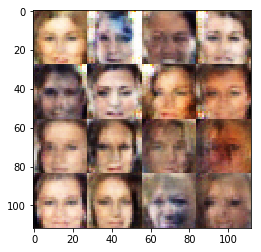

Epoch 1/1... Discriminator Loss: 1.4109... Generator Loss: 0.4352
Epoch 1/1... Discriminator Loss: 0.9399... Generator Loss: 2.1170
Epoch 1/1... Discriminator Loss: 0.9024... Generator Loss: 1.0511
Epoch 1/1... Discriminator Loss: 1.1377... Generator Loss: 0.6035
Epoch 1/1... Discriminator Loss: 0.6694... Generator Loss: 1.9290
Epoch 1/1... Discriminator Loss: 0.3625... Generator Loss: 2.6504
Epoch 1/1... Discriminator Loss: 0.5677... Generator Loss: 1.0996
Epoch 1/1... Discriminator Loss: 1.8288... Generator Loss: 0.2297
Epoch 1/1... Discriminator Loss: 0.4808... Generator Loss: 1.5473
Epoch 1/1... Discriminator Loss: 1.1497... Generator Loss: 3.5275


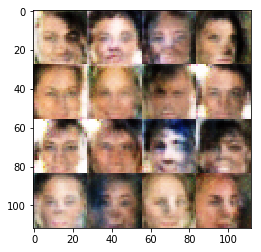

Epoch 1/1... Discriminator Loss: 1.3302... Generator Loss: 1.7660
Epoch 1/1... Discriminator Loss: 1.7111... Generator Loss: 0.2952
Epoch 1/1... Discriminator Loss: 1.0378... Generator Loss: 0.8878
Epoch 1/1... Discriminator Loss: 1.4872... Generator Loss: 1.4608
Epoch 1/1... Discriminator Loss: 1.0015... Generator Loss: 0.7790
Epoch 1/1... Discriminator Loss: 1.1935... Generator Loss: 0.5749
Epoch 1/1... Discriminator Loss: 1.1527... Generator Loss: 1.3032
Epoch 1/1... Discriminator Loss: 0.8414... Generator Loss: 1.1536
Epoch 1/1... Discriminator Loss: 0.2759... Generator Loss: 2.7098
Epoch 1/1... Discriminator Loss: 1.0712... Generator Loss: 0.6151


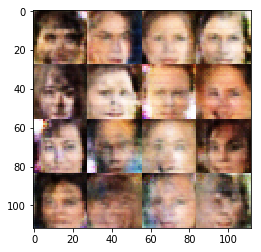

Epoch 1/1... Discriminator Loss: 0.7142... Generator Loss: 0.9599
Epoch 1/1... Discriminator Loss: 0.9390... Generator Loss: 1.2753
Epoch 1/1... Discriminator Loss: 0.6652... Generator Loss: 1.0804
Epoch 1/1... Discriminator Loss: 0.4382... Generator Loss: 1.4448
Epoch 1/1... Discriminator Loss: 0.5425... Generator Loss: 1.9067
Epoch 1/1... Discriminator Loss: 1.2663... Generator Loss: 0.4967
Epoch 1/1... Discriminator Loss: 0.9389... Generator Loss: 1.5781
Epoch 1/1... Discriminator Loss: 1.6768... Generator Loss: 0.2992
Epoch 1/1... Discriminator Loss: 0.9356... Generator Loss: 2.4981
Epoch 1/1... Discriminator Loss: 1.1224... Generator Loss: 0.6178


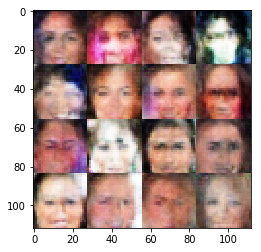

Epoch 1/1... Discriminator Loss: 1.1175... Generator Loss: 0.5580
Epoch 1/1... Discriminator Loss: 0.9743... Generator Loss: 2.0640
Epoch 1/1... Discriminator Loss: 0.8737... Generator Loss: 1.2429
Epoch 1/1... Discriminator Loss: 1.3662... Generator Loss: 0.5190
Epoch 1/1... Discriminator Loss: 1.1048... Generator Loss: 1.4417
Epoch 1/1... Discriminator Loss: 1.1377... Generator Loss: 0.7277
Epoch 1/1... Discriminator Loss: 1.0509... Generator Loss: 0.9054
Epoch 1/1... Discriminator Loss: 1.5853... Generator Loss: 0.5108
Epoch 1/1... Discriminator Loss: 1.1053... Generator Loss: 1.4161
Epoch 1/1... Discriminator Loss: 0.3193... Generator Loss: 3.7267


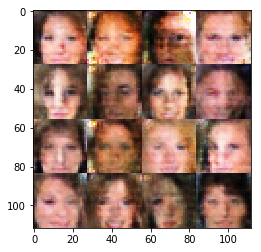

Epoch 1/1... Discriminator Loss: 1.9788... Generator Loss: 0.1880
Epoch 1/1... Discriminator Loss: 0.5171... Generator Loss: 3.0246
Epoch 1/1... Discriminator Loss: 0.4008... Generator Loss: 2.5216
Epoch 1/1... Discriminator Loss: 0.6238... Generator Loss: 1.0929
Epoch 1/1... Discriminator Loss: 0.7107... Generator Loss: 0.9479
Epoch 1/1... Discriminator Loss: 1.0908... Generator Loss: 2.5187
Epoch 1/1... Discriminator Loss: 1.2086... Generator Loss: 1.8031
Epoch 1/1... Discriminator Loss: 1.0255... Generator Loss: 0.9501
Epoch 1/1... Discriminator Loss: 1.1253... Generator Loss: 1.3570
Epoch 1/1... Discriminator Loss: 1.3230... Generator Loss: 0.5297


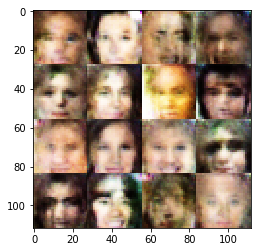

Epoch 1/1... Discriminator Loss: 0.8935... Generator Loss: 1.3159
Epoch 1/1... Discriminator Loss: 0.9735... Generator Loss: 0.8373
Epoch 1/1... Discriminator Loss: 0.9013... Generator Loss: 1.1328
Epoch 1/1... Discriminator Loss: 1.0935... Generator Loss: 0.9597
Epoch 1/1... Discriminator Loss: 1.4184... Generator Loss: 0.4317
Epoch 1/1... Discriminator Loss: 1.5720... Generator Loss: 1.7938
Epoch 1/1... Discriminator Loss: 0.7874... Generator Loss: 1.4048
Epoch 1/1... Discriminator Loss: 0.7991... Generator Loss: 0.9791
Epoch 1/1... Discriminator Loss: 1.0133... Generator Loss: 0.7273
Epoch 1/1... Discriminator Loss: 1.2155... Generator Loss: 1.3456


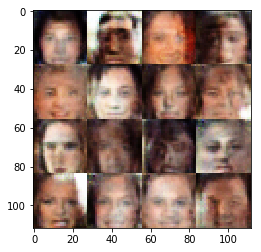

Epoch 1/1... Discriminator Loss: 1.2227... Generator Loss: 0.5736
Epoch 1/1... Discriminator Loss: 0.9799... Generator Loss: 0.7210
Epoch 1/1... Discriminator Loss: 0.8550... Generator Loss: 2.5788
Epoch 1/1... Discriminator Loss: 0.6241... Generator Loss: 1.1068
Epoch 1/1... Discriminator Loss: 1.3438... Generator Loss: 1.7447
Epoch 1/1... Discriminator Loss: 1.7583... Generator Loss: 0.2473
Epoch 1/1... Discriminator Loss: 1.1994... Generator Loss: 1.3438
Epoch 1/1... Discriminator Loss: 1.1458... Generator Loss: 0.6890
Epoch 1/1... Discriminator Loss: 1.1438... Generator Loss: 0.6988
Epoch 1/1... Discriminator Loss: 1.0020... Generator Loss: 0.9542


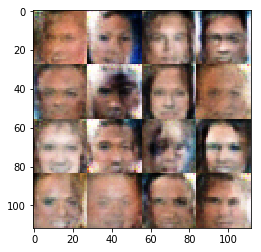

Epoch 1/1... Discriminator Loss: 1.2944... Generator Loss: 0.5667
Epoch 1/1... Discriminator Loss: 1.0873... Generator Loss: 0.7429
Epoch 1/1... Discriminator Loss: 0.5351... Generator Loss: 3.0701
Epoch 1/1... Discriminator Loss: 1.2358... Generator Loss: 0.5858
Epoch 1/1... Discriminator Loss: 1.4233... Generator Loss: 0.4093
Epoch 1/1... Discriminator Loss: 0.9804... Generator Loss: 1.3129
Epoch 1/1... Discriminator Loss: 1.3027... Generator Loss: 0.7190
Epoch 1/1... Discriminator Loss: 1.1169... Generator Loss: 0.8082
Epoch 1/1... Discriminator Loss: 0.7730... Generator Loss: 1.1971
Epoch 1/1... Discriminator Loss: 0.6417... Generator Loss: 1.3002


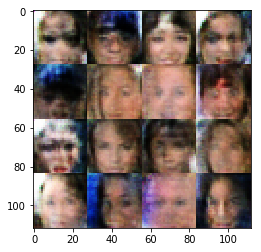

Epoch 1/1... Discriminator Loss: 0.1727... Generator Loss: 3.2579
Epoch 1/1... Discriminator Loss: 1.3445... Generator Loss: 0.4343
Epoch 1/1... Discriminator Loss: 0.4401... Generator Loss: 2.9838
Epoch 1/1... Discriminator Loss: 0.2938... Generator Loss: 2.8460
Epoch 1/1... Discriminator Loss: 0.8198... Generator Loss: 0.8438
Epoch 1/1... Discriminator Loss: 0.9986... Generator Loss: 0.7153
Epoch 1/1... Discriminator Loss: 0.5227... Generator Loss: 2.1115
Epoch 1/1... Discriminator Loss: 0.6047... Generator Loss: 1.2679
Epoch 1/1... Discriminator Loss: 0.3653... Generator Loss: 2.3134
Epoch 1/1... Discriminator Loss: 1.0846... Generator Loss: 0.5568


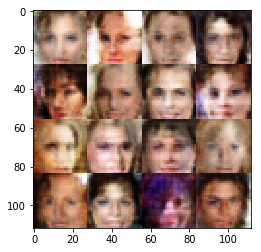

Epoch 1/1... Discriminator Loss: 0.6577... Generator Loss: 1.6317
Epoch 1/1... Discriminator Loss: 1.1381... Generator Loss: 0.5129
Epoch 1/1... Discriminator Loss: 1.0592... Generator Loss: 2.3362
Epoch 1/1... Discriminator Loss: 0.8526... Generator Loss: 0.9017
Epoch 1/1... Discriminator Loss: 0.7396... Generator Loss: 2.0518
Epoch 1/1... Discriminator Loss: 0.8086... Generator Loss: 0.8215
Epoch 1/1... Discriminator Loss: 0.7048... Generator Loss: 1.1606
Epoch 1/1... Discriminator Loss: 0.5301... Generator Loss: 1.9136
Epoch 1/1... Discriminator Loss: 0.3978... Generator Loss: 1.7531
Epoch 1/1... Discriminator Loss: 0.2719... Generator Loss: 2.1807


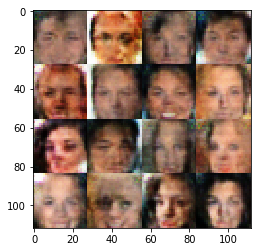

Epoch 1/1... Discriminator Loss: 0.2631... Generator Loss: 1.9177
Epoch 1/1... Discriminator Loss: 1.8979... Generator Loss: 0.2108
Epoch 1/1... Discriminator Loss: 0.8873... Generator Loss: 3.0010
Epoch 1/1... Discriminator Loss: 1.2839... Generator Loss: 0.5395
Epoch 1/1... Discriminator Loss: 3.3644... Generator Loss: 3.1387
Epoch 1/1... Discriminator Loss: 2.2939... Generator Loss: 0.1652
Epoch 1/1... Discriminator Loss: 0.9670... Generator Loss: 1.4956
Epoch 1/1... Discriminator Loss: 1.1068... Generator Loss: 0.7250
Epoch 1/1... Discriminator Loss: 0.8900... Generator Loss: 0.9985
Epoch 1/1... Discriminator Loss: 0.8443... Generator Loss: 1.2149


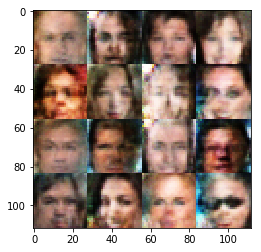

Epoch 1/1... Discriminator Loss: 0.3612... Generator Loss: 2.6500
Epoch 1/1... Discriminator Loss: 0.9221... Generator Loss: 0.8708
Epoch 1/1... Discriminator Loss: 0.7237... Generator Loss: 1.3435
Epoch 1/1... Discriminator Loss: 0.4180... Generator Loss: 2.3360
Epoch 1/1... Discriminator Loss: 1.2295... Generator Loss: 0.5079
Epoch 1/1... Discriminator Loss: 0.7966... Generator Loss: 1.8451
Epoch 1/1... Discriminator Loss: 0.1754... Generator Loss: 4.0344
Epoch 1/1... Discriminator Loss: 0.5075... Generator Loss: 1.3266
Epoch 1/1... Discriminator Loss: 0.4463... Generator Loss: 1.3940
Epoch 1/1... Discriminator Loss: 0.8717... Generator Loss: 1.2470


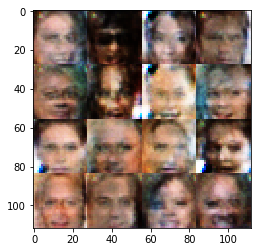

Epoch 1/1... Discriminator Loss: 0.2435... Generator Loss: 3.1452
Epoch 1/1... Discriminator Loss: 0.5104... Generator Loss: 1.5660
Epoch 1/1... Discriminator Loss: 0.5256... Generator Loss: 1.1605
Epoch 1/1... Discriminator Loss: 0.4571... Generator Loss: 1.6927
Epoch 1/1... Discriminator Loss: 0.4361... Generator Loss: 1.7612
Epoch 1/1... Discriminator Loss: 0.7271... Generator Loss: 1.6083
Epoch 1/1... Discriminator Loss: 0.5650... Generator Loss: 1.2694
Epoch 1/1... Discriminator Loss: 0.8894... Generator Loss: 1.9609
Epoch 1/1... Discriminator Loss: 0.9870... Generator Loss: 0.6109
Epoch 1/1... Discriminator Loss: 1.3967... Generator Loss: 2.1932


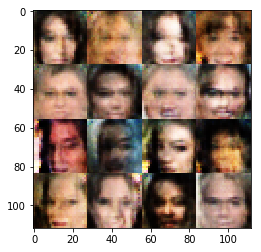

Epoch 1/1... Discriminator Loss: 1.0113... Generator Loss: 0.7972
Epoch 1/1... Discriminator Loss: 0.9516... Generator Loss: 0.8383
Epoch 1/1... Discriminator Loss: 1.3202... Generator Loss: 1.1732
Epoch 1/1... Discriminator Loss: 0.5189... Generator Loss: 2.1389
Epoch 1/1... Discriminator Loss: 0.1698... Generator Loss: 4.3510
Epoch 1/1... Discriminator Loss: 0.1779... Generator Loss: 2.4855
Epoch 1/1... Discriminator Loss: 1.2545... Generator Loss: 0.4673
Epoch 1/1... Discriminator Loss: 0.4766... Generator Loss: 1.3580
Epoch 1/1... Discriminator Loss: 0.2590... Generator Loss: 3.4399
Epoch 1/1... Discriminator Loss: 0.1785... Generator Loss: 2.8741


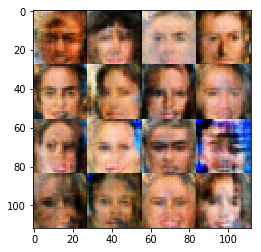

Epoch 1/1... Discriminator Loss: 0.5751... Generator Loss: 1.2372
Epoch 1/1... Discriminator Loss: 0.4293... Generator Loss: 1.4846
Epoch 1/1... Discriminator Loss: 0.4286... Generator Loss: 1.7400
Epoch 1/1... Discriminator Loss: 0.2674... Generator Loss: 2.4135
Epoch 1/1... Discriminator Loss: 0.9406... Generator Loss: 0.6622
Epoch 1/1... Discriminator Loss: 1.7046... Generator Loss: 3.9710
Epoch 1/1... Discriminator Loss: 1.7045... Generator Loss: 0.4313
Epoch 1/1... Discriminator Loss: 1.6972... Generator Loss: 0.9397
Epoch 1/1... Discriminator Loss: 1.9215... Generator Loss: 0.4988
Epoch 1/1... Discriminator Loss: 1.2805... Generator Loss: 1.0037


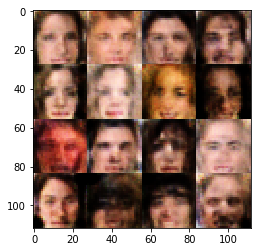

Epoch 1/1... Discriminator Loss: 1.2341... Generator Loss: 1.8071
Epoch 1/1... Discriminator Loss: 1.6409... Generator Loss: 0.3351
Epoch 1/1... Discriminator Loss: 0.9354... Generator Loss: 1.3538
Epoch 1/1... Discriminator Loss: 0.9954... Generator Loss: 1.0198
Epoch 1/1... Discriminator Loss: 1.3113... Generator Loss: 0.5368
Epoch 1/1... Discriminator Loss: 1.0822... Generator Loss: 0.9624
Epoch 1/1... Discriminator Loss: 1.2098... Generator Loss: 0.7465
Epoch 1/1... Discriminator Loss: 1.1898... Generator Loss: 0.7389
Epoch 1/1... Discriminator Loss: 1.0983... Generator Loss: 0.6026
Epoch 1/1... Discriminator Loss: 0.9981... Generator Loss: 2.0732


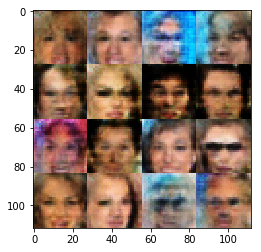

Epoch 1/1... Discriminator Loss: 1.2006... Generator Loss: 0.5751
Epoch 1/1... Discriminator Loss: 1.0319... Generator Loss: 0.7822
Epoch 1/1... Discriminator Loss: 1.1404... Generator Loss: 1.1677
Epoch 1/1... Discriminator Loss: 1.0655... Generator Loss: 0.8673
Epoch 1/1... Discriminator Loss: 1.1634... Generator Loss: 0.7623
Epoch 1/1... Discriminator Loss: 0.9317... Generator Loss: 0.8141
Epoch 1/1... Discriminator Loss: 0.9000... Generator Loss: 1.0557
Epoch 1/1... Discriminator Loss: 1.0587... Generator Loss: 0.8135
Epoch 1/1... Discriminator Loss: 1.1909... Generator Loss: 0.5578
Epoch 1/1... Discriminator Loss: 1.2127... Generator Loss: 1.0123


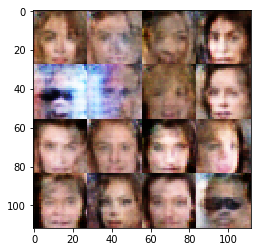

Epoch 1/1... Discriminator Loss: 0.9374... Generator Loss: 0.7491
Epoch 1/1... Discriminator Loss: 1.1666... Generator Loss: 1.0547
Epoch 1/1... Discriminator Loss: 1.1184... Generator Loss: 0.5779
Epoch 1/1... Discriminator Loss: 1.2241... Generator Loss: 1.6752
Epoch 1/1... Discriminator Loss: 1.3285... Generator Loss: 0.4234
Epoch 1/1... Discriminator Loss: 1.0366... Generator Loss: 1.5626
Epoch 1/1... Discriminator Loss: 0.6829... Generator Loss: 1.5386
Epoch 1/1... Discriminator Loss: 0.9204... Generator Loss: 0.7107
Epoch 1/1... Discriminator Loss: 1.1878... Generator Loss: 0.8430
Epoch 1/1... Discriminator Loss: 1.7294... Generator Loss: 1.7423


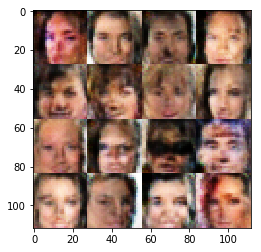

Epoch 1/1... Discriminator Loss: 1.4958... Generator Loss: 0.3266
Epoch 1/1... Discriminator Loss: 1.2159... Generator Loss: 1.1587
Epoch 1/1... Discriminator Loss: 1.1842... Generator Loss: 0.9199
Epoch 1/1... Discriminator Loss: 1.3187... Generator Loss: 0.5758
Epoch 1/1... Discriminator Loss: 1.1415... Generator Loss: 0.7584
Epoch 1/1... Discriminator Loss: 1.1818... Generator Loss: 0.8417
Epoch 1/1... Discriminator Loss: 0.5191... Generator Loss: 2.4700
Epoch 1/1... Discriminator Loss: 0.9402... Generator Loss: 0.6759
Epoch 1/1... Discriminator Loss: 1.1122... Generator Loss: 0.6545
Epoch 1/1... Discriminator Loss: 0.8849... Generator Loss: 1.0848


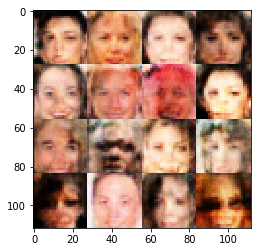

Epoch 1/1... Discriminator Loss: 0.7787... Generator Loss: 1.0652
Epoch 1/1... Discriminator Loss: 0.5852... Generator Loss: 1.6462
Epoch 1/1... Discriminator Loss: 1.0069... Generator Loss: 0.6683
Epoch 1/1... Discriminator Loss: 0.9919... Generator Loss: 1.1385
Epoch 1/1... Discriminator Loss: 1.4244... Generator Loss: 0.5608
Epoch 1/1... Discriminator Loss: 1.1546... Generator Loss: 1.8690
Epoch 1/1... Discriminator Loss: 1.5933... Generator Loss: 0.3835
Epoch 1/1... Discriminator Loss: 1.1396... Generator Loss: 0.8281
Epoch 1/1... Discriminator Loss: 1.1294... Generator Loss: 0.8375
Epoch 1/1... Discriminator Loss: 1.0027... Generator Loss: 0.6285


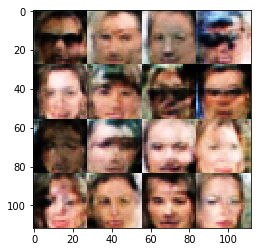

Epoch 1/1... Discriminator Loss: 0.8316... Generator Loss: 1.7998
Epoch 1/1... Discriminator Loss: 1.1395... Generator Loss: 0.6018
Epoch 1/1... Discriminator Loss: 1.3003... Generator Loss: 0.5357
Epoch 1/1... Discriminator Loss: 1.1128... Generator Loss: 1.3049
Epoch 1/1... Discriminator Loss: 1.0856... Generator Loss: 0.6360
Epoch 1/1... Discriminator Loss: 0.9652... Generator Loss: 1.3060
Epoch 1/1... Discriminator Loss: 1.3463... Generator Loss: 0.5198
Epoch 1/1... Discriminator Loss: 1.1633... Generator Loss: 0.8435
Epoch 1/1... Discriminator Loss: 1.3048... Generator Loss: 0.5233
Epoch 1/1... Discriminator Loss: 1.0538... Generator Loss: 1.1702


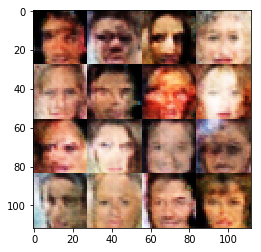

Epoch 1/1... Discriminator Loss: 1.0962... Generator Loss: 0.8026
Epoch 1/1... Discriminator Loss: 1.4346... Generator Loss: 0.4612
Epoch 1/1... Discriminator Loss: 0.5623... Generator Loss: 1.7707
Epoch 1/1... Discriminator Loss: 0.8141... Generator Loss: 1.3199
Epoch 1/1... Discriminator Loss: 1.7273... Generator Loss: 0.2812
Epoch 1/1... Discriminator Loss: 1.7896... Generator Loss: 2.2447
Epoch 1/1... Discriminator Loss: 1.5065... Generator Loss: 0.3847
Epoch 1/1... Discriminator Loss: 1.5921... Generator Loss: 1.1566
Epoch 1/1... Discriminator Loss: 1.5608... Generator Loss: 0.3630
Epoch 1/1... Discriminator Loss: 1.1775... Generator Loss: 0.7423


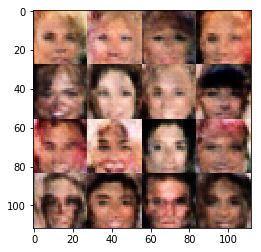

Epoch 1/1... Discriminator Loss: 1.2068... Generator Loss: 0.9758
Epoch 1/1... Discriminator Loss: 0.9767... Generator Loss: 0.7951
Epoch 1/1... Discriminator Loss: 1.4177... Generator Loss: 0.4366
Epoch 1/1... Discriminator Loss: 0.8243... Generator Loss: 1.2286
Epoch 1/1... Discriminator Loss: 0.5778... Generator Loss: 1.6337
Epoch 1/1... Discriminator Loss: 1.7899... Generator Loss: 0.2523
Epoch 1/1... Discriminator Loss: 0.9784... Generator Loss: 1.5545
Epoch 1/1... Discriminator Loss: 0.8024... Generator Loss: 0.8412
Epoch 1/1... Discriminator Loss: 1.7129... Generator Loss: 0.2720
Epoch 1/1... Discriminator Loss: 2.4920... Generator Loss: 3.2209


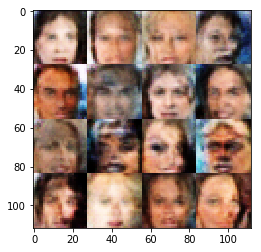

Epoch 1/1... Discriminator Loss: 1.1142... Generator Loss: 0.8749
Epoch 1/1... Discriminator Loss: 1.2837... Generator Loss: 0.4401
Epoch 1/1... Discriminator Loss: 0.8926... Generator Loss: 1.3787
Epoch 1/1... Discriminator Loss: 0.8902... Generator Loss: 1.0369
Epoch 1/1... Discriminator Loss: 1.7049... Generator Loss: 0.2730
Epoch 1/1... Discriminator Loss: 1.3919... Generator Loss: 1.3937
Epoch 1/1... Discriminator Loss: 1.0651... Generator Loss: 0.6075
Epoch 1/1... Discriminator Loss: 1.2696... Generator Loss: 1.0568
Epoch 1/1... Discriminator Loss: 1.1580... Generator Loss: 0.6892
Epoch 1/1... Discriminator Loss: 0.8243... Generator Loss: 0.9460


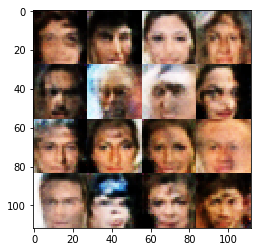

Epoch 1/1... Discriminator Loss: 0.7966... Generator Loss: 1.3775
Epoch 1/1... Discriminator Loss: 1.4778... Generator Loss: 0.4463
Epoch 1/1... Discriminator Loss: 1.2799... Generator Loss: 0.6116
Epoch 1/1... Discriminator Loss: 1.2595... Generator Loss: 0.8981
Epoch 1/1... Discriminator Loss: 1.3798... Generator Loss: 0.5614
Epoch 1/1... Discriminator Loss: 1.2883... Generator Loss: 0.6508
Epoch 1/1... Discriminator Loss: 1.2536... Generator Loss: 0.8455
Epoch 1/1... Discriminator Loss: 1.5075... Generator Loss: 0.4071
Epoch 1/1... Discriminator Loss: 0.8808... Generator Loss: 1.2533
Epoch 1/1... Discriminator Loss: 0.3823... Generator Loss: 2.8911


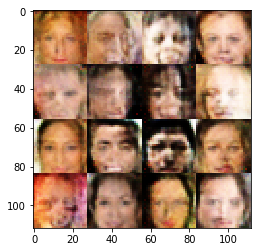

Epoch 1/1... Discriminator Loss: 1.0046... Generator Loss: 0.5773
Epoch 1/1... Discriminator Loss: 1.2253... Generator Loss: 0.4848
Epoch 1/1... Discriminator Loss: 1.0615... Generator Loss: 2.0983
Epoch 1/1... Discriminator Loss: 1.0432... Generator Loss: 1.0243
Epoch 1/1... Discriminator Loss: 1.3176... Generator Loss: 0.4845
Epoch 1/1... Discriminator Loss: 1.1347... Generator Loss: 0.8817
Epoch 1/1... Discriminator Loss: 1.3164... Generator Loss: 0.6199
Epoch 1/1... Discriminator Loss: 1.2637... Generator Loss: 0.7061
Epoch 1/1... Discriminator Loss: 1.1773... Generator Loss: 0.7996
Epoch 1/1... Discriminator Loss: 1.2281... Generator Loss: 0.6358


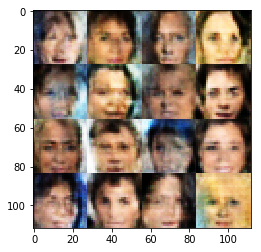

Epoch 1/1... Discriminator Loss: 0.9672... Generator Loss: 0.8324
Epoch 1/1... Discriminator Loss: 1.2819... Generator Loss: 1.7052
Epoch 1/1... Discriminator Loss: 1.6544... Generator Loss: 0.2797
Epoch 1/1... Discriminator Loss: 1.0714... Generator Loss: 1.1501
Epoch 1/1... Discriminator Loss: 0.6075... Generator Loss: 1.5502
Epoch 1/1... Discriminator Loss: 1.2924... Generator Loss: 0.4533
Epoch 1/1... Discriminator Loss: 0.9630... Generator Loss: 0.9912
Epoch 1/1... Discriminator Loss: 1.1080... Generator Loss: 0.7679
Epoch 1/1... Discriminator Loss: 1.3638... Generator Loss: 1.0773
Epoch 1/1... Discriminator Loss: 1.4026... Generator Loss: 0.4389


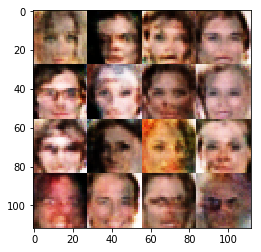

Epoch 1/1... Discriminator Loss: 1.0003... Generator Loss: 1.3685
Epoch 1/1... Discriminator Loss: 1.4745... Generator Loss: 0.4848
Epoch 1/1... Discriminator Loss: 1.4118... Generator Loss: 0.4273
Epoch 1/1... Discriminator Loss: 1.0780... Generator Loss: 1.2068
Epoch 1/1... Discriminator Loss: 1.2132... Generator Loss: 0.6642
Epoch 1/1... Discriminator Loss: 0.8984... Generator Loss: 1.4307
Epoch 1/1... Discriminator Loss: 1.2754... Generator Loss: 0.4610
Epoch 1/1... Discriminator Loss: 1.0264... Generator Loss: 1.6080
Epoch 1/1... Discriminator Loss: 1.3714... Generator Loss: 0.4642
Epoch 1/1... Discriminator Loss: 1.2338... Generator Loss: 0.8182


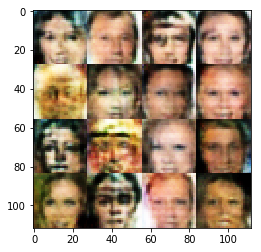

Epoch 1/1... Discriminator Loss: 1.0808... Generator Loss: 0.9224
Epoch 1/1... Discriminator Loss: 1.1252... Generator Loss: 0.7019
Epoch 1/1... Discriminator Loss: 1.3000... Generator Loss: 1.0493
Epoch 1/1... Discriminator Loss: 0.7930... Generator Loss: 0.9672
Epoch 1/1... Discriminator Loss: 0.8358... Generator Loss: 0.9929
Epoch 1/1... Discriminator Loss: 0.6615... Generator Loss: 1.3207
Epoch 1/1... Discriminator Loss: 0.7235... Generator Loss: 1.4313
Epoch 1/1... Discriminator Loss: 1.1725... Generator Loss: 0.6538
Epoch 1/1... Discriminator Loss: 1.8353... Generator Loss: 1.4571
Epoch 1/1... Discriminator Loss: 1.6097... Generator Loss: 0.2889


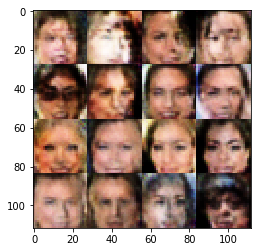

Epoch 1/1... Discriminator Loss: 1.4916... Generator Loss: 1.4968
Epoch 1/1... Discriminator Loss: 1.1214... Generator Loss: 0.7143
Epoch 1/1... Discriminator Loss: 1.1413... Generator Loss: 0.6528
Epoch 1/1... Discriminator Loss: 1.2018... Generator Loss: 0.6774
Epoch 1/1... Discriminator Loss: 1.1354... Generator Loss: 0.8192
Epoch 1/1... Discriminator Loss: 1.3911... Generator Loss: 0.4414
Epoch 1/1... Discriminator Loss: 1.4187... Generator Loss: 1.5506
Epoch 1/1... Discriminator Loss: 1.2076... Generator Loss: 0.5219
Epoch 1/1... Discriminator Loss: 1.2955... Generator Loss: 1.0485
Epoch 1/1... Discriminator Loss: 1.3664... Generator Loss: 0.6987


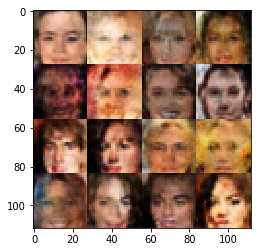

Epoch 1/1... Discriminator Loss: 1.7122... Generator Loss: 0.3017
Epoch 1/1... Discriminator Loss: 1.2825... Generator Loss: 1.1518
Epoch 1/1... Discriminator Loss: 1.1452... Generator Loss: 0.7515
Epoch 1/1... Discriminator Loss: 1.1051... Generator Loss: 0.7278
Epoch 1/1... Discriminator Loss: 1.0111... Generator Loss: 1.1680
Epoch 1/1... Discriminator Loss: 0.9878... Generator Loss: 0.8802
Epoch 1/1... Discriminator Loss: 1.1919... Generator Loss: 0.7812
Epoch 1/1... Discriminator Loss: 1.0909... Generator Loss: 0.9840
Epoch 1/1... Discriminator Loss: 1.3513... Generator Loss: 0.4511
Epoch 1/1... Discriminator Loss: 0.8589... Generator Loss: 2.1460


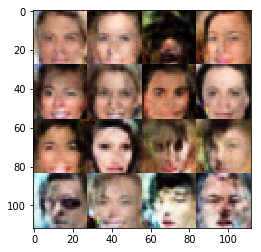

Epoch 1/1... Discriminator Loss: 0.9767... Generator Loss: 0.7517
Epoch 1/1... Discriminator Loss: 1.3695... Generator Loss: 0.5172
Epoch 1/1... Discriminator Loss: 1.1341... Generator Loss: 1.2812
Epoch 1/1... Discriminator Loss: 1.7225... Generator Loss: 0.2728
Epoch 1/1... Discriminator Loss: 1.2265... Generator Loss: 0.9308
Epoch 1/1... Discriminator Loss: 1.0676... Generator Loss: 1.1496
Epoch 1/1... Discriminator Loss: 1.4095... Generator Loss: 0.4220
Epoch 1/1... Discriminator Loss: 1.1135... Generator Loss: 1.0067
Epoch 1/1... Discriminator Loss: 1.0984... Generator Loss: 0.8260
Epoch 1/1... Discriminator Loss: 1.1666... Generator Loss: 0.5343


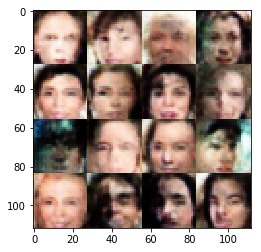

Epoch 1/1... Discriminator Loss: 1.4803... Generator Loss: 1.2576
Epoch 1/1... Discriminator Loss: 0.9895... Generator Loss: 0.8875
Epoch 1/1... Discriminator Loss: 1.3559... Generator Loss: 0.4315
Epoch 1/1... Discriminator Loss: 1.4257... Generator Loss: 0.8437
Epoch 1/1... Discriminator Loss: 1.1724... Generator Loss: 0.8018
Epoch 1/1... Discriminator Loss: 1.1181... Generator Loss: 0.7087
Epoch 1/1... Discriminator Loss: 1.2257... Generator Loss: 0.7105
Epoch 1/1... Discriminator Loss: 0.7702... Generator Loss: 1.6646
Epoch 1/1... Discriminator Loss: 0.5161... Generator Loss: 1.4305
Epoch 1/1... Discriminator Loss: 1.5780... Generator Loss: 0.3288


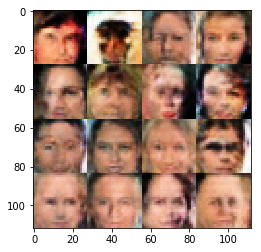

Epoch 1/1... Discriminator Loss: 2.0095... Generator Loss: 2.2075
Epoch 1/1... Discriminator Loss: 1.6344... Generator Loss: 0.3765
Epoch 1/1... Discriminator Loss: 1.1025... Generator Loss: 0.9512
Epoch 1/1... Discriminator Loss: 1.3711... Generator Loss: 0.7135
Epoch 1/1... Discriminator Loss: 1.0456... Generator Loss: 0.7222
Epoch 1/1... Discriminator Loss: 1.3996... Generator Loss: 0.6602
Epoch 1/1... Discriminator Loss: 0.9116... Generator Loss: 1.2591
Epoch 1/1... Discriminator Loss: 1.1202... Generator Loss: 0.6712
Epoch 1/1... Discriminator Loss: 1.5576... Generator Loss: 0.5090
Epoch 1/1... Discriminator Loss: 1.2870... Generator Loss: 1.1307


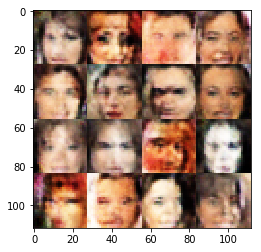

Epoch 1/1... Discriminator Loss: 1.3959... Generator Loss: 0.4263
Epoch 1/1... Discriminator Loss: 1.1804... Generator Loss: 0.6387
Epoch 1/1... Discriminator Loss: 1.7062... Generator Loss: 1.3873
Epoch 1/1... Discriminator Loss: 0.9061... Generator Loss: 0.8847
Epoch 1/1... Discriminator Loss: 1.4068... Generator Loss: 0.4025
Epoch 1/1... Discriminator Loss: 1.1141... Generator Loss: 0.8708
Epoch 1/1... Discriminator Loss: 1.4089... Generator Loss: 0.6636
Epoch 1/1... Discriminator Loss: 1.4592... Generator Loss: 0.4446
Epoch 1/1... Discriminator Loss: 1.3446... Generator Loss: 1.0207
Epoch 1/1... Discriminator Loss: 0.8500... Generator Loss: 1.2135


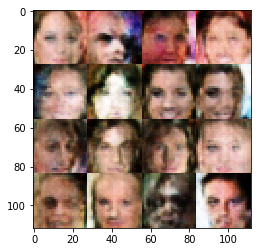

Epoch 1/1... Discriminator Loss: 1.1141... Generator Loss: 0.6339
Epoch 1/1... Discriminator Loss: 1.3231... Generator Loss: 0.6791
Epoch 1/1... Discriminator Loss: 0.8985... Generator Loss: 1.0769
Epoch 1/1... Discriminator Loss: 0.6036... Generator Loss: 1.7230
Epoch 1/1... Discriminator Loss: 0.7705... Generator Loss: 1.0464
Epoch 1/1... Discriminator Loss: 0.6639... Generator Loss: 1.3030
Epoch 1/1... Discriminator Loss: 1.0486... Generator Loss: 0.7432
Epoch 1/1... Discriminator Loss: 1.0001... Generator Loss: 1.0094
Epoch 1/1... Discriminator Loss: 1.4453... Generator Loss: 0.3787
Epoch 1/1... Discriminator Loss: 1.7033... Generator Loss: 1.8933


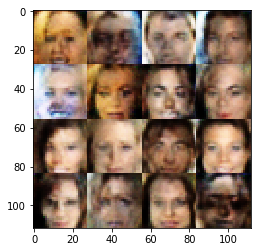

Epoch 1/1... Discriminator Loss: 1.2070... Generator Loss: 0.5291
Epoch 1/1... Discriminator Loss: 1.1839... Generator Loss: 0.6269
Epoch 1/1... Discriminator Loss: 1.1228... Generator Loss: 0.9900
Epoch 1/1... Discriminator Loss: 1.2010... Generator Loss: 0.6776
Epoch 1/1... Discriminator Loss: 1.1912... Generator Loss: 1.2292
Epoch 1/1... Discriminator Loss: 0.9241... Generator Loss: 0.6912
Epoch 1/1... Discriminator Loss: 1.1122... Generator Loss: 0.7168
Epoch 1/1... Discriminator Loss: 1.3109... Generator Loss: 1.0996
Epoch 1/1... Discriminator Loss: 1.2870... Generator Loss: 0.5081
Epoch 1/1... Discriminator Loss: 1.1673... Generator Loss: 0.9071


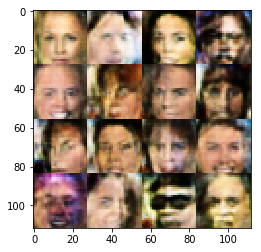

Epoch 1/1... Discriminator Loss: 1.3186... Generator Loss: 0.5468
Epoch 1/1... Discriminator Loss: 0.8240... Generator Loss: 1.5593
Epoch 1/1... Discriminator Loss: 0.8300... Generator Loss: 1.0481
Epoch 1/1... Discriminator Loss: 0.8783... Generator Loss: 0.8106
Epoch 1/1... Discriminator Loss: 0.9156... Generator Loss: 1.0335
Epoch 1/1... Discriminator Loss: 1.2826... Generator Loss: 0.8731
Epoch 1/1... Discriminator Loss: 1.1810... Generator Loss: 0.8332
Epoch 1/1... Discriminator Loss: 1.8275... Generator Loss: 0.2850
Epoch 1/1... Discriminator Loss: 1.5734... Generator Loss: 1.1539
Epoch 1/1... Discriminator Loss: 1.6388... Generator Loss: 0.3527


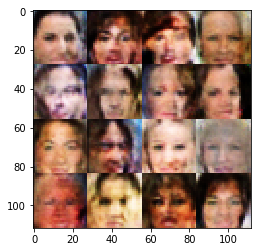

Epoch 1/1... Discriminator Loss: 1.1746... Generator Loss: 1.2253
Epoch 1/1... Discriminator Loss: 1.4753... Generator Loss: 0.4372
Epoch 1/1... Discriminator Loss: 1.3793... Generator Loss: 0.7423
Epoch 1/1... Discriminator Loss: 1.2550... Generator Loss: 0.5200
Epoch 1/1... Discriminator Loss: 0.9784... Generator Loss: 0.7994
Epoch 1/1... Discriminator Loss: 1.3110... Generator Loss: 0.7648
Epoch 1/1... Discriminator Loss: 1.4136... Generator Loss: 0.5841
Epoch 1/1... Discriminator Loss: 1.2825... Generator Loss: 0.7078
Epoch 1/1... Discriminator Loss: 1.6091... Generator Loss: 0.3749
Epoch 1/1... Discriminator Loss: 1.0629... Generator Loss: 1.4573


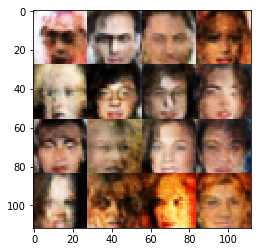

Epoch 1/1... Discriminator Loss: 1.1868... Generator Loss: 0.6233
Epoch 1/1... Discriminator Loss: 1.3008... Generator Loss: 0.7993
Epoch 1/1... Discriminator Loss: 0.9279... Generator Loss: 0.8447
Epoch 1/1... Discriminator Loss: 0.6071... Generator Loss: 2.1568
Epoch 1/1... Discriminator Loss: 1.5626... Generator Loss: 0.3207
Epoch 1/1... Discriminator Loss: 1.1788... Generator Loss: 1.4794
Epoch 1/1... Discriminator Loss: 1.1136... Generator Loss: 0.7074
Epoch 1/1... Discriminator Loss: 1.2070... Generator Loss: 0.6196
Epoch 1/1... Discriminator Loss: 1.0448... Generator Loss: 1.1480
Epoch 1/1... Discriminator Loss: 1.2218... Generator Loss: 0.8139


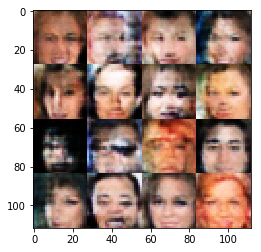

Epoch 1/1... Discriminator Loss: 0.8115... Generator Loss: 1.0927
Epoch 1/1... Discriminator Loss: 0.9954... Generator Loss: 0.9213
Epoch 1/1... Discriminator Loss: 1.0508... Generator Loss: 0.7813
Epoch 1/1... Discriminator Loss: 1.2729... Generator Loss: 0.6453
Epoch 1/1... Discriminator Loss: 1.3951... Generator Loss: 0.5114
Epoch 1/1... Discriminator Loss: 1.3864... Generator Loss: 1.3945
Epoch 1/1... Discriminator Loss: 1.4956... Generator Loss: 0.3693
Epoch 1/1... Discriminator Loss: 1.8372... Generator Loss: 1.3677
Epoch 1/1... Discriminator Loss: 2.1852... Generator Loss: 0.1573
Epoch 1/1... Discriminator Loss: 1.8379... Generator Loss: 1.3021


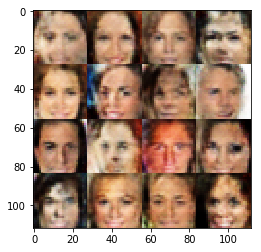

Epoch 1/1... Discriminator Loss: 1.6780... Generator Loss: 0.4352
Epoch 1/1... Discriminator Loss: 1.4897... Generator Loss: 0.4580
Epoch 1/1... Discriminator Loss: 1.2586... Generator Loss: 0.9286
Epoch 1/1... Discriminator Loss: 0.7256... Generator Loss: 1.8898
Epoch 1/1... Discriminator Loss: 0.3786... Generator Loss: 2.5203
Epoch 1/1... Discriminator Loss: 1.0075... Generator Loss: 0.6198
Epoch 1/1... Discriminator Loss: 0.6342... Generator Loss: 1.4983
Epoch 1/1... Discriminator Loss: 0.6997... Generator Loss: 1.4448
Epoch 1/1... Discriminator Loss: 0.3659... Generator Loss: 2.6675
Epoch 1/1... Discriminator Loss: 0.6492... Generator Loss: 1.2077


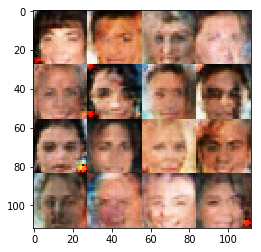

Epoch 1/1... Discriminator Loss: 0.4106... Generator Loss: 1.7021
Epoch 1/1... Discriminator Loss: 0.3364... Generator Loss: 2.7605
Epoch 1/1... Discriminator Loss: 0.2541... Generator Loss: 3.0751
Epoch 1/1... Discriminator Loss: 1.2406... Generator Loss: 0.5175
Epoch 1/1... Discriminator Loss: 0.8247... Generator Loss: 1.7917
Epoch 1/1... Discriminator Loss: 1.1890... Generator Loss: 0.9549
Epoch 1/1... Discriminator Loss: 1.7245... Generator Loss: 0.2717
Epoch 1/1... Discriminator Loss: 1.9954... Generator Loss: 2.0505
Epoch 1/1... Discriminator Loss: 1.3613... Generator Loss: 0.4044
Epoch 1/1... Discriminator Loss: 0.8641... Generator Loss: 1.2704


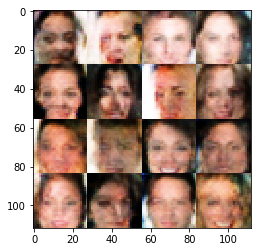

Epoch 1/1... Discriminator Loss: 0.8185... Generator Loss: 1.3016
Epoch 1/1... Discriminator Loss: 1.0762... Generator Loss: 0.5957
Epoch 1/1... Discriminator Loss: 1.0226... Generator Loss: 0.7774
Epoch 1/1... Discriminator Loss: 0.7404... Generator Loss: 1.4661
Epoch 1/1... Discriminator Loss: 1.0156... Generator Loss: 0.7124
Epoch 1/1... Discriminator Loss: 1.0023... Generator Loss: 0.8342
Epoch 1/1... Discriminator Loss: 1.2433... Generator Loss: 1.0368
Epoch 1/1... Discriminator Loss: 1.4185... Generator Loss: 0.5467
Epoch 1/1... Discriminator Loss: 1.2980... Generator Loss: 0.6753
Epoch 1/1... Discriminator Loss: 1.2826... Generator Loss: 0.7754


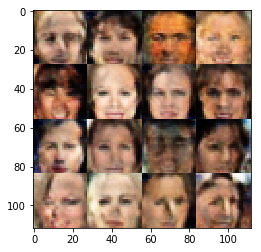

Epoch 1/1... Discriminator Loss: 0.8580... Generator Loss: 1.2374
Epoch 1/1... Discriminator Loss: 1.1546... Generator Loss: 0.6164
Epoch 1/1... Discriminator Loss: 1.1527... Generator Loss: 0.6912
Epoch 1/1... Discriminator Loss: 1.0408... Generator Loss: 1.1790
Epoch 1/1... Discriminator Loss: 0.8912... Generator Loss: 1.0684
Epoch 1/1... Discriminator Loss: 1.2878... Generator Loss: 0.5548
Epoch 1/1... Discriminator Loss: 1.2096... Generator Loss: 0.8104
Epoch 1/1... Discriminator Loss: 1.1151... Generator Loss: 0.7552
Epoch 1/1... Discriminator Loss: 0.7523... Generator Loss: 1.4428
Epoch 1/1... Discriminator Loss: 1.2594... Generator Loss: 0.5512


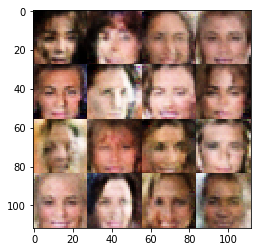

Epoch 1/1... Discriminator Loss: 1.1798... Generator Loss: 1.3114
Epoch 1/1... Discriminator Loss: 2.0797... Generator Loss: 0.1933
Epoch 1/1... Discriminator Loss: 2.1371... Generator Loss: 1.9107
Epoch 1/1... Discriminator Loss: 1.4427... Generator Loss: 0.5367
Epoch 1/1... Discriminator Loss: 1.4396... Generator Loss: 0.5006
Epoch 1/1... Discriminator Loss: 1.0075... Generator Loss: 1.4327
Epoch 1/1... Discriminator Loss: 0.9440... Generator Loss: 1.1617
Epoch 1/1... Discriminator Loss: 1.0191... Generator Loss: 0.7533
Epoch 1/1... Discriminator Loss: 0.7069... Generator Loss: 1.2246
Epoch 1/1... Discriminator Loss: 0.9225... Generator Loss: 0.9200


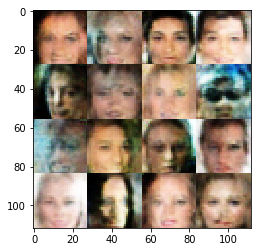

Epoch 1/1... Discriminator Loss: 1.2379... Generator Loss: 0.8774
Epoch 1/1... Discriminator Loss: 1.6436... Generator Loss: 0.2932
Epoch 1/1... Discriminator Loss: 1.3553... Generator Loss: 1.3373
Epoch 1/1... Discriminator Loss: 1.2930... Generator Loss: 0.6448
Epoch 1/1... Discriminator Loss: 1.2427... Generator Loss: 0.5569
Epoch 1/1... Discriminator Loss: 0.8146... Generator Loss: 1.3131
Epoch 1/1... Discriminator Loss: 0.7227... Generator Loss: 1.3715
Epoch 1/1... Discriminator Loss: 1.7308... Generator Loss: 0.2871
Epoch 1/1... Discriminator Loss: 1.2900... Generator Loss: 0.9848
Epoch 1/1... Discriminator Loss: 1.7006... Generator Loss: 0.3163


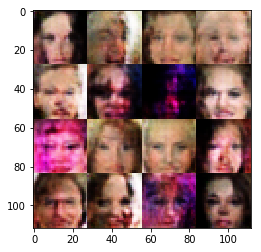

Epoch 1/1... Discriminator Loss: 1.3370... Generator Loss: 0.7771
Epoch 1/1... Discriminator Loss: 1.1487... Generator Loss: 1.0732
Epoch 1/1... Discriminator Loss: 1.2260... Generator Loss: 0.6323
Epoch 1/1... Discriminator Loss: 1.1663... Generator Loss: 0.6623
Epoch 1/1... Discriminator Loss: 1.2216... Generator Loss: 0.6996
Epoch 1/1... Discriminator Loss: 0.9045... Generator Loss: 1.6148
Epoch 1/1... Discriminator Loss: 1.3523... Generator Loss: 0.4096
Epoch 1/1... Discriminator Loss: 1.0399... Generator Loss: 1.2991
Epoch 1/1... Discriminator Loss: 1.1642... Generator Loss: 0.5968
Epoch 1/1... Discriminator Loss: 1.1680... Generator Loss: 0.7321


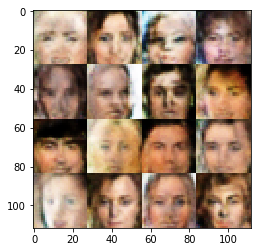

Epoch 1/1... Discriminator Loss: 1.2635... Generator Loss: 1.0427
Epoch 1/1... Discriminator Loss: 1.0823... Generator Loss: 0.7846
Epoch 1/1... Discriminator Loss: 1.5503... Generator Loss: 0.4064
Epoch 1/1... Discriminator Loss: 1.1219... Generator Loss: 1.1681
Epoch 1/1... Discriminator Loss: 1.5195... Generator Loss: 0.3571
Epoch 1/1... Discriminator Loss: 1.1365... Generator Loss: 0.8525
Epoch 1/1... Discriminator Loss: 1.1292... Generator Loss: 1.0524
Epoch 1/1... Discriminator Loss: 0.8692... Generator Loss: 1.0725
Epoch 1/1... Discriminator Loss: 1.6289... Generator Loss: 0.3585
Epoch 1/1... Discriminator Loss: 1.3391... Generator Loss: 1.3612


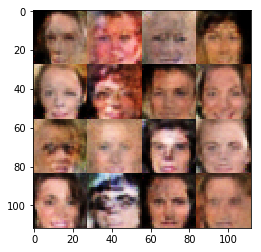

Epoch 1/1... Discriminator Loss: 1.3457... Generator Loss: 0.4866
Epoch 1/1... Discriminator Loss: 1.3301... Generator Loss: 0.6241
Epoch 1/1... Discriminator Loss: 0.8555... Generator Loss: 1.9895
Epoch 1/1... Discriminator Loss: 1.3811... Generator Loss: 0.4006
Epoch 1/1... Discriminator Loss: 0.9381... Generator Loss: 1.4235
Epoch 1/1... Discriminator Loss: 1.2462... Generator Loss: 0.6528
Epoch 1/1... Discriminator Loss: 0.7630... Generator Loss: 1.0948
Epoch 1/1... Discriminator Loss: 1.0978... Generator Loss: 0.6648
Epoch 1/1... Discriminator Loss: 1.3036... Generator Loss: 1.0688
Epoch 1/1... Discriminator Loss: 1.3198... Generator Loss: 0.5287


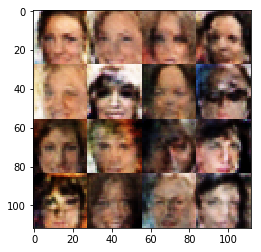

Epoch 1/1... Discriminator Loss: 0.9681... Generator Loss: 1.1745
Epoch 1/1... Discriminator Loss: 1.2852... Generator Loss: 0.4791
Epoch 1/1... Discriminator Loss: 1.1252... Generator Loss: 0.9275
Epoch 1/1... Discriminator Loss: 0.6938... Generator Loss: 1.5116
Epoch 1/1... Discriminator Loss: 1.3877... Generator Loss: 0.4203
Epoch 1/1... Discriminator Loss: 0.8425... Generator Loss: 1.1510
Epoch 1/1... Discriminator Loss: 1.1690... Generator Loss: 0.8804
Epoch 1/1... Discriminator Loss: 1.1208... Generator Loss: 0.6603
Epoch 1/1... Discriminator Loss: 0.9282... Generator Loss: 0.9453
Epoch 1/1... Discriminator Loss: 1.2297... Generator Loss: 0.6266


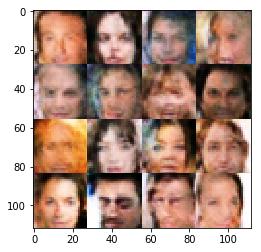

Epoch 1/1... Discriminator Loss: 1.4883... Generator Loss: 1.2247
Epoch 1/1... Discriminator Loss: 1.4395... Generator Loss: 0.4039
Epoch 1/1... Discriminator Loss: 2.3451... Generator Loss: 3.1869
Epoch 1/1... Discriminator Loss: 1.6052... Generator Loss: 0.3902
Epoch 1/1... Discriminator Loss: 1.2969... Generator Loss: 0.5585
Epoch 1/1... Discriminator Loss: 1.3941... Generator Loss: 0.8683
Epoch 1/1... Discriminator Loss: 1.3266... Generator Loss: 0.4893
Epoch 1/1... Discriminator Loss: 1.2384... Generator Loss: 0.9406
Epoch 1/1... Discriminator Loss: 1.3113... Generator Loss: 0.8833
Epoch 1/1... Discriminator Loss: 1.2394... Generator Loss: 0.5099


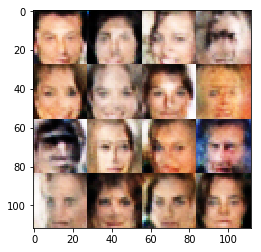

Epoch 1/1... Discriminator Loss: 1.2712... Generator Loss: 0.9048
Epoch 1/1... Discriminator Loss: 1.0696... Generator Loss: 0.8236
Epoch 1/1... Discriminator Loss: 1.5129... Generator Loss: 0.3818
Epoch 1/1... Discriminator Loss: 1.6480... Generator Loss: 1.4459
Epoch 1/1... Discriminator Loss: 1.4233... Generator Loss: 0.4197
Epoch 1/1... Discriminator Loss: 1.1497... Generator Loss: 0.7292
Epoch 1/1... Discriminator Loss: 1.4003... Generator Loss: 0.7516
Epoch 1/1... Discriminator Loss: 1.2658... Generator Loss: 0.6527
Epoch 1/1... Discriminator Loss: 1.3104... Generator Loss: 0.7260
Epoch 1/1... Discriminator Loss: 0.4102... Generator Loss: 1.7722


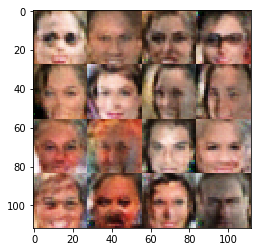

Epoch 1/1... Discriminator Loss: 1.7743... Generator Loss: 0.2607
Epoch 1/1... Discriminator Loss: 1.4780... Generator Loss: 1.4899
Epoch 1/1... Discriminator Loss: 1.1618... Generator Loss: 0.6946
Epoch 1/1... Discriminator Loss: 1.3040... Generator Loss: 0.4881
Epoch 1/1... Discriminator Loss: 1.2415... Generator Loss: 1.1063
Epoch 1/1... Discriminator Loss: 0.9854... Generator Loss: 0.8331
Epoch 1/1... Discriminator Loss: 1.4428... Generator Loss: 0.4870
Epoch 1/1... Discriminator Loss: 1.2755... Generator Loss: 1.1675
Epoch 1/1... Discriminator Loss: 1.2165... Generator Loss: 0.5517
Epoch 1/1... Discriminator Loss: 1.0717... Generator Loss: 0.6646


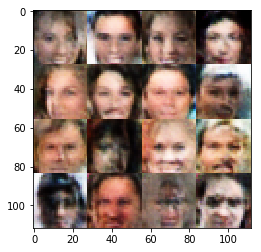

Epoch 1/1... Discriminator Loss: 0.9892... Generator Loss: 1.1702
Epoch 1/1... Discriminator Loss: 1.1776... Generator Loss: 0.7249
Epoch 1/1... Discriminator Loss: 1.3858... Generator Loss: 0.4271
Epoch 1/1... Discriminator Loss: 1.5232... Generator Loss: 1.1791
Epoch 1/1... Discriminator Loss: 1.4698... Generator Loss: 0.4422
Epoch 1/1... Discriminator Loss: 1.3517... Generator Loss: 0.5530
Epoch 1/1... Discriminator Loss: 1.0680... Generator Loss: 1.2042
Epoch 1/1... Discriminator Loss: 1.0097... Generator Loss: 0.7078
Epoch 1/1... Discriminator Loss: 1.2278... Generator Loss: 0.5769
Epoch 1/1... Discriminator Loss: 1.5442... Generator Loss: 1.0465


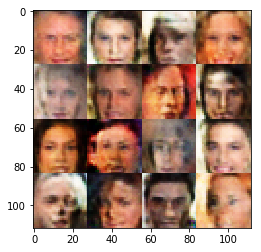

Epoch 1/1... Discriminator Loss: 1.2383... Generator Loss: 0.6069
Epoch 1/1... Discriminator Loss: 1.3323... Generator Loss: 0.5434
Epoch 1/1... Discriminator Loss: 1.2481... Generator Loss: 0.7631
Epoch 1/1... Discriminator Loss: 1.3669... Generator Loss: 0.6773
Epoch 1/1... Discriminator Loss: 1.3765... Generator Loss: 0.4542
Epoch 1/1... Discriminator Loss: 1.0352... Generator Loss: 1.1168
Epoch 1/1... Discriminator Loss: 1.0468... Generator Loss: 0.7440
Epoch 1/1... Discriminator Loss: 1.2360... Generator Loss: 0.5877
Epoch 1/1... Discriminator Loss: 1.1836... Generator Loss: 0.6548
Epoch 1/1... Discriminator Loss: 0.8380... Generator Loss: 2.6143


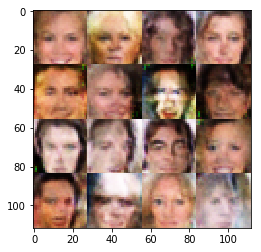

Epoch 1/1... Discriminator Loss: 1.2657... Generator Loss: 0.4519
Epoch 1/1... Discriminator Loss: 1.0348... Generator Loss: 1.6816
Epoch 1/1... Discriminator Loss: 1.3350... Generator Loss: 0.5825
Epoch 1/1... Discriminator Loss: 1.2252... Generator Loss: 0.5594
Epoch 1/1... Discriminator Loss: 1.3254... Generator Loss: 1.1143
Epoch 1/1... Discriminator Loss: 1.2766... Generator Loss: 0.5485
Epoch 1/1... Discriminator Loss: 1.0950... Generator Loss: 0.8645
Epoch 1/1... Discriminator Loss: 1.1273... Generator Loss: 0.7620
Epoch 1/1... Discriminator Loss: 1.2860... Generator Loss: 0.5551
Epoch 1/1... Discriminator Loss: 1.0137... Generator Loss: 1.2017


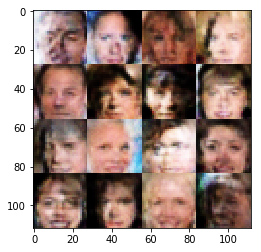

Epoch 1/1... Discriminator Loss: 1.1469... Generator Loss: 0.6255
Epoch 1/1... Discriminator Loss: 1.1552... Generator Loss: 1.0302
Epoch 1/1... Discriminator Loss: 1.4626... Generator Loss: 0.3872
Epoch 1/1... Discriminator Loss: 1.3732... Generator Loss: 1.9025
Epoch 1/1... Discriminator Loss: 1.1219... Generator Loss: 0.6588
Epoch 1/1... Discriminator Loss: 1.0937... Generator Loss: 0.6972
Epoch 1/1... Discriminator Loss: 1.0821... Generator Loss: 1.2370
Epoch 1/1... Discriminator Loss: 1.1684... Generator Loss: 0.6906
Epoch 1/1... Discriminator Loss: 1.1000... Generator Loss: 0.7332
Epoch 1/1... Discriminator Loss: 0.7856... Generator Loss: 1.0014


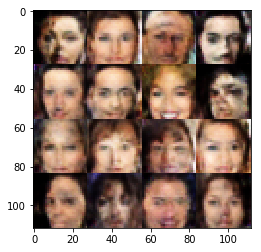

Epoch 1/1... Discriminator Loss: 0.9541... Generator Loss: 1.0626
Epoch 1/1... Discriminator Loss: 1.1491... Generator Loss: 0.5926
Epoch 1/1... Discriminator Loss: 1.3859... Generator Loss: 1.2487
Epoch 1/1... Discriminator Loss: 1.2530... Generator Loss: 0.6199
Epoch 1/1... Discriminator Loss: 1.3119... Generator Loss: 0.6348
Epoch 1/1... Discriminator Loss: 1.6550... Generator Loss: 0.6434
Epoch 1/1... Discriminator Loss: 1.4581... Generator Loss: 0.5271
Epoch 1/1... Discriminator Loss: 0.9976... Generator Loss: 0.9474
Epoch 1/1... Discriminator Loss: 1.1797... Generator Loss: 0.9298
Epoch 1/1... Discriminator Loss: 1.3772... Generator Loss: 0.5015


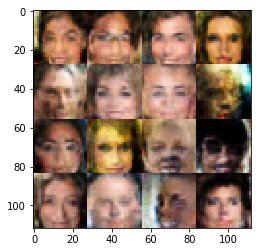

Epoch 1/1... Discriminator Loss: 1.2972... Generator Loss: 0.6920
Epoch 1/1... Discriminator Loss: 1.0154... Generator Loss: 1.2246
Epoch 1/1... Discriminator Loss: 1.2177... Generator Loss: 0.5148
Epoch 1/1... Discriminator Loss: 0.9249... Generator Loss: 1.3364
Epoch 1/1... Discriminator Loss: 1.0317... Generator Loss: 0.8370
Epoch 1/1... Discriminator Loss: 1.1994... Generator Loss: 0.6124
Epoch 1/1... Discriminator Loss: 1.0752... Generator Loss: 0.9352
Epoch 1/1... Discriminator Loss: 1.1967... Generator Loss: 0.5792
Epoch 1/1... Discriminator Loss: 0.7207... Generator Loss: 1.6643
Epoch 1/1... Discriminator Loss: 1.4192... Generator Loss: 0.4333


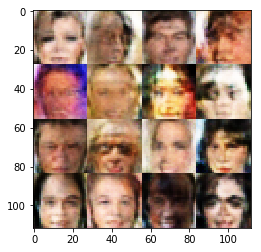

Epoch 1/1... Discriminator Loss: 0.9580... Generator Loss: 1.5007
Epoch 1/1... Discriminator Loss: 1.2938... Generator Loss: 0.6846
Epoch 1/1... Discriminator Loss: 1.2714... Generator Loss: 0.5356
Epoch 1/1... Discriminator Loss: 1.3130... Generator Loss: 0.7915
Epoch 1/1... Discriminator Loss: 1.0781... Generator Loss: 0.8327
Epoch 1/1... Discriminator Loss: 0.9739... Generator Loss: 0.7894
Epoch 1/1... Discriminator Loss: 1.1752... Generator Loss: 0.7627
Epoch 1/1... Discriminator Loss: 1.3168... Generator Loss: 0.8284
Epoch 1/1... Discriminator Loss: 1.4537... Generator Loss: 0.4151
Epoch 1/1... Discriminator Loss: 1.5378... Generator Loss: 1.3257


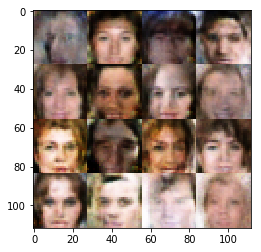

Epoch 1/1... Discriminator Loss: 1.4989... Generator Loss: 0.3805
Epoch 1/1... Discriminator Loss: 1.2234... Generator Loss: 0.8055
Epoch 1/1... Discriminator Loss: 0.7537... Generator Loss: 1.9162
Epoch 1/1... Discriminator Loss: 1.4328... Generator Loss: 0.3566
Epoch 1/1... Discriminator Loss: 1.3156... Generator Loss: 0.9364
Epoch 1/1... Discriminator Loss: 1.1795... Generator Loss: 0.9112
Epoch 1/1... Discriminator Loss: 1.2384... Generator Loss: 0.4935
Epoch 1/1... Discriminator Loss: 0.8320... Generator Loss: 1.2756
Epoch 1/1... Discriminator Loss: 1.2564... Generator Loss: 0.8318
Epoch 1/1... Discriminator Loss: 1.1079... Generator Loss: 0.6881


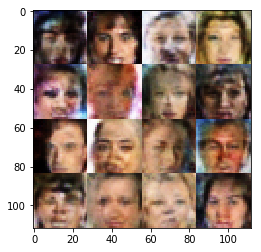

Epoch 1/1... Discriminator Loss: 1.0249... Generator Loss: 1.4451
Epoch 1/1... Discriminator Loss: 0.7585... Generator Loss: 1.0501
Epoch 1/1... Discriminator Loss: 1.4773... Generator Loss: 0.4339
Epoch 1/1... Discriminator Loss: 1.1984... Generator Loss: 0.9315
Epoch 1/1... Discriminator Loss: 1.2801... Generator Loss: 0.5663
Epoch 1/1... Discriminator Loss: 1.0926... Generator Loss: 0.8402
Epoch 1/1... Discriminator Loss: 1.1824... Generator Loss: 0.8750
Epoch 1/1... Discriminator Loss: 1.3283... Generator Loss: 0.5003
Epoch 1/1... Discriminator Loss: 1.3508... Generator Loss: 0.7876
Epoch 1/1... Discriminator Loss: 1.0208... Generator Loss: 1.0409


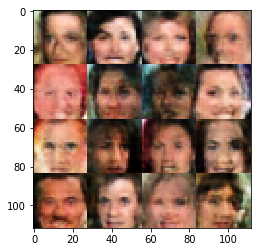

Epoch 1/1... Discriminator Loss: 1.1864... Generator Loss: 0.6294
Epoch 1/1... Discriminator Loss: 1.3727... Generator Loss: 0.4814
Epoch 1/1... Discriminator Loss: 1.2000... Generator Loss: 0.7606
Epoch 1/1... Discriminator Loss: 1.1148... Generator Loss: 0.8530
Epoch 1/1... Discriminator Loss: 1.4103... Generator Loss: 0.5544
Epoch 1/1... Discriminator Loss: 1.0800... Generator Loss: 0.6804
Epoch 1/1... Discriminator Loss: 1.2009... Generator Loss: 0.5829
Epoch 1/1... Discriminator Loss: 1.0472... Generator Loss: 1.3512
Epoch 1/1... Discriminator Loss: 1.2573... Generator Loss: 0.5843
Epoch 1/1... Discriminator Loss: 1.3271... Generator Loss: 0.5373


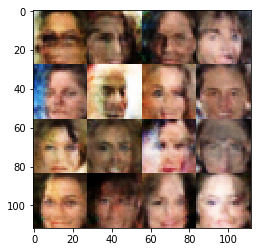

Epoch 1/1... Discriminator Loss: 1.4050... Generator Loss: 1.1657
Epoch 1/1... Discriminator Loss: 0.7757... Generator Loss: 0.8650
Epoch 1/1... Discriminator Loss: 1.6246... Generator Loss: 0.3197
Epoch 1/1... Discriminator Loss: 1.3248... Generator Loss: 1.5402
Epoch 1/1... Discriminator Loss: 1.1913... Generator Loss: 0.8653
Epoch 1/1... Discriminator Loss: 1.2965... Generator Loss: 0.5443
Epoch 1/1... Discriminator Loss: 1.2581... Generator Loss: 0.8700
Epoch 1/1... Discriminator Loss: 1.1060... Generator Loss: 0.7197
Epoch 1/1... Discriminator Loss: 1.1770... Generator Loss: 0.7615
Epoch 1/1... Discriminator Loss: 1.1688... Generator Loss: 0.7384


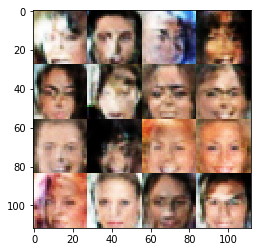

Epoch 1/1... Discriminator Loss: 1.1287... Generator Loss: 0.8186
Epoch 1/1... Discriminator Loss: 1.2540... Generator Loss: 0.5492
Epoch 1/1... Discriminator Loss: 1.3965... Generator Loss: 0.9185
Epoch 1/1... Discriminator Loss: 1.6521... Generator Loss: 0.2964
Epoch 1/1... Discriminator Loss: 1.3733... Generator Loss: 0.8555
Epoch 1/1... Discriminator Loss: 1.2900... Generator Loss: 0.6284
Epoch 1/1... Discriminator Loss: 1.4391... Generator Loss: 0.4329
Epoch 1/1... Discriminator Loss: 0.9294... Generator Loss: 1.6080
Epoch 1/1... Discriminator Loss: 0.7906... Generator Loss: 1.1466
Epoch 1/1... Discriminator Loss: 1.3183... Generator Loss: 0.4874


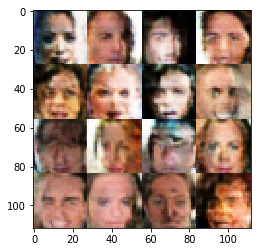

Epoch 1/1... Discriminator Loss: 1.1244... Generator Loss: 0.9102
Epoch 1/1... Discriminator Loss: 1.5106... Generator Loss: 0.4589
Epoch 1/1... Discriminator Loss: 1.3276... Generator Loss: 0.5749
Epoch 1/1... Discriminator Loss: 1.1516... Generator Loss: 0.9586
Epoch 1/1... Discriminator Loss: 1.3751... Generator Loss: 0.4149
Epoch 1/1... Discriminator Loss: 1.5620... Generator Loss: 0.9327
Epoch 1/1... Discriminator Loss: 1.3317... Generator Loss: 0.5020
Epoch 1/1... Discriminator Loss: 1.2147... Generator Loss: 0.6787
Epoch 1/1... Discriminator Loss: 1.1812... Generator Loss: 0.7876
Epoch 1/1... Discriminator Loss: 0.6034... Generator Loss: 1.5028


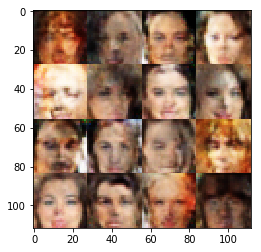

Epoch 1/1... Discriminator Loss: 1.5487... Generator Loss: 0.3675
Epoch 1/1... Discriminator Loss: 1.2358... Generator Loss: 1.0876
Epoch 1/1... Discriminator Loss: 0.9150... Generator Loss: 1.1384
Epoch 1/1... Discriminator Loss: 1.0481... Generator Loss: 0.6790
Epoch 1/1... Discriminator Loss: 1.2541... Generator Loss: 0.6862


In [13]:
batch_size = 64
z_dim = 100
learning_rate = 0.0004
beta1 = 0.5


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
epochs = 1

celeba_dataset = helper.Dataset('celeba', glob(os.path.join(data_dir, 'img_align_celeba/*.jpg')))
with tf.Graph().as_default():
    train(epochs, batch_size, z_dim, learning_rate, beta1, celeba_dataset.get_batches,
          celeba_dataset.shape, celeba_dataset.image_mode)

### Submitting This Project
When submitting this project, make sure to run all the cells before saving the notebook. Save the notebook file as "dlnd_face_generation.ipynb" and save it as a HTML file under "File" -> "Download as". Include the "helper.py" and "problem_unittests.py" files in your submission.